Klasifikasi supervised Use Case Fraud Detection (https://www.kaggle.com/competitions/ieee-fraud-detection/overview)

Tahapan pengerjaan:

1. Data Understanding
    a. Data Description: laod data, cek ukuran data, cek informasi data, statistika deskriptif, jumlah missing value, drop kolom banyak missing value
    b. EDA : melakukan EDA univariat maupun multivariat terhadap kolom numerik dan kategori
2. Data Preparation : data cleaning missing value berdasarkan jenis kategorik atau numerik
3. Feature Engineering
    a. Feature Selection : mengurangi fitur untuk modelling dengan gabungan voting beberapa metode yaitu Korelasi, KBest, MutualInfo, RFE, MRMR, Crammers V, Encoder
    b. Feature Transformation : transformasi fitur, split train test, undersampling dengan tomeklinks dan randomundersampler
4. Modelling 
    a. Model Selection : menentukan model yang akan dipilih berdasarkan parameter default
    b. Model Tuning : mengatur hyperparameter untuk mendapatkan model yang lebih sesuai
5. Model Evaluation - Backtesting
    melakukan pengecekan dengan menerapkan prediksi model pada data backtesting

# **Data Understanding**

In [242]:
# Importing modul

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as mnso
import random
import mrmr
import optuna
import lightgbm as lgb
import category_encoders as ce

from imblearn.under_sampling import RandomUnderSampler, TomekLinks, NearMiss
from sklearn.preprocessing import PowerTransformer
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant
from collections import Counter
from scipy.stats import chi2_contingency
from mrmr import mrmr_classif
from sklearn.feature_selection import mutual_info_classif,SelectKBest

from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import (
    ExtraTreesClassifier,
    RandomForestClassifier,
    AdaBoostClassifier
)

from scipy.stats import ttest_ind
from sklearn.impute import KNNImputer, SimpleImputer
from scipy.stats import skew,skewtest,spearmanr,pearsonr,normaltest
from sklearn.preprocessing import RobustScaler,OneHotEncoder, OrdinalEncoder
from sklearn.feature_selection import mutual_info_classif, RFE, SelectKBest, chi2, f_classif
from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline
from sklearn.metrics import precision_score, recall_score, f1_score, classification_report, roc_auc_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import roc_curve, precision_recall_curve,make_scorer,accuracy_score, average_precision_score, precision_recall_curve
from sklearn.model_selection import train_test_split, cross_validate, KFold, cross_val_score, RandomizedSearchCV, GridSearchCV, cross_val_predict, StratifiedKFold


import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', None)

In [186]:
### Define the function

def cramers_v_eval(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2, p, dof, expected = chi2_contingency(confusion_matrix)
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    phi2corr = max(0, phi2 - ((k - 1)*(r - 1)) / (n - 1))  # bias correction
    rcorr = r - ((r - 1)**2 / (n - 1))
    kcorr = k - ((k - 1)**2 / (n - 1))
    cramers_v = np.sqrt(phi2corr / min((kcorr - 1), (rcorr - 1)))
    return chi2, p, cramers_v

def describe_all_columns(df):
    summary = []

    for col in df.columns:
        total = len(df)
        null_count = df[col].isnull().sum()
        null_percent = (null_count / total) * 100
        nunique = df[col].nunique(dropna=True)
        mode_val = df[col].mode().iloc[0] if not df[col].mode().empty else None
        dtype = df[col].dtype

        desc = {
            'Column': col,
            'Type': str(dtype),
            'Null Count': null_count,
            'Null %': f"{null_percent:.2f}%",
            'Unique Values': nunique,
            'Most Frequent': mode_val
        }

        if pd.api.types.is_numeric_dtype(df[col]):
            stats = df[col].describe()
            desc.update({
                'Mean': stats['mean'],
                'Std': stats['std'],
                'Min': stats['min'],
                '25%': stats['25%'],
                '50% (Median)': stats['50%'],
                '75%': stats['75%'],
                'Max': stats['max']
            })

        summary.append(desc)

    return pd.DataFrame(summary)

def mutual_info_scores(df, target_col):
    # Split features and label
    # X = df.drop(columns=[target_col])
    X = df.select_dtypes(include=[np.number]).drop(columns=[target_col], errors='ignore')
    y = df[target_col]

    # Compute mutual information scores
    mi_scores = mutual_info_classif(X, y, random_state=42)

    # Build a dataframe of results
    mi_df = pd.DataFrame({
        'Feature': X.columns,
        'Mutual Information': mi_scores
    })

    # Sort descending
    mi_df = mi_df.sort_values(by='Mutual Information', ascending=False).reset_index(drop=True)
    return mi_df

def calc_VIF(x):
  vif= pd.DataFrame()
  vif['variables']=x.columns
  vif["VIF"]=[variance_inflation_factor(x.values,i) for i in range(x.shape[1])]
  return(vif)

def calculate_vif(df):
    # Add a constant for intercept
    df_with_const = add_constant(df)
    
    vif_data = pd.DataFrame()
    vif_data["Feature"] = df.columns
    vif_data["VIF"] = [
        variance_inflation_factor(df_with_const.values, i + 1)  # +1 to skip intercept
        for i in range(df.shape[1])
    ]
    return vif_data

def remove_high_vif_features(df, threshold=10):
    """
    Iteratively remove features with VIF higher than threshold
    """
    while True:
        vif = calculate_vif(df)
        max_vif = vif['VIF'].max()
        if max_vif > threshold:
            drop_feature = vif.sort_values('VIF', ascending=False)['Feature'].iloc[0]
            print(f"Dropping '{drop_feature}' with VIF = {max_vif:.2f}")
            df = df.drop(columns=[drop_feature])
        else:
            break
    return df, calculate_vif(df)

In [2]:
# Fraud Detection

# tujuan: untuk memprediksi terjadinya kejadian fraud dengan menggunakan model supervised classification machine learning
# data train dan test menggunakan identity dan transaction, kemudian dicek kembali

In [3]:
# Load Dataset

# Data Train
train1 = pd.read_csv('train_identity.csv',sep=',')
train2 = pd.read_csv('train_transaction.csv',sep=',')


# Data Test
test1 = pd.read_csv('test_identity.csv',sep=',')
test2 = pd.read_csv('test_transaction.csv',sep=',')

In [4]:
# Data checking identity

train1

,TransactionID,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_18,id_19,id_20,id_21,id_22,id_23,id_24,id_25,id_26,id_27,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987004,0.0,70787.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.0,NotFound,NaN,-480.0,New,NotFound,166.0,NaN,542.0,144.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,Android 7.0,samsung browser 6.2,32.0,2220x1080,match_status:2,T,F,T,T,mobile,SAMSUNG SM-G892A Build/NRD90M
1,2987008,-5.0,98945.0,NaN,NaN,0.0,-5.0,NaN,NaN,NaN,NaN,100.0,NotFound,49.0,-300.0,New,NotFound,166.0,NaN,621.0,500.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,iOS 11.1.2,mobile safari 11.0,32.0,1334x750,match_status:1,T,F,F,T,mobile,iOS Device
2,2987010,-5.0,191631.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,100.0,NotFound,52.0,NaN,Found,Found,121.0,NaN,410.0,142.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Found,Found,NaN,chrome 62.0,NaN,NaN,NaN,F,F,T,T,desktop,Windows
3,2987011,-5.0,221832.0,NaN,NaN,0.0,-6.0,NaN,NaN,NaN,NaN,100.0,NotFound,52.0,NaN,New,NotFound,225.0,NaN,176.0,507.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,NaN,chrome 62.0,NaN,NaN,NaN,F,F,T,T,desktop,NaN
4,2987016,0.0,7460.0,0.0,0.0,1.0,0.0,NaN,NaN,0.0,0.0,100.0,NotFound,NaN,-300.0,Found,Found,166.0,15.0,529.0,575.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Found,Found,Mac OS X 10_11_6,chrome 62.0,24.0,1280x800,match_status:2,T,F,T,T,desktop,MacOS
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144228,3577521,-15.0,145955.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,100.0,NotFound,27.0,NaN,Found,Found,225.0,NaN,427.0,139.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Found,Found,NaN,chrome 66.0 for android,NaN,NaN,NaN,F,F,T,F,mobile,F3111 Build/33.3.A.1.97
144229,3577526,-5.0,172059.0,NaN,NaN,1.0,-5.0,NaN,NaN,NaN,NaN,100.0,NotFound,27.0,-300.0,New,NotFound,166.0,15.0,352.0,333.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,Android 7.1.1,chrome 55.0 for android,32.0,855x480,match_status:2,T,F,T,F,mobile,A574BL Build/NMF26F
144230,3577529,-20.0,632381.0,NaN,NaN,-1.0,-36.0,NaN,NaN,NaN,NaN,100.0,NotFound,27.0,NaN,New,NotFound,225.0,27.0,567.0,411.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,NaN,chrome 65.0 for android,NaN,NaN,NaN,F,F,T,F,mobile,Moto E (4) Plus Build/NMA26.42-152
144231,3577531,-5.0,55528.0,0.0,0.0,0.0,-7.0,NaN,NaN,0.0,0.0,100.0,NotFound,27.0,-300.0,Found,Found,166.0,15.0,352.0,368.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Found,Found,Mac OS X 10_9_5,chrome 66.0,24.0,2560x1600,match_status:2,T,F,T,F,desktop,MacOS


In [5]:
# Data checking transaction

train2

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,2987000,0,86400,68.50,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,19.0,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0,T,T,T,M2,F,T,NaN,NaN,NaN,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,117.000000,0.000000,0.0,0.000000,0.0,0.0,117.0,0.0,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,117.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,117.0,0.0,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.00,W,2755,404.0,150.0,mastercard,102.0,credit,325.0,87.0,NaN,NaN,gmail.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,M0,T,T,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0

In [6]:
train1['TransactionID'].nunique()

144233

In [7]:
train2['TransactionID'].nunique()

590540

In [22]:
# Data testing checking

test1

,TransactionID,id-01,id-02,id-03,id-04,id-05,id-06,id-07,id-08,id-09,id-10,id-11,id-12,id-13,id-14,id-15,id-16,id-17,id-18,id-19,id-20,id-21,id-22,id-23,id-24,id-25,id-26,id-27,id-28,id-29,id-30,id-31,id-32,id-33,id-34,id-35,id-36,id-37,id-38,DeviceType,DeviceInfo
0,3663586,-45.0,280290.0,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,100.0,NotFound,27.0,NaN,New,NotFound,225.0,15.0,427.0,563.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,NaN,chrome 67.0 for android,NaN,NaN,NaN,F,F,T,F,mobile,MYA-L13 Build/HUAWEIMYA-L13
1,3663588,0.0,3579.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,100.0,Found,NaN,-300.0,Found,Found,166.0,NaN,542.0,368.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Found,Found,Android 6.0.1,chrome 67.0 for android,24.0,1280x720,match_status:2,T,F,T,T,mobile,LGLS676 Build/MXB48T
2,3663597,-5.0,185210.0,NaN,NaN,1.0,0.0,NaN,NaN,NaN,NaN,100.0,NotFound,52.0,-360.0,New,NotFound,225.0,NaN,271.0,507.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,NaN,ie 11.0 for tablet,NaN,NaN,NaN,F,T,T,F,desktop,Trident/7.0
3,3663601,-45.0,252944.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,100.0,NotFound,27.0,NaN,Found,Found,225.0,15.0,427.0,563.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Found,Found,NaN,chrome 67.0 for android,NaN,NaN,NaN,F,F,T,F,mobile,MYA-L13 Build/HUAWEIMYA-L13
4,3663602,-95.0,328680.0,NaN,NaN,7.0,-33.0,NaN,NaN,NaN,NaN,100.0,NotFound,27.0,NaN,New,NotFound,225.0,15.0,567.0,507.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,NaN,chrome 67.0 for android,NaN,NaN,NaN,F,F,T,F,mobile,SM-G9650 Build/R16NW
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
141902,4170230,-20.0,473365.0,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,100.0,NotFound,27.0,NaN,New,NotFound,225.0,NaN,153.0,325.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,NaN,chrome 71.0 for android,NaN,NaN,NaN,F,F,T,F,mobile,SM-J700M
141903,4170233,-5.0,489917.0,0.0,0.0,-4.0,-32.0,NaN,NaN,0.0,0.0,100.0,NotFound,27.0,NaN,Found,Found,225.0,17.0,417.0,595.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Found,Found,NaN,chrome 71.0 for android,NaN,NaN,NaN,F,F,T,F,mobile,SM-J320M
141904,4170234,-5.0,110081.0,NaN,NaN,22.0,-31.0,NaN,NaN,NaN,NaN,100.0,NotFound,27.0,-300.0,New,NotFound,166.0,15.0,122.0,177.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,iOS 10.3.3,mobile safari 10.0,32.0,1334x750,match_status:2,T,F,F,T,mobile,iOS Device
141905,4170236,-45.0,266704.0,NaN,NaN,-3.0,-10.0,NaN,NaN,NaN,NaN,100.0,NotFound,27.0,NaN,New,NotFound,225.0,15.0,176.0,507.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,NaN,chrome 43.0 for android,NaN,NaN,NaN,F,F,T,F,mobile,ALE-L23 Build/HuaweiALE-L23


In [23]:
# Data testing transaction checking

test2

,TransactionID,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,3663549,18403224,31.950,W,10409,111.0,150.0,visa,226.0,debit,170.0,87.0,1.0,NaN,gmail.com,NaN,6.0,6.0,0.0,0.0,3.0,4.0,0.0,0.0,6.0,0.0,5.0,1.0,115.0,6.0,419.0,419.0,27.0,398.0,27.0,NaN,NaN,NaN,NaN,418.0,203.0,NaN,NaN,NaN,409.0,T,T,F,NaN,NaN,F,T,T,T,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,47.950001,0.000000,0.000000,47.950001,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,47.950001,0.000000,0.000000,47.950001,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3663550,18403263,49.000,W,4272,111.0,150.0,visa,226.0,debit,299.0,87.0,4.0,NaN,aol.com,NaN,3.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,0.0,1.0,1.0,12.0,2.0,149.0,149.0,7.0,634.0,7.0,NaN,NaN,NaN,NaN,231.0,634.0,NaN,NaN,NaN,634.0,T,F,F,M0,NaN,F,NaN,NaN,NaN,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0

## Data Description

In [24]:
# Melihat informasi dataset train
 
train1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 144233 entries, 0 to 144232
Data columns (total 41 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   TransactionID  144233 non-null  int64  
 1   id_01          144233 non-null  float64
 2   id_02          140872 non-null  float64
 3   id_03          66324 non-null   float64
 4   id_04          66324 non-null   float64
 5   id_05          136865 non-null  float64
 6   id_06          136865 non-null  float64
 7   id_07          5155 non-null    float64
 8   id_08          5155 non-null    float64
 9   id_09          74926 non-null   float64
 10  id_10          74926 non-null   float64
 11  id_11          140978 non-null  float64
 12  id_12          144233 non-null  object 
 13  id_13          127320 non-null  float64
 14  id_14          80044 non-null   float64
 15  id_15          140985 non-null  object 
 16  id_16          129340 non-null  object 
 17  id_17          139369 non-nul

In [25]:
# Melihat informasi dataset train trx
 
train2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 590540 entries, 0 to 590539
Columns: 394 entries, TransactionID to V339
dtypes: float64(376), int64(4), object(14)
memory usage: 1.7+ GB


In [27]:
# Melihat informasi dataset test trx
 
train1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 144233 entries, 0 to 144232
Data columns (total 41 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   TransactionID  144233 non-null  int64  
 1   id_01          144233 non-null  float64
 2   id_02          140872 non-null  float64
 3   id_03          66324 non-null   float64
 4   id_04          66324 non-null   float64
 5   id_05          136865 non-null  float64
 6   id_06          136865 non-null  float64
 7   id_07          5155 non-null    float64
 8   id_08          5155 non-null    float64
 9   id_09          74926 non-null   float64
 10  id_10          74926 non-null   float64
 11  id_11          140978 non-null  float64
 12  id_12          144233 non-null  object 
 13  id_13          127320 non-null  float64
 14  id_14          80044 non-null   float64
 15  id_15          140985 non-null  object 
 16  id_16          129340 non-null  object 
 17  id_17          139369 non-nul

In [28]:
# Melihat informasi dataset test trx
 
train2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 590540 entries, 0 to 590539
Columns: 394 entries, TransactionID to V339
dtypes: float64(376), int64(4), object(14)
memory usage: 1.7+ GB


<Axes: >

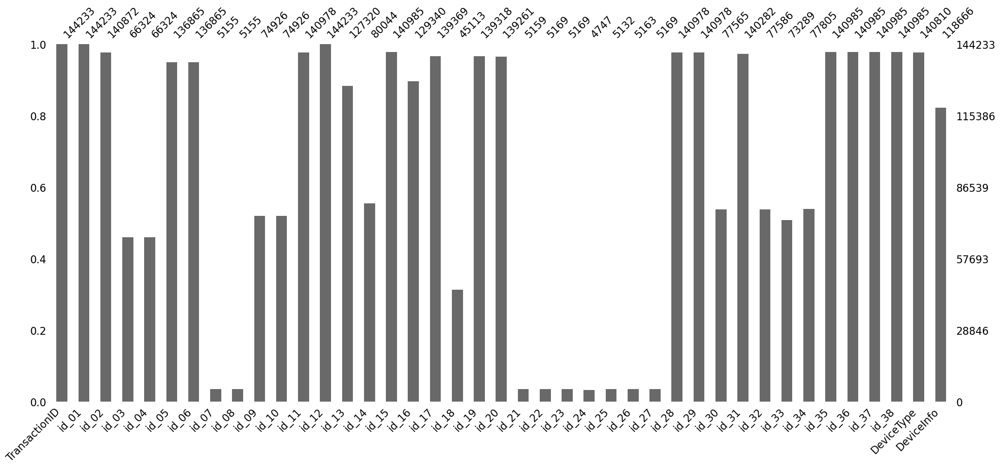

In [26]:
# Melihat jumlah missing value train identity

mnso.bar(train1)

<Axes: >

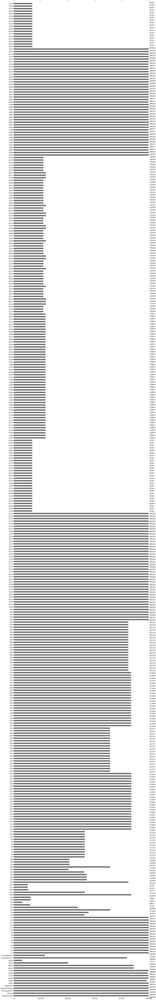

In [29]:
# Melihat jumlah missing value train trx

mnso.bar(train2)

<Axes: >

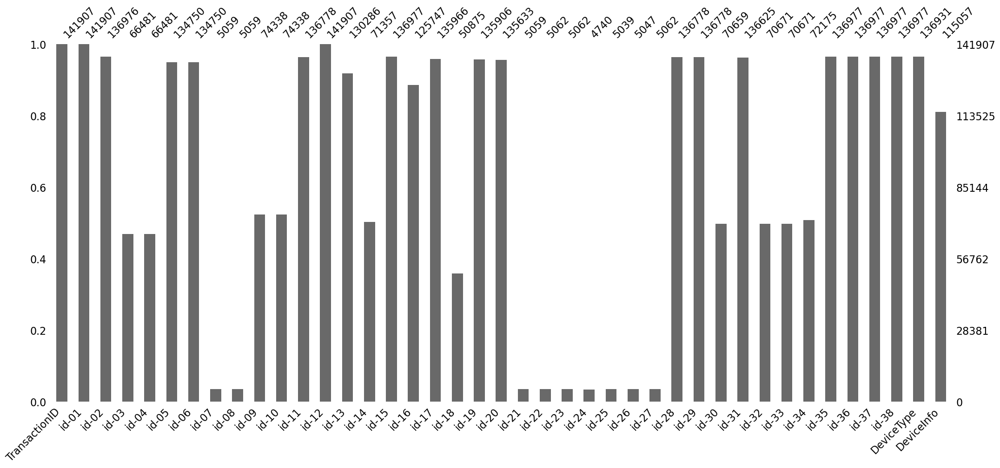

In [30]:
# Melihat jumlah missing value train identity

mnso.bar(test1)

<Axes: >

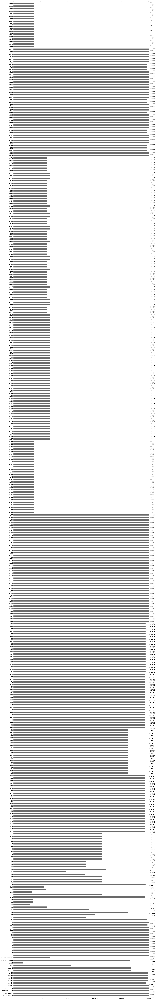

In [31]:
# Melihat jumlah missing value train trx

mnso.bar(test2)

In [32]:
# Check Missing Value

Metode penanganan missing value :

1. missing value ≤10% gunakan simple imputer yaitu median untuk kolom numerik dan modus untuk kolom kategorik <p>
2. missing value >10% dan ≤30%  gunakan KNNImputer atau <p>
3. missing value >30% drop kolom

In [33]:
# Melihat jumlah persentase missing value - train identity

train1.isna().sum()/len(train1)

TransactionID    0.000000
id_01            0.000000
id_02            0.023303
id_03            0.540161
id_04            0.540161
id_05            0.051084
id_06            0.051084
id_07            0.964259
id_08            0.964259
id_09            0.480521
id_10            0.480521
id_11            0.022568
id_12            0.000000
id_13            0.117262
id_14            0.445037
id_15            0.022519
id_16            0.103257
id_17            0.033723
id_18            0.687221
id_19            0.034077
id_20            0.034472
id_21            0.964231
id_22            0.964162
id_23            0.964162
id_24            0.967088
id_25            0.964419
id_26            0.964204
id_27            0.964162
id_28            0.022568
id_29            0.022568
id_30            0.462224
id_31            0.027393
id_32            0.462079
id_33            0.491871
id_34            0.460560
id_35            0.022519
id_36            0.022519
id_37            0.022519
id_38       

In [34]:
# Melihat jumlah persentase missing value - train trx

train2.isna().sum()/len(train2)

TransactionID     0.00000
isFraud           0.00000
TransactionDT     0.00000
TransactionAmt    0.00000
ProductCD         0.00000
                   ...   
V335              0.86055
V336              0.86055
V337              0.86055
V338              0.86055
V339              0.86055
Length: 394, dtype: float64

In [35]:
# Melihat jumlah persentase missing value - test identity

test1.isna().sum()/len(test1)

TransactionID    0.000000
id-01            0.000000
id-02            0.034748
id-03            0.531517
id-04            0.531517
id-05            0.050434
id-06            0.050434
id-07            0.964350
id-08            0.964350
id-09            0.476150
id-10            0.476150
id-11            0.036143
id-12            0.000000
id-13            0.081892
id-14            0.497157
id-15            0.034741
id-16            0.113877
id-17            0.041865
id-18            0.641491
id-19            0.042288
id-20            0.044212
id-21            0.964350
id-22            0.964329
id-23            0.964329
id-24            0.966598
id-25            0.964491
id-26            0.964434
id-27            0.964329
id-28            0.036143
id-29            0.036143
id-30            0.502075
id-31            0.037222
id-32            0.501991
id-33            0.501991
id-34            0.491392
id-35            0.034741
id-36            0.034741
id-37            0.034741
id-38       

In [38]:
# Melihat jumlah persentase missing value - test trx

test2.isna().sum()/len(test2)

TransactionID     0.000000
TransactionDT     0.000000
TransactionAmt    0.000000
ProductCD         0.000000
card1             0.000000
                    ...   
V335              0.849157
V336              0.849157
V337              0.849157
V338              0.849157
V339              0.849157
Length: 393, dtype: float64

In [8]:
# Drop Feature > 30% missing

threshold = 0.3 # max 30% null

In [9]:
# filter data dengan treshold tersebut

train1_null_percentage = train1.isnull().mean()
train2_null_percentage = train2.isnull().mean()
test1_null_percentage = test1.isnull().mean()
test2_null_percentage = test2.isnull().mean()

train1_filtered = train1.loc[:, train1_null_percentage < threshold]
train2_filtered = train2.loc[:, train2_null_percentage < threshold]
test1_filtered = test1.loc[:, test1_null_percentage < threshold]
test2_filtered = test2.loc[:, test2_null_percentage < threshold]

In [10]:
train2['isFraud'].value_counts()

isFraud
0    569877
1     20663
Name: count, dtype: int64

In [11]:
# Penggabungan data
# pembagian data train test dan backtesting 

df_train = train2_filtered.join(train1_filtered, on='TransactionID', how='left',lsuffix='_1')
df_backtest = test2_filtered.join(test1_filtered, on='TransactionID', how='left',lsuffix='_1')

train_null_percentage = df_train.isnull().mean()
test_null_percentage = df_backtest.isnull().mean()

df_train = df_train.loc[:, train_null_percentage < threshold]
df_backtest = df_backtest.loc[:, test_null_percentage < threshold]

In [100]:
df_train

,TransactionID_1,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,P_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D4,D10,D15,M6,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321
0,2987000,0,86400,68.50,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,0.0,T,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,117.000000,0.000000,0.0,0.000000,0.0,0.0,117.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,117.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,117.0,0.0,0.000000,0.000000,0.000000
1,2987001,0,86401,29.00,W,2755,404.0,150.0,mastercard,102.0,credit,325.0,87.0,gmail.com,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,T,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000
2,2987002,0,86469,59.00,W,4663,490.0,150.0,visa,166.0,debit,330.0,87.0,outlook.com,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,315.0,F,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000
3,2987003,0,86499,50.00,W,18132,567.0,150.0,mastercard,117.0,debit,476.0,87.0,yahoo.com,2.0,5.0,0.0,0.0,0.0,4.0,0.0,0.0,1.0,0.0,1.0,0.0,25.0,1.0,112.0,94.0,84.0,111.0,F,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1

In [101]:
df_backtest

,TransactionID_1,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,P_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D4,D10,D15,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321
0,3663549,18403224,31.950,W,10409,111.0,150.0,visa,226.0,debit,170.0,87.0,gmail.com,6.0,6.0,0.0,0.0,3.0,4.0,0.0,0.0,6.0,0.0,5.0,1.0,115.0,6.0,419.0,398.0,418.0,409.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,47.950001,0.000000,0.000000,47.950001,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,47.950001,0.000000,0.000000,47.950001,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
1,3663550,18403263,49.000,W,4272,111.0,150.0,visa,226.0,debit,299.0,87.0,aol.com,3.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,0.0,1.0,1.0,12.0,2.0,149.0,634.0,231.0,634.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,0.0,4.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,280.000000,77.000000,0.000000,280.000000,77.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,4.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,280.000000,77.000000,0.000000,280.000000,0.000000,77.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
2,3663551,18403310,171.000,W,4476,574.0,150.0,visa,226.0,debit,472.0,87.0,hotmail.com,2.0,2.0,0.0,0.0,0.0,5.0,0.0,0.0,4.0,0.0,2.0,0.0,22.0,2.0,137.0,97.0,136.0,97.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,2.0,2.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,1.0,2.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,968.000000,0.000000,0.000000,705.000000,0.000000,0.0,0.0,0.0,0.0,263.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,1.0,2.0,1.0,0.0,0.0,0.0,2.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,1321.000000,0.000000,0.000000,1058.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,263.0,0.0
3,3663552,18403310,284.950,W,10989,360.0,150.0,visa,166.0,debit,205.0,87.0,gmail.com,5.0,2.0,0.0,0.0,1.0,1.0,0.0,0.0,2.0,0.0,2.0,0.0,7.0,4.0,42.0,242.0,242.0,242.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,2.0,2.0,2.0,2.0,0

In [140]:
# Memisahkan data kategorik dan data numerik

df_num = df_train.select_dtypes('number')
df_cat = df_train.select_dtypes('object')

In [103]:
# Menampilkan statistika deskriptif secara keseluruhan pada data numerik

df_num.describe().T

,count,mean,std,min,25%,50%,75%,max
TransactionID_1,590540.0,3.282270e+06,1.704744e+05,2987000.000,3134634.750,3282269.500,3429904.25,3.577539e+06
isFraud,590540.0,3.499001e-02,1.837546e-01,0.000,0.000,0.000,0.00,1.000000e+00
TransactionDT,590540.0,7.372311e+06,4.617224e+06,86400.000,3027057.750,7306527.500,11246620.00,1.581113e+07
TransactionAmt,590540.0,1.350272e+02,2.391625e+02,0.251,43.321,68.769,125.00,3.193739e+04
card1,590540.0,9.898735e+03,4.901170e+03,1000.000,6019.000,9678.000,14184.00,1.839600e+04
...,...,...,...,...,...,...,...,...
V317,590528.0,2.476067e+02,3.980043e+03,0.000,0.000,0.000,0.00,1.340210e+05
V318,590528.0,1.621534e+02,2.793344e+03,0.000,0.000,0.000,0.00,9.847600e+04
V319,590528.0,1.837248e+01,3.323048e+02,0.000,0.000,0.000,0.00,1.040600e+05
V320,590528.0,4.207313e+01,4.734993e+02,0.000,0.000,0.000,0.00,1.040600e+05


In [104]:
# Menampilkan statistika deskriptif secara keseluruhan pada data kategorik

df_cat.describe().T

,count,unique,top,freq
ProductCD,590540,5,W,439670
card4,588963,4,visa,384767
card6,588969,4,debit,439938
P_emaildomain,496084,59,gmail.com,228355
M6,421180,2,F,227856


## Exploratory Data Analysis

In [97]:
# Melihat kolom numerik

df_num.columns

Index(['TransactionID_1', 'isFraud', 'TransactionAmt', 'card1', 'card2',
       'card3', 'card5', 'addr1', 'addr2', 'C1',
       ...
       'V312', 'V313', 'V314', 'V315', 'V316', 'V317', 'V318', 'V319', 'V320',
       'V321'],
      dtype='object', length=196)

In [98]:
# Melihat kolom kategorik

df_cat.columns

Index(['ProductCD', 'card4', 'card6', 'P_emaildomain', 'M6'], dtype='object')

EDA univariat setiap kolom numerik dengan bentuk : <p>
    a. histogram dan boxplot untuk tiap kolom<p>
    b. metrik statistik dasar untuk tiap kolom: mean, std, min, q1, q2, q3, iqr, max<p>
    c. nilai upper whisker (nilai maximum tanpa outlier) dan lower whisker (nilai minimum tanpa outlier) dari boxplot tiap kolom<p>
    d. medeteksi outlier (<q1-1.5*iqr | >q3+1.5*iqr); menghitung count dan list dari outlier tiap kolom<p>
    e. menghitung metrik skew dan lakukan skewtest untuk tiap kolom<p>


Iterasi ke- 1
Kolom :  TransactionID_1


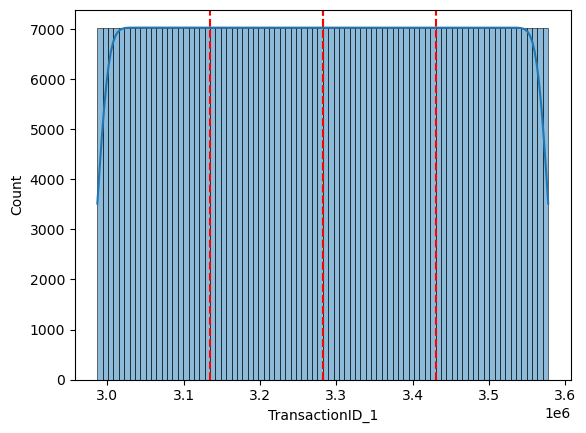

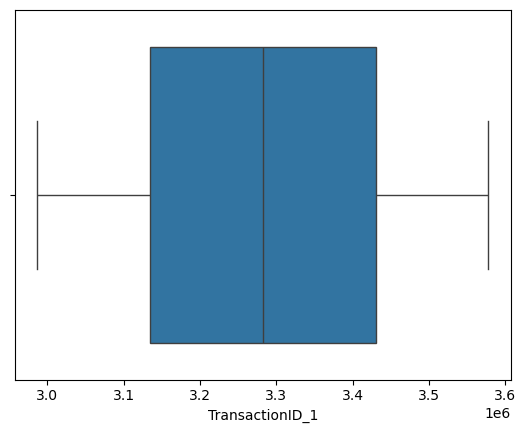


Skew Value :  -3.0240452773590867e-16
Skew Test Value :  SkewtestResult(statistic=-8.531957402043965e-14, pvalue=0.9999999999999319)
count    5.905400e+05
mean     3.282270e+06
std      1.704744e+05
min      2.987000e+06
25%      3.134635e+06
50%      3.282270e+06
75%      3.429904e+06
max      3.577539e+06
Name: TransactionID_1, dtype: float64

nilai max di luar outlier = 3577539
nilai min di luar outlier = 2987000
jumlah outlier:0
outlier:
[]


Iterasi ke- 2
Kolom :  isFraud


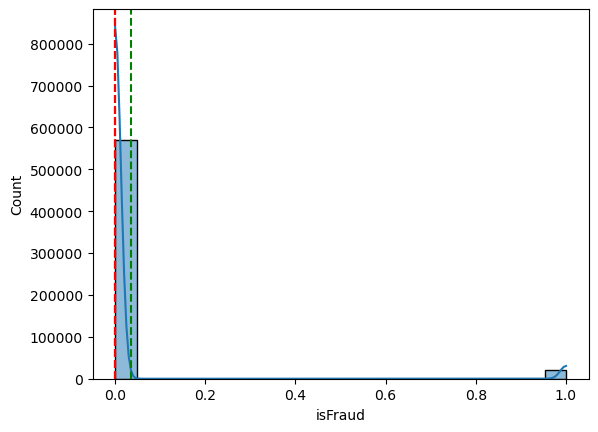

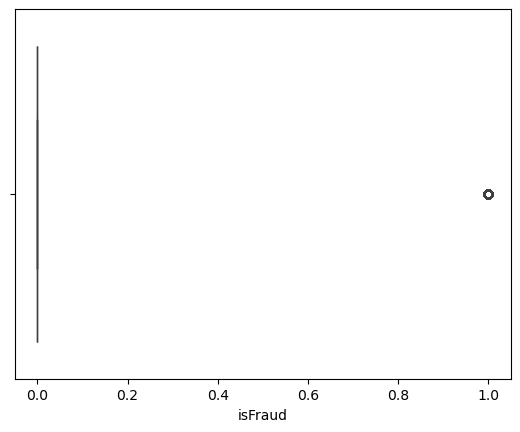


Skew Value :  5.06120987534654
Skew Test Value :  SkewtestResult(statistic=646.5336100406968, pvalue=0.0)
count    590540.000000
mean          0.034990
std           0.183755
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           1.000000
Name: isFraud, dtype: float64

nilai max di luar outlier = 0
nilai min di luar outlier = 0
jumlah outlier:20663
outlier:
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

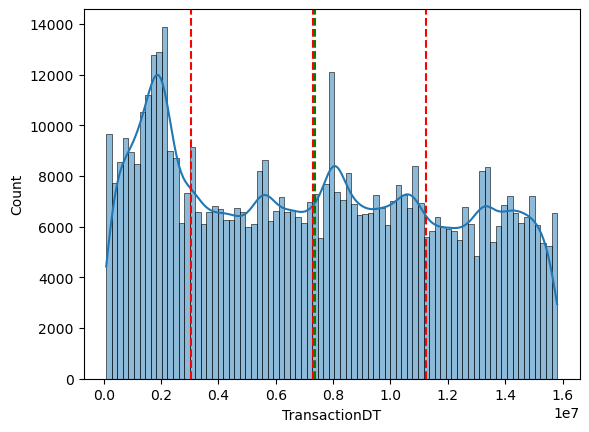

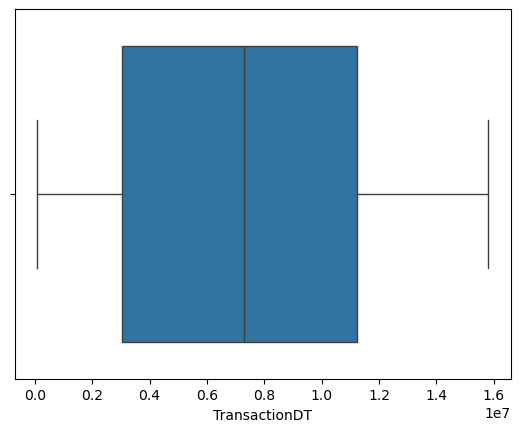


Skew Value :  0.13115441310317902
Skew Test Value :  SkewtestResult(statistic=40.972015041094856, pvalue=0.0)
count    5.905400e+05
mean     7.372311e+06
std      4.617224e+06
min      8.640000e+04
25%      3.027058e+06
50%      7.306528e+06
75%      1.124662e+07
max      1.581113e+07
Name: TransactionDT, dtype: float64

nilai max di luar outlier = 15811131
nilai min di luar outlier = 86400
jumlah outlier:0
outlier:
[]


Iterasi ke- 4
Kolom :  TransactionAmt


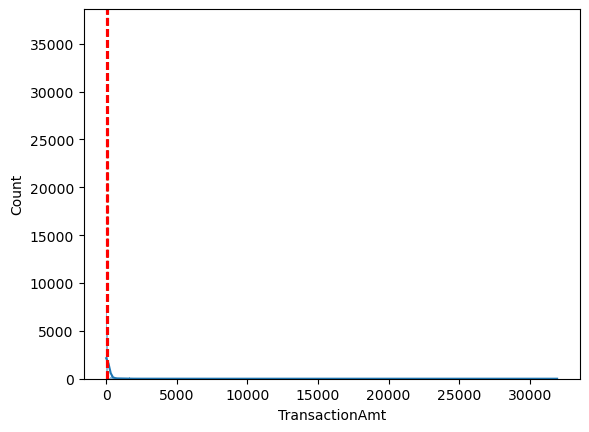

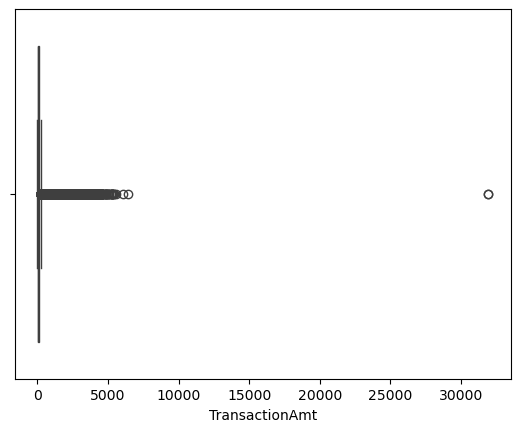


Skew Value :  14.374453061909255
Skew Test Value :  SkewtestResult(statistic=912.4847286827917, pvalue=0.0)
count    590540.000000
mean        135.027176
std         239.162522
min           0.251000
25%          43.321000
50%          68.769000
75%         125.000000
max       31937.391000
Name: TransactionAmt, dtype: float64

nilai max di luar outlier = 247.51
nilai min di luar outlier = 0.251
jumlah outlier:66482
outlier:
[422.5, 363.89, 774.0, 500.0, 380.21, 2454.0, 250.0, 300.0, 445.0, 554.0, 280.0, 300.0, 280.0, 411.95, 318.95, 527.0, 1153.95, 444.61, 757.07, 2594.95, 3000.0, 587.82, 479.95, 973.95, 306.47, 445.0, 424.95, 311.95, 359.91, 1486.44, 2547.46, 445.0, 2948.95, 499.95, 590.4, 1973.0, 474.95, 250.0, 289.95, 2038.95, 385.78, 450.95, 1351.55, 554.0, 364.95, 335.0, 300.0, 412.73, 354.95, 524.0, 648.95, 335.0, 711.93, 500.0, 500.0, 500.0, 462.95, 500.0, 344.95, 250.0, 311.95, 500.0, 315.0, 1472.47, 3162.95, 2267.47, 3162.95, 335.0, 350.23, 303.95, 250.0, 424.95, 3000.0, 500

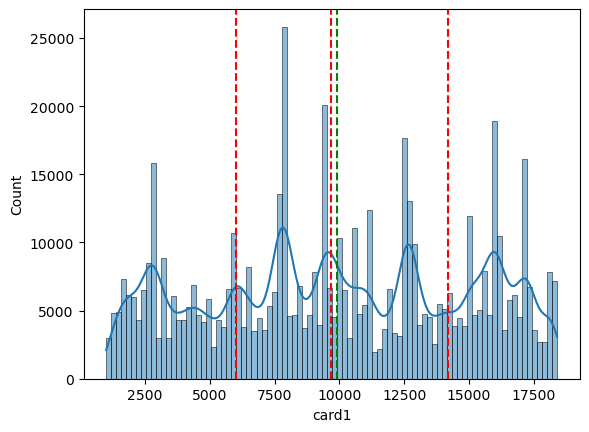

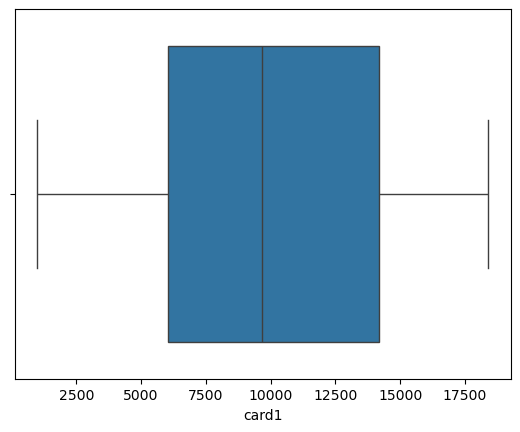


Skew Value :  -0.040928879572676026
Skew Test Value :  SkewtestResult(statistic=-12.835201786587627, pvalue=1.0413130744750388e-37)
count    590540.000000
mean       9898.734658
std        4901.170153
min        1000.000000
25%        6019.000000
50%        9678.000000
75%       14184.000000
max       18396.000000
Name: card1, dtype: float64

nilai max di luar outlier = 18396
nilai min di luar outlier = 1000
jumlah outlier:0
outlier:
[]


Iterasi ke- 6
Kolom :  card2


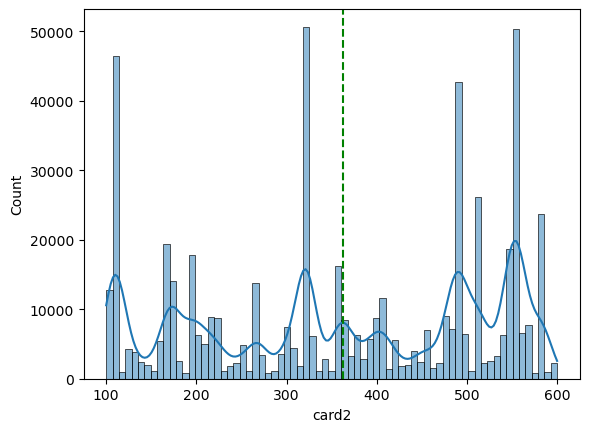

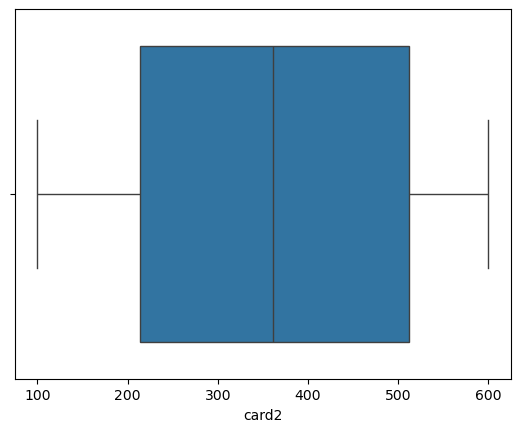


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    581607.000000
mean        362.555488
std         157.793246
min         100.000000
25%         214.000000
50%         361.000000
75%         512.000000
max         600.000000
Name: card2, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 7
Kolom :  card3


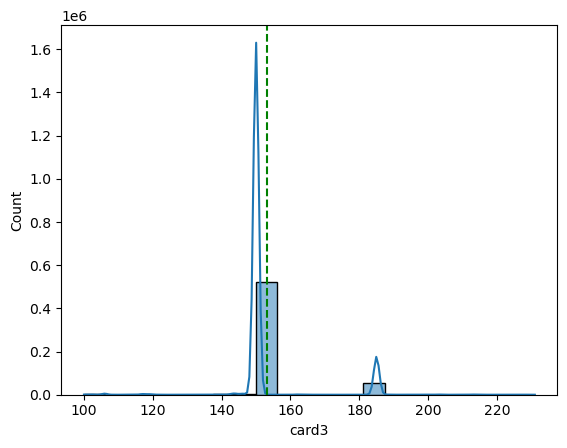

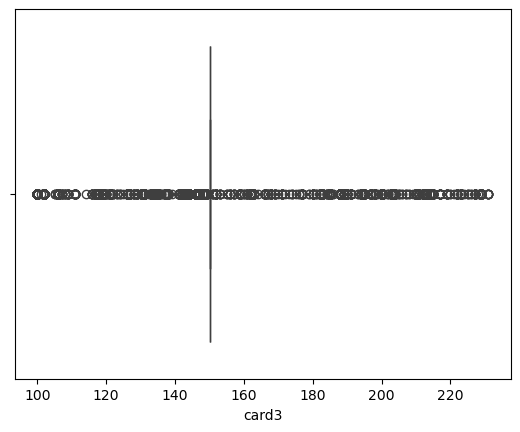


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    588975.000000
mean        153.194925
std          11.336444
min         100.000000
25%         150.000000
50%         150.000000
75%         150.000000
max         231.000000
Name: card3, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 8
Kolom :  card5


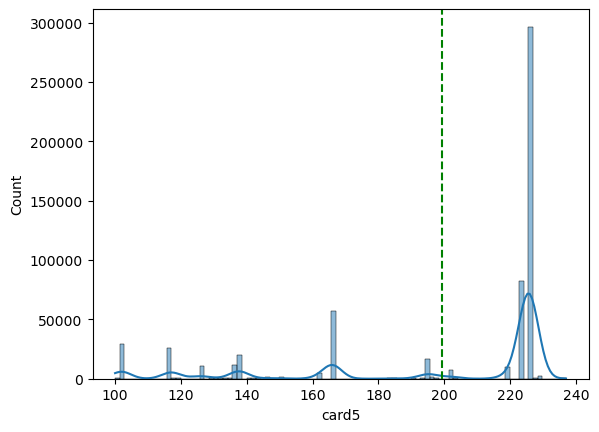

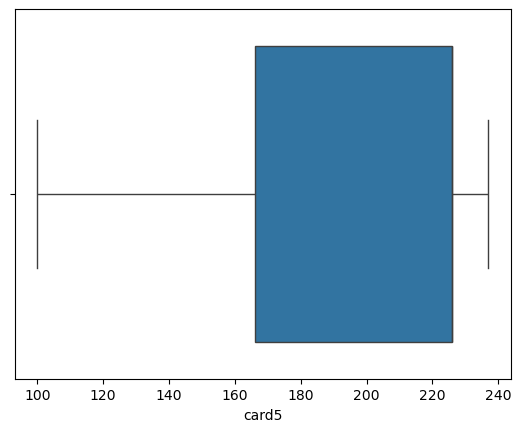


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    586281.000000
mean        199.278897
std          41.244453
min         100.000000
25%         166.000000
50%         226.000000
75%         226.000000
max         237.000000
Name: card5, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 9
Kolom :  addr1


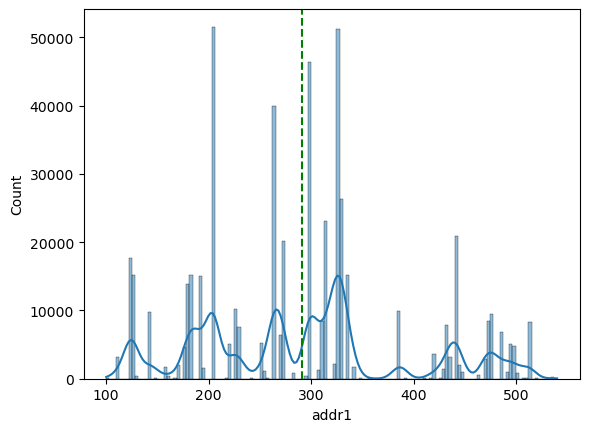

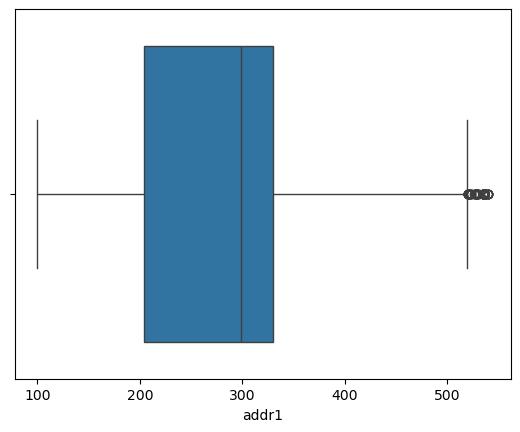


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    524834.000000
mean        290.733794
std         101.741072
min         100.000000
25%         204.000000
50%         299.000000
75%         330.000000
max         540.000000
Name: addr1, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 10
Kolom :  addr2


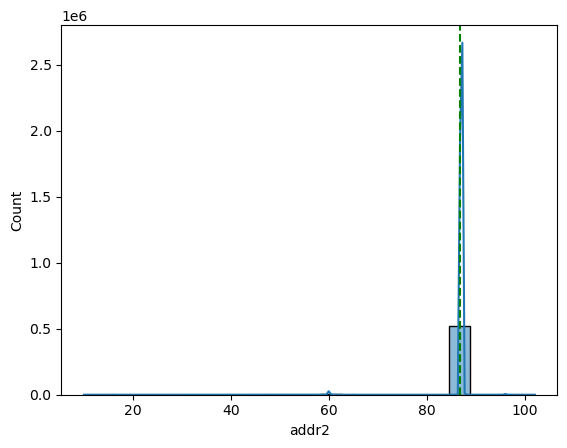

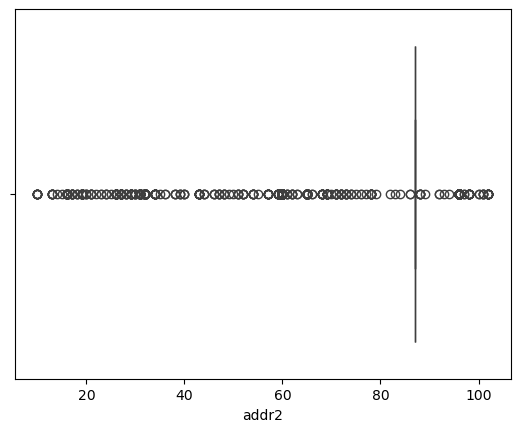


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    524834.000000
mean         86.800630
std           2.690623
min          10.000000
25%          87.000000
50%          87.000000
75%          87.000000
max         102.000000
Name: addr2, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 11
Kolom :  C1


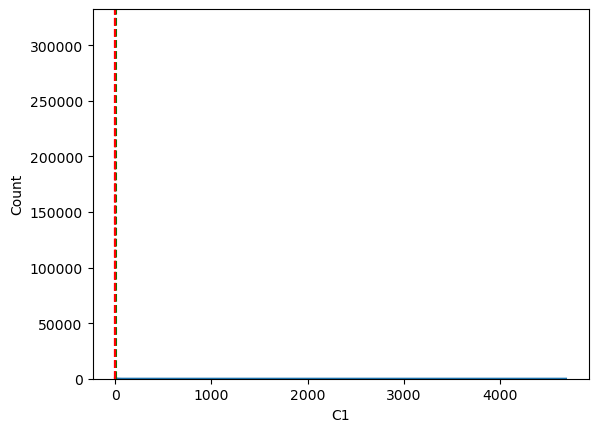

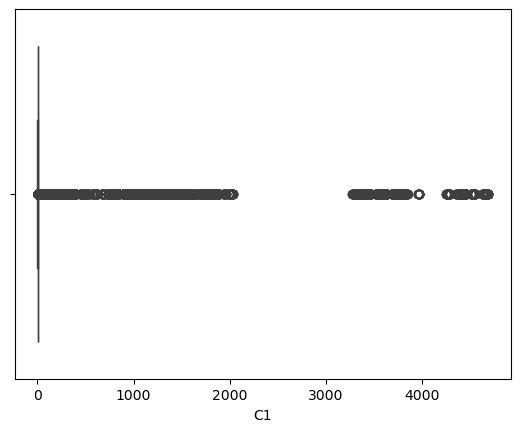


Skew Value :  23.95789879990789
Skew Test Value :  SkewtestResult(statistic=1043.2126615630368, pvalue=0.0)
count    590540.000000
mean         14.092458
std         133.569018
min           0.000000
25%           1.000000
50%           1.000000
75%           3.000000
max        4685.000000
Name: C1, dtype: float64

nilai max di luar outlier = 6.0
nilai min di luar outlier = 0.0
jumlah outlier:59535
outlier:
[127.0, 8.0, 92.0, 190.0, 8.0, 12.0, 7.0, 8.0, 7.0, 202.0, 202.0, 21.0, 8.0, 131.0, 16.0, 25.0, 8.0, 7.0, 7.0, 9.0, 199.0, 10.0, 149.0, 8.0, 82.0, 26.0, 7.0, 8.0, 8.0, 10.0, 7.0, 205.0, 205.0, 151.0, 15.0, 157.0, 103.0, 15.0, 105.0, 189.0, 8.0, 8.0, 8.0, 136.0, 10.0, 11.0, 28.0, 7.0, 9.0, 76.0, 9.0, 9.0, 160.0, 10.0, 11.0, 9.0, 7.0, 15.0, 155.0, 111.0, 129.0, 20.0, 18.0, 13.0, 13.0, 9.0, 7.0, 9.0, 10.0, 13.0, 35.0, 40.0, 35.0, 35.0, 133.0, 40.0, 8.0, 13.0, 11.0, 14.0, 39.0, 8.0, 96.0, 8.0, 10.0, 11.0, 47.0, 205.0, 18.0, 8.0, 106.0, 8.0, 14.0, 9.0, 10.0, 18.0, 111.0, 15.0, 11.0, 11

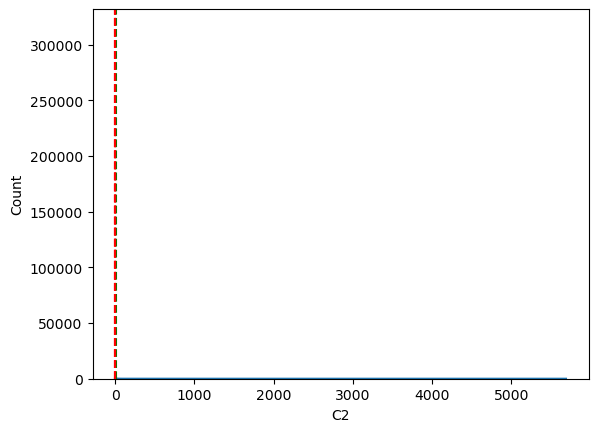

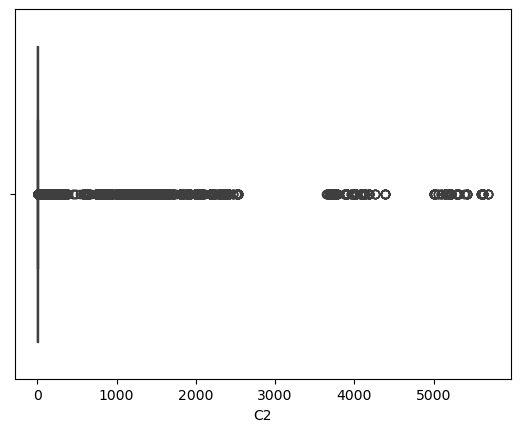


Skew Value :  23.677372565859134
Skew Test Value :  SkewtestResult(statistic=1040.1972820329459, pvalue=0.0)
count    590540.000000
mean         15.269734
std         154.668899
min           0.000000
25%           1.000000
50%           1.000000
75%           3.000000
max        5691.000000
Name: C2, dtype: float64

nilai max di luar outlier = 6.0
nilai min di luar outlier = 0.0
jumlah outlier:62214
outlier:
[120.0, 86.0, 145.0, 11.0, 208.0, 153.0, 25.0, 7.0, 120.0, 16.0, 20.0, 13.0, 7.0, 7.0, 183.0, 44.0, 9.0, 111.0, 7.0, 72.0, 25.0, 7.0, 8.0, 165.0, 165.0, 131.0, 10.0, 142.0, 100.0, 12.0, 86.0, 13.0, 173.0, 9.0, 7.0, 18.0, 117.0, 10.0, 8.0, 24.0, 12.0, 57.0, 65.0, 12.0, 58.0, 59.0, 163.0, 60.0, 10.0, 13.0, 14.0, 123.0, 111.0, 15.0, 104.0, 14.0, 13.0, 14.0, 58.0, 13.0, 13.0, 11.0, 15.0, 20.0, 36.0, 29.0, 29.0, 124.0, 36.0, 7.0, 13.0, 9.0, 10.0, 36.0, 7.0, 90.0, 7.0, 10.0, 9.0, 43.0, 165.0, 12.0, 9.0, 10.0, 7.0, 85.0, 17.0, 13.0, 11.0, 12.0, 106.0, 9.0, 9.0, 9.0, 172.0, 13.0, 13.0, 4

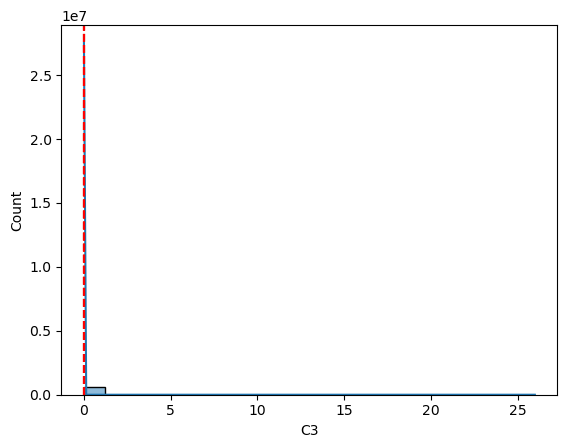

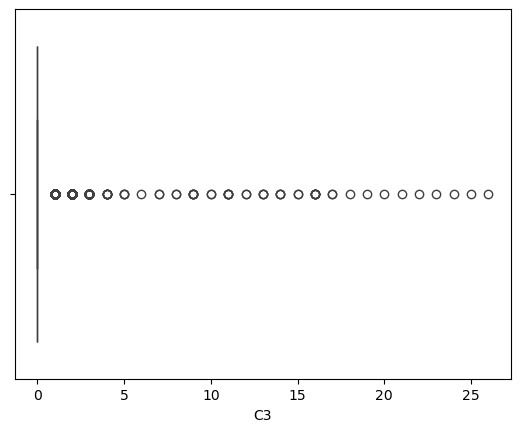


Skew Value :  88.94951970890979
Skew Test Value :  SkewtestResult(statistic=1379.1714984574335, pvalue=0.0)
count    590540.000000
mean          0.005644
std           0.150536
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          26.000000
Name: C3, dtype: float64

nilai max di luar outlier = 0.0
nilai min di luar outlier = 0.0
jumlah outlier:2429
outlier:
[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 8.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 3.0, 1.0, 1.0, 1.0, 1.0, 2.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.

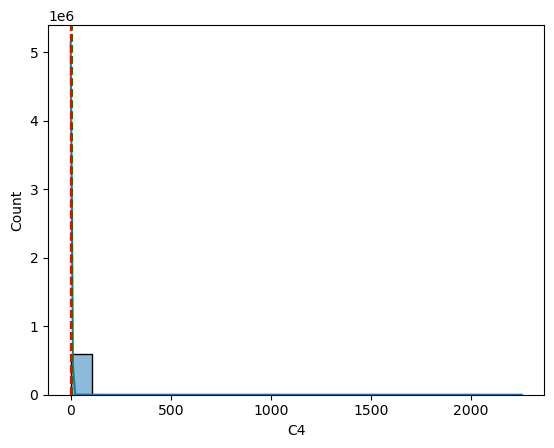

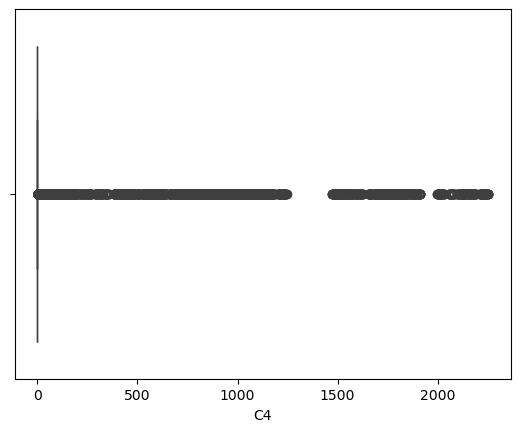


Skew Value :  22.077603004432817
Skew Test Value :  SkewtestResult(statistic=1022.2884871900861, pvalue=0.0)
count    590540.000000
mean          4.092185
std          68.848459
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max        2253.000000
Name: C4, dtype: float64

nilai max di luar outlier = 0.0
nilai min di luar outlier = 0.0
jumlah outlier:138657
outlier:
[1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 3.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 3.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 2.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 4.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 2.0, 1.0, 1.0, 2.0, 1.0, 1.0, 4.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,

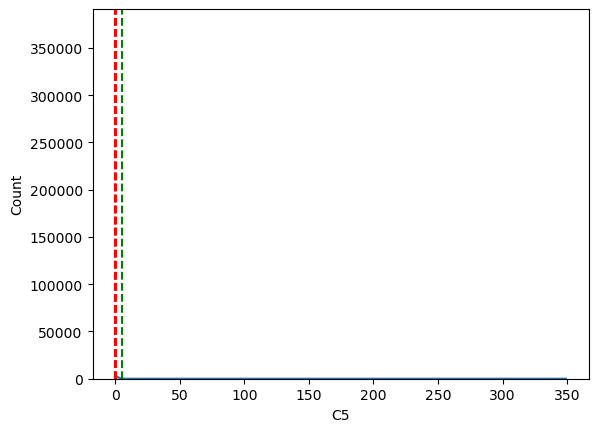

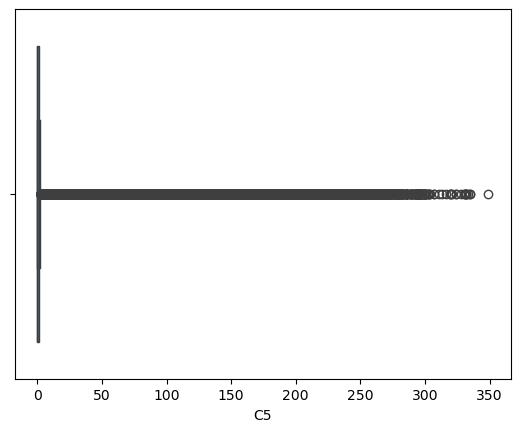


Skew Value :  5.793655326875996
Skew Test Value :  SkewtestResult(statistic=680.76798706362, pvalue=0.0)
count    590540.000000
mean          5.571526
std          25.786976
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max         349.000000
Name: C5, dtype: float64

nilai max di luar outlier = 2.0
nilai min di luar outlier = 0.0
jumlah outlier:60446
outlier:
[168.0, 3.0, 3.0, 121.0, 142.0, 5.0, 6.0, 128.0, 118.0, 33.0, 3.0, 4.0, 5.0, 103.0, 7.0, 4.0, 3.0, 10.0, 17.0, 4.0, 7.0, 8.0, 3.0, 3.0, 7.0, 123.0, 111.0, 8.0, 3.0, 152.0, 17.0, 6.0, 3.0, 3.0, 3.0, 4.0, 4.0, 137.0, 137.0, 147.0, 10.0, 116.0, 60.0, 11.0, 117.0, 88.0, 6.0, 72.0, 3.0, 5.0, 3.0, 26.0, 3.0, 56.0, 3.0, 87.0, 10.0, 134.0, 134.0, 3.0, 99.0, 17.0, 9.0, 3.0, 3.0, 3.0, 5.0, 3.0, 3.0, 10.0, 8.0, 3.0, 6.0, 4.0, 37.0, 134.0, 38.0, 14.0, 4.0, 15.0, 3.0, 31.0, 5.0, 130.0, 5.0, 5.0, 3.0, 9.0, 28.0, 137.0, 4.0, 3.0, 3.0, 4.0, 99.0, 3.0, 6.0, 3.0, 137.0, 170.0, 4.0, 5.0, 4.0, 37.0, 208

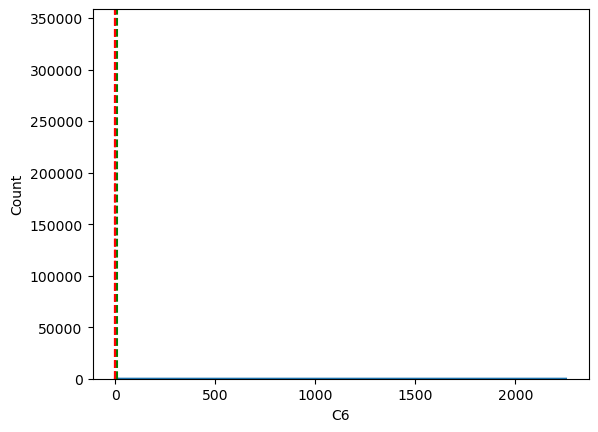

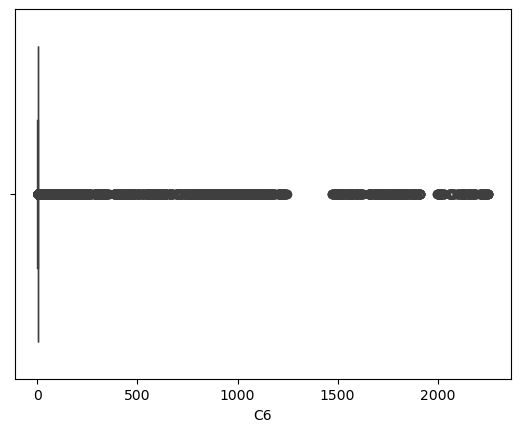


Skew Value :  19.766812326340414
Skew Test Value :  SkewtestResult(statistic=993.9888935268846, pvalue=0.0)
count    590540.000000
mean          9.071082
std          71.508467
min           0.000000
25%           1.000000
50%           1.000000
75%           2.000000
max        2253.000000
Name: C6, dtype: float64

nilai max di luar outlier = 3.0
nilai min di luar outlier = 0.0
jumlah outlier:78329
outlier:
[4.0, 5.0, 7.0, 99.0, 6.0, 72.0, 4.0, 147.0, 4.0, 7.0, 7.0, 6.0, 7.0, 181.0, 128.0, 22.0, 5.0, 101.0, 5.0, 12.0, 17.0, 4.0, 6.0, 4.0, 7.0, 139.0, 4.0, 6.0, 122.0, 4.0, 6.0, 68.0, 21.0, 5.0, 6.0, 5.0, 5.0, 5.0, 5.0, 128.0, 5.0, 128.0, 110.0, 9.0, 110.0, 84.0, 10.0, 73.0, 4.0, 152.0, 6.0, 4.0, 4.0, 6.0, 6.0, 113.0, 4.0, 11.0, 22.0, 7.0, 46.0, 57.0, 47.0, 48.0, 121.0, 48.0, 4.0, 10.0, 9.0, 4.0, 107.0, 93.0, 5.0, 71.0, 4.0, 14.0, 15.0, 4.0, 13.0, 10.0, 4.0, 10.0, 4.0, 10.0, 10.0, 13.0, 29.0, 5.0, 5.0, 110.0, 29.0, 4.0, 15.0, 11.0, 4.0, 27.0, 5.0, 76.0, 4.0, 11.0, 6.0, 6.0, 12.0, 40.0,

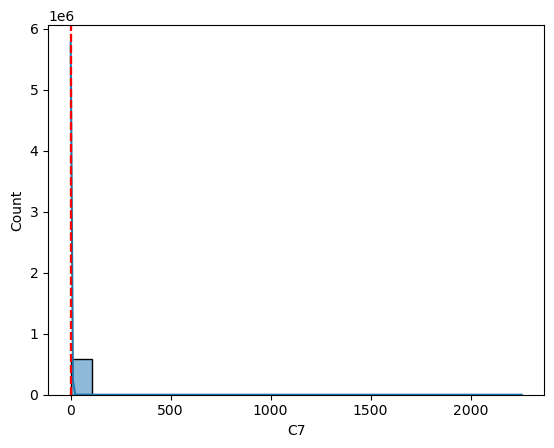

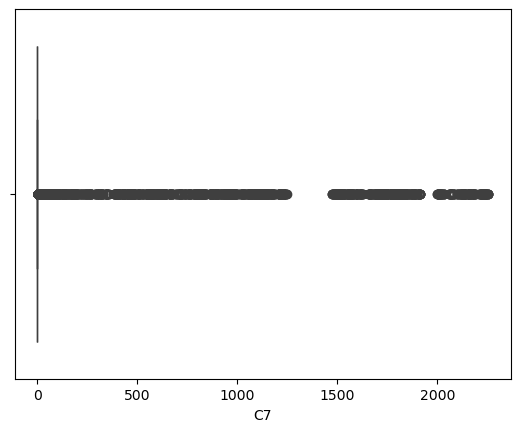


Skew Value :  27.193980641400834
Skew Test Value :  SkewtestResult(statistic=1075.6513145304518, pvalue=0.0)
count    590540.000000
mean          2.848478
std          61.727304
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max        2255.000000
Name: C7, dtype: float64

nilai max di luar outlier = 0.0
nilai min di luar outlier = 0.0
jumlah outlier:67398
outlier:
[1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 2.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 2.0, 1.0, 2.0, 1.0, 4.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 46.0, 3.0, 2.0, 1.0, 1.0, 47.0, 1.0, 1.0, 48.0, 1.0, 1.0, 48.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 3.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 2.0, 2.0, 1.0, 1

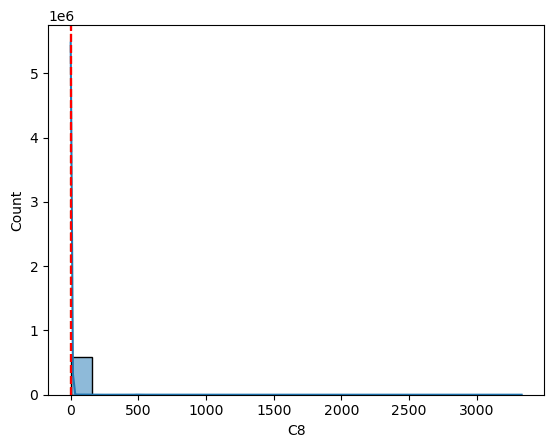

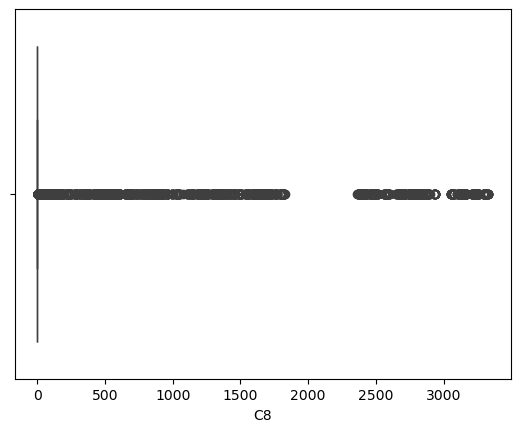


Skew Value :  26.083315619247568
Skew Test Value :  SkewtestResult(statistic=1064.9743704173893, pvalue=0.0)
count    590540.000000
mean          5.144574
std          95.378574
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max        3331.000000
Name: C8, dtype: float64

nilai max di luar outlier = 0.0
nilai min di luar outlier = 0.0
jumlah outlier:142873
outlier:
[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 6.0, 1.0, 1.0, 2.0, 1.0, 1.0, 5.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 13.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 4.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 49.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 12.0, 3.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 4.0, 2.0, 2.0, 1.0, 1.0, 3.0, 1

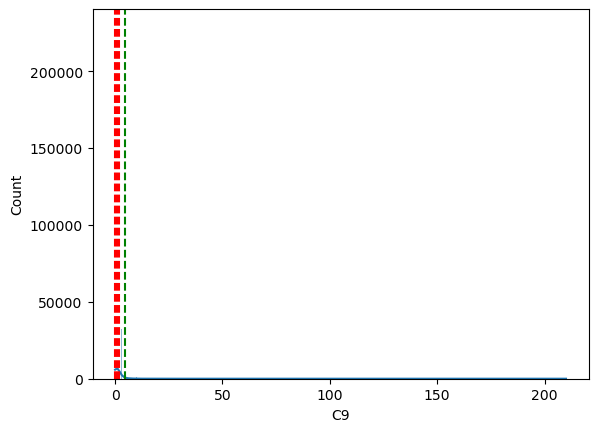

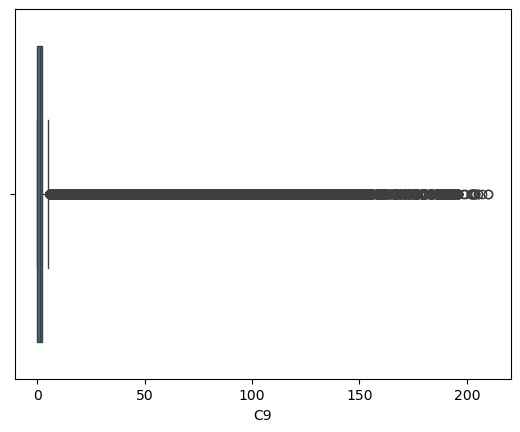


Skew Value :  5.693735519504577
Skew Test Value :  SkewtestResult(statistic=676.3559084191318, pvalue=0.0)
count    590540.000000
mean          4.480240
std          16.674897
min           0.000000
25%           0.000000
50%           1.000000
75%           2.000000
max         210.000000
Name: C9, dtype: float64

nilai max di luar outlier = 5.0
nilai min di luar outlier = 0.0
jumlah outlier:42629
outlier:
[81.0, 76.0, 129.0, 9.0, 64.0, 114.0, 17.0, 6.0, 79.0, 9.0, 14.0, 114.0, 6.0, 6.0, 97.0, 43.0, 13.0, 8.0, 8.0, 133.0, 133.0, 94.0, 88.0, 55.0, 8.0, 54.0, 116.0, 86.0, 20.0, 6.0, 52.0, 97.0, 7.0, 8.0, 95.0, 73.0, 6.0, 71.0, 12.0, 11.0, 6.0, 6.0, 6.0, 15.0, 7.0, 6.0, 7.0, 6.0, 15.0, 16.0, 26.0, 87.0, 26.0, 7.0, 7.0, 13.0, 10.0, 25.0, 72.0, 7.0, 7.0, 34.0, 133.0, 10.0, 59.0, 16.0, 7.0, 7.0, 10.0, 61.0, 51.0, 7.0, 7.0, 22.0, 97.0, 78.0, 19.0, 10.0, 7.0, 22.0, 66.0, 25.0, 10.0, 54.0, 25.0, 59.0, 62.0, 62.0, 74.0, 52.0, 73.0, 54.0, 8.0, 25.0, 25.0, 22.0, 17.0, 22.0, 7.0, 8.0, 63.0, 6.0, 

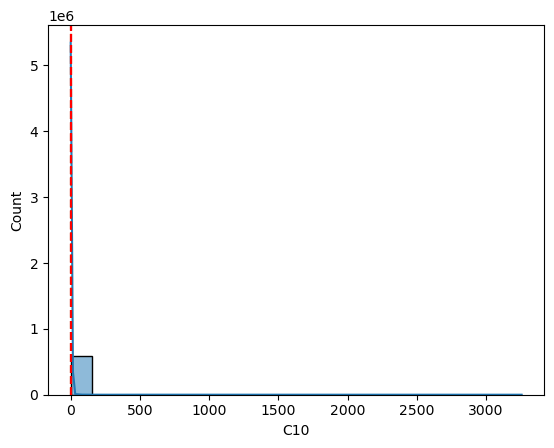

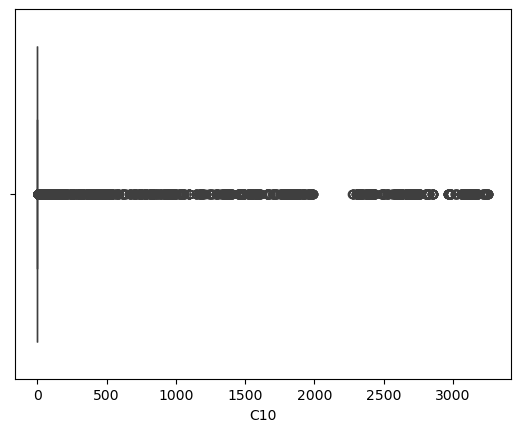


Skew Value :  25.22044958929219
Skew Test Value :  SkewtestResult(statistic=1056.361215172126, pvalue=0.0)
count    590540.000000
mean          5.240343
std          95.581443
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max        3257.000000
Name: C10, dtype: float64

nilai max di luar outlier = 0.0
nilai min di luar outlier = 0.0
jumlah outlier:137098
outlier:
[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 93.0, 1.0, 1.0, 2.0, 1.0, 1.0, 11.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 104.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 3.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 31.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 15.0, 3.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 3.0, 1.0, 1.0, 1.0, 1.0, 1.0, 5.0, 1.0, 1.0, 1.0, 1.0, 8.0, 1.0, 14.0, 1.0

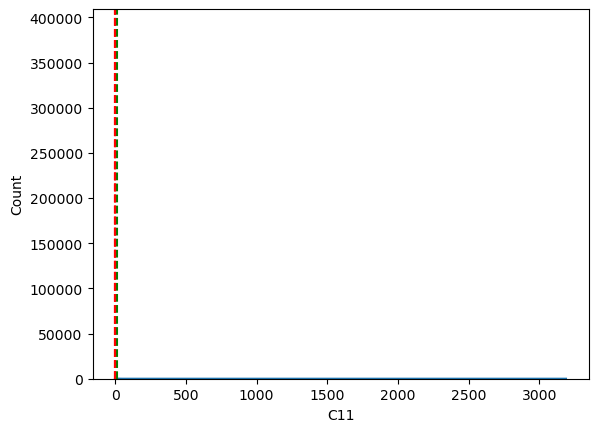

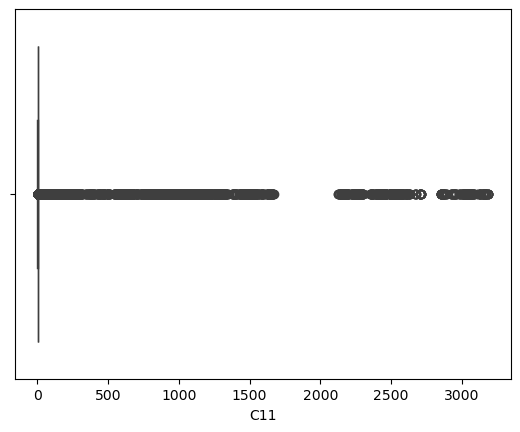


Skew Value :  22.35691808582392
Skew Test Value :  SkewtestResult(statistic=1025.5068402069182, pvalue=0.0)
count    590540.000000
mean         10.241521
std          94.336292
min           0.000000
25%           1.000000
50%           1.000000
75%           2.000000
max        3188.000000
Name: C11, dtype: float64

nilai max di luar outlier = 3.0
nilai min di luar outlier = 0.0
jumlah outlier:74844
outlier:
[5.0, 80.0, 4.0, 5.0, 73.0, 132.0, 4.0, 9.0, 5.0, 182.0, 134.0, 19.0, 8.0, 94.0, 5.0, 13.0, 18.0, 6.0, 7.0, 4.0, 4.0, 4.0, 7.0, 154.0, 4.0, 5.0, 98.0, 7.0, 54.0, 15.0, 6.0, 5.0, 4.0, 4.0, 4.0, 5.0, 6.0, 5.0, 137.0, 137.0, 103.0, 9.0, 117.0, 73.0, 12.0, 67.0, 4.0, 147.0, 4.0, 4.0, 4.0, 5.0, 4.0, 105.0, 5.0, 7.0, 23.0, 6.0, 4.0, 10.0, 52.0, 5.0, 5.0, 10.0, 10.0, 130.0, 10.0, 4.0, 7.0, 10.0, 5.0, 114.0, 84.0, 4.0, 77.0, 4.0, 14.0, 11.0, 5.0, 4.0, 11.0, 8.0, 7.0, 5.0, 7.0, 7.0, 4.0, 4.0, 14.0, 25.0, 24.0, 24.0, 98.0, 25.0, 5.0, 6.0, 11.0, 5.0, 10.0, 23.0, 4.0, 71.0, 4.0, 7.0, 4.0, 8.

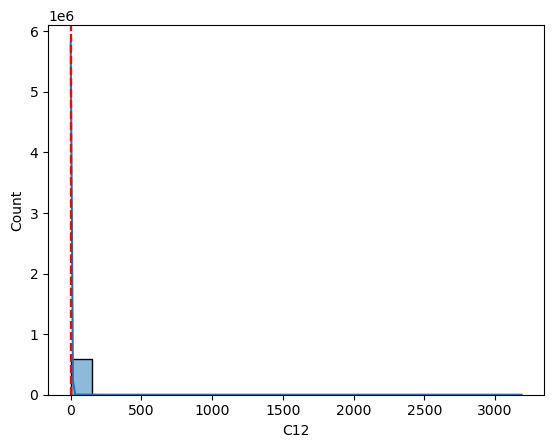

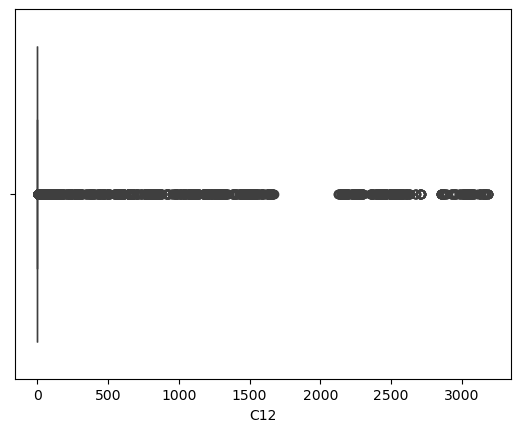


Skew Value :  27.415059849944786
Skew Test Value :  SkewtestResult(statistic=1077.7245031508244, pvalue=0.0)
count    590540.000000
mean          4.076227
std          86.666218
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max        3188.000000
Name: C12, dtype: float64

nilai max di luar outlier = 0.0
nilai min di luar outlier = 0.0
jumlah outlier:101341
outlier:
[2.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 2.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 2.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 4.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 3.0, 1.0, 4.0, 1.0, 1.0, 5.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 10.0, 5.0, 2.0, 1.0, 1.0, 10.0, 1.0, 1.0, 10.0, 1.0, 1.0, 10.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 5.0, 1.0, 1.0, 1.0, 8.0, 1.0, 1.0, 1.0, 2.0, 1.0, 4.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0,

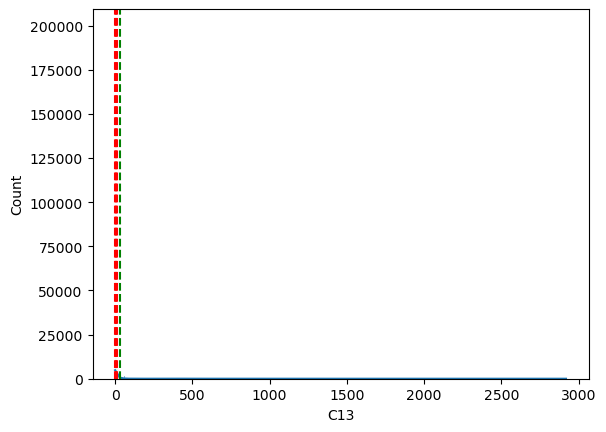

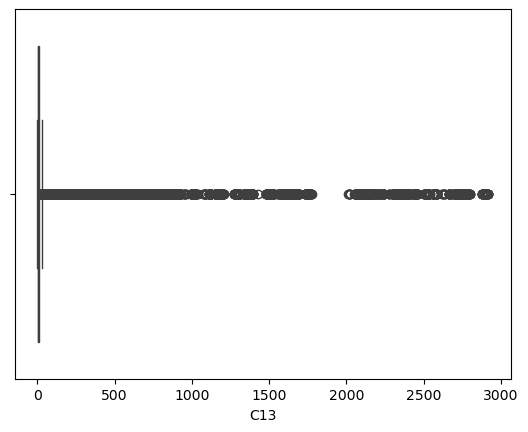


Skew Value :  8.98639448202703
Skew Test Value :  SkewtestResult(statistic=792.4749788595045, pvalue=0.0)
count    590540.000000
mean         32.539918
std         129.364844
min           0.000000
25%           1.000000
50%           3.000000
75%          12.000000
max        2918.000000
Name: C13, dtype: float64

nilai max di luar outlier = 28.0
nilai min di luar outlier = 0.0
jumlah outlier:75631
outlier:
[673.0, 498.0, 96.0, 527.0, 34.0, 39.0, 45.0, 258.0, 483.0, 99.0, 43.0, 453.0, 52.0, 88.0, 32.0, 34.0, 31.0, 201.0, 37.0, 32.0, 47.0, 478.0, 30.0, 408.0, 478.0, 99.0, 30.0, 36.0, 45.0, 44.0, 788.0, 45.0, 789.0, 615.0, 54.0, 510.0, 421.0, 390.0, 34.0, 438.0, 57.0, 79.0, 35.0, 57.0, 32.0, 57.0, 337.0, 78.0, 38.0, 30.0, 156.0, 91.0, 322.0, 506.0, 34.0, 110.0, 91.0, 489.0, 579.0, 42.0, 448.0, 47.0, 117.0, 95.0, 105.0, 110.0, 32.0, 34.0, 111.0, 29.0, 33.0, 33.0, 126.0, 163.0, 54.0, 54.0, 463.0, 164.0, 59.0, 37.0, 69.0, 173.0, 40.0, 513.0, 40.0, 180.0, 790.0, 30.0, 33.0, 427.0, 106.0, 1

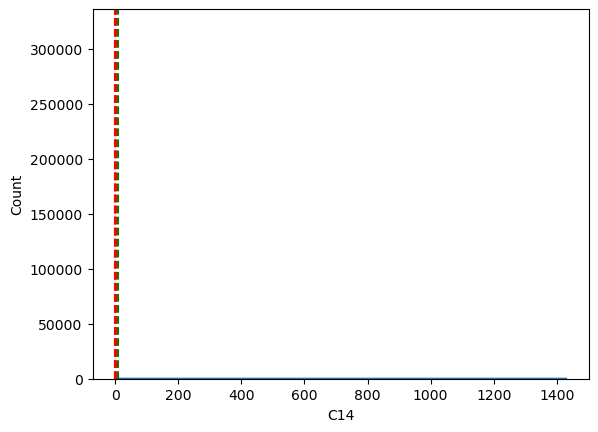

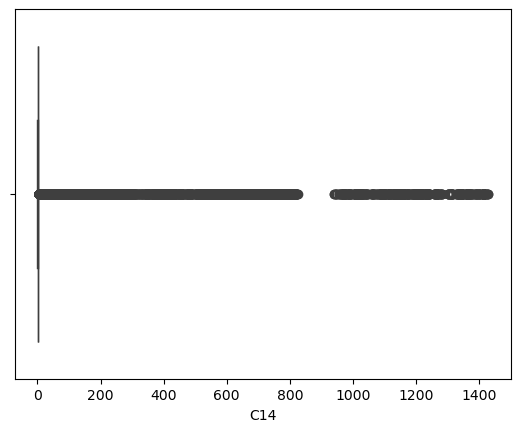


Skew Value :  16.534844624762897
Skew Test Value :  SkewtestResult(statistic=948.3017127516274, pvalue=0.0)
count    590540.000000
mean          8.295215
std          49.544262
min           0.000000
25%           1.000000
50%           1.000000
75%           2.000000
max        1429.000000
Name: C14, dtype: float64

nilai max di luar outlier = 3.0
nilai min di luar outlier = 0.0
jumlah outlier:96090
outlier:
[6.0, 111.0, 5.0, 79.0, 148.0, 7.0, 4.0, 10.0, 6.0, 5.0, 4.0, 4.0, 6.0, 108.0, 155.0, 4.0, 18.0, 7.0, 105.0, 5.0, 10.0, 4.0, 19.0, 5.0, 7.0, 7.0, 5.0, 7.0, 9.0, 173.0, 9.0, 106.0, 4.0, 7.0, 5.0, 72.0, 23.0, 6.0, 4.0, 8.0, 4.0, 4.0, 5.0, 8.0, 4.0, 9.0, 159.0, 4.0, 159.0, 5.0, 127.0, 4.0, 11.0, 139.0, 82.0, 4.0, 13.0, 90.0, 4.0, 143.0, 7.0, 5.0, 5.0, 7.0, 4.0, 7.0, 104.0, 8.0, 10.0, 20.0, 4.0, 5.0, 4.0, 70.0, 4.0, 4.0, 4.0, 110.0, 4.0, 7.0, 6.0, 7.0, 14.0, 4.0, 125.0, 103.0, 4.0, 112.0, 4.0, 19.0, 5.0, 11.0, 4.0, 12.0, 8.0, 6.0, 6.0, 4.0, 6.0, 5.0, 10.0, 4.0, 9.0, 4.0, 4.0, 21.0, 3

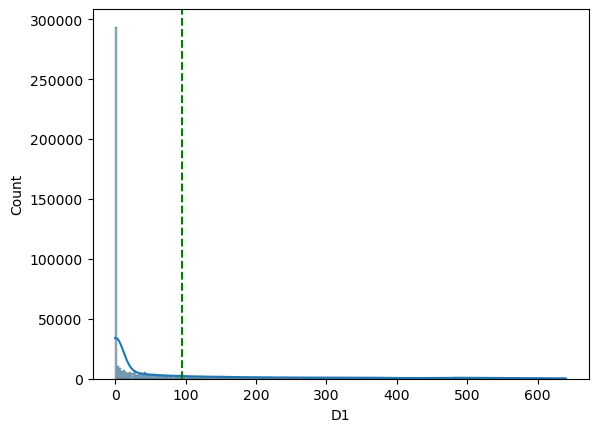

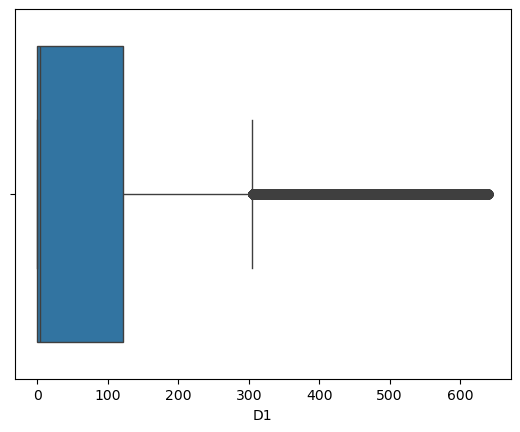


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    589271.000000
mean         94.347568
std         157.660387
min           0.000000
25%           0.000000
50%           3.000000
75%         122.000000
max         640.000000
Name: D1, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 26
Kolom :  D4


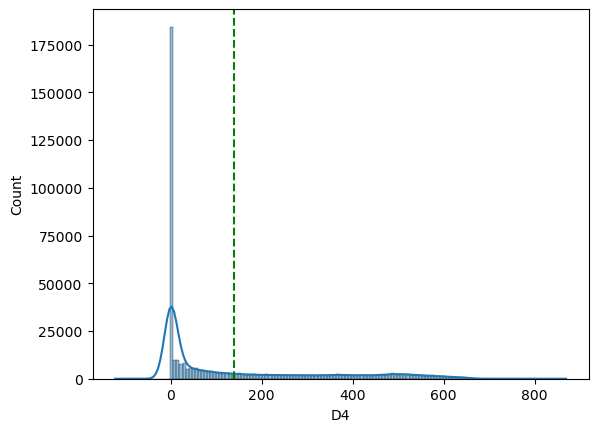

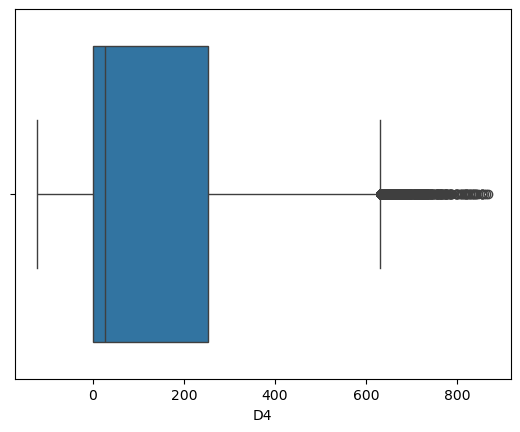


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421618.000000
mean        140.002441
std         191.096774
min        -122.000000
25%           0.000000
50%          26.000000
75%         253.000000
max         869.000000
Name: D4, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 27
Kolom :  D10


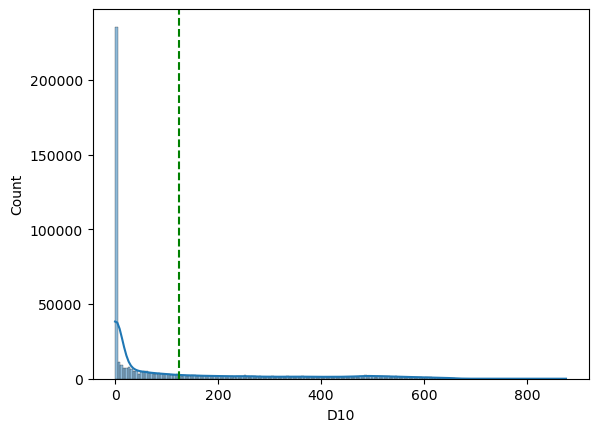

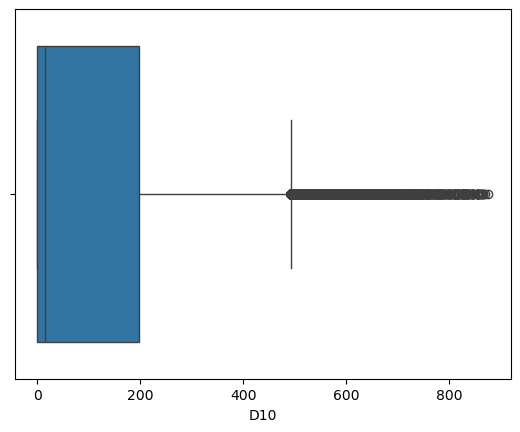


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514518.000000
mean        123.982137
std         182.615225
min           0.000000
25%           0.000000
50%          15.000000
75%         197.000000
max         876.000000
Name: D10, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 28
Kolom :  D15


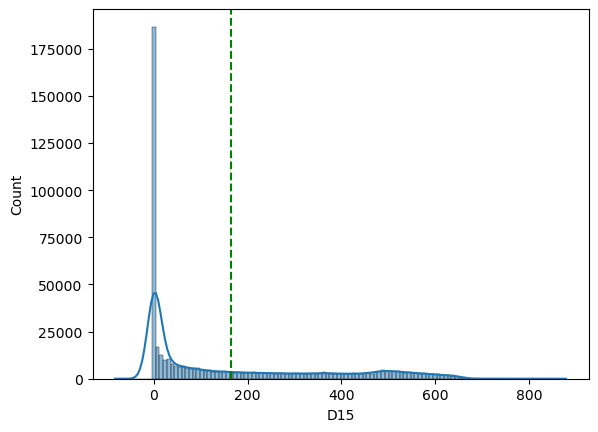

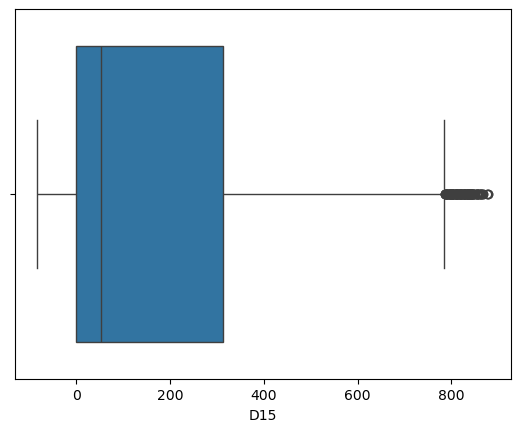


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501427.000000
mean        163.744579
std         202.726660
min         -83.000000
25%           0.000000
50%          52.000000
75%         314.000000
max         879.000000
Name: D15, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 29
Kolom :  V12


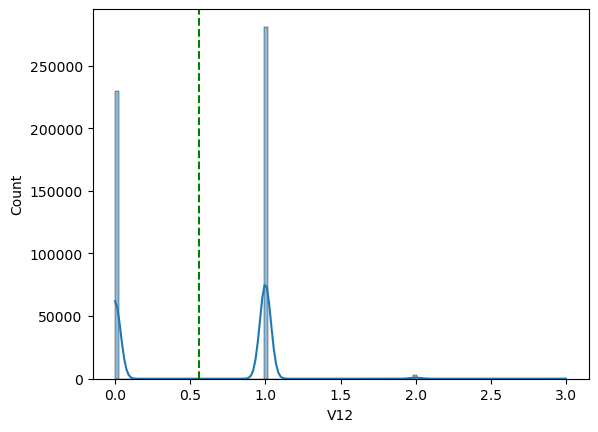

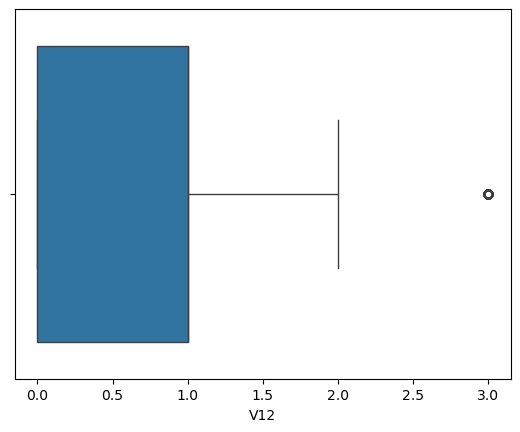


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.559711
std           0.510533
min           0.000000
25%           0.000000
50%           1.000000
75%           1.000000
max           3.000000
Name: V12, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 30
Kolom :  V13


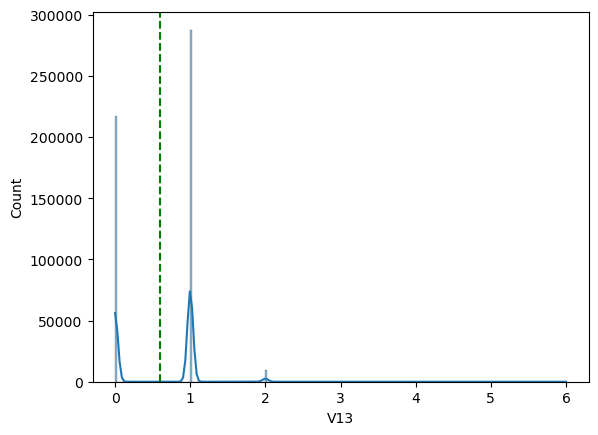

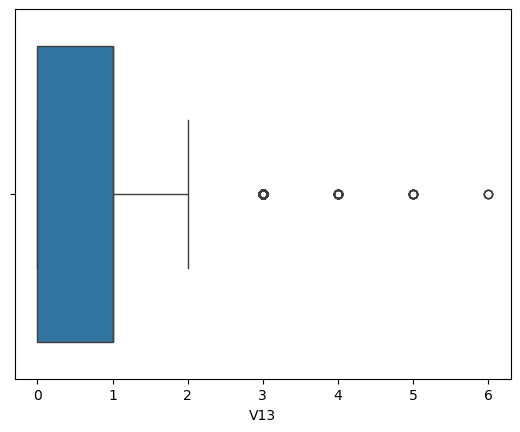


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.599166
std           0.532185
min           0.000000
25%           0.000000
50%           1.000000
75%           1.000000
max           6.000000
Name: V13, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 31
Kolom :  V14


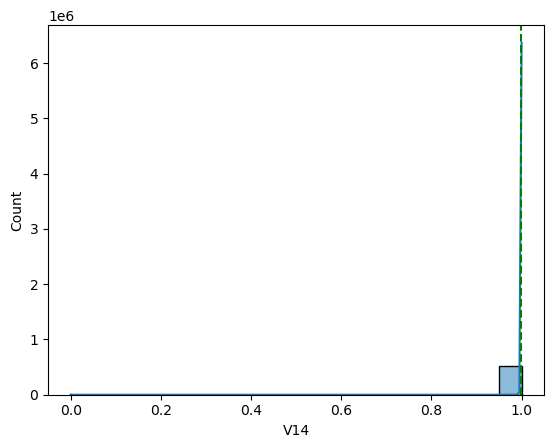

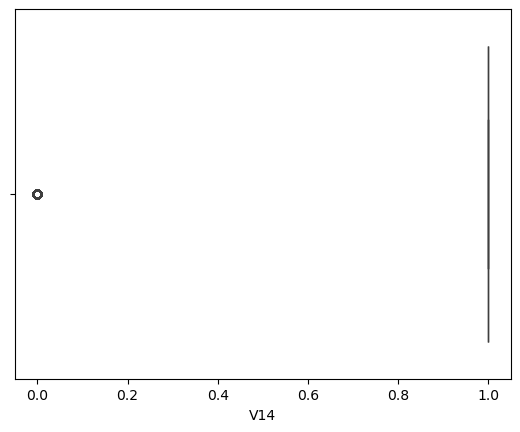


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.999500
std           0.022345
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           1.000000
Name: V14, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 32
Kolom :  V15


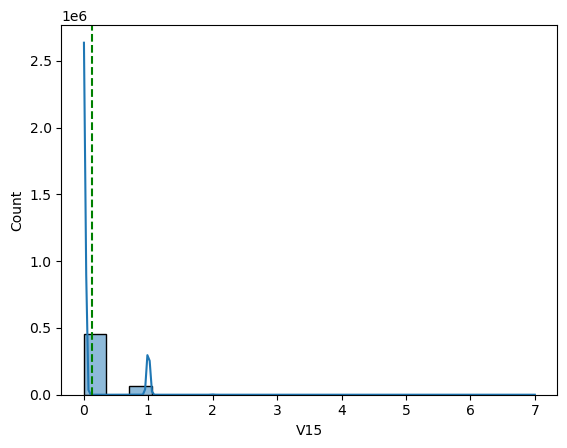

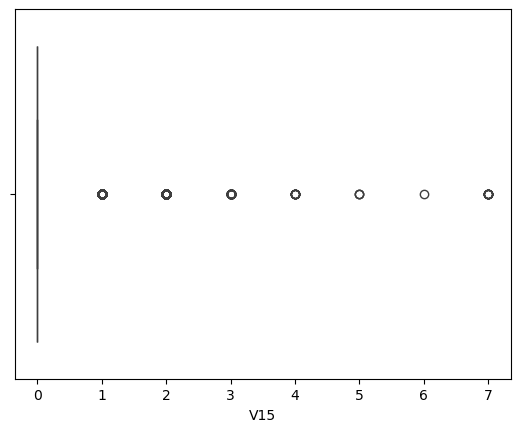


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.122342
std           0.332422
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           7.000000
Name: V15, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 33
Kolom :  V16


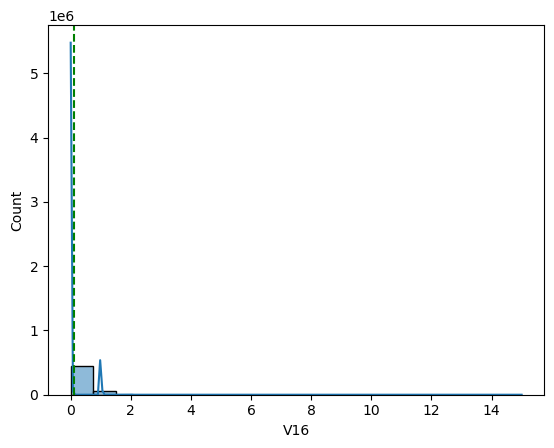

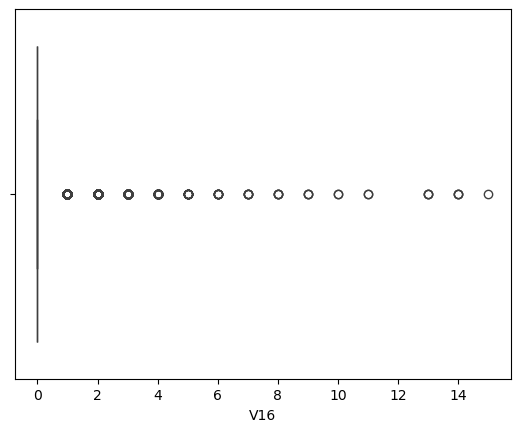


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.123460
std           0.342841
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          15.000000
Name: V16, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 34
Kolom :  V17


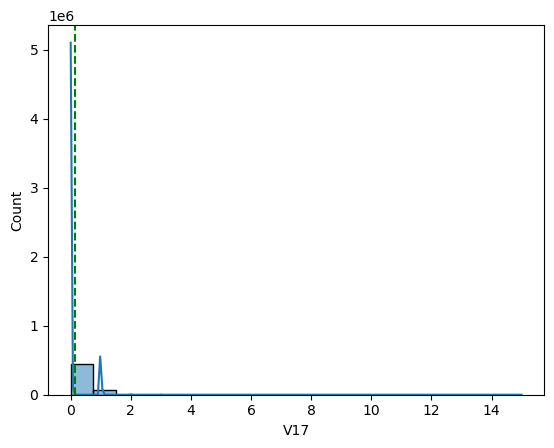

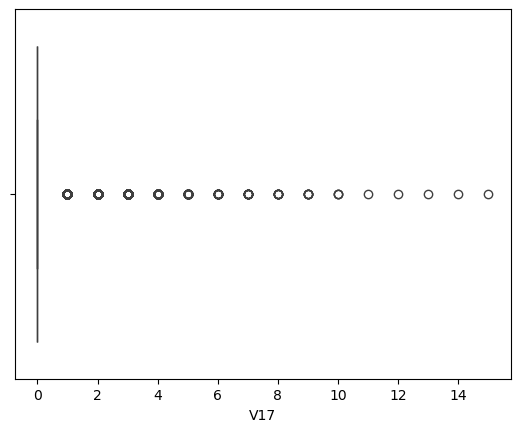


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.134040
std           0.364456
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          15.000000
Name: V17, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 35
Kolom :  V18


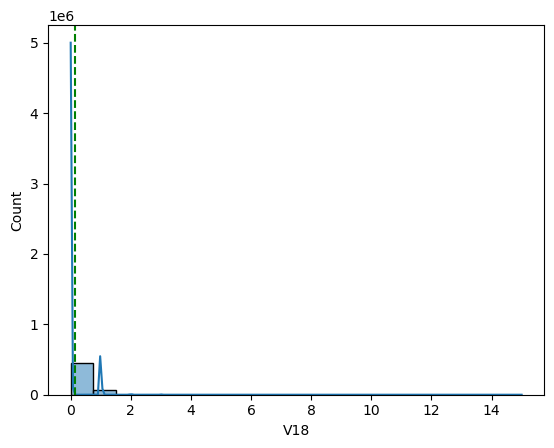

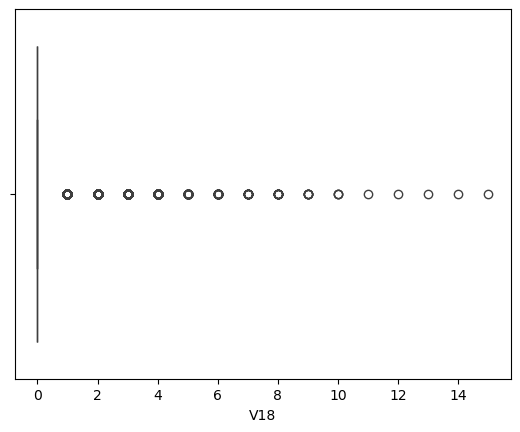


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.135363
std           0.371763
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          15.000000
Name: V18, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 36
Kolom :  V19


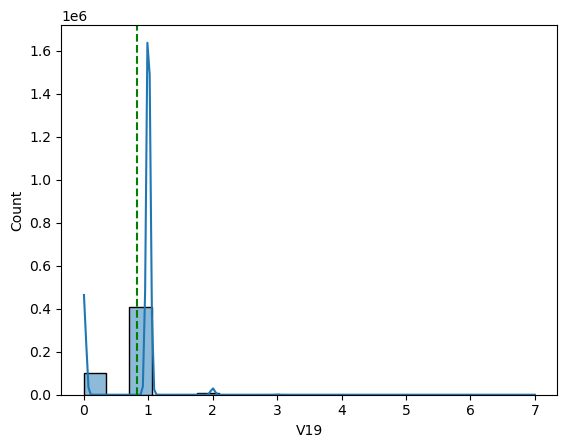

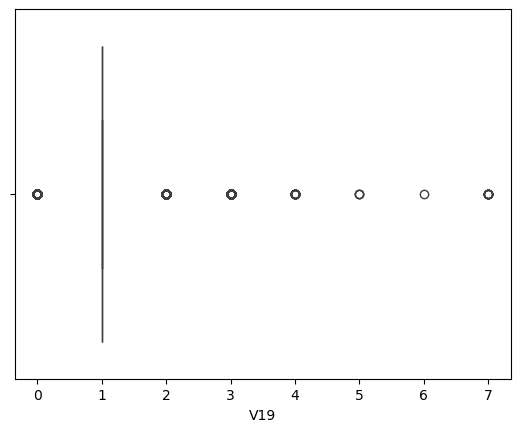


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.816371
std           0.425512
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           7.000000
Name: V19, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 37
Kolom :  V20


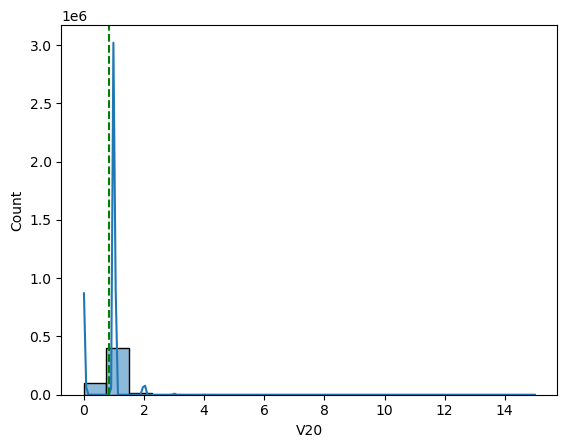

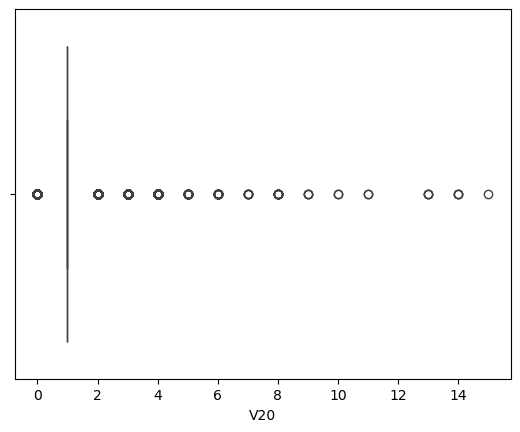


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.847843
std           0.459451
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          15.000000
Name: V20, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 38
Kolom :  V21


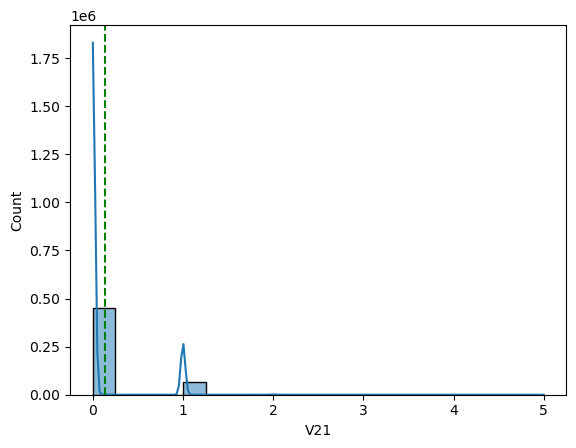

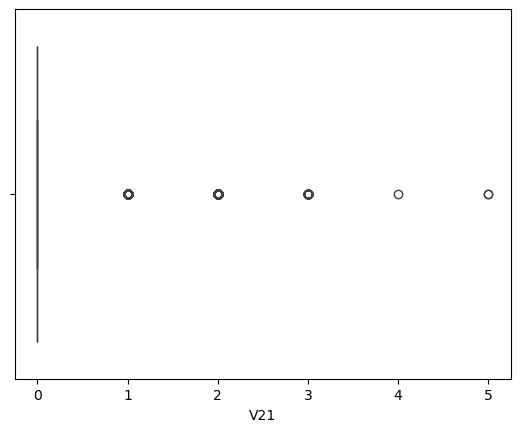


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.129684
std           0.339060
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           5.000000
Name: V21, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 39
Kolom :  V22


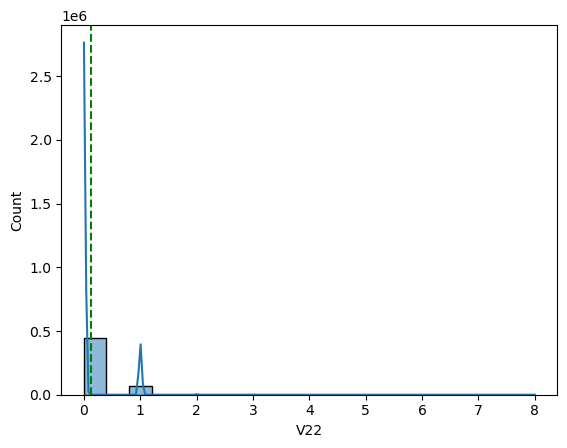

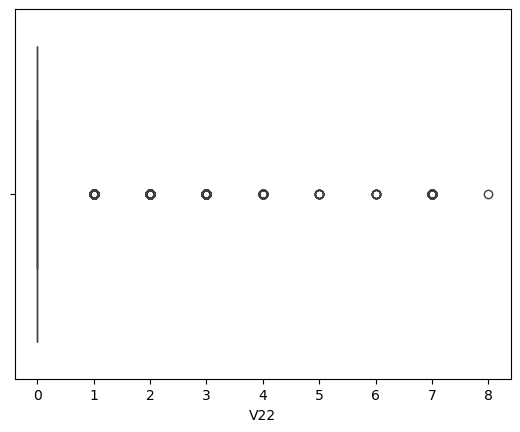


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.132292
std           0.359415
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           8.000000
Name: V22, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 40
Kolom :  V23


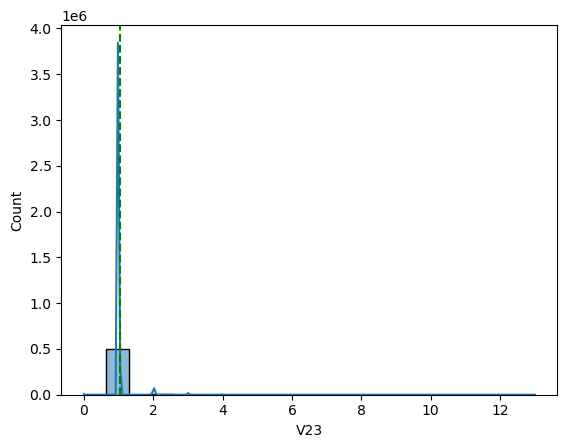

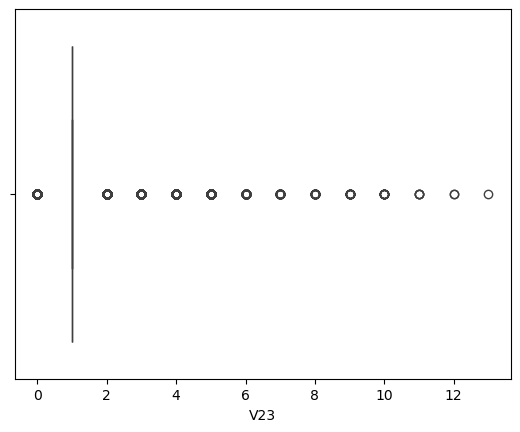


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          1.034791
std           0.247681
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          13.000000
Name: V23, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 41
Kolom :  V24


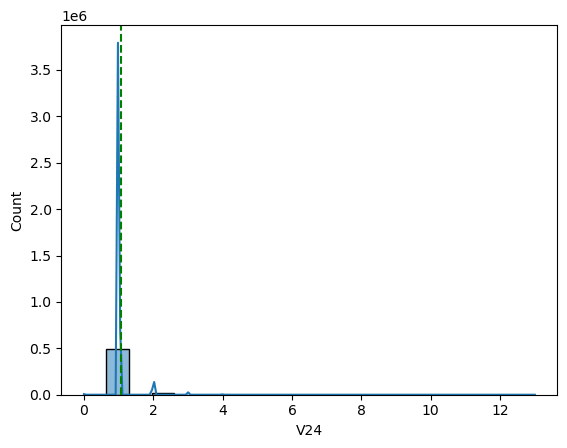

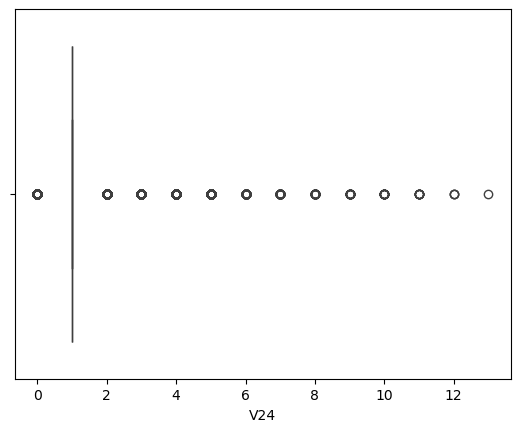


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          1.058097
std           0.305485
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          13.000000
Name: V24, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 42
Kolom :  V25


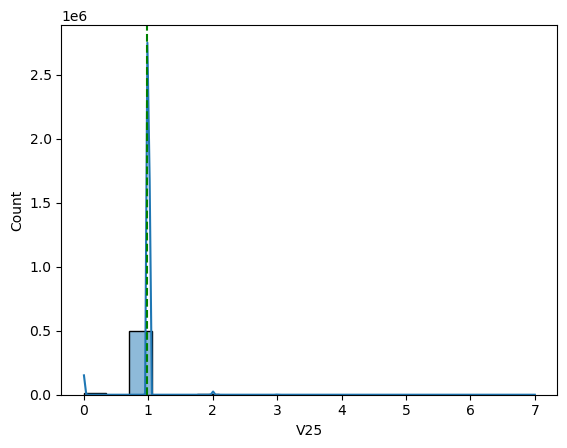

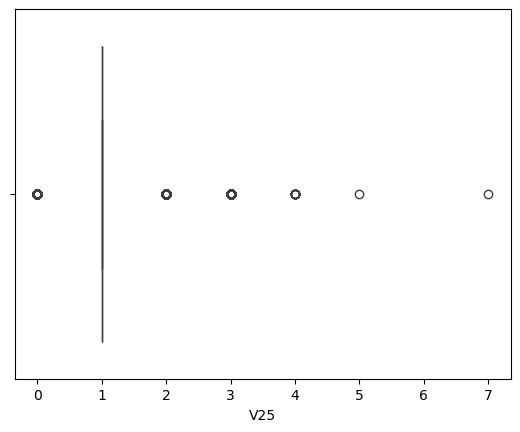


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.977660
std           0.185245
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           7.000000
Name: V25, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 43
Kolom :  V26


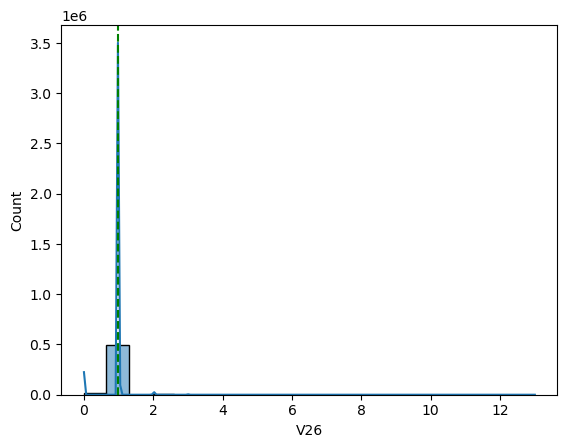

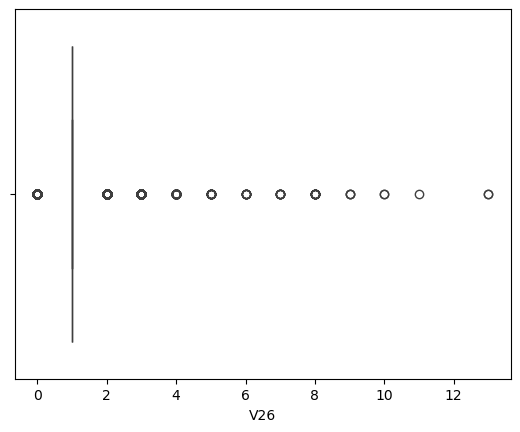


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.988040
std           0.209302
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          13.000000
Name: V26, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 44
Kolom :  V27


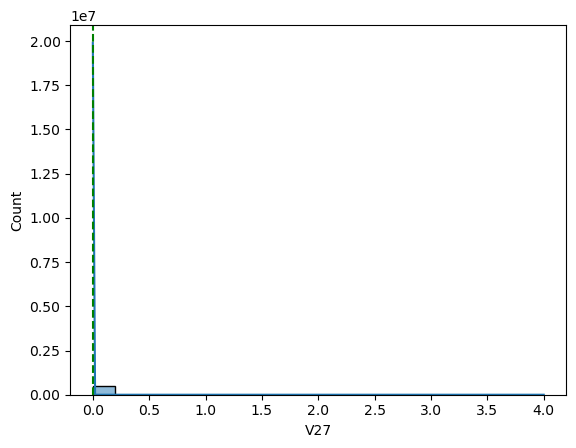

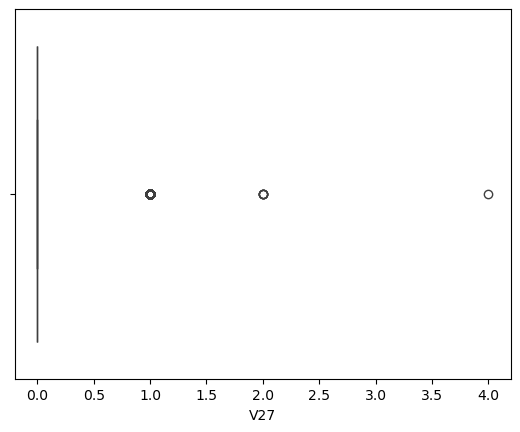


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.000776
std           0.028596
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           4.000000
Name: V27, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 45
Kolom :  V28


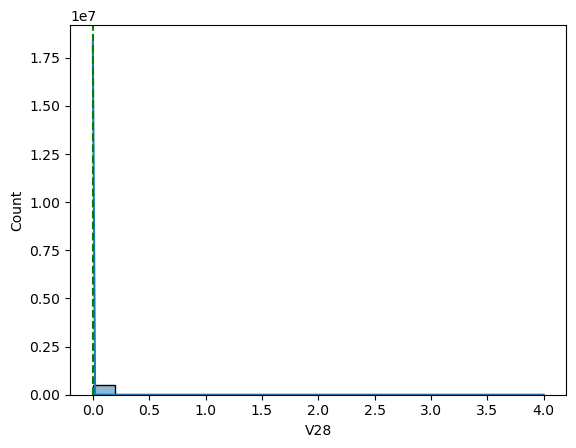

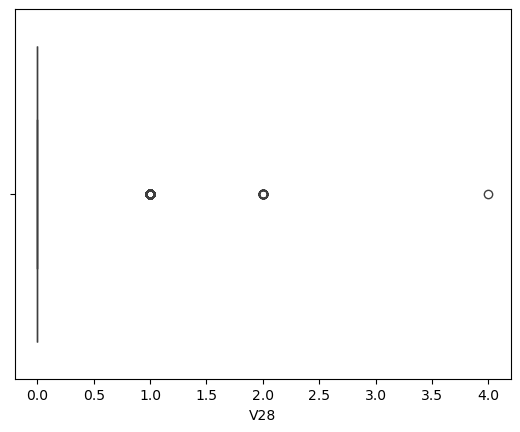


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.000830
std           0.031133
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           4.000000
Name: V28, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 46
Kolom :  V29


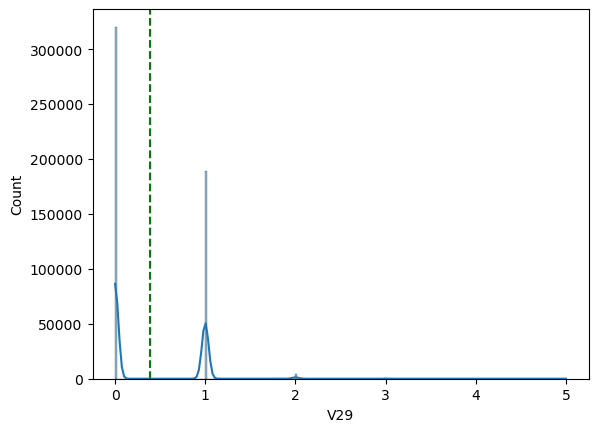

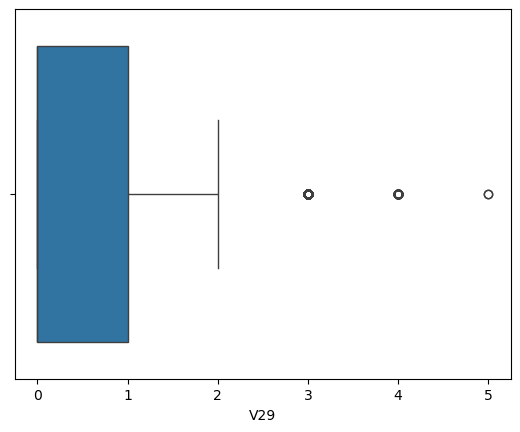


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.387840
std           0.510652
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max           5.000000
Name: V29, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 47
Kolom :  V30


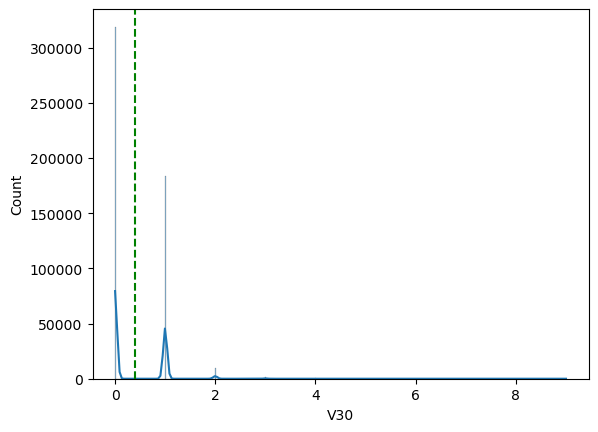

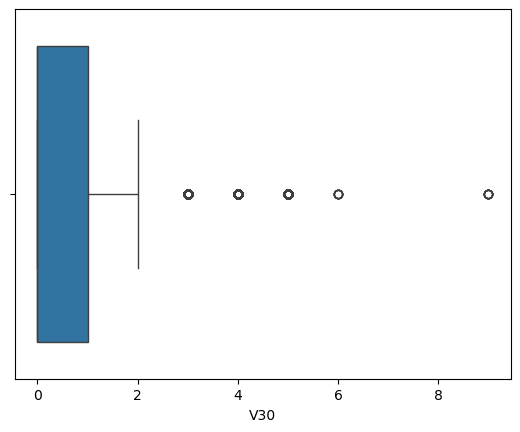


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.406436
std           0.554311
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max           9.000000
Name: V30, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 48
Kolom :  V31


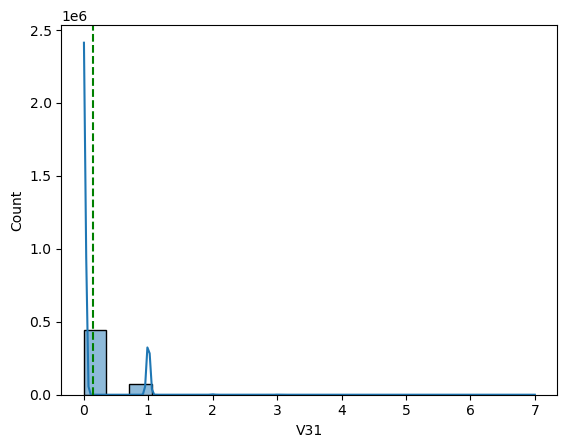

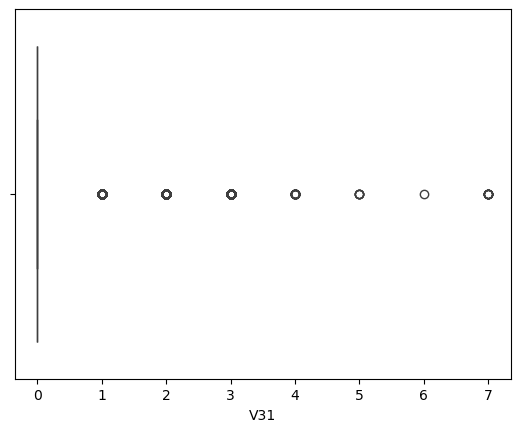


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.140761
std           0.355793
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           7.000000
Name: V31, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 49
Kolom :  V32


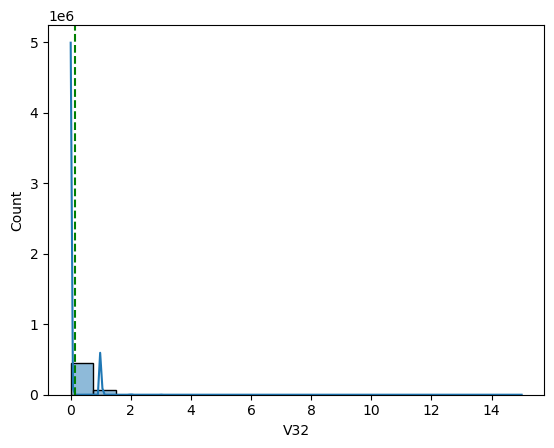

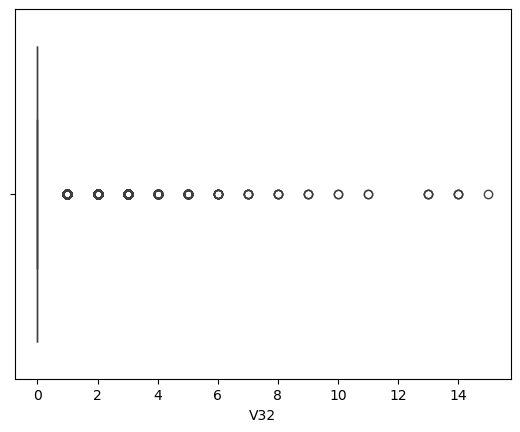


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.142417
std           0.368278
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          15.000000
Name: V32, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 50
Kolom :  V33


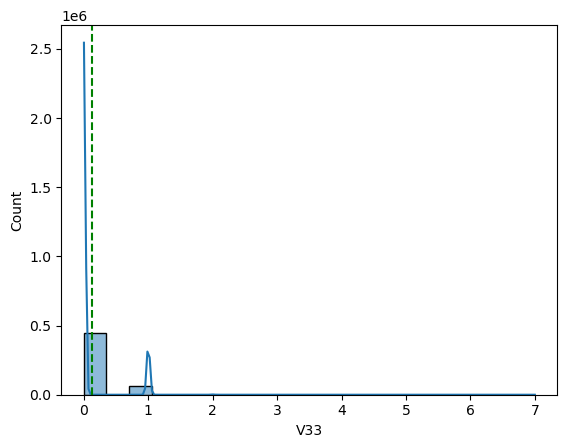

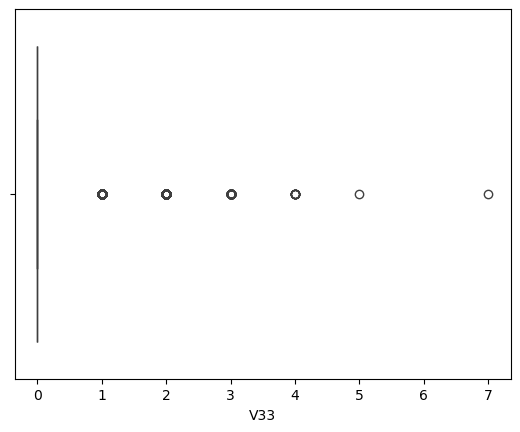


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.130693
std           0.340900
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           7.000000
Name: V33, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 51
Kolom :  V34


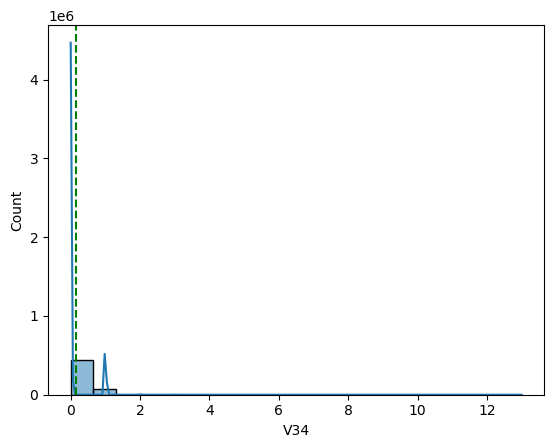

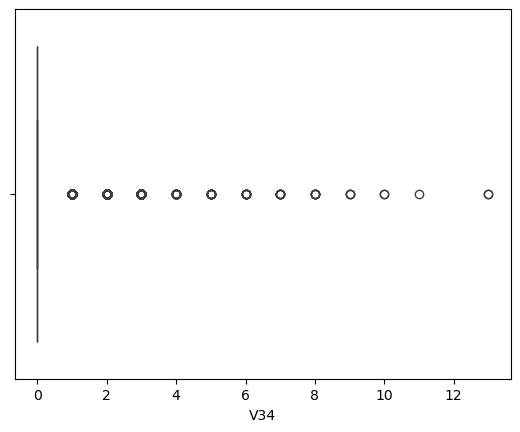


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    514467.000000
mean          0.139154
std           0.357549
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          13.000000
Name: V34, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 52
Kolom :  V35


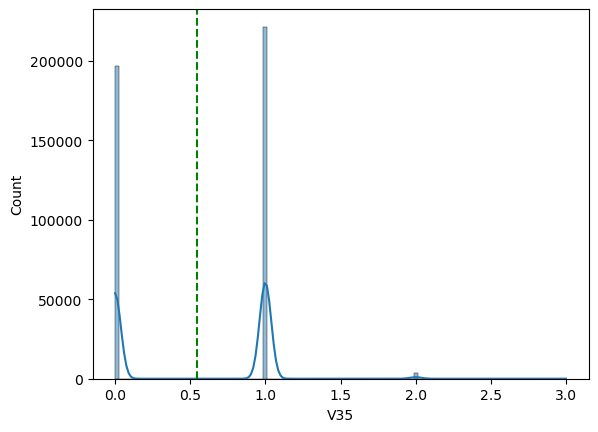

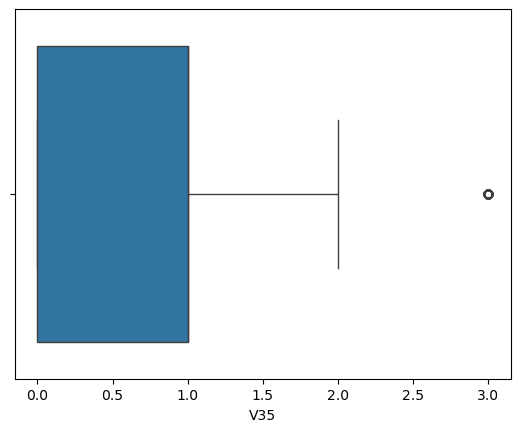


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          0.542594
std           0.516010
min           0.000000
25%           0.000000
50%           1.000000
75%           1.000000
max           3.000000
Name: V35, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 53
Kolom :  V36


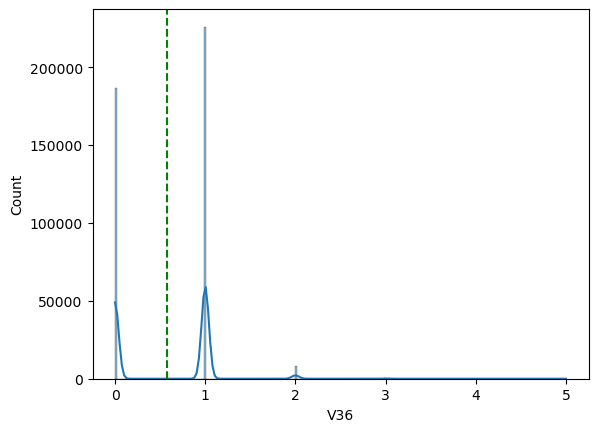

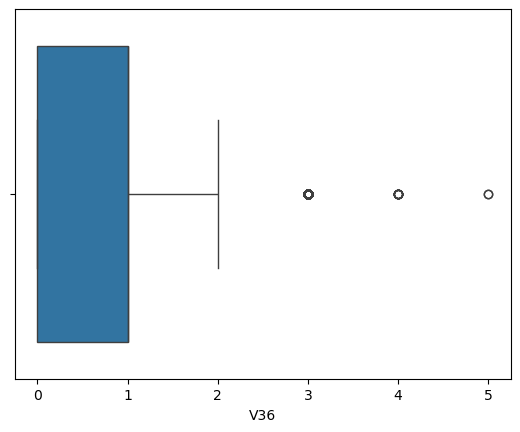


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          0.579198
std           0.539039
min           0.000000
25%           0.000000
50%           1.000000
75%           1.000000
max           5.000000
Name: V36, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 54
Kolom :  V37


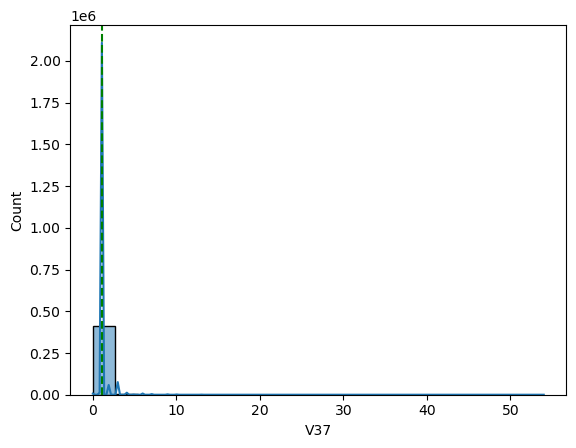

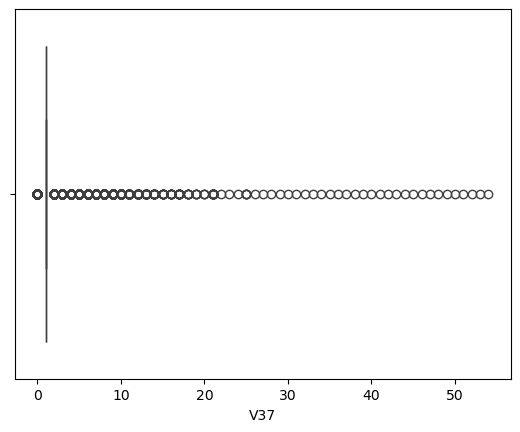


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          1.108065
std           0.690571
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          54.000000
Name: V37, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 55
Kolom :  V38


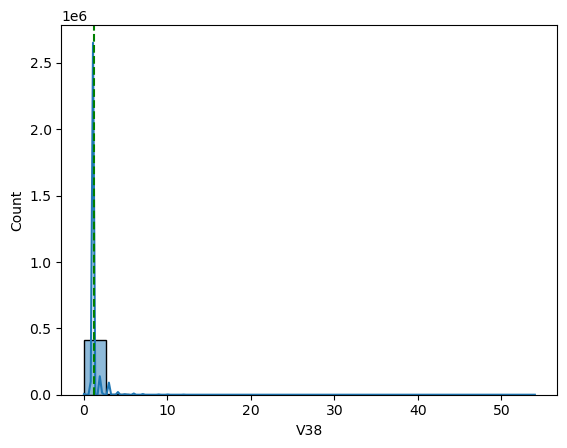

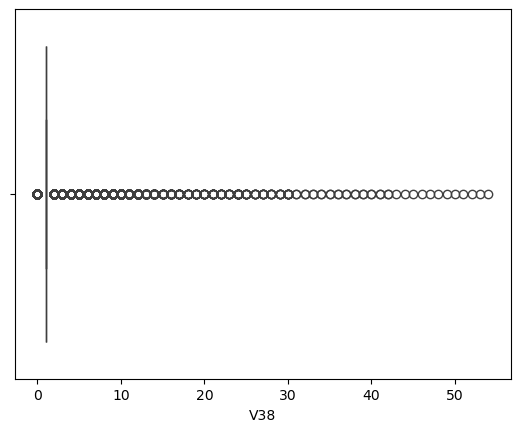


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.00000
mean          1.16240
std           0.85892
min           0.00000
25%           1.00000
50%           1.00000
75%           1.00000
max          54.00000
Name: V38, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 56
Kolom :  V39


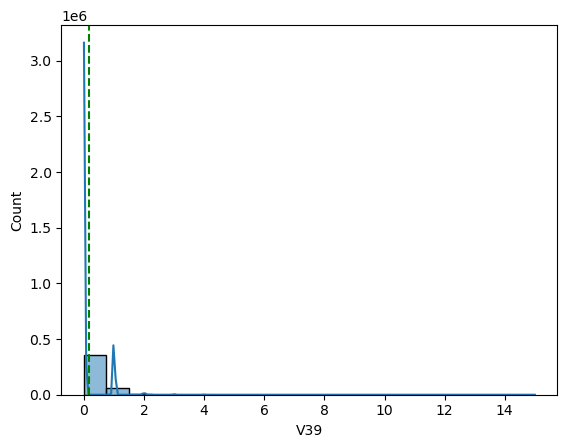

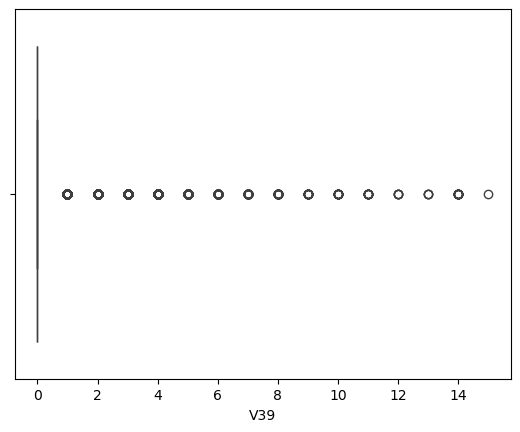


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          0.166076
std           0.451956
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          15.000000
Name: V39, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 57
Kolom :  V40


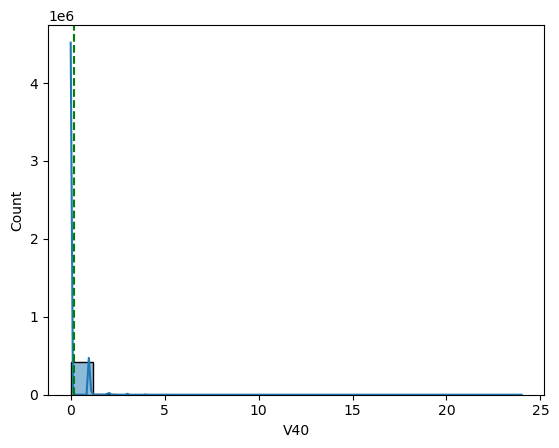

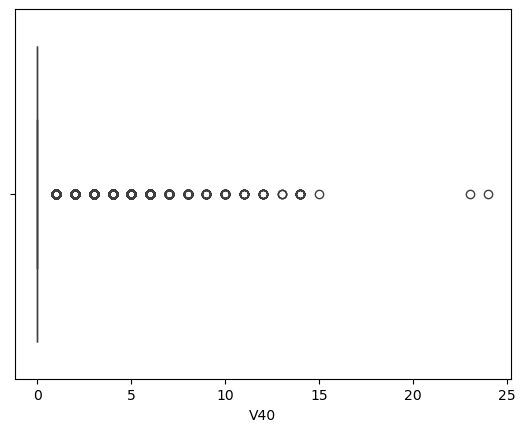


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          0.177145
std           0.505786
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          24.000000
Name: V40, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 58
Kolom :  V41


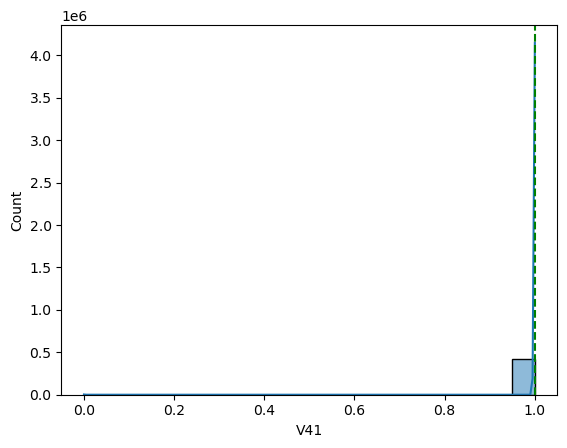

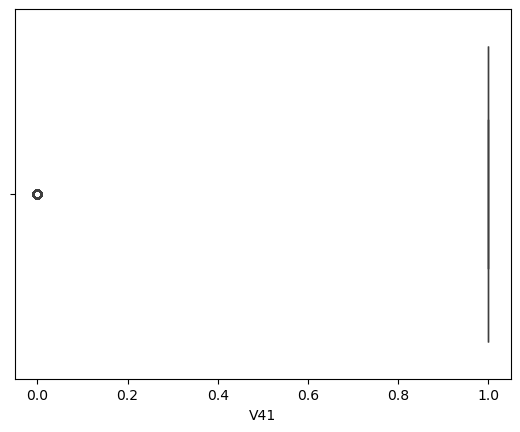


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          0.999269
std           0.027020
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           1.000000
Name: V41, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 59
Kolom :  V42


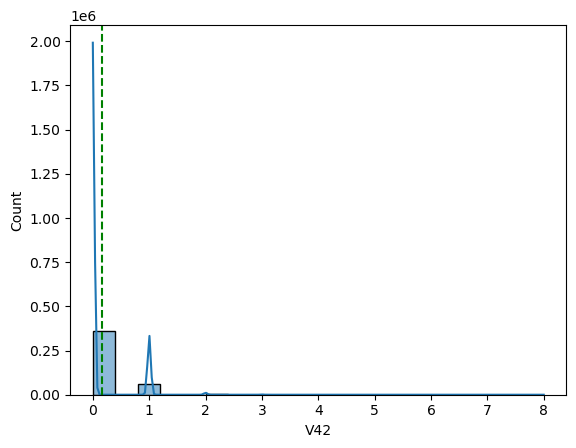

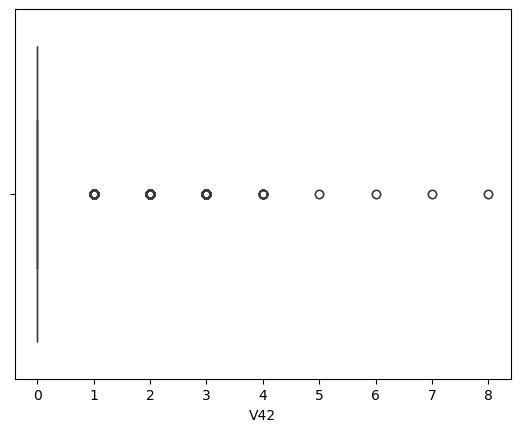


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          0.156118
std           0.382896
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           8.000000
Name: V42, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 60
Kolom :  V43


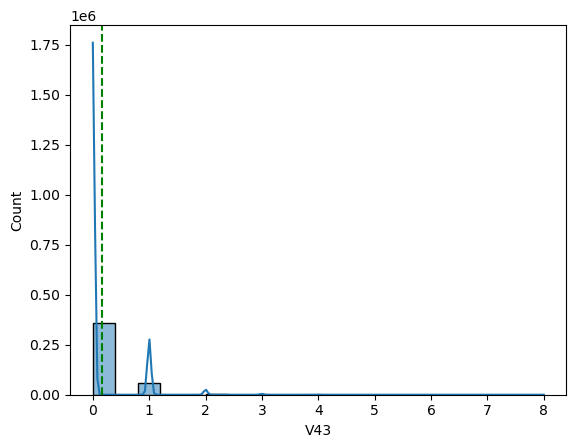

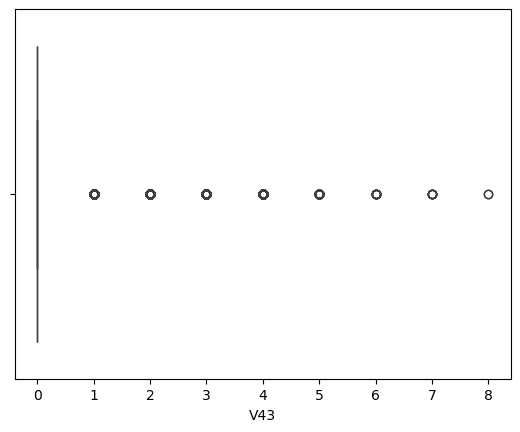


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          0.168942
std           0.433359
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           8.000000
Name: V43, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 61
Kolom :  V44


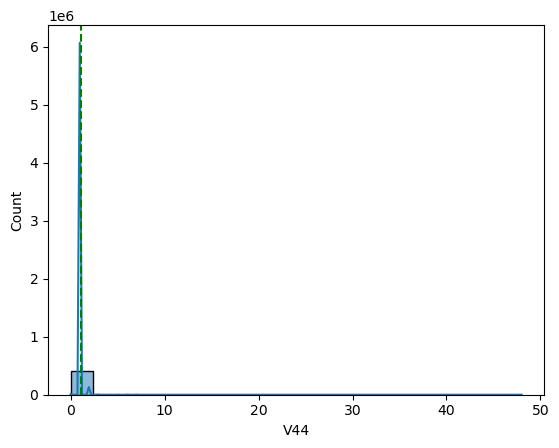

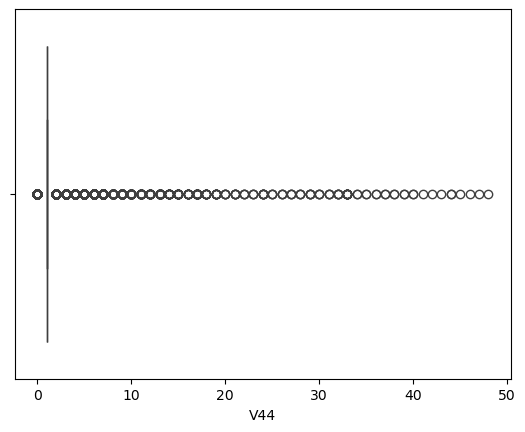


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          1.083891
std           0.639143
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          48.000000
Name: V44, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 62
Kolom :  V45


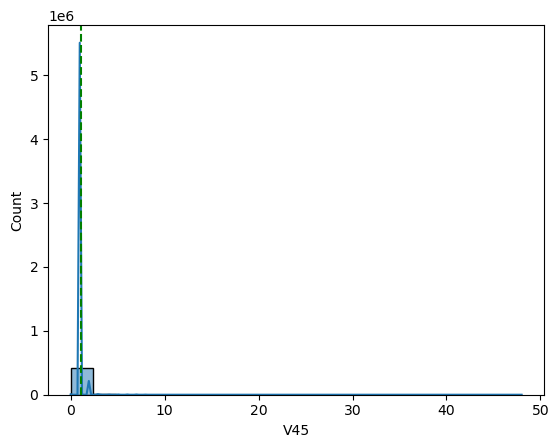

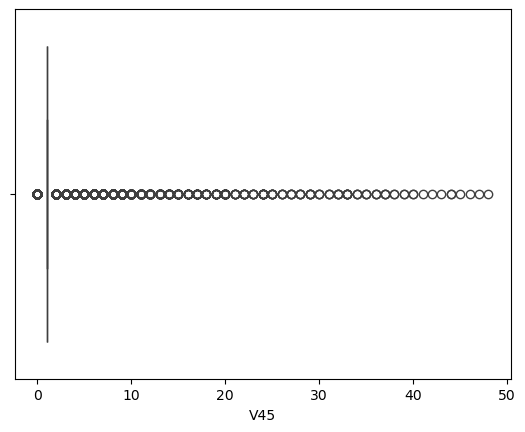


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          1.120779
std           0.729774
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          48.000000
Name: V45, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 63
Kolom :  V46


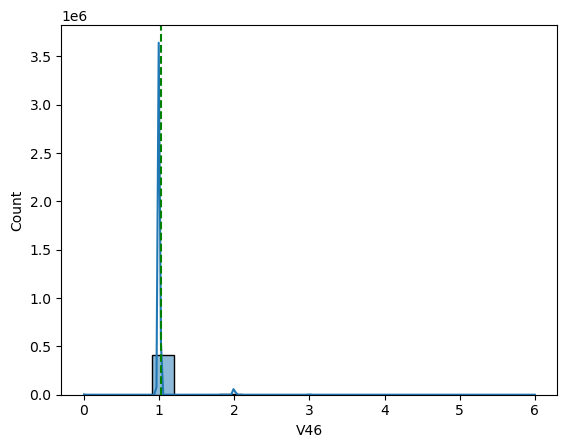

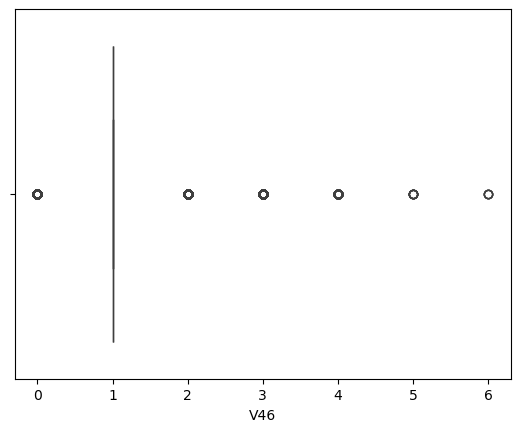


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          1.022286
std           0.166719
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           6.000000
Name: V46, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 64
Kolom :  V47


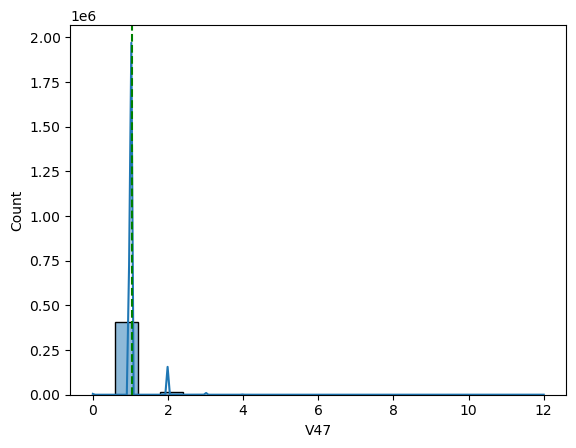

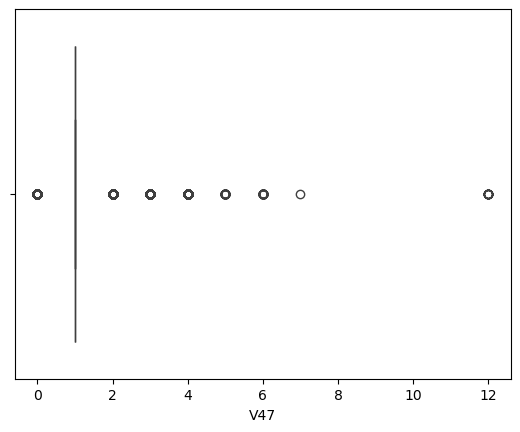


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          1.038515
std           0.231862
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          12.000000
Name: V47, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 65
Kolom :  V48


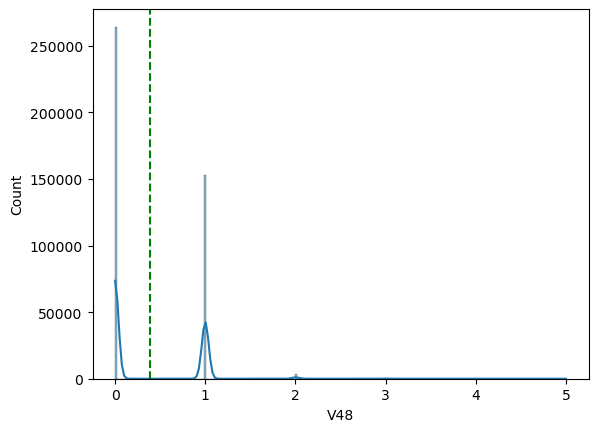

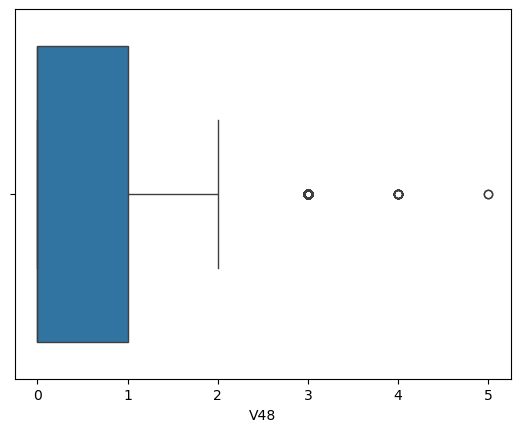


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          0.383174
std           0.508189
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max           5.000000
Name: V48, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 66
Kolom :  V49


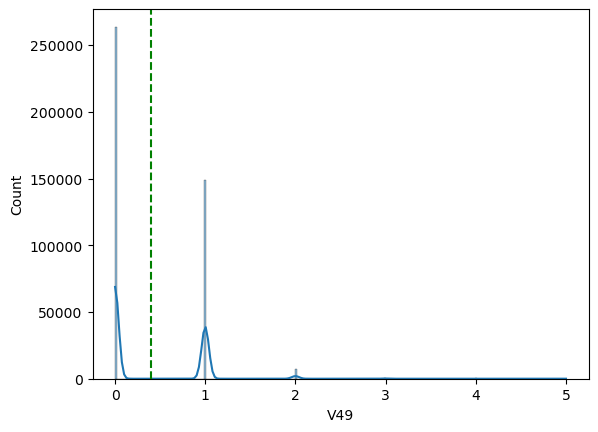

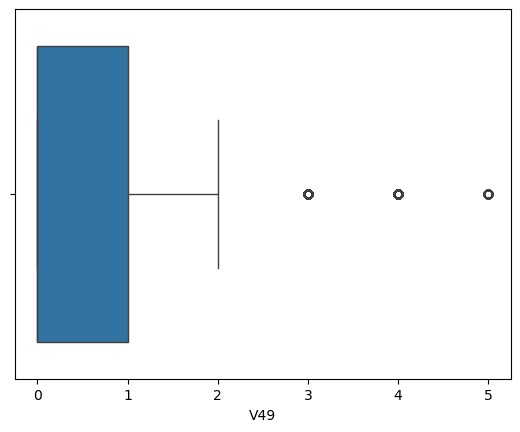


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          0.397724
std           0.542654
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max           5.000000
Name: V49, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 67
Kolom :  V50


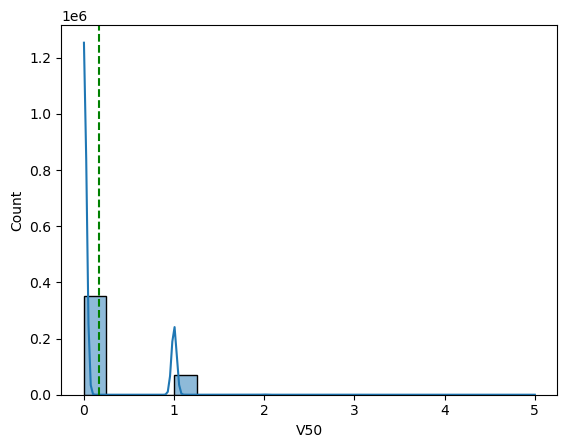

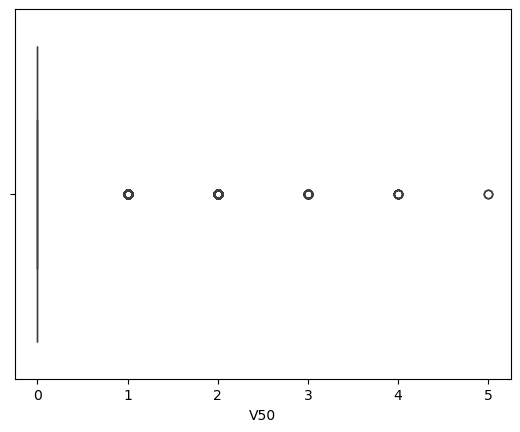


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          0.164746
std           0.373995
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           5.000000
Name: V50, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 68
Kolom :  V51


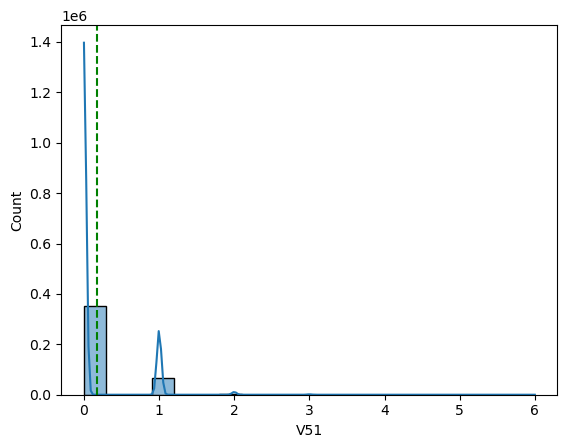

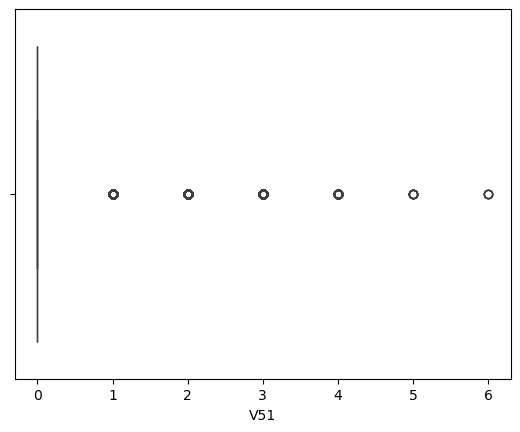


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          0.170579
std           0.403899
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           6.000000
Name: V51, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 69
Kolom :  V52


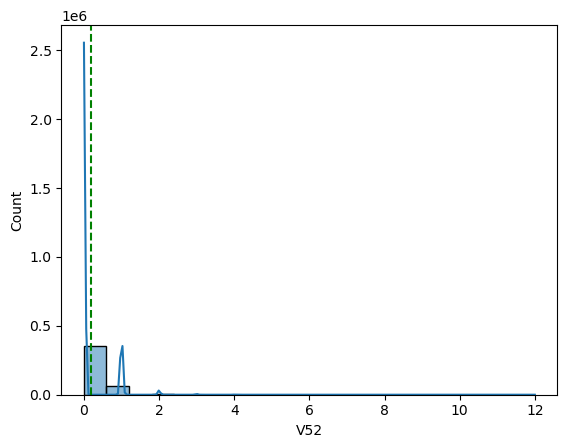

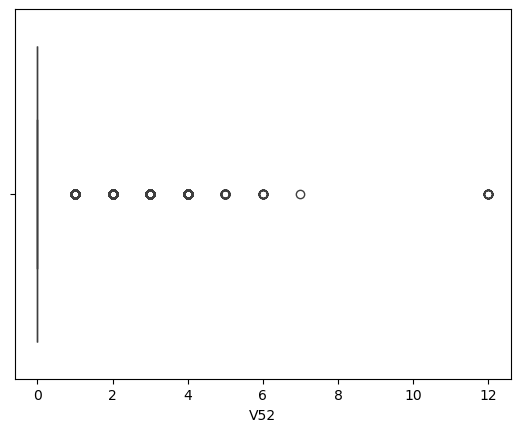


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    421571.000000
mean          0.182695
std           0.439002
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          12.000000
Name: V52, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 70
Kolom :  V53


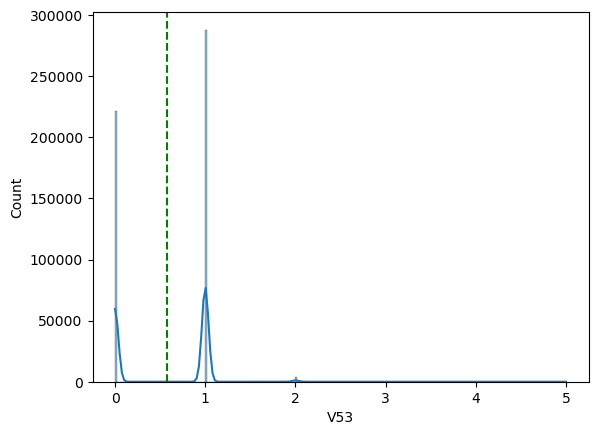

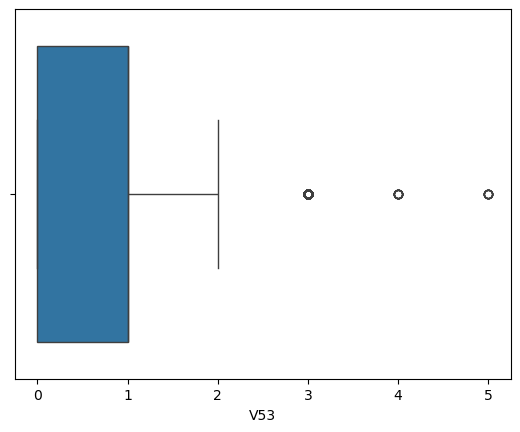


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.577586
std           0.511571
min           0.000000
25%           0.000000
50%           1.000000
75%           1.000000
max           5.000000
Name: V53, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 71
Kolom :  V54


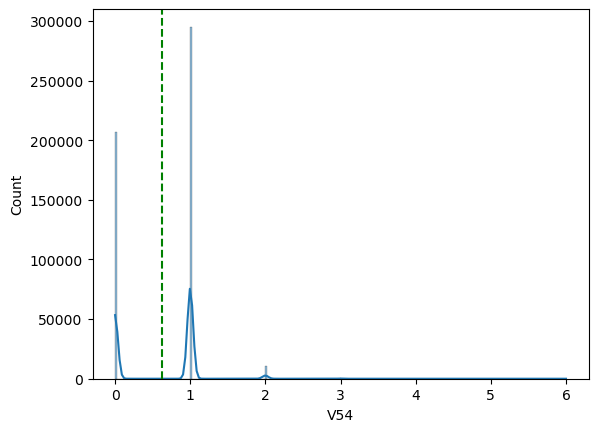

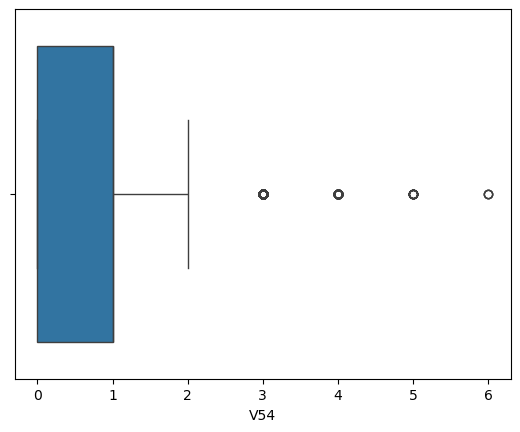


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.619982
std           0.534635
min           0.000000
25%           0.000000
50%           1.000000
75%           1.000000
max           6.000000
Name: V54, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 72
Kolom :  V55


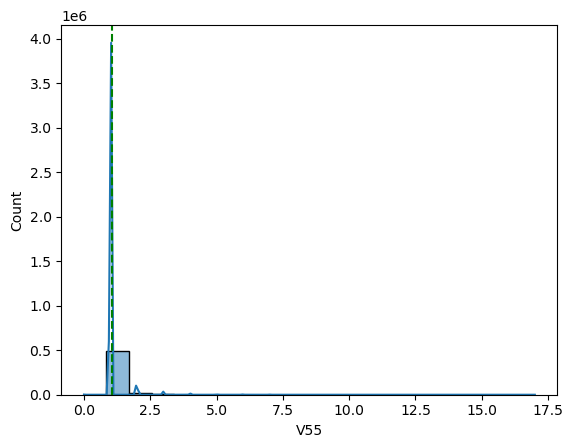

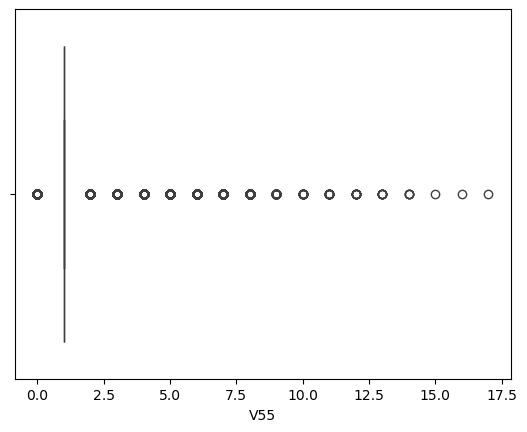


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          1.067670
std           0.391364
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          17.000000
Name: V55, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 73
Kolom :  V56


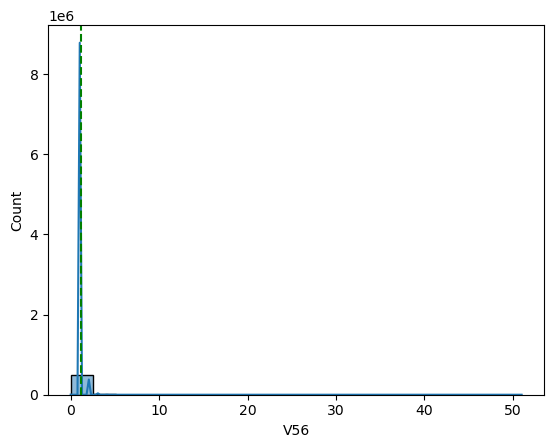

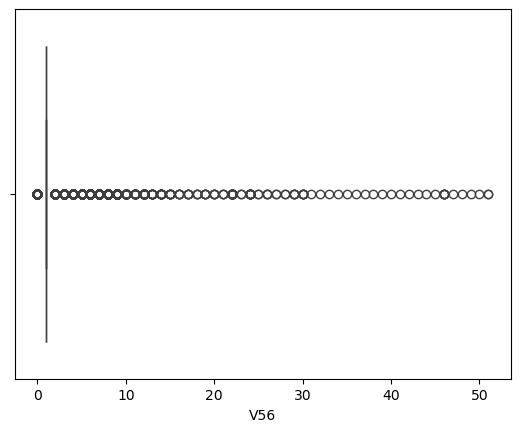


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          1.120979
std           0.661129
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          51.000000
Name: V56, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 74
Kolom :  V57


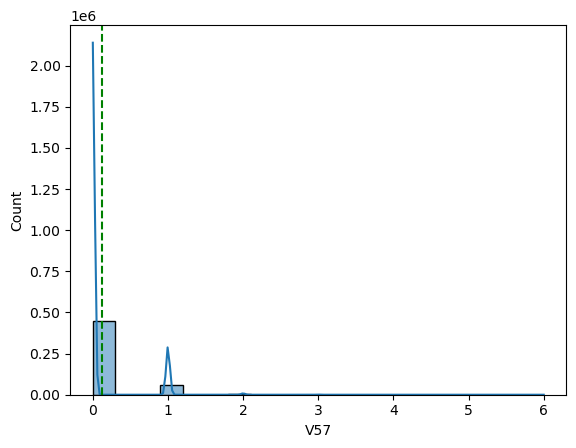

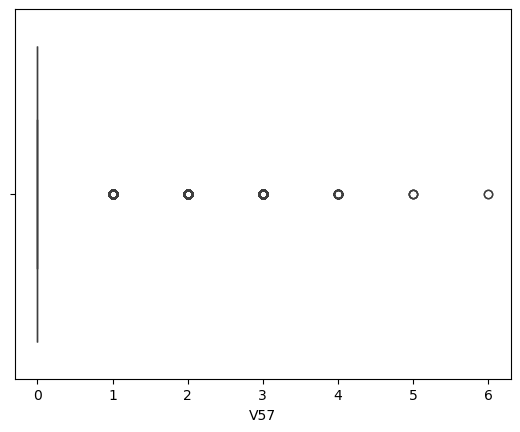


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.128312
std           0.349094
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           6.000000
Name: V57, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 75
Kolom :  V58


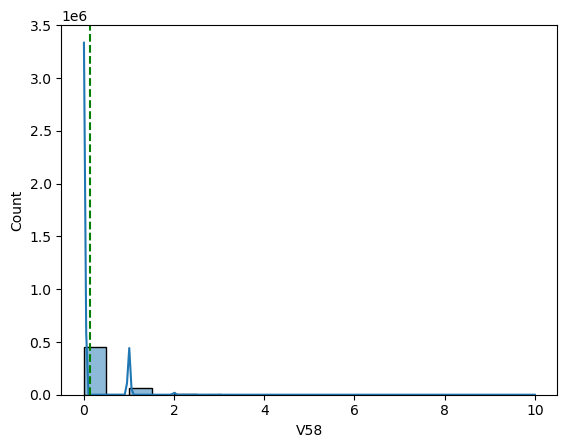

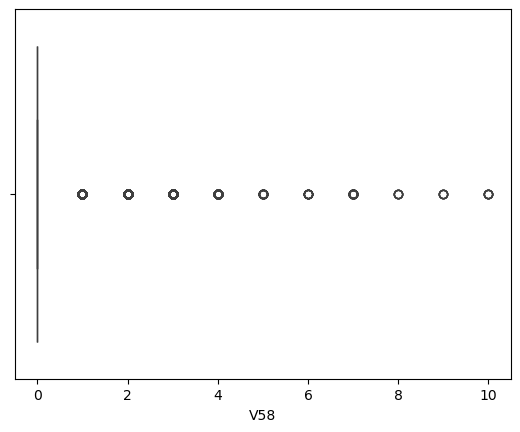


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.132453
std           0.372907
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          10.000000
Name: V58, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 76
Kolom :  V59


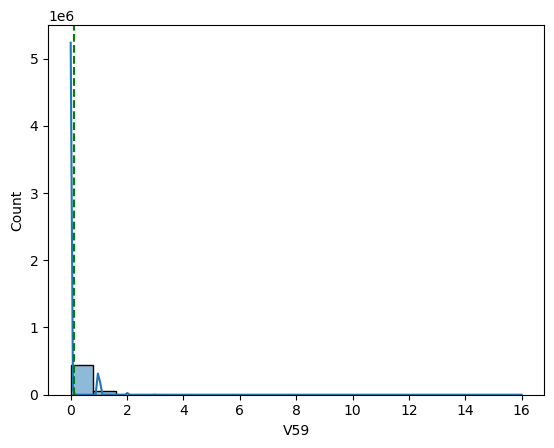

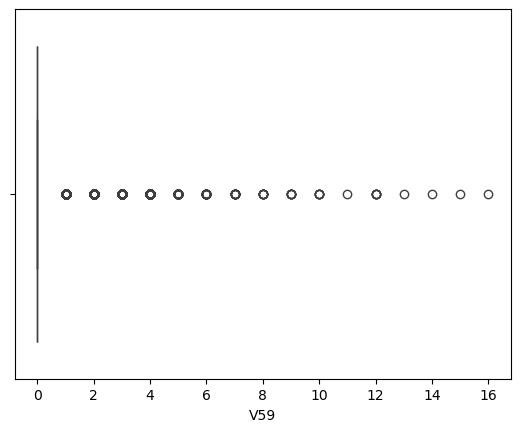


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.134433
std           0.379291
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          16.000000
Name: V59, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 77
Kolom :  V60


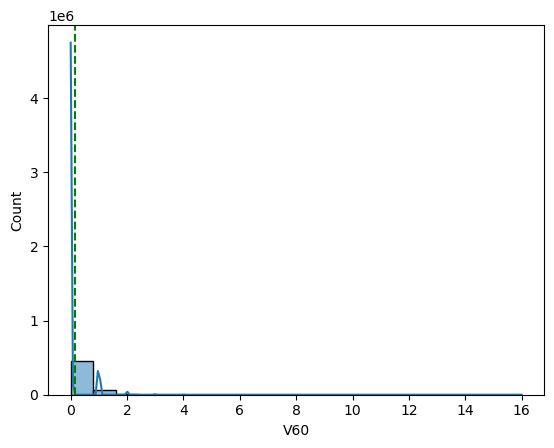

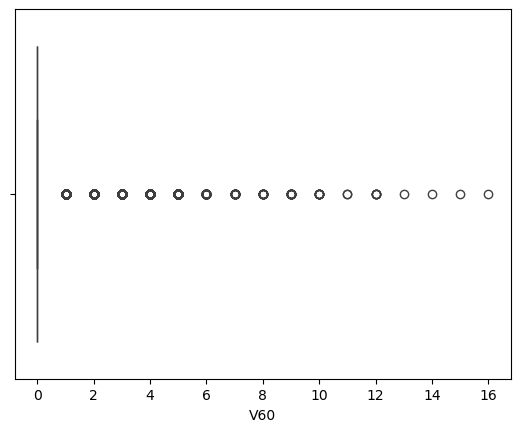


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.142537
std           0.418230
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          16.000000
Name: V60, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 78
Kolom :  V61


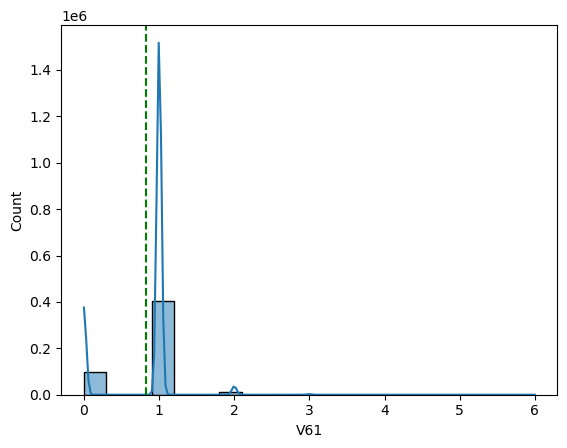

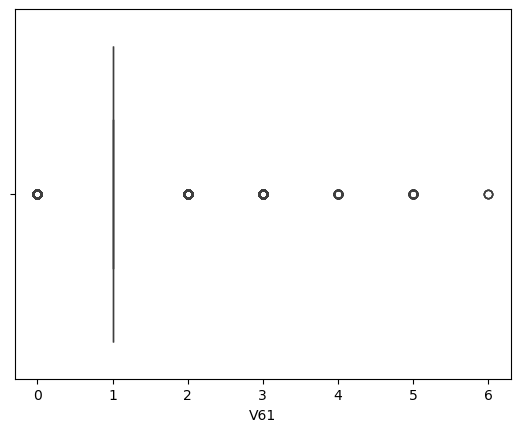


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.829785
std           0.436617
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           6.000000
Name: V61, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 79
Kolom :  V62


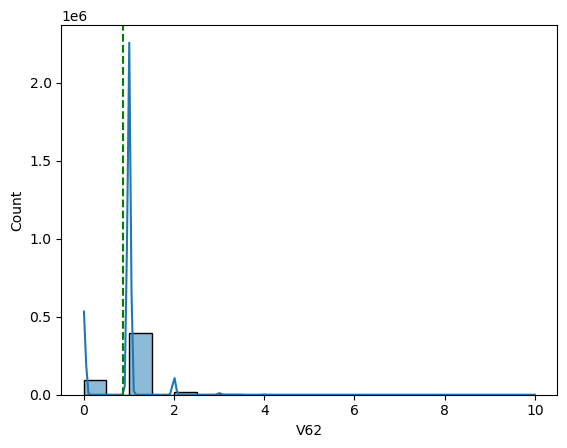

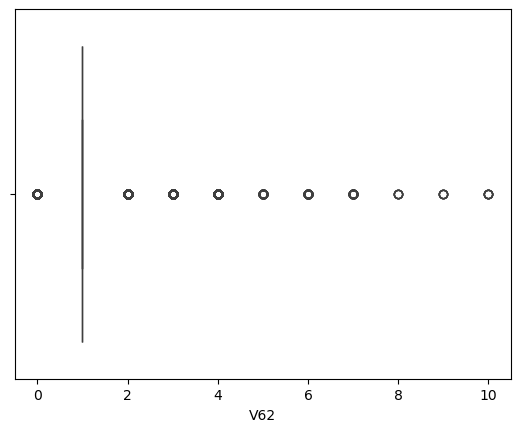


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.867563
std           0.483803
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          10.000000
Name: V62, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 80
Kolom :  V63


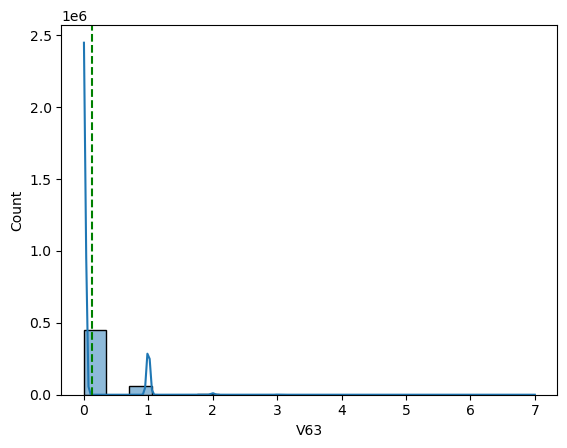

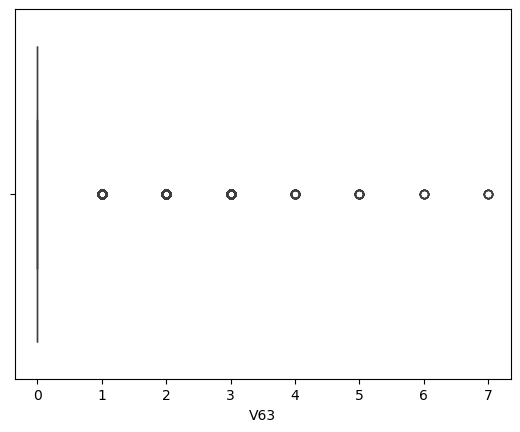


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.130743
std           0.355262
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           7.000000
Name: V63, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 81
Kolom :  V64


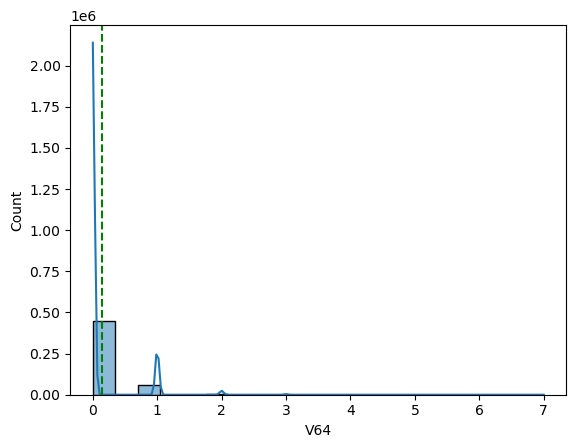

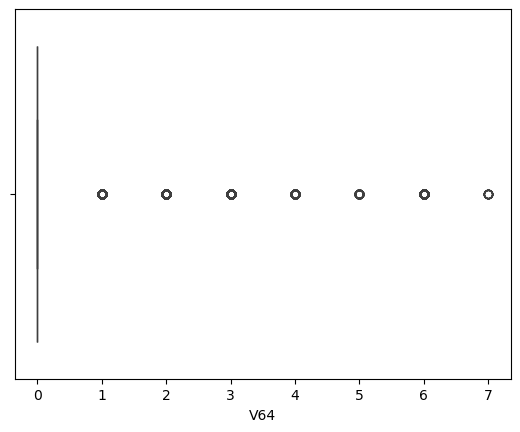


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.141825
std           0.406157
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           7.000000
Name: V64, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 82
Kolom :  V65


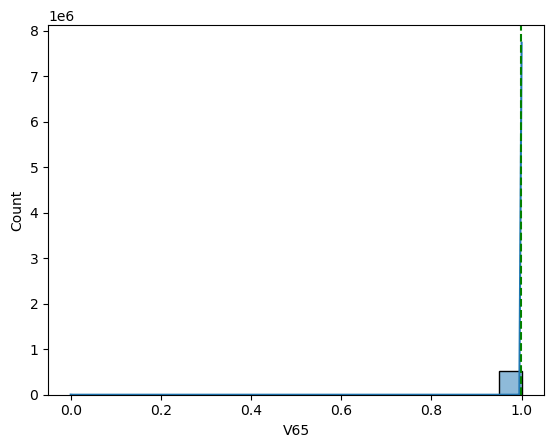

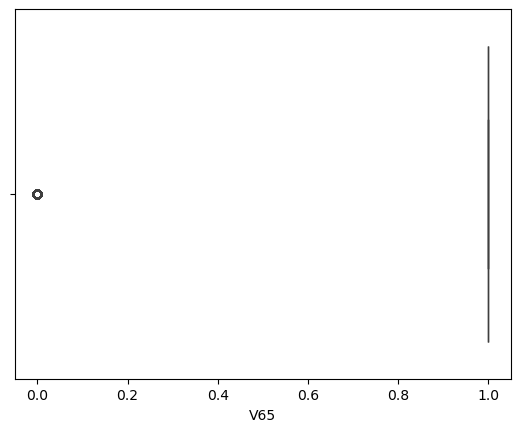


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.999663
std           0.018353
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           1.000000
Name: V65, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 83
Kolom :  V66


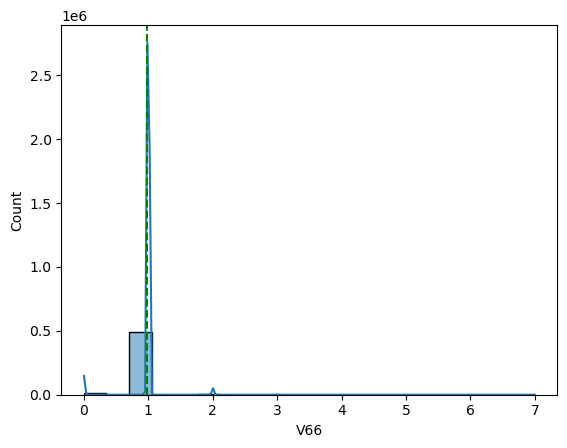

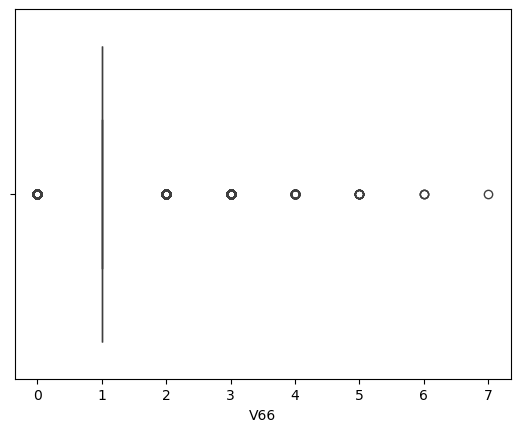


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.981038
std           0.216235
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           7.000000
Name: V66, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 84
Kolom :  V67


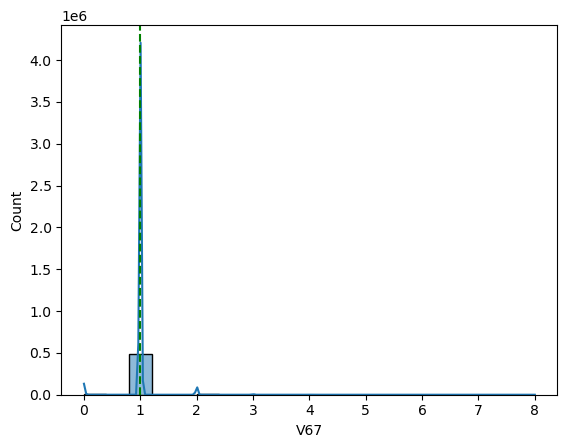

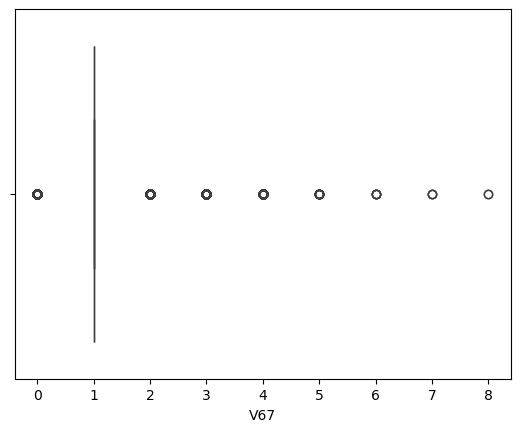


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.998121
std           0.245912
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           8.000000
Name: V67, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 85
Kolom :  V68


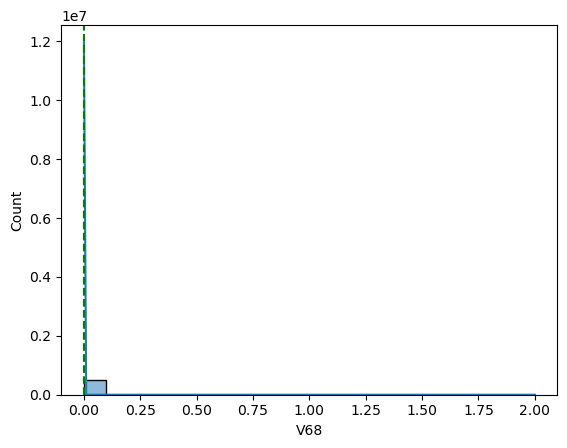

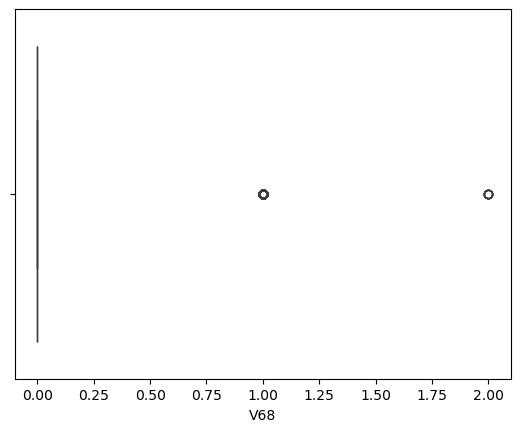


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.000534
std           0.023760
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           2.000000
Name: V68, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 86
Kolom :  V69


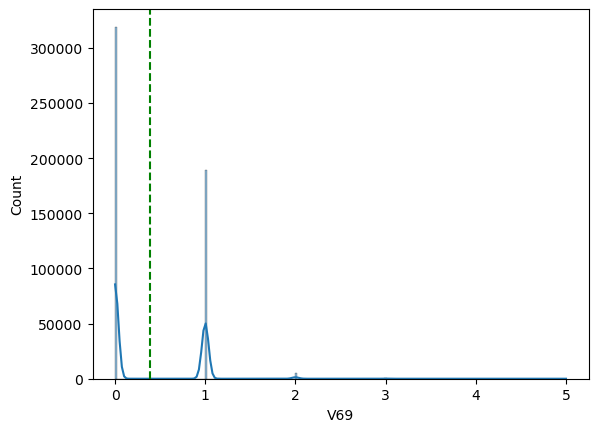

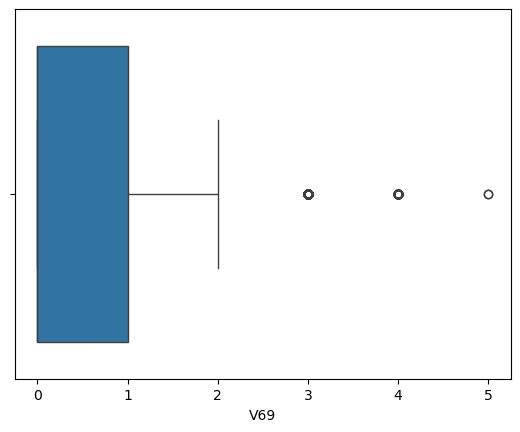


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.390200
std           0.513696
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max           5.000000
Name: V69, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 87
Kolom :  V70


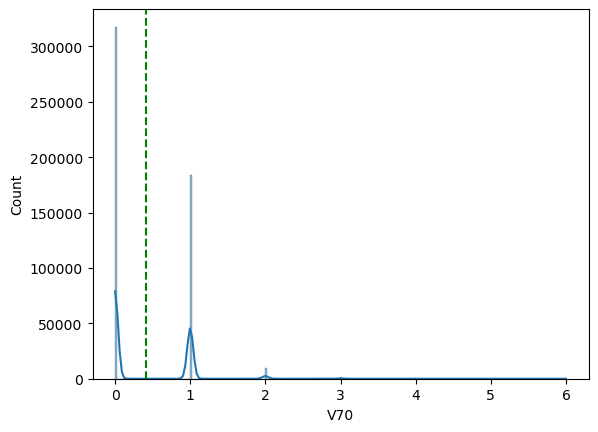

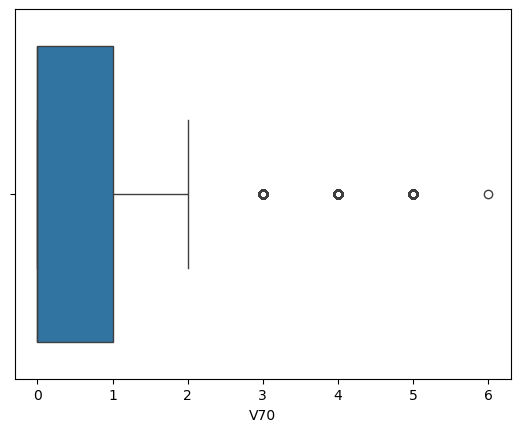


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.407924
std           0.554499
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max           6.000000
Name: V70, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 88
Kolom :  V71


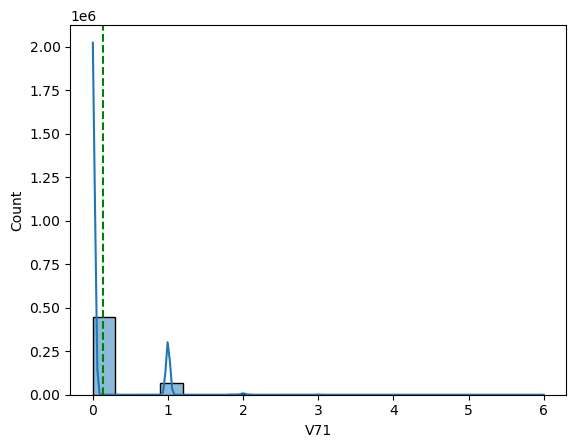

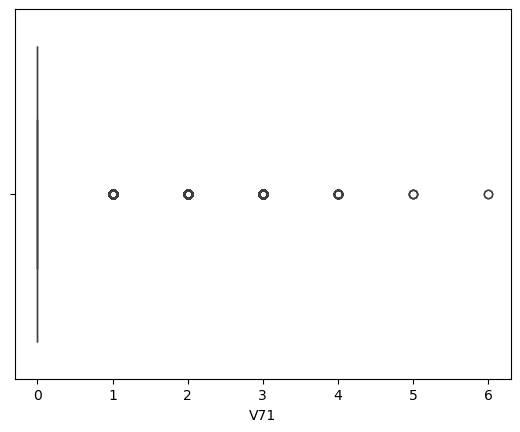


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.140639
std           0.364303
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           6.000000
Name: V71, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 89
Kolom :  V72


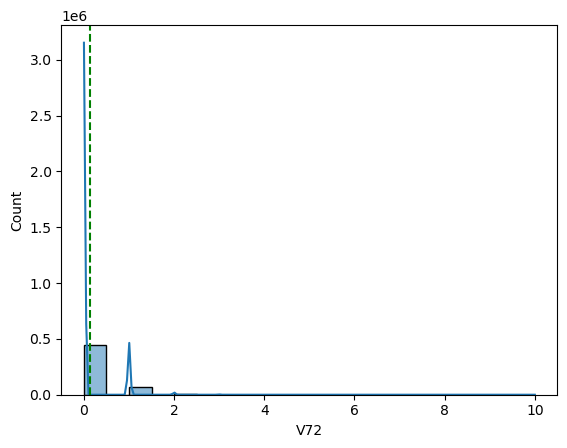

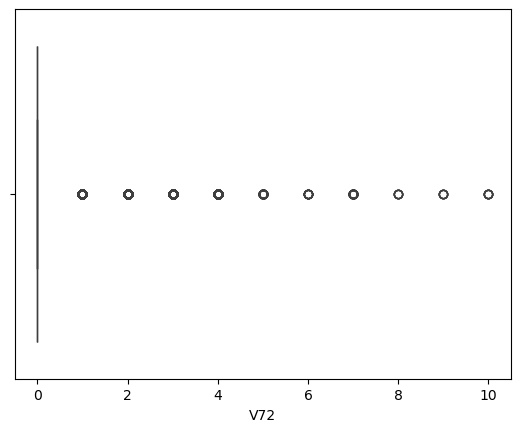


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.145124
std           0.389212
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          10.000000
Name: V72, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 90
Kolom :  V73


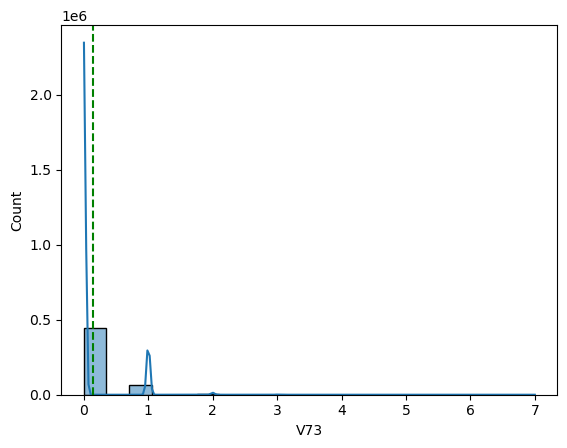

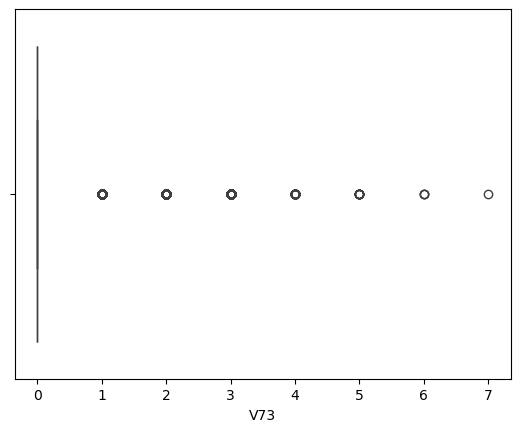


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.139982
std           0.367098
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           7.000000
Name: V73, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 91
Kolom :  V74


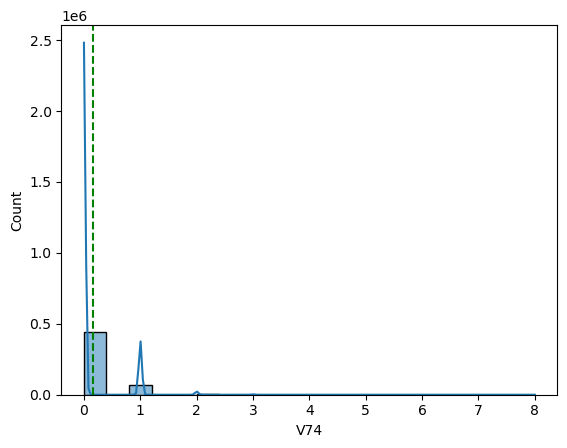

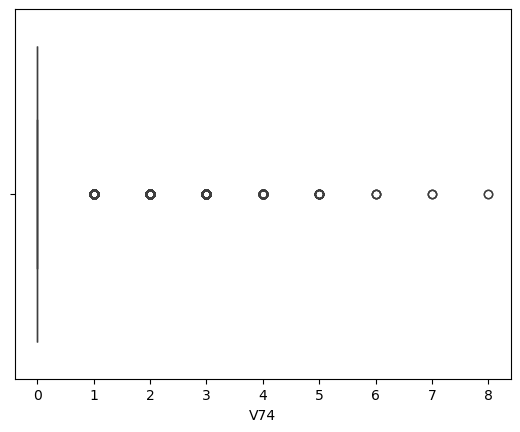


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    513444.000000
mean          0.152147
std           0.393274
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           8.000000
Name: V74, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 92
Kolom :  V75


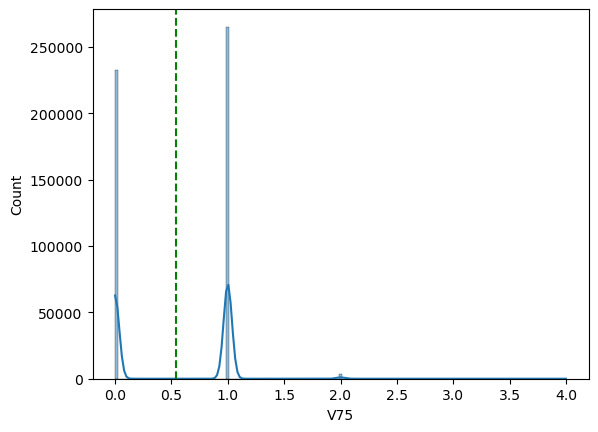

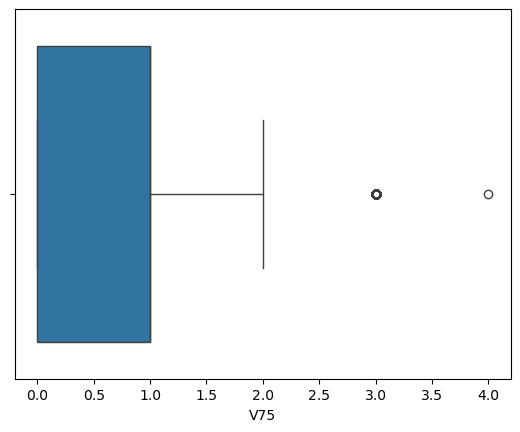


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.544278
std           0.514318
min           0.000000
25%           0.000000
50%           1.000000
75%           1.000000
max           4.000000
Name: V75, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 93
Kolom :  V76


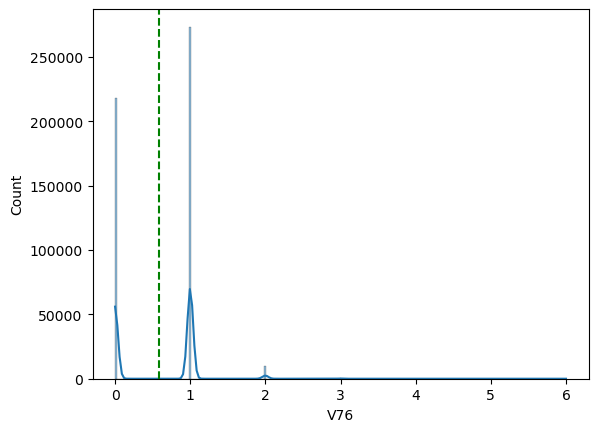

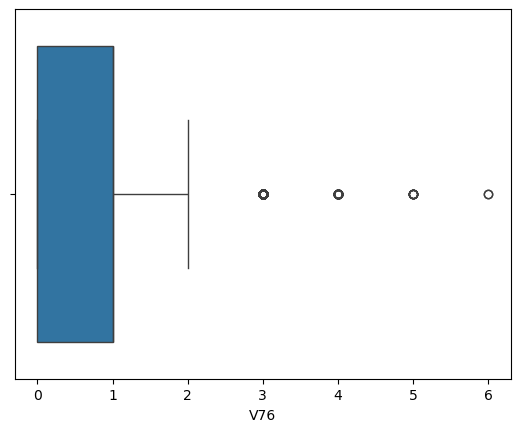


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.587557
std           0.538230
min           0.000000
25%           0.000000
50%           1.000000
75%           1.000000
max           6.000000
Name: V76, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 94
Kolom :  V77


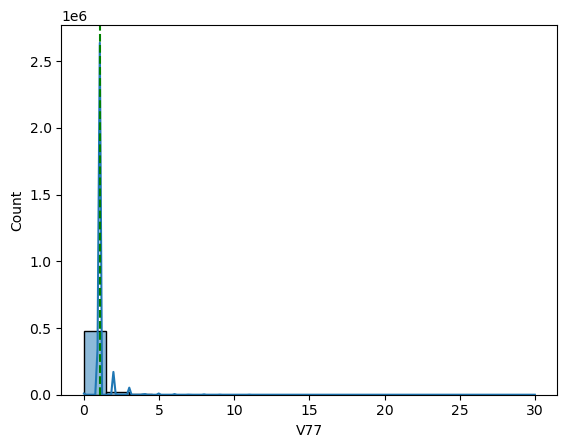

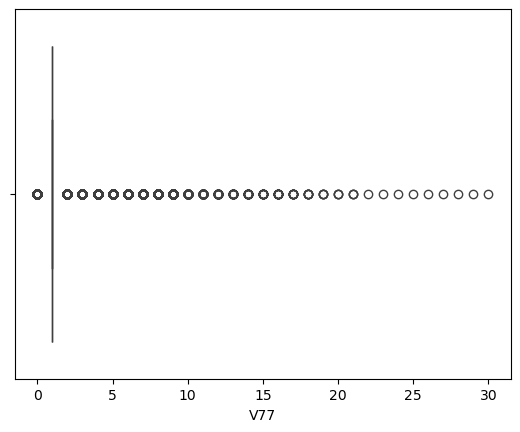


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          1.086893
std           0.532958
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          30.000000
Name: V77, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 95
Kolom :  V78


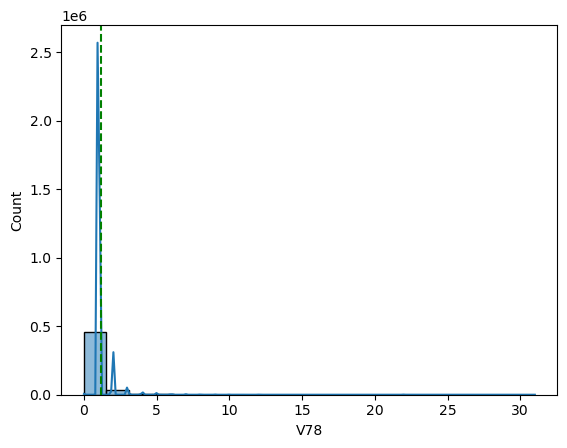

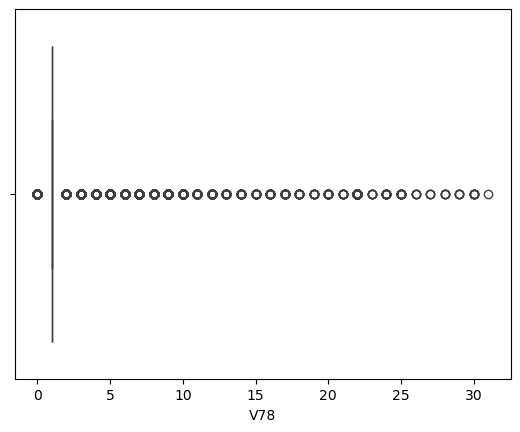


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          1.144462
std           0.781474
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          31.000000
Name: V78, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 96
Kolom :  V79


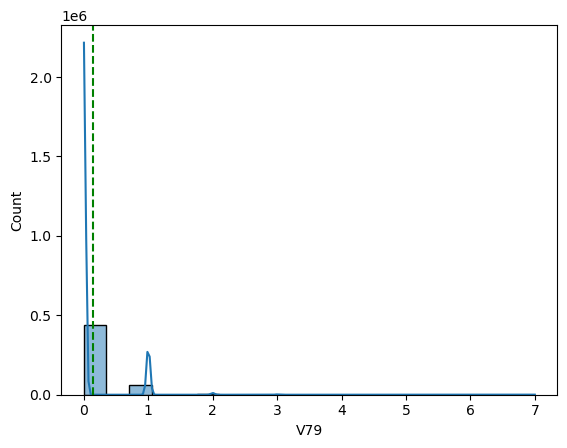

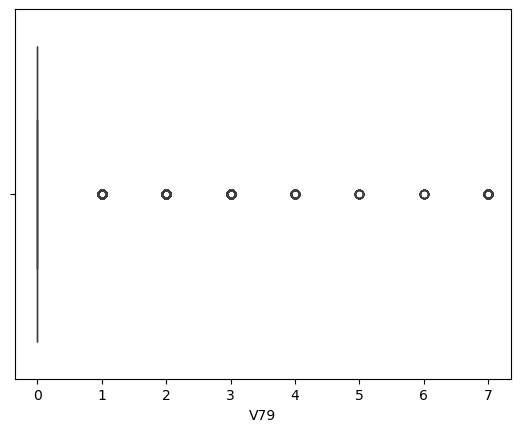


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.136867
std           0.379904
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           7.000000
Name: V79, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 97
Kolom :  V80


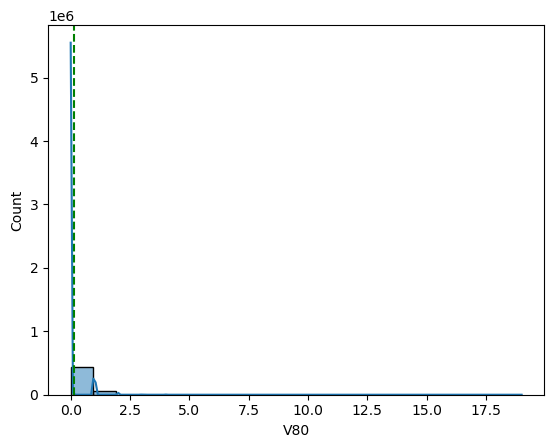

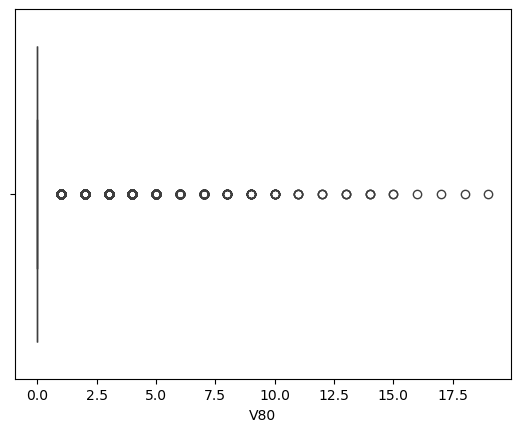


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.143954
std           0.409932
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          19.000000
Name: V80, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 98
Kolom :  V81


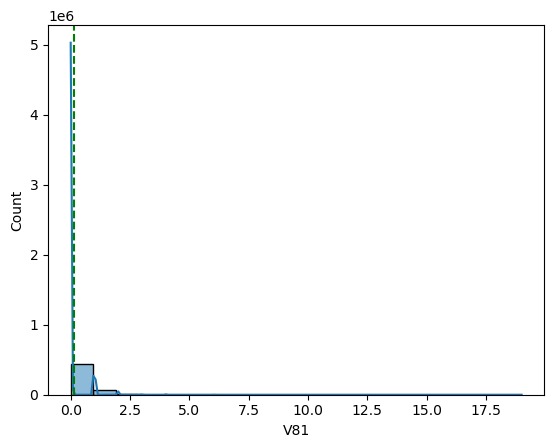

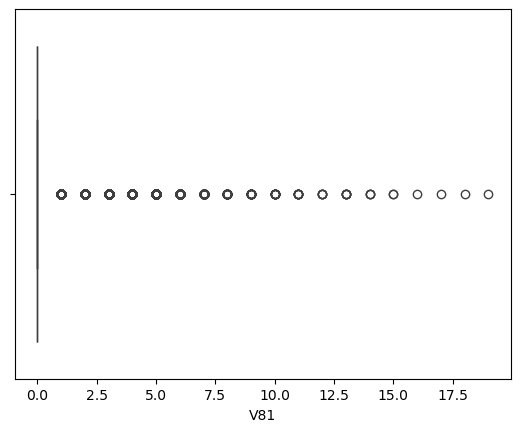


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.152696
std           0.452298
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          19.000000
Name: V81, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 99
Kolom :  V82


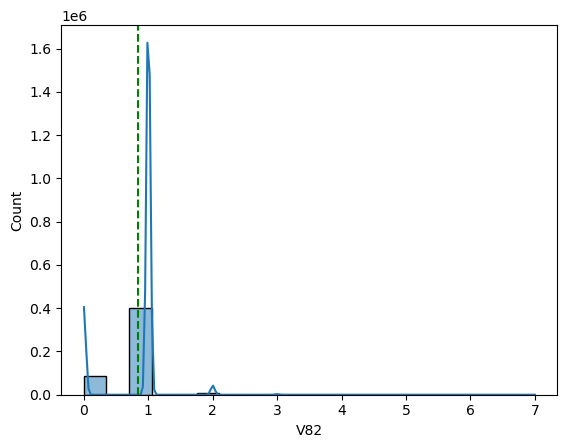

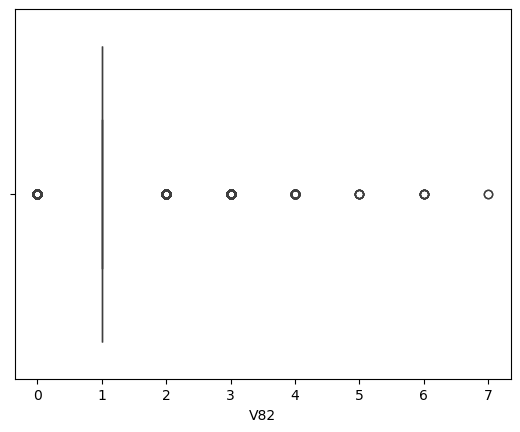


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.844610
std           0.422529
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           7.000000
Name: V82, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 100
Kolom :  V83


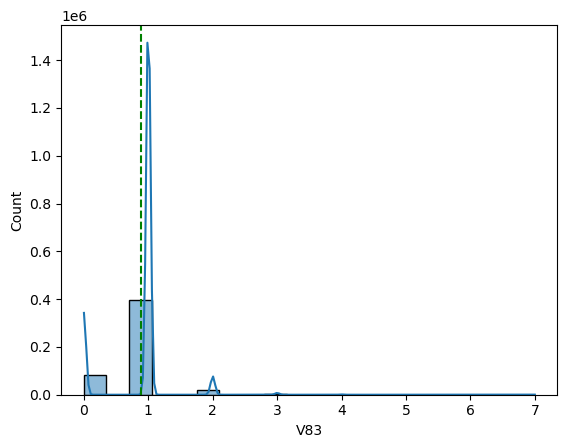

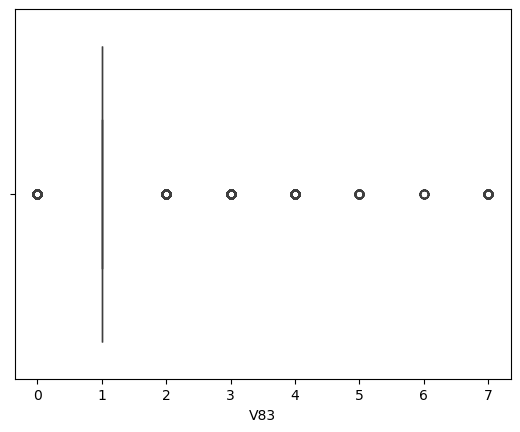


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.881965
std           0.470757
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           7.000000
Name: V83, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 101
Kolom :  V84


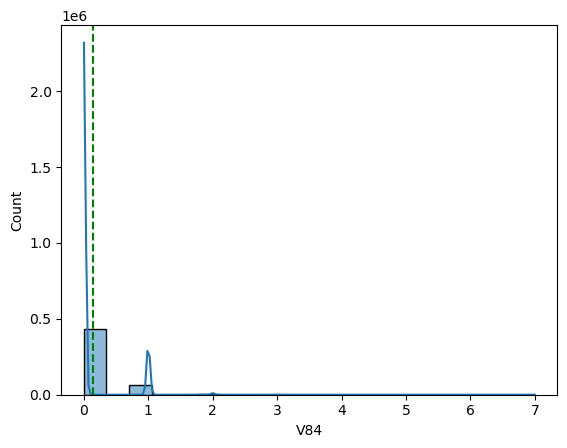

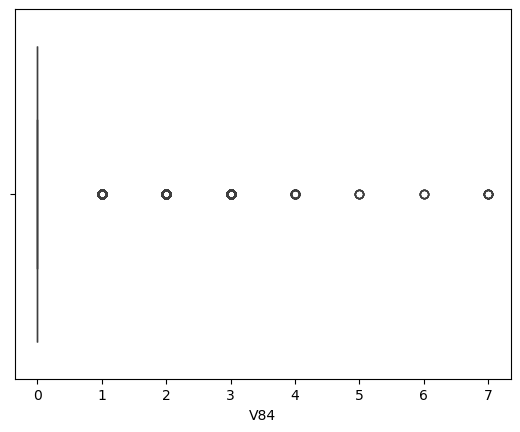


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.137145
std           0.361875
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           7.000000
Name: V84, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 102
Kolom :  V85


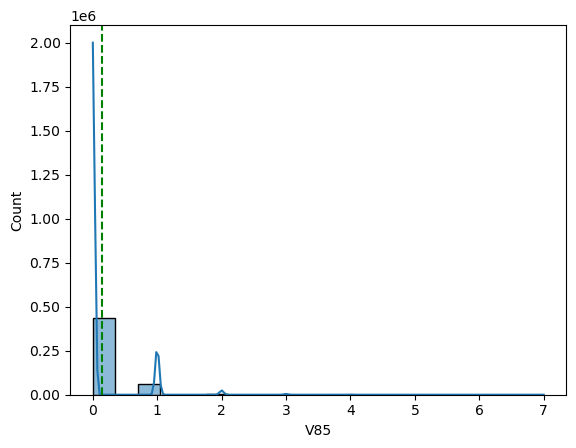

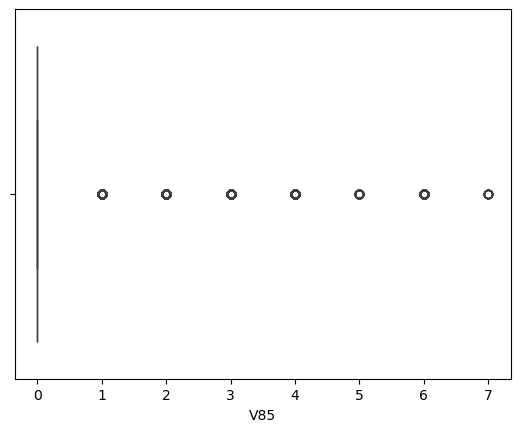


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.149788
std           0.419445
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           7.000000
Name: V85, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 103
Kolom :  V86


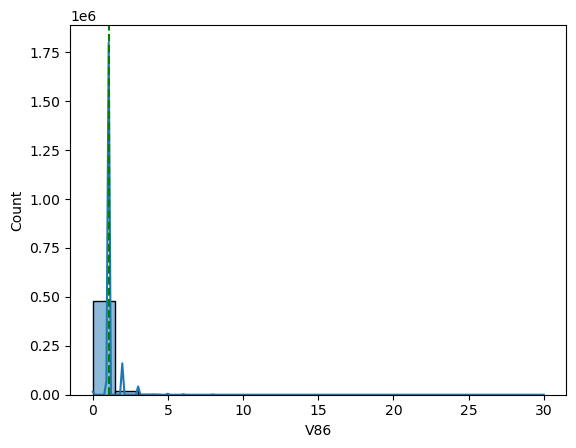

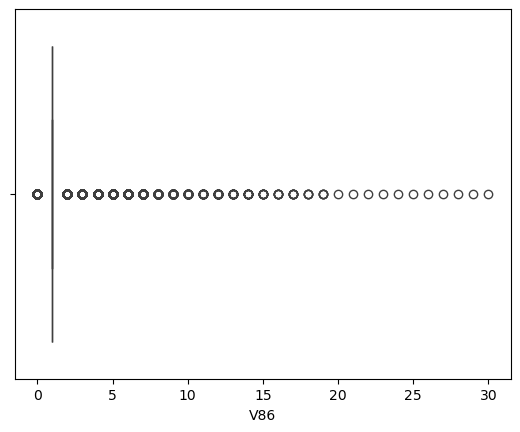


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          1.064885
std           0.419807
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          30.000000
Name: V86, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 104
Kolom :  V87


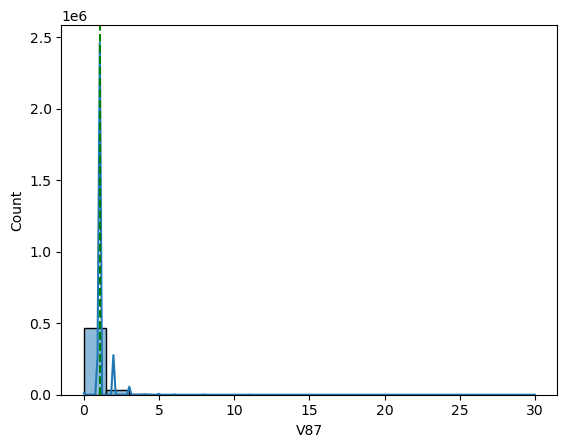

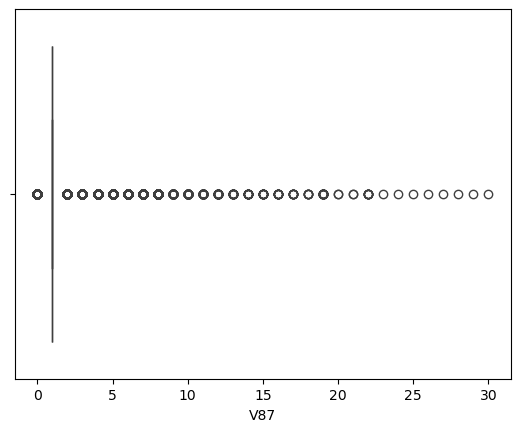


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          1.099456
std           0.511281
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          30.000000
Name: V87, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 105
Kolom :  V88


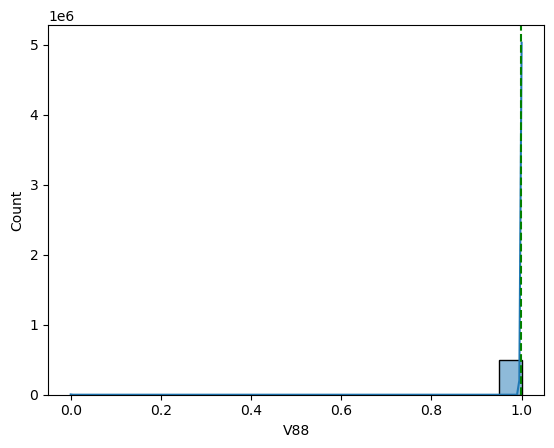

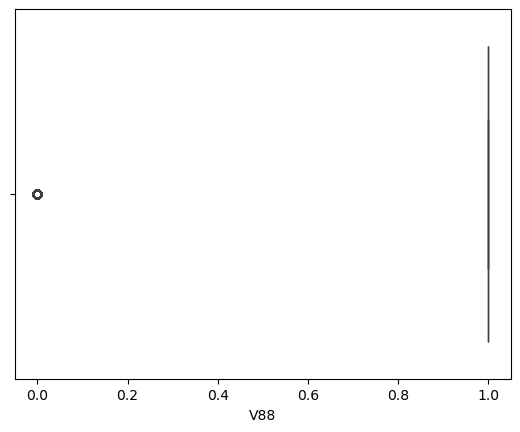


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.999246
std           0.027447
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           1.000000
Name: V88, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 106
Kolom :  V89


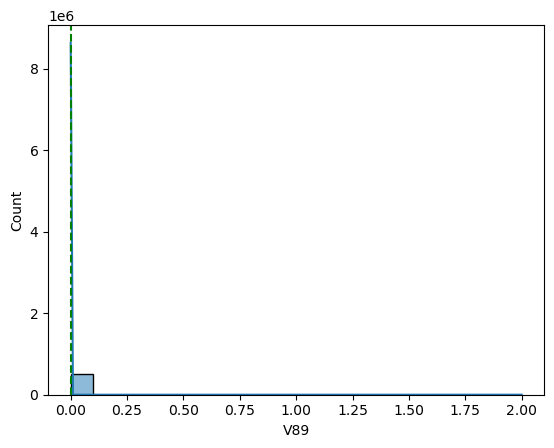

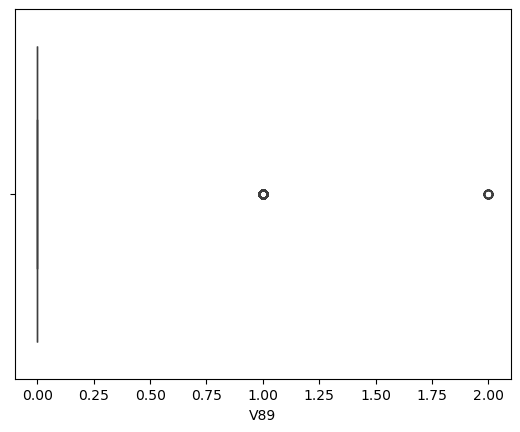


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.000902
std           0.031943
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           2.000000
Name: V89, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 107
Kolom :  V90


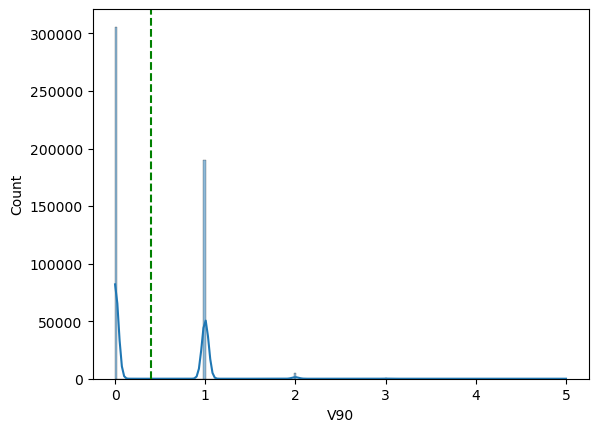

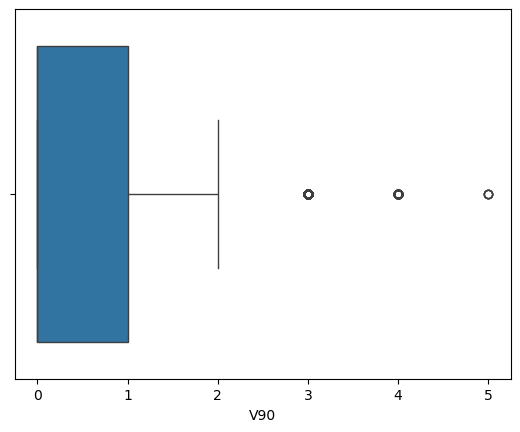


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.401862
std           0.516153
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max           5.000000
Name: V90, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 108
Kolom :  V91


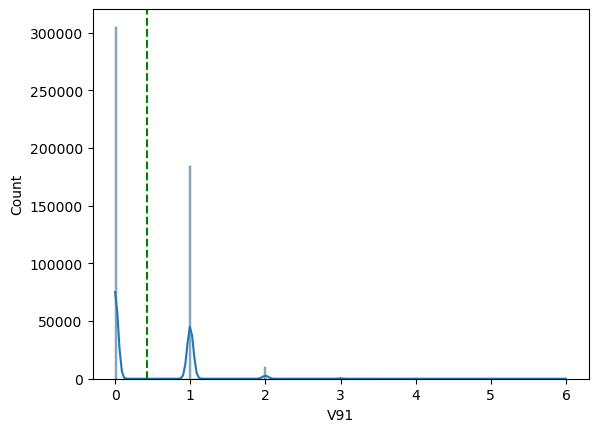

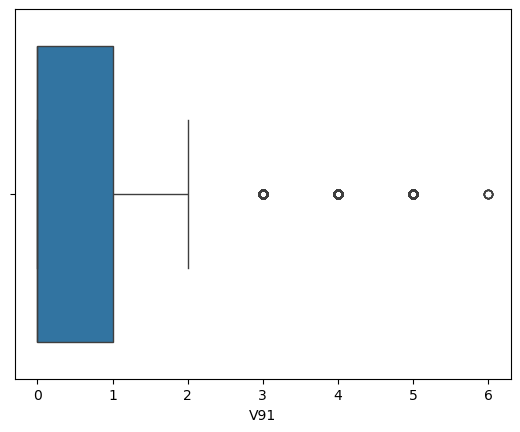


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.420461
std           0.561865
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max           6.000000
Name: V91, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 109
Kolom :  V92


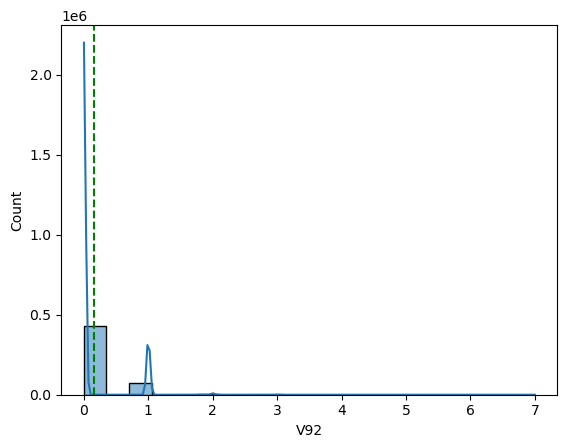

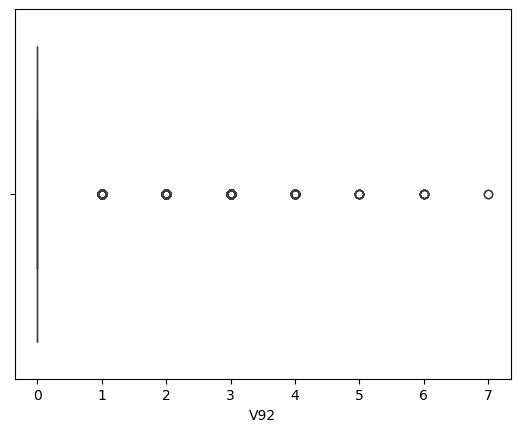


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.150322
std           0.375682
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           7.000000
Name: V92, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 110
Kolom :  V93


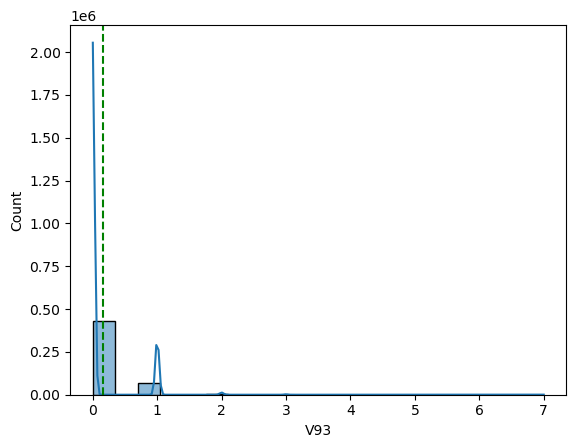

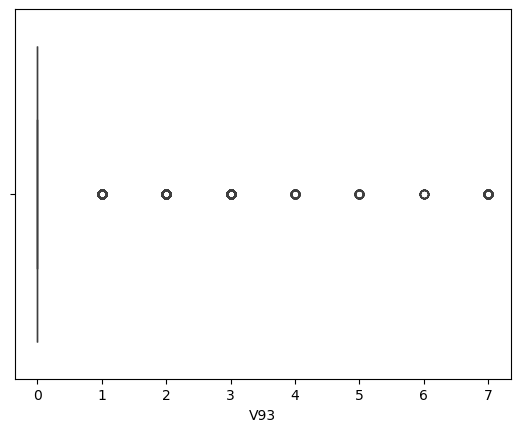


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.154812
std           0.402314
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           7.000000
Name: V93, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 111
Kolom :  V94


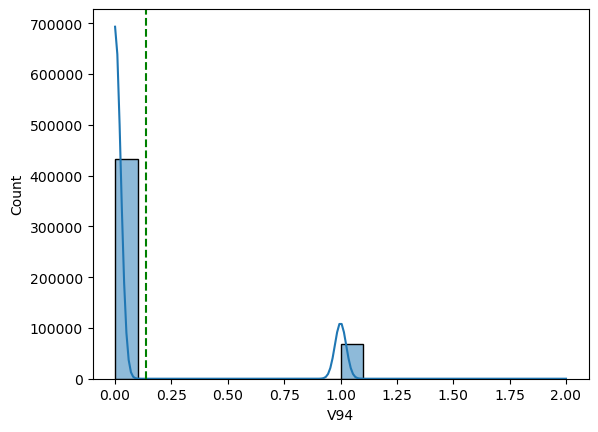

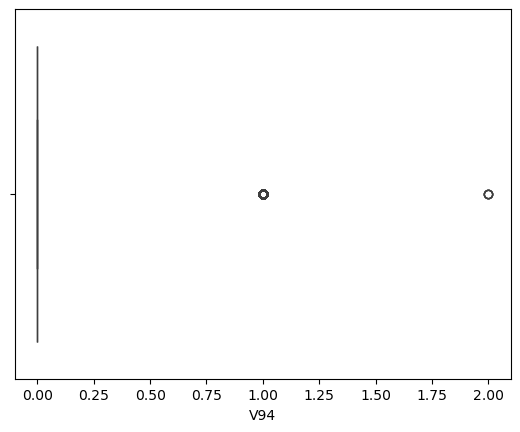


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    501376.000000
mean          0.137007
std           0.343878
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           2.000000
Name: V94, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 112
Kolom :  V95


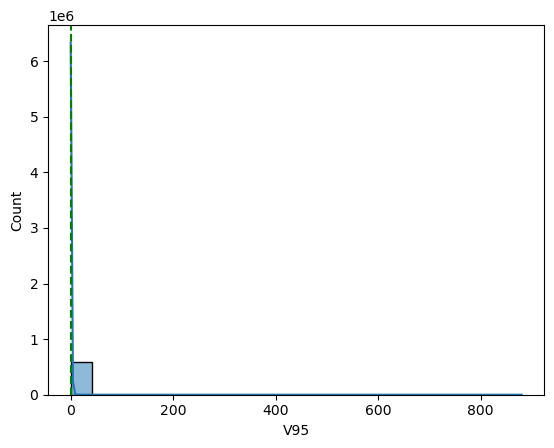

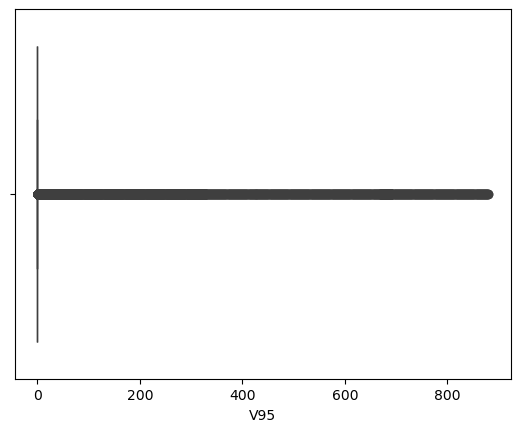


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.038019
std          21.034304
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max         880.000000
Name: V95, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 113
Kolom :  V96


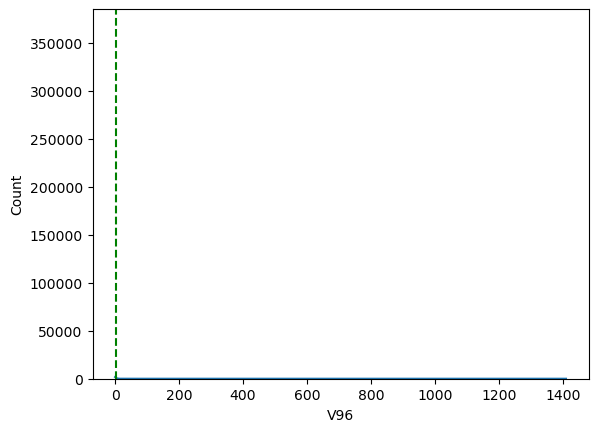

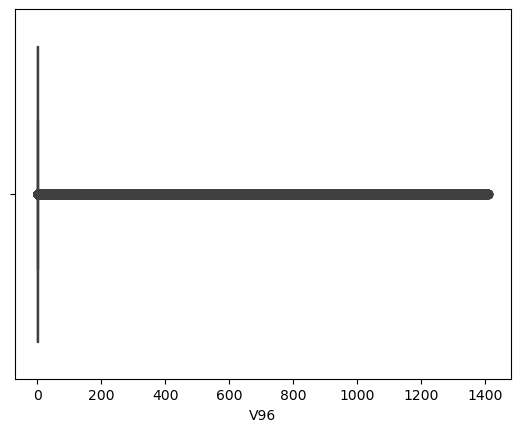


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.00000
mean          3.00519
std          40.23949
min           0.00000
25%           0.00000
50%           0.00000
75%           1.00000
max        1410.00000
Name: V96, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 114
Kolom :  V97


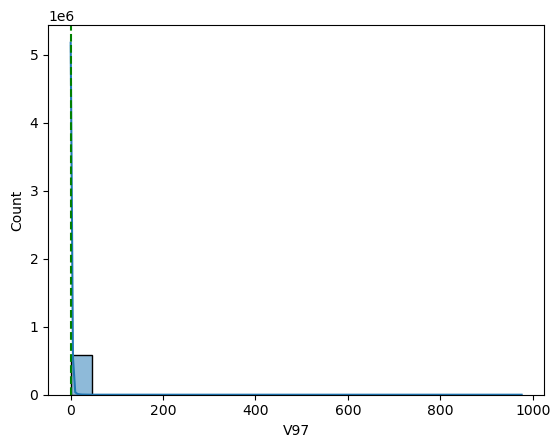

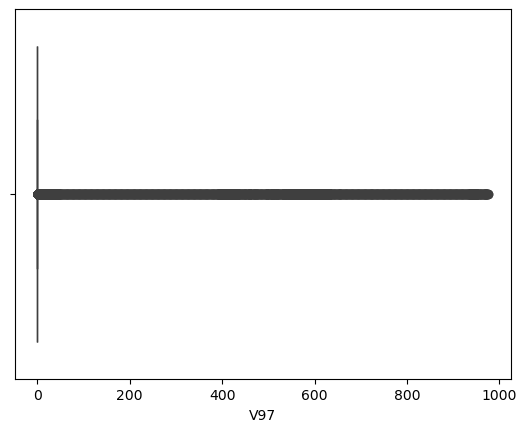


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.718933
std          27.700449
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max         976.000000
Name: V97, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 115
Kolom :  V98


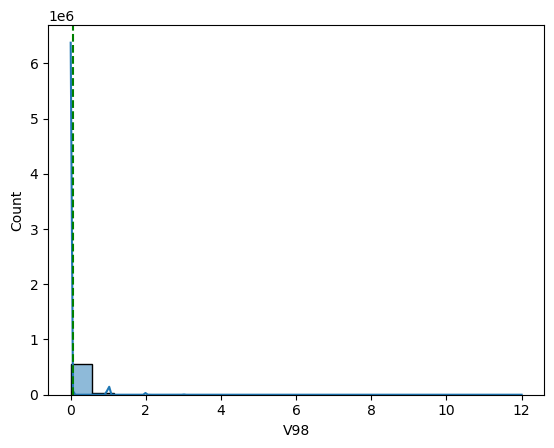

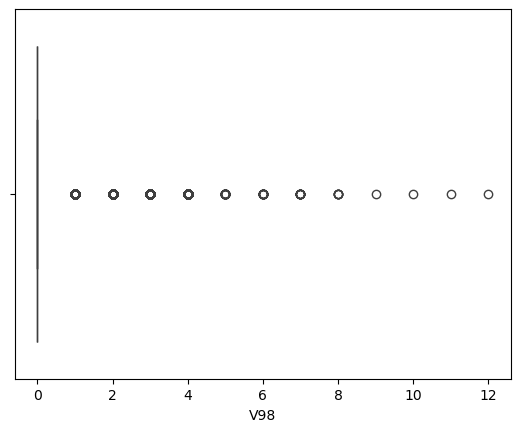


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          0.061985
std           0.284995
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          12.000000
Name: V98, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 116
Kolom :  V99


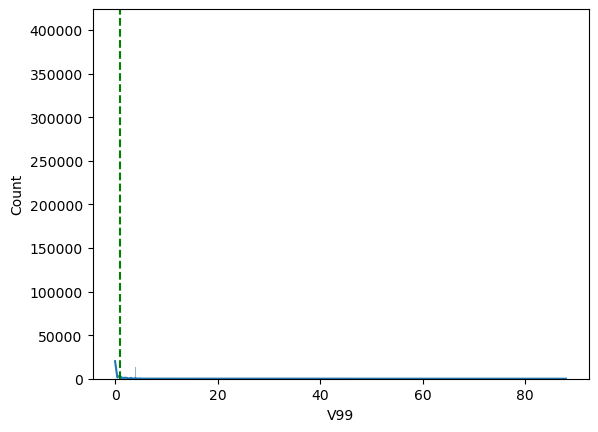

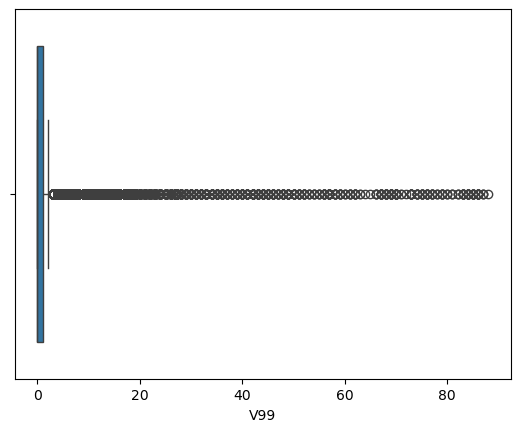


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          0.894986
std           2.722552
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max          88.000000
Name: V99, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 117
Kolom :  V100


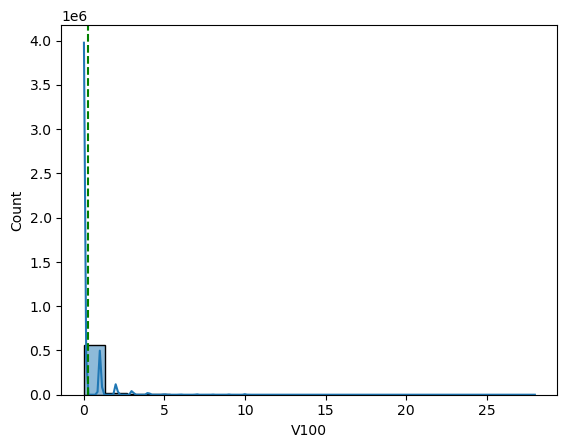

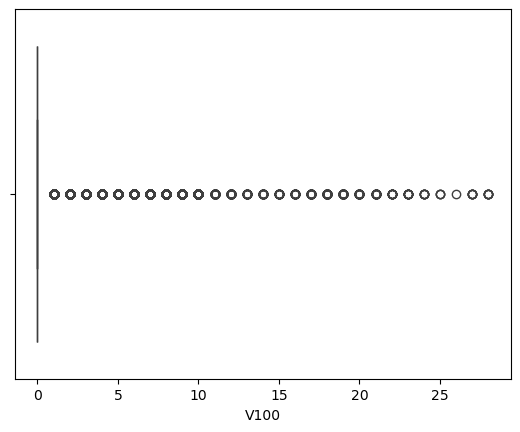


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          0.273504
std           0.947176
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          28.000000
Name: V100, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 118
Kolom :  V101


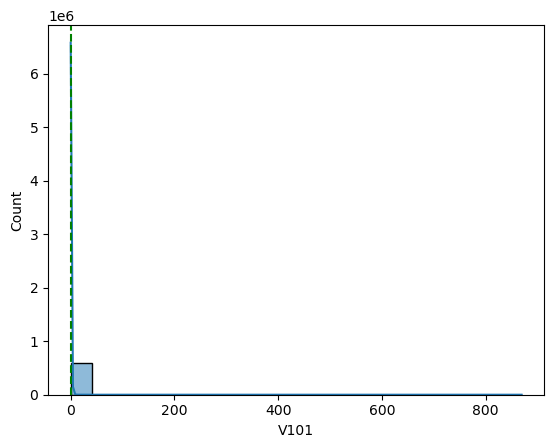

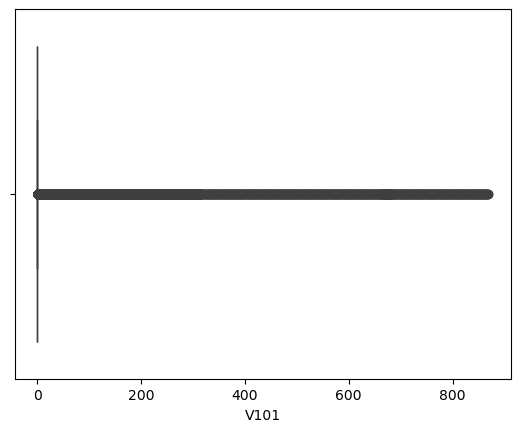


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          0.889249
std          20.582571
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max         869.000000
Name: V101, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 119
Kolom :  V102


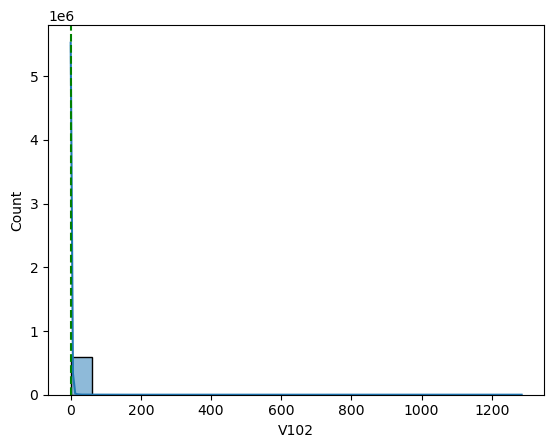

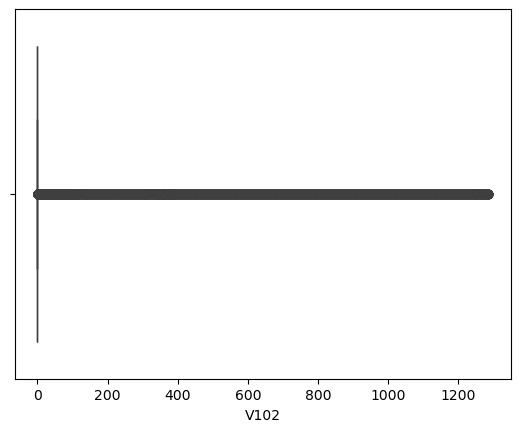


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.827229
std          35.928456
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max        1285.000000
Name: V102, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 120
Kolom :  V103


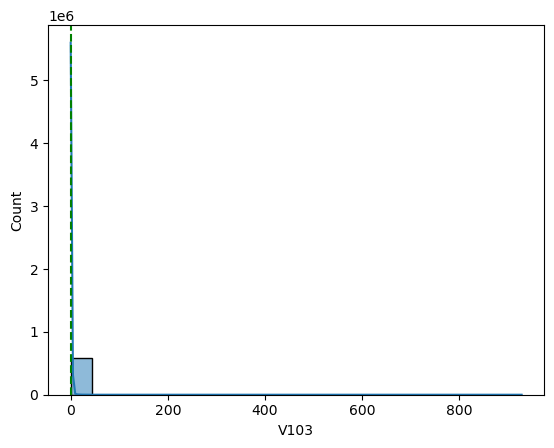

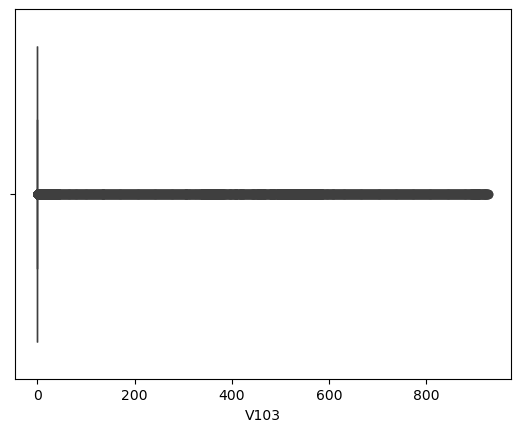


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.279288
std          25.685642
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max         928.000000
Name: V103, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 121
Kolom :  V104


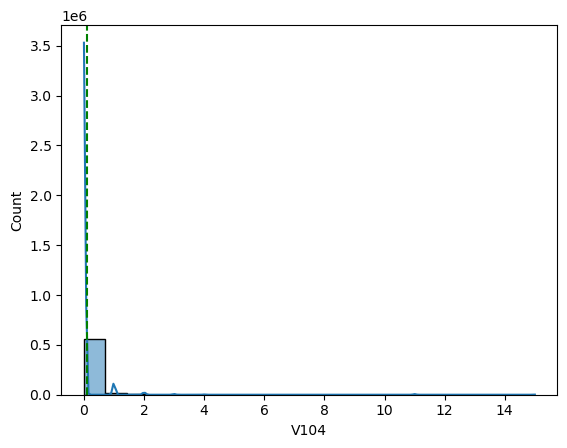

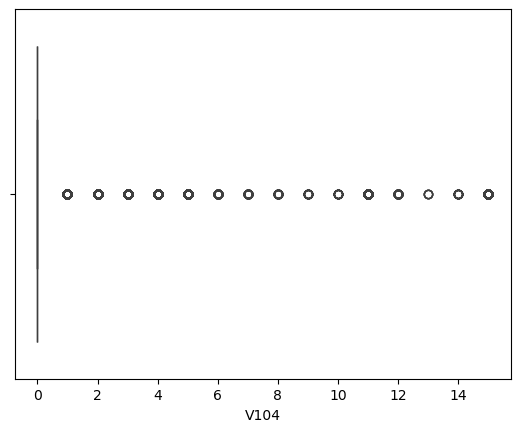


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          0.085433
std           0.648718
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          15.000000
Name: V104, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 122
Kolom :  V105


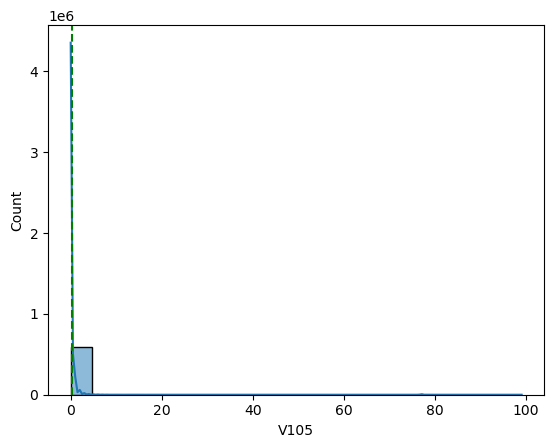

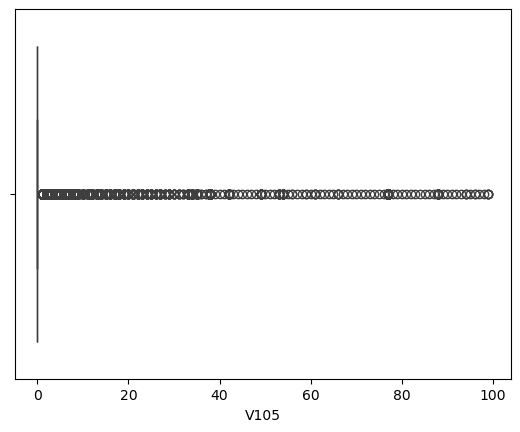


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          0.281145
std           3.373948
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          99.000000
Name: V105, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 123
Kolom :  V106


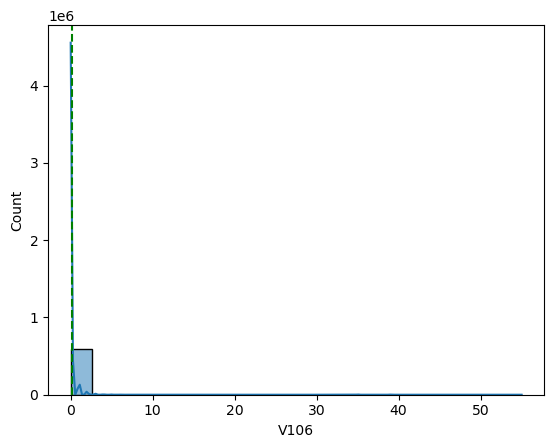

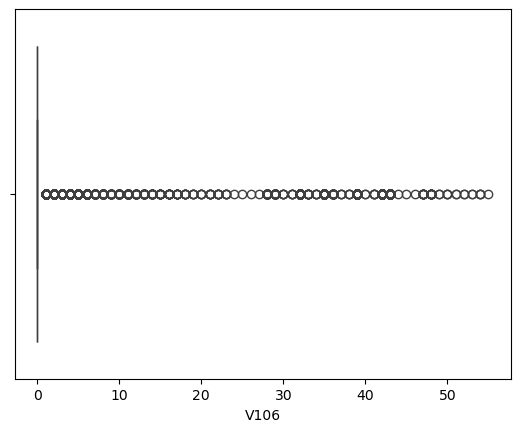


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          0.164584
std           1.825665
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          55.000000
Name: V106, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 124
Kolom :  V107


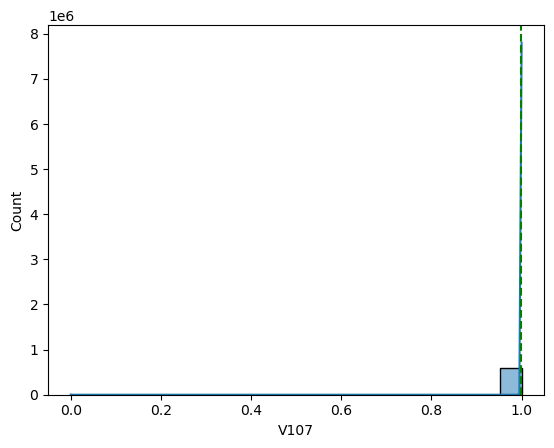

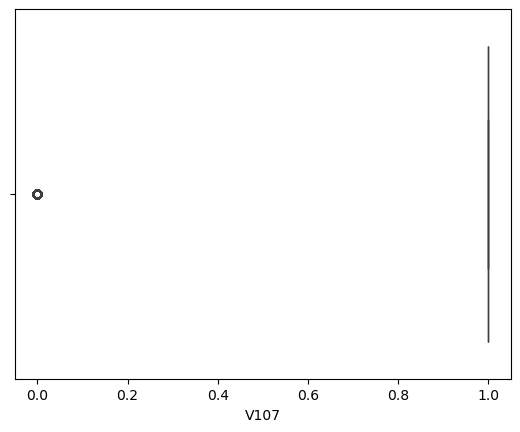


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          0.999580
std           0.020494
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           1.000000
Name: V107, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 125
Kolom :  V108


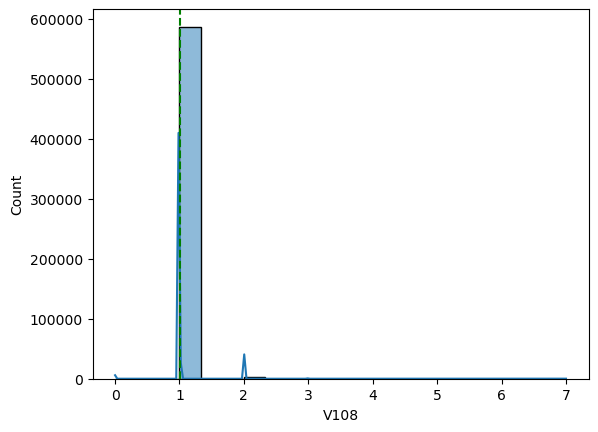

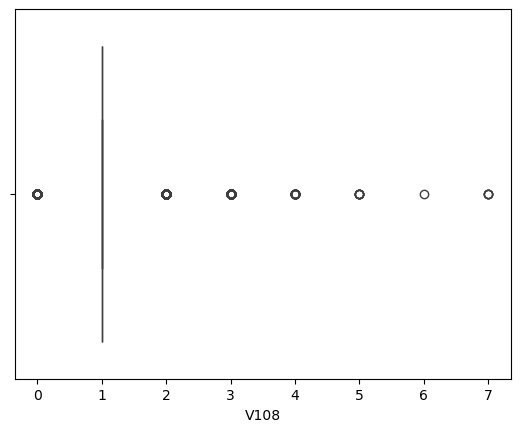


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.004613
std           0.081146
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           7.000000
Name: V108, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 126
Kolom :  V109


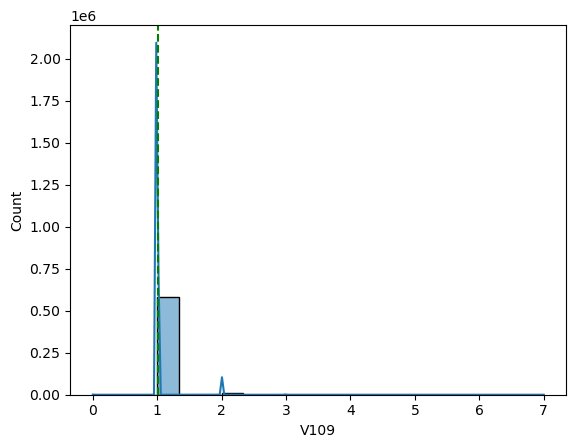

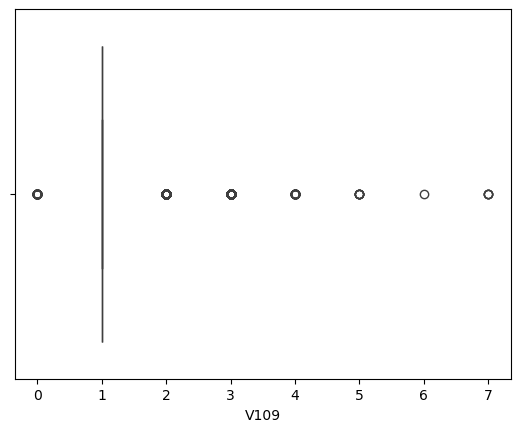


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.014816
std           0.127769
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           7.000000
Name: V109, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 127
Kolom :  V110


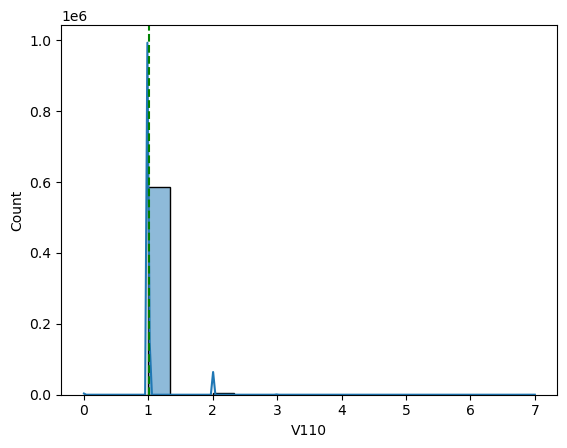

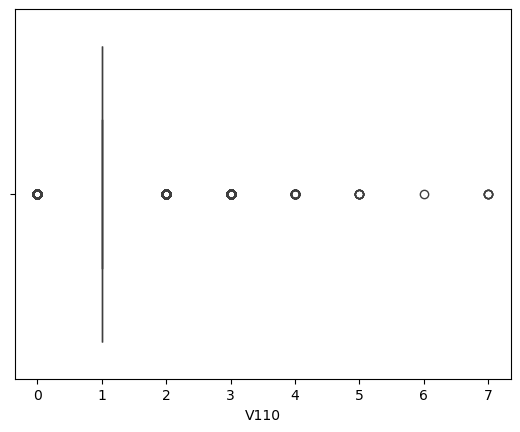


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.007739
std           0.097290
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           7.000000
Name: V110, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 128
Kolom :  V111


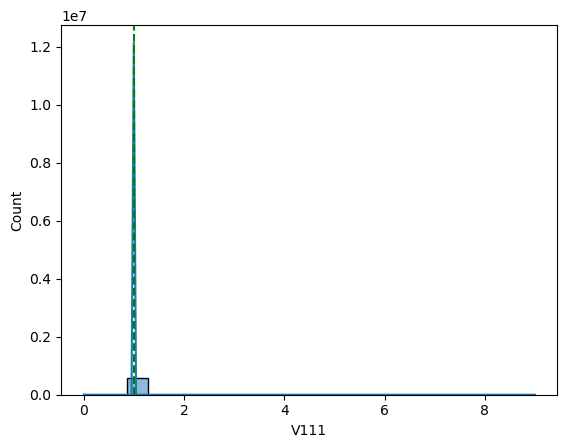

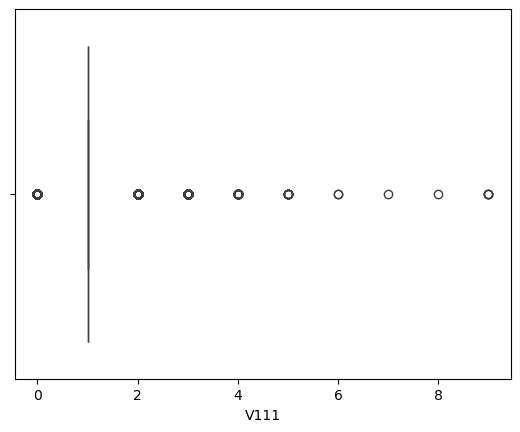


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.002563
std           0.070830
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           9.000000
Name: V111, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 129
Kolom :  V112


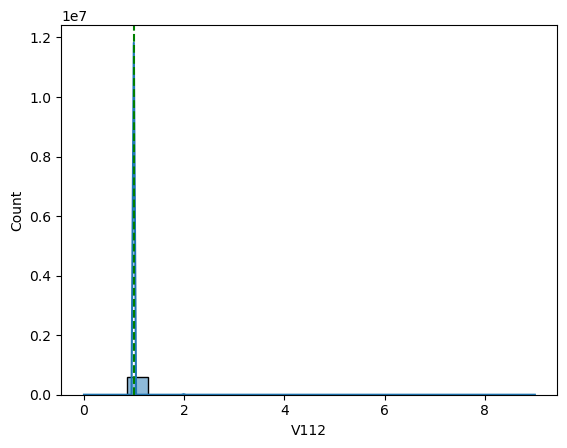

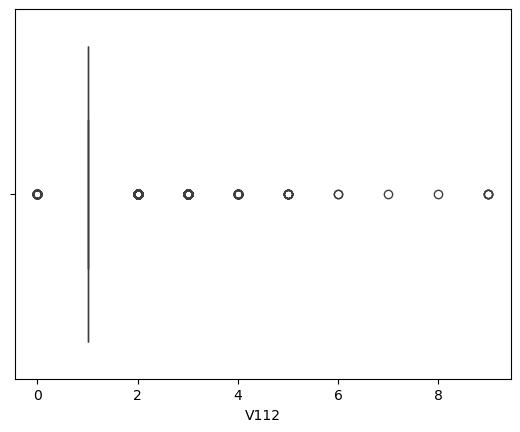


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.005356
std           0.084617
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           9.000000
Name: V112, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 130
Kolom :  V113


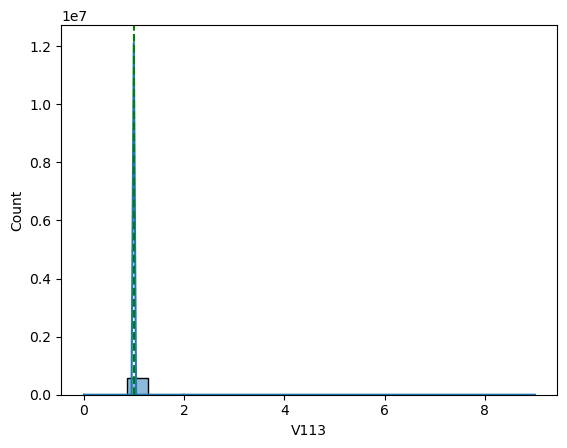

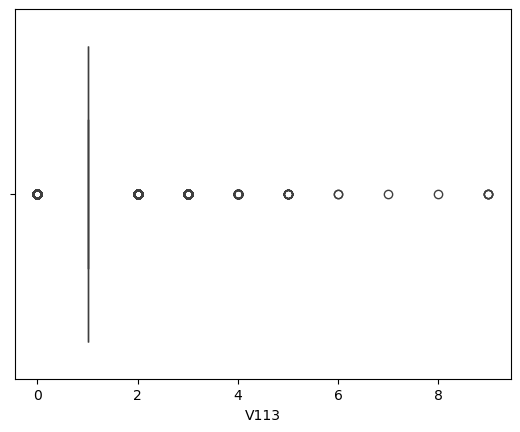


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.003383
std           0.074754
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           9.000000
Name: V113, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 131
Kolom :  V114


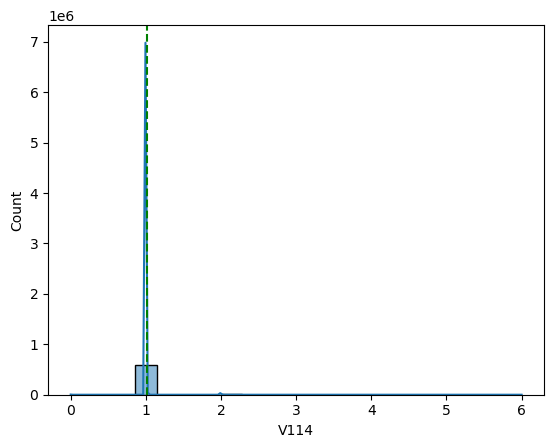

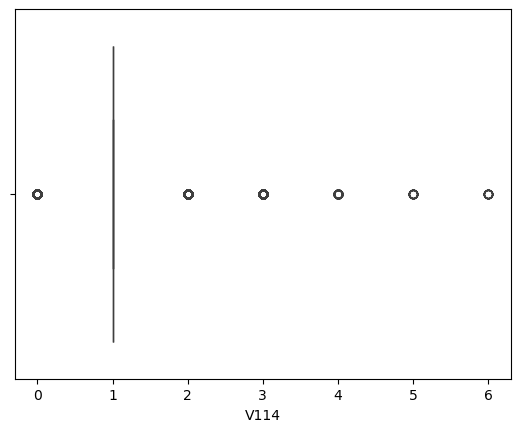


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.009298
std           0.110179
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           6.000000
Name: V114, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 132
Kolom :  V115


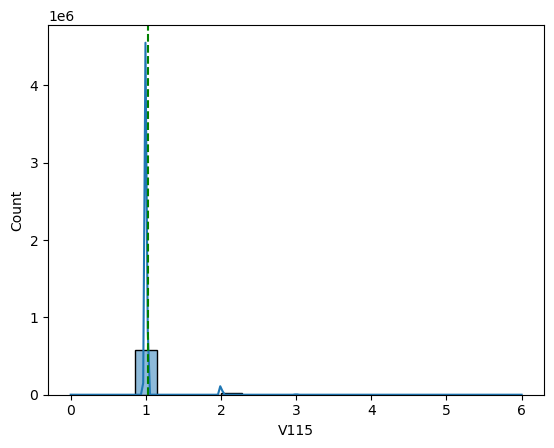

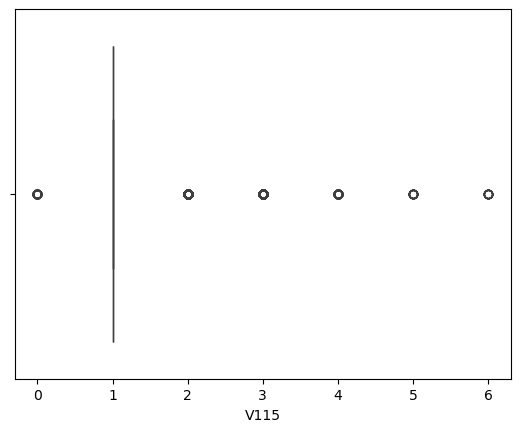


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.032450
std           0.190385
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           6.000000
Name: V115, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 133
Kolom :  V116


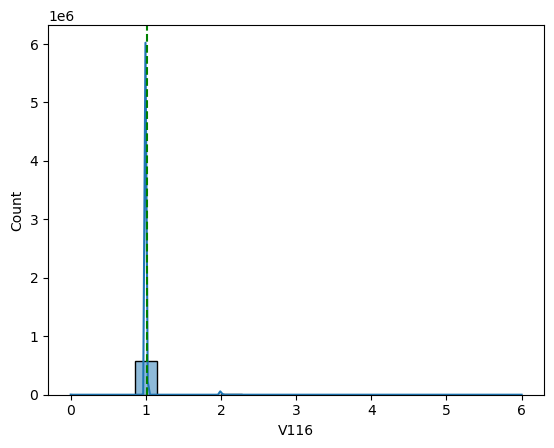

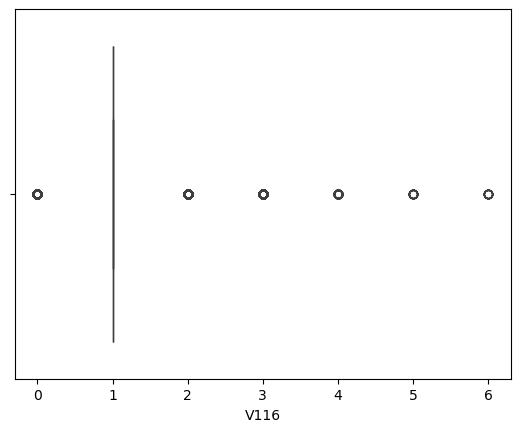


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.015738
std           0.136770
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           6.000000
Name: V116, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 134
Kolom :  V117


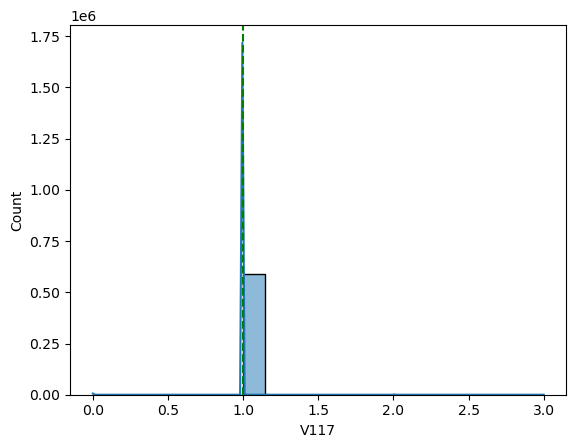

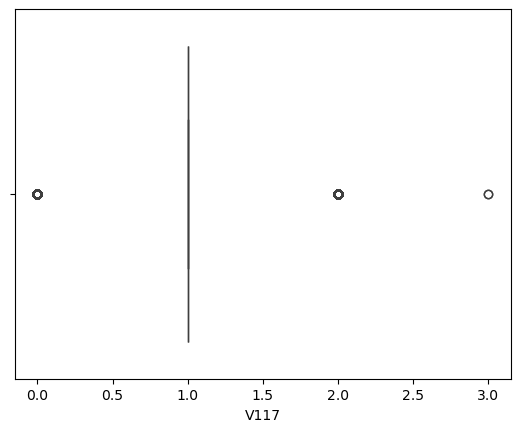


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.000391
std           0.035238
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           3.000000
Name: V117, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 135
Kolom :  V118


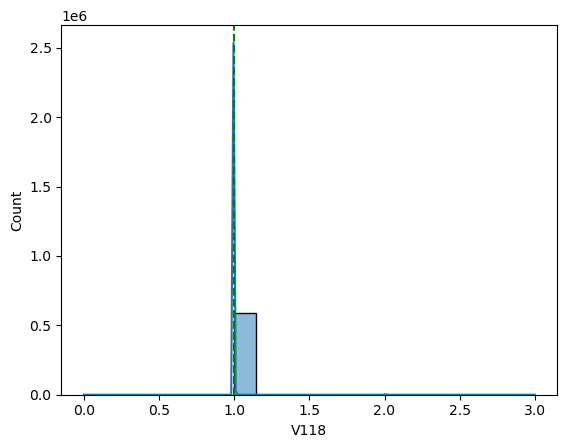

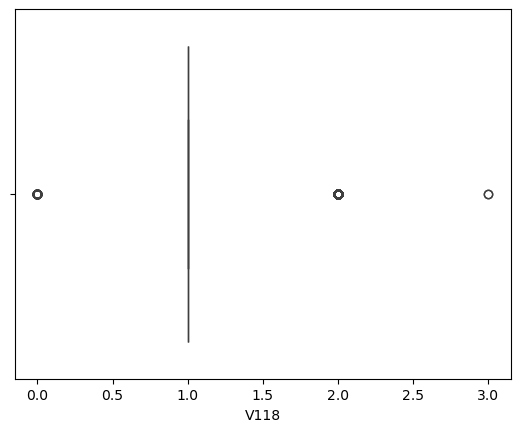


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.001474
std           0.041011
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           3.000000
Name: V118, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 136
Kolom :  V119


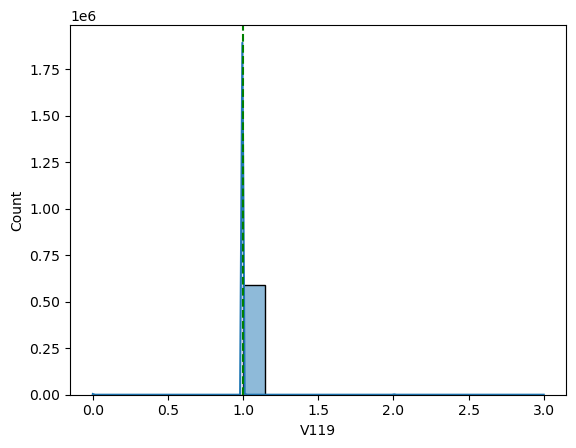

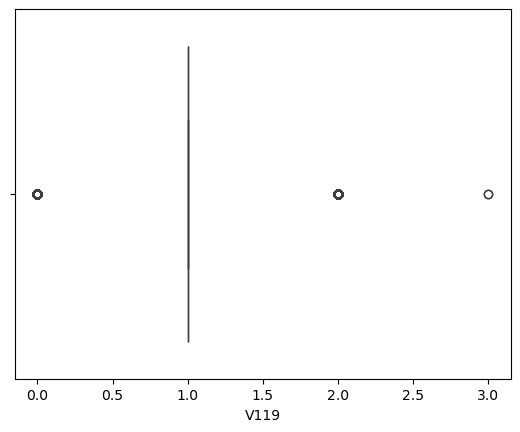


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.000729
std           0.036392
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           3.000000
Name: V119, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 137
Kolom :  V120


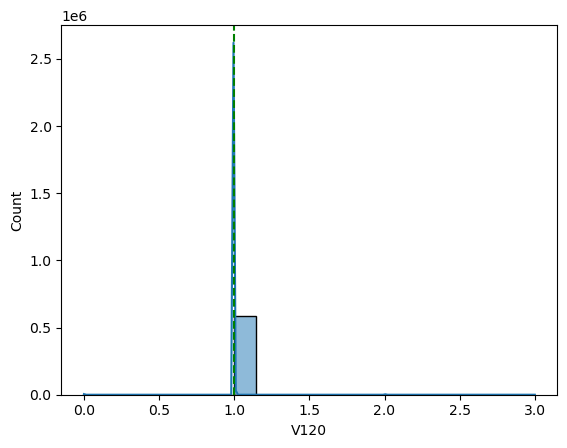

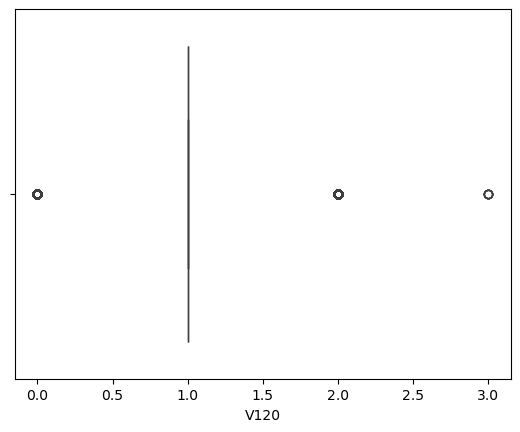


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.000874
std           0.041684
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           3.000000
Name: V120, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 138
Kolom :  V121


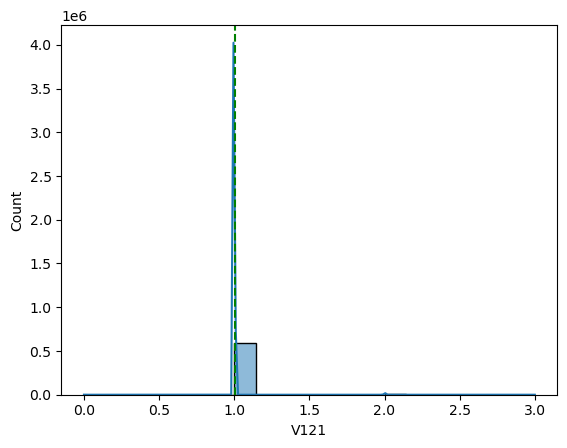

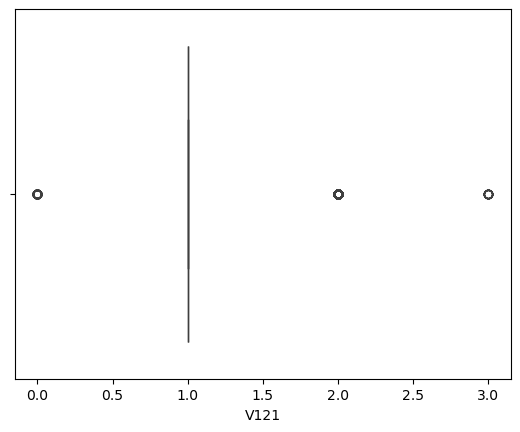


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.004276
std           0.067097
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           3.000000
Name: V121, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 139
Kolom :  V122


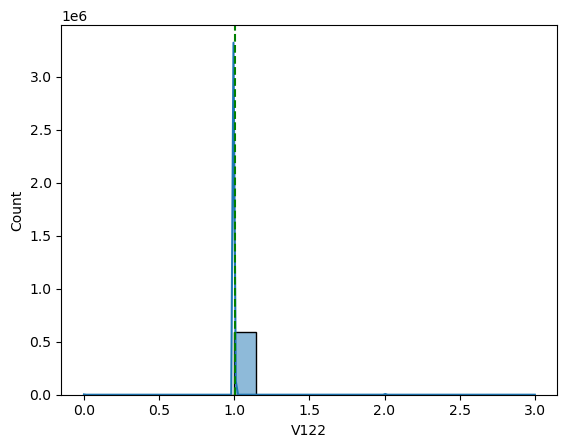

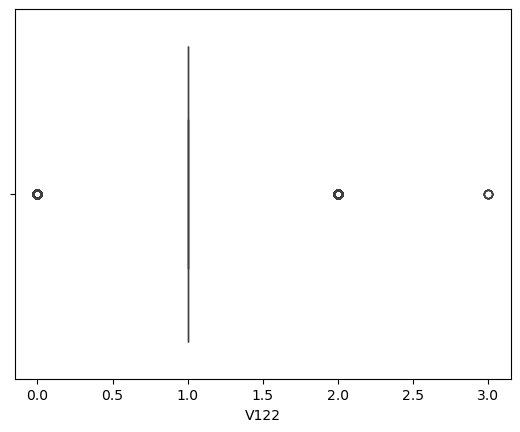


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.001759
std           0.048636
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           3.000000
Name: V122, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 140
Kolom :  V123


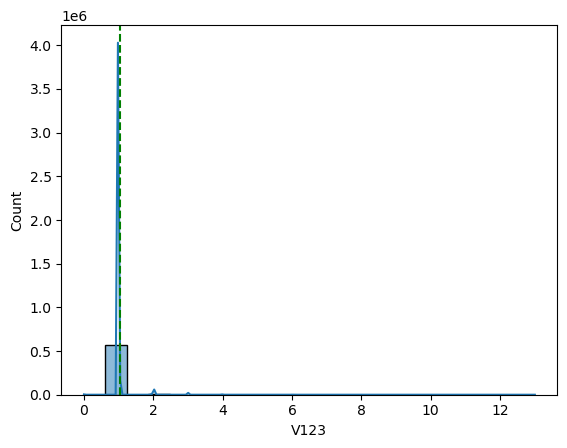

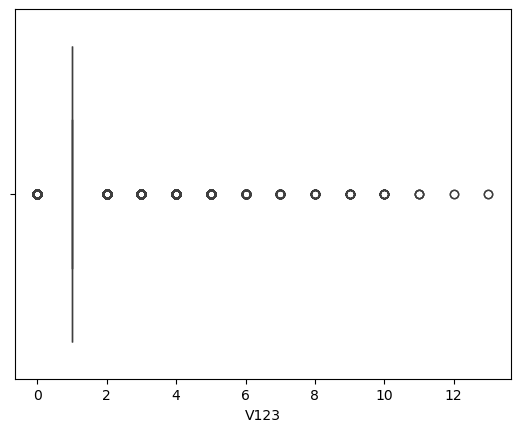


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.031120
std           0.228134
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          13.000000
Name: V123, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 141
Kolom :  V124


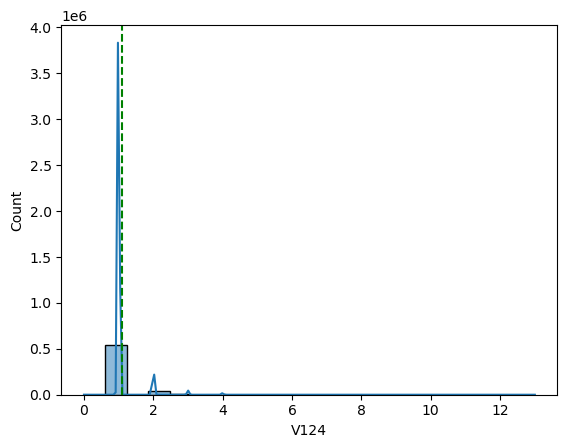

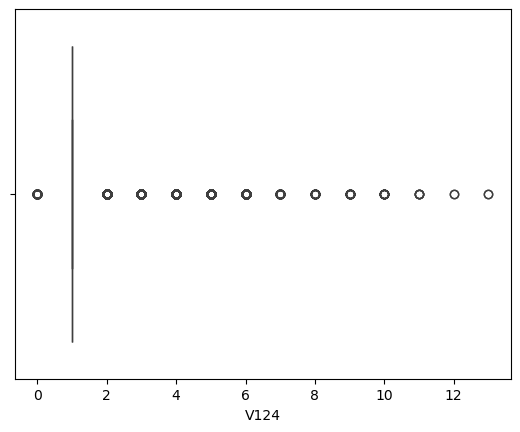


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.092975
std           0.374103
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          13.000000
Name: V124, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 142
Kolom :  V125


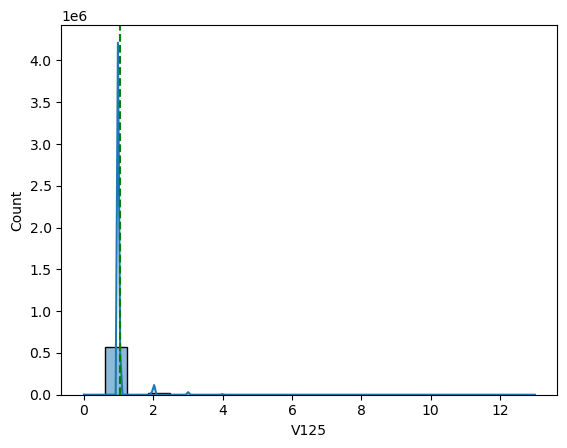

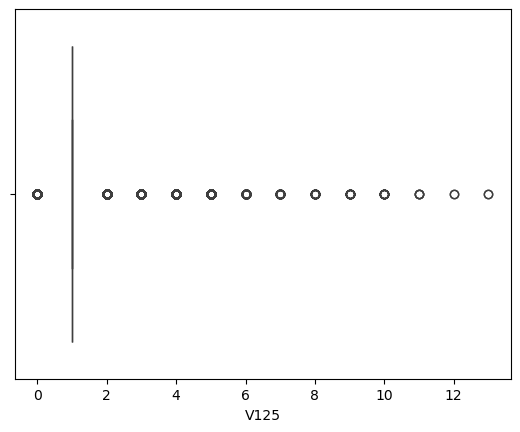


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          1.050415
std           0.280037
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          13.000000
Name: V125, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 143
Kolom :  V126


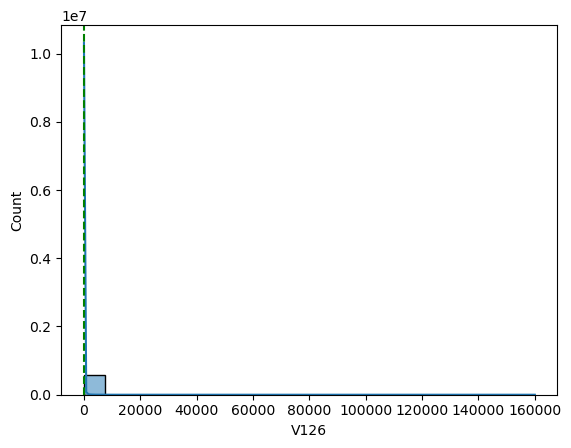

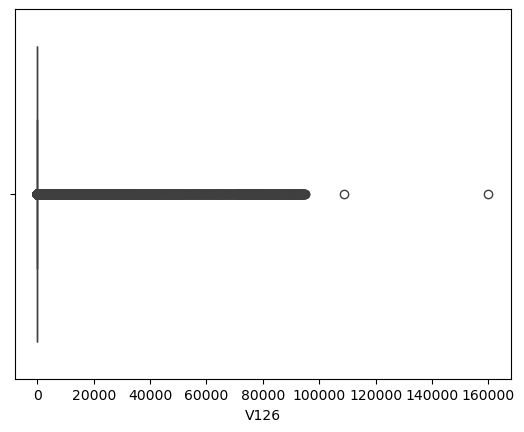


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean        129.979417
std        2346.951681
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max      160000.000000
Name: V126, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 144
Kolom :  V127


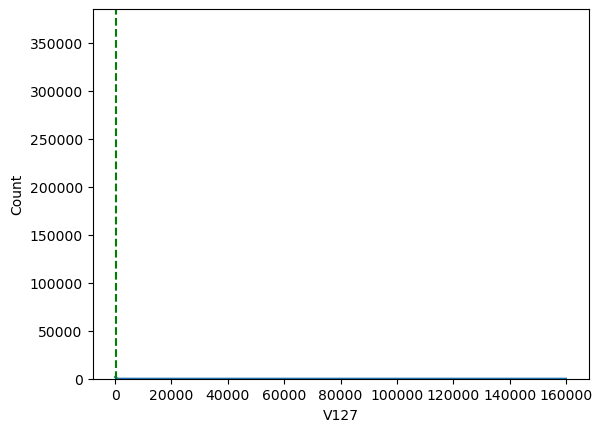

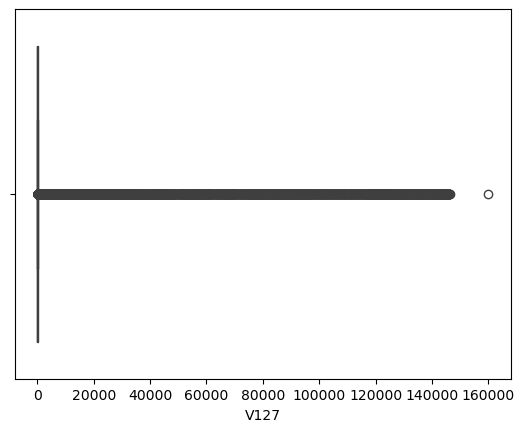


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean        336.611559
std        4238.666949
min           0.000000
25%           0.000000
50%           0.000000
75%         107.949997
max      160000.000000
Name: V127, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 145
Kolom :  V128


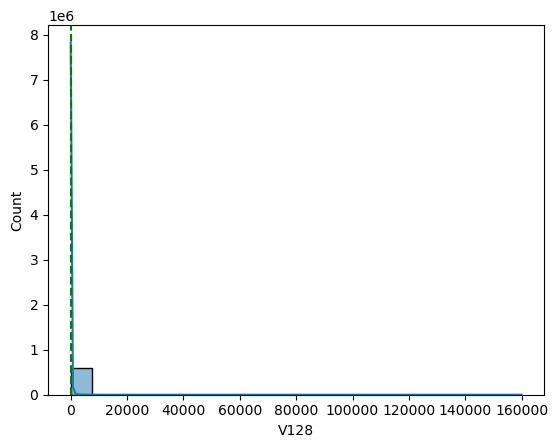

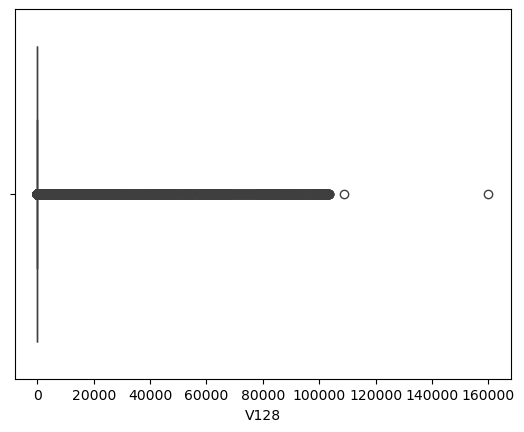


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean        204.094038
std        3010.258774
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max      160000.000000
Name: V128, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 146
Kolom :  V129


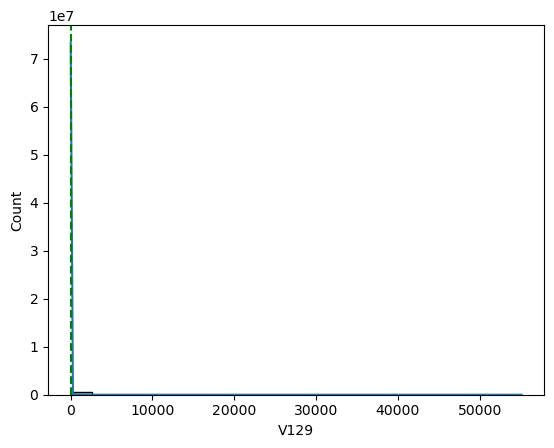

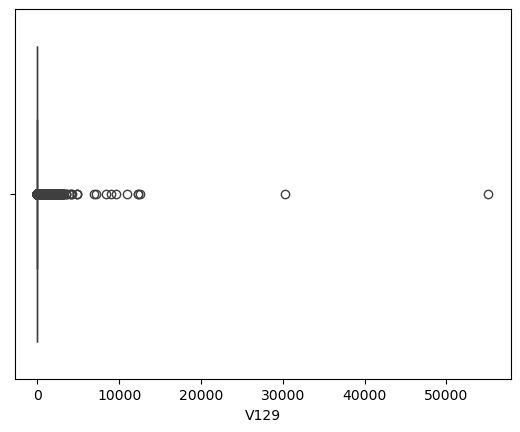


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean          8.768944
std         113.832828
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       55125.000000
Name: V129, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 147
Kolom :  V130


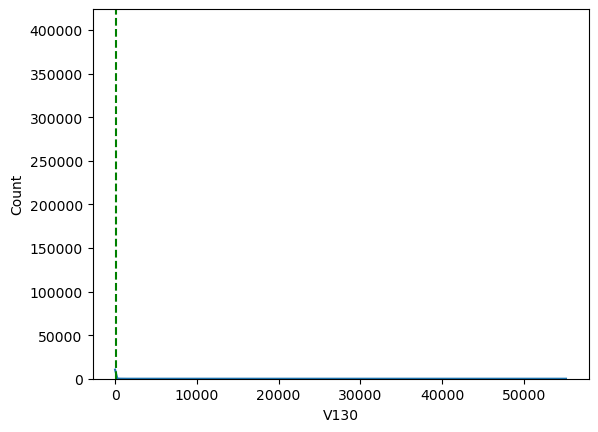

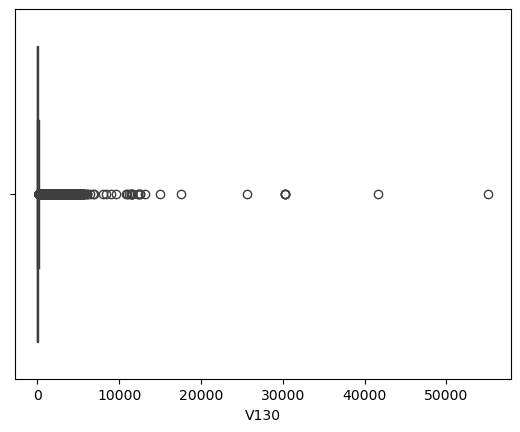


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean         92.165849
std         315.960485
min           0.000000
25%           0.000000
50%           0.000000
75%          59.000000
max       55125.000000
Name: V130, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 148
Kolom :  V131


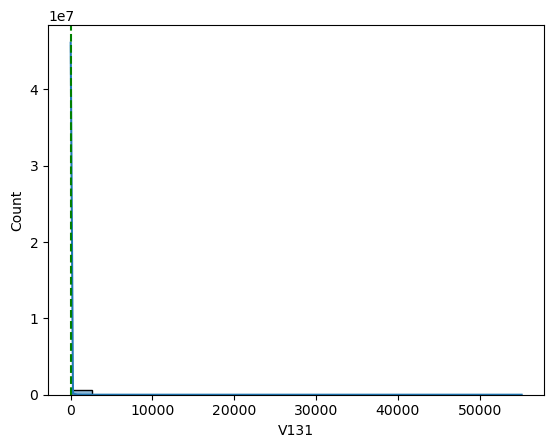

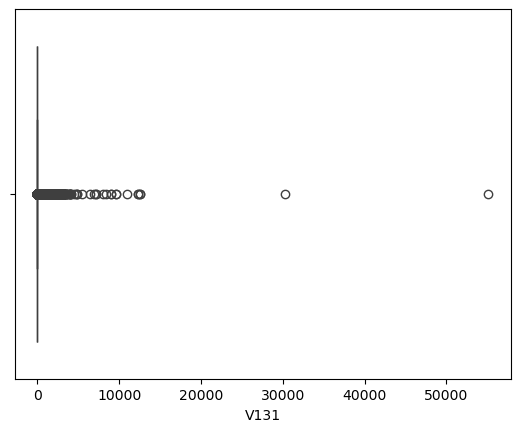


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean         31.133302
std         161.161258
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       55125.000000
Name: V131, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 149
Kolom :  V132


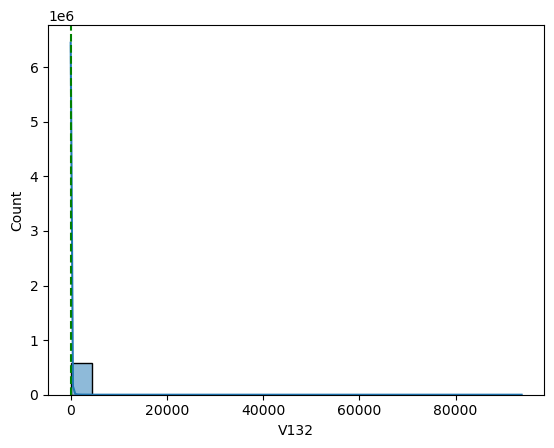

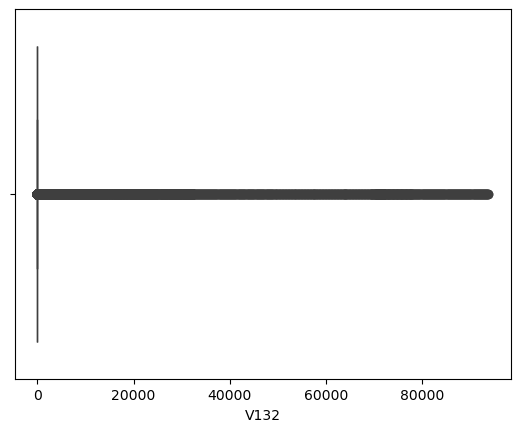


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean        103.513188
std        2266.106140
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       93736.000000
Name: V132, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 150
Kolom :  V133


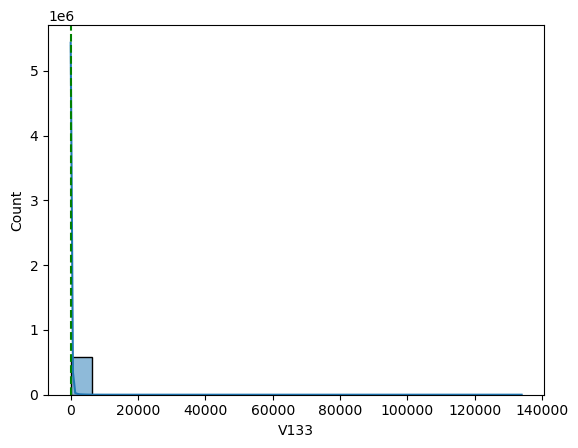

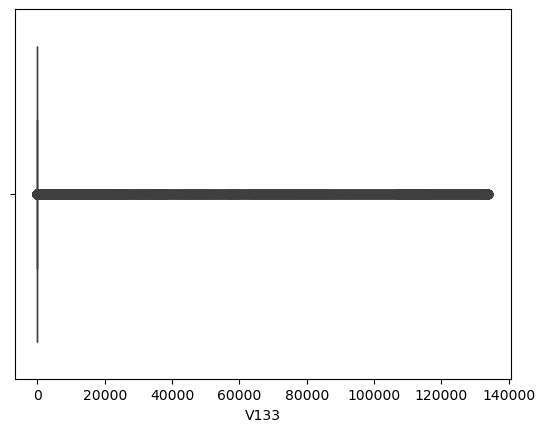


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean        204.889160
std        3796.316755
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max      133915.000000
Name: V133, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 151
Kolom :  V134


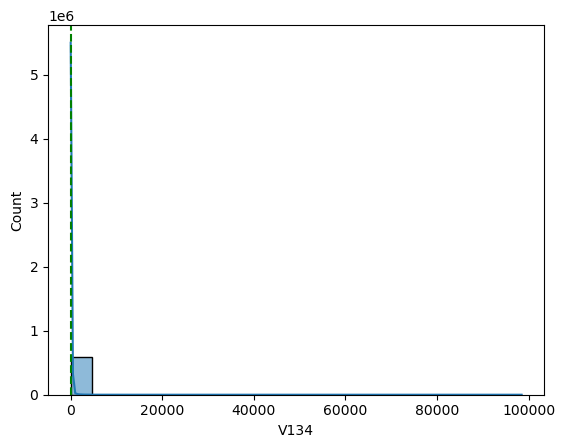

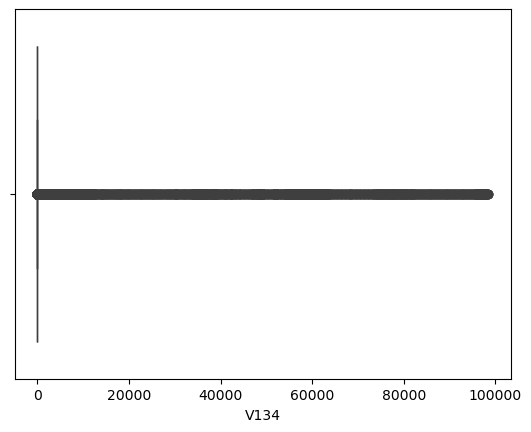


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean        145.972328
std        2772.986817
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       98476.000000
Name: V134, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 152
Kolom :  V135


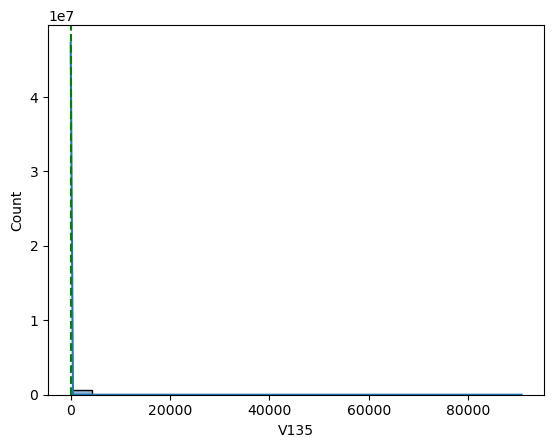

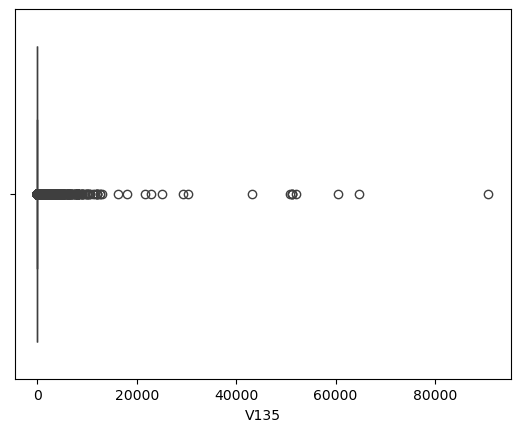


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean         17.250132
std         293.847563
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       90750.000000
Name: V135, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 153
Kolom :  V136


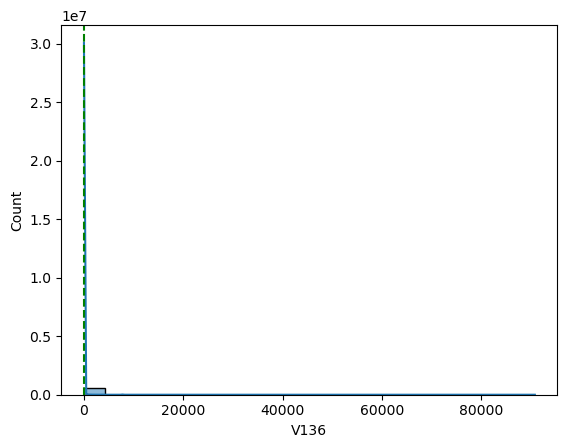

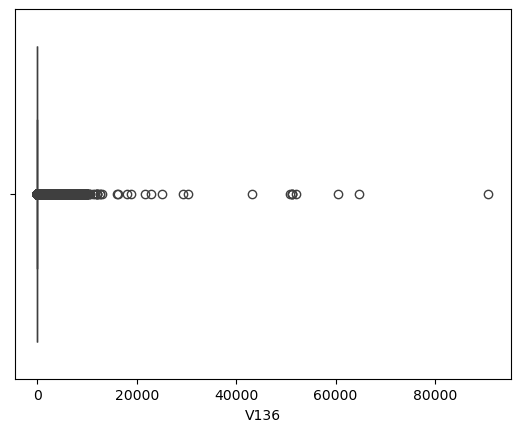


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean         38.821196
std         451.808411
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       90750.000000
Name: V136, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 154
Kolom :  V137


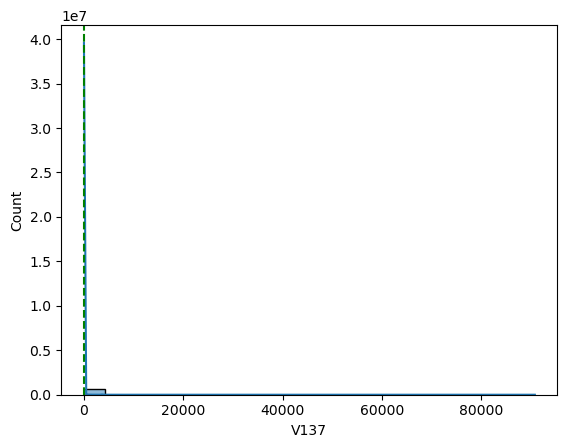

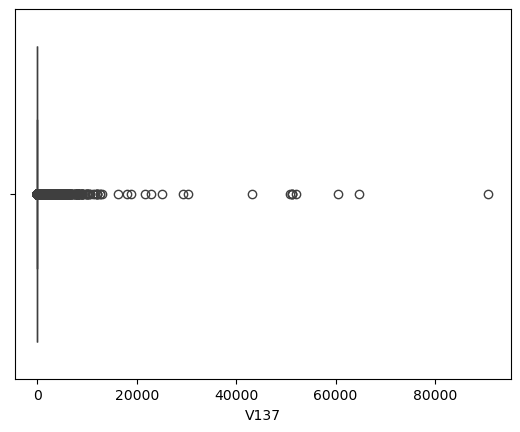


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590226.000000
mean         26.365090
std         348.332714
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       90750.000000
Name: V137, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 155
Kolom :  V279


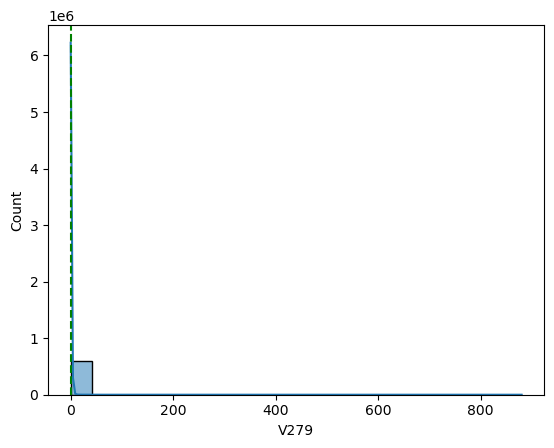

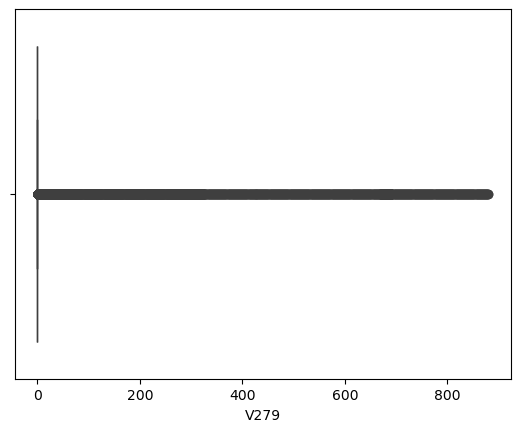


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          1.123061
std          21.021950
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max         880.000000
Name: V279, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 156
Kolom :  V280


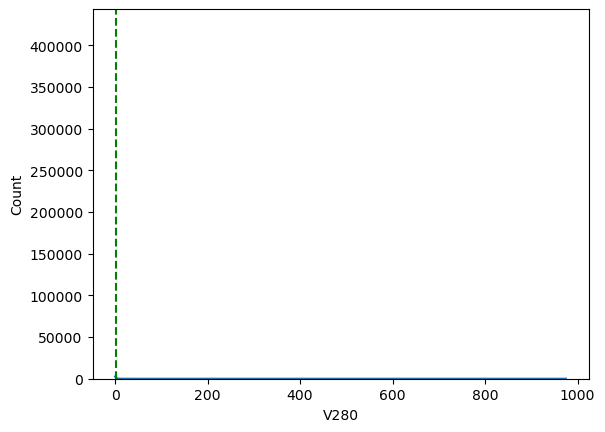

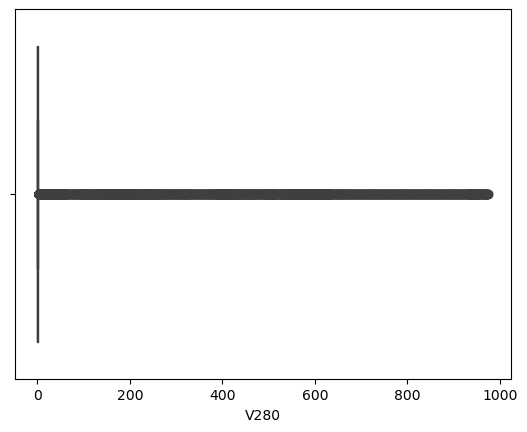


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          1.967082
std          27.851780
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max         975.000000
Name: V280, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 157
Kolom :  V281


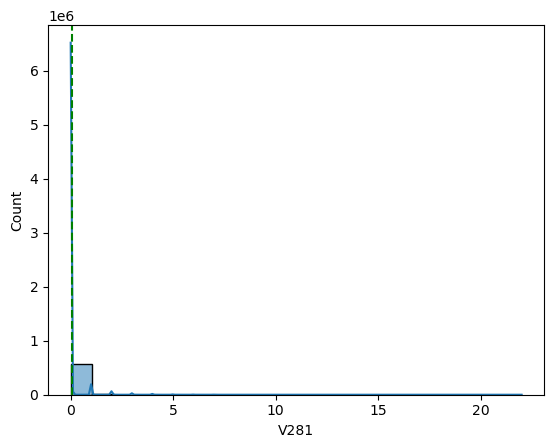

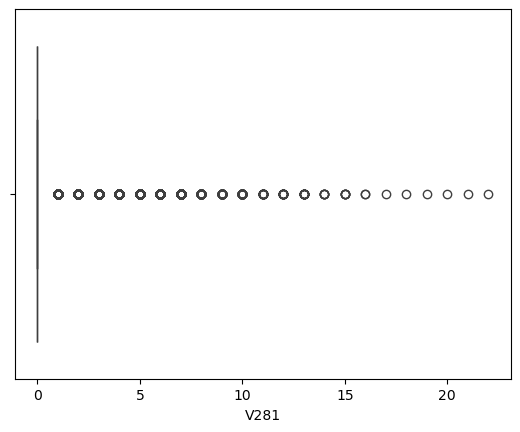


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    589271.000000
mean          0.087783
std           0.512748
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          22.000000
Name: V281, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 158
Kolom :  V282


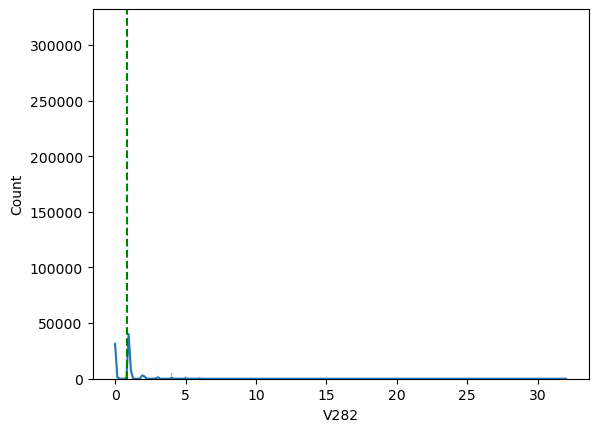

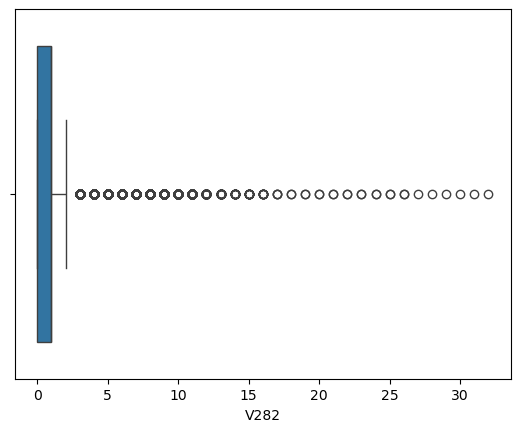


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    589271.000000
mean          0.817171
std           0.921880
min           0.000000
25%           0.000000
50%           1.000000
75%           1.000000
max          32.000000
Name: V282, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 159
Kolom :  V283


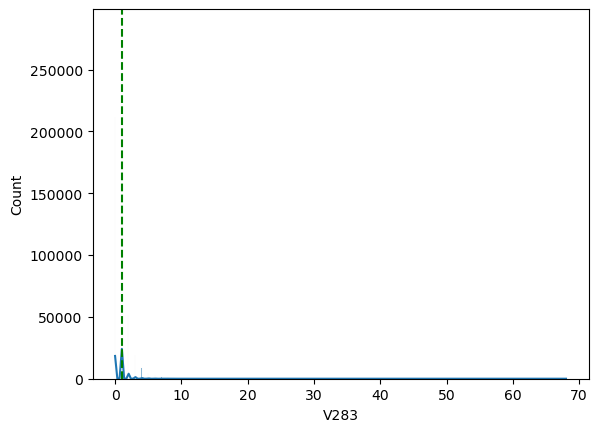

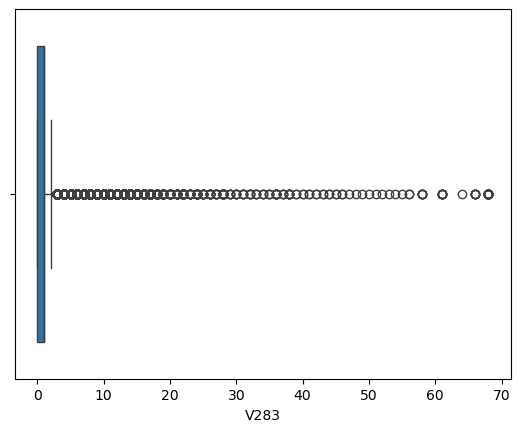


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    589271.000000
mean          0.991114
std           1.558731
min           0.000000
25%           0.000000
50%           1.000000
75%           1.000000
max          68.000000
Name: V283, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 160
Kolom :  V284


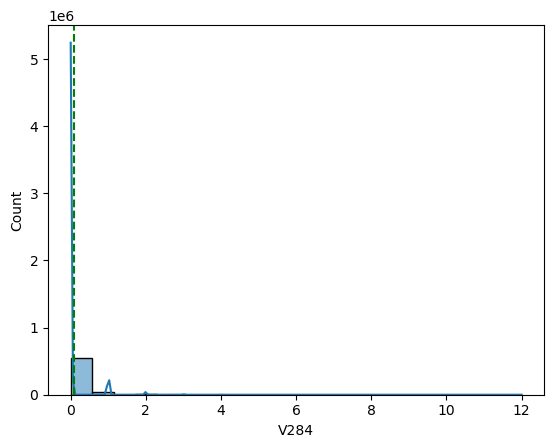

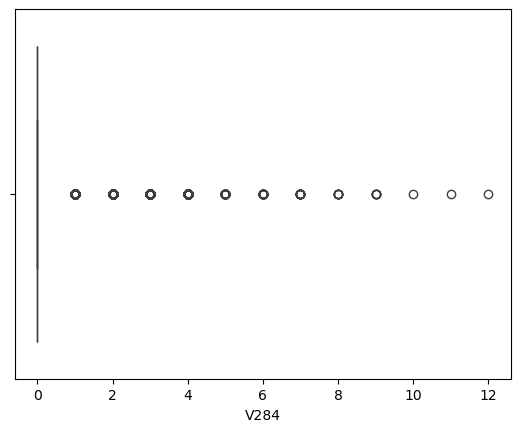


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          0.088543
std           0.338424
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          12.000000
Name: V284, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 161
Kolom :  V285


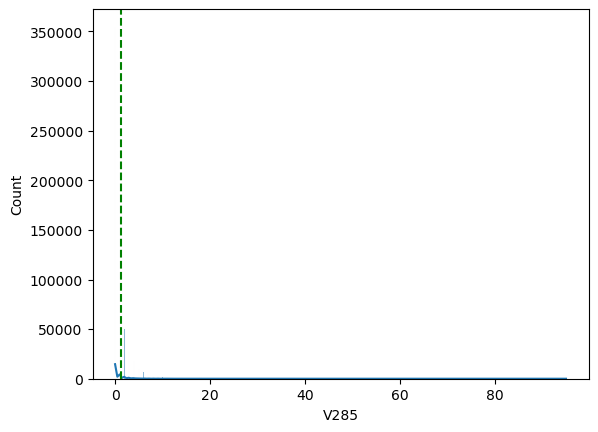

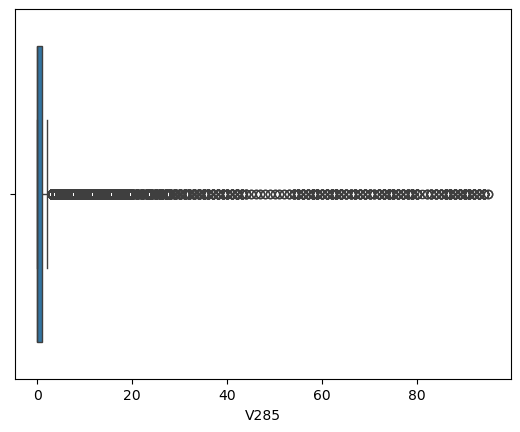


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          1.167660
std           3.282454
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max          95.000000
Name: V285, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 162
Kolom :  V286


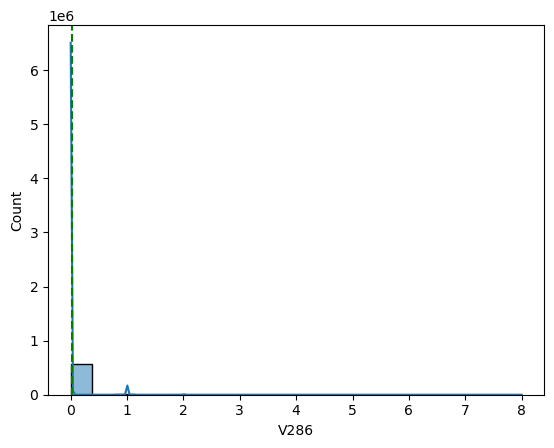

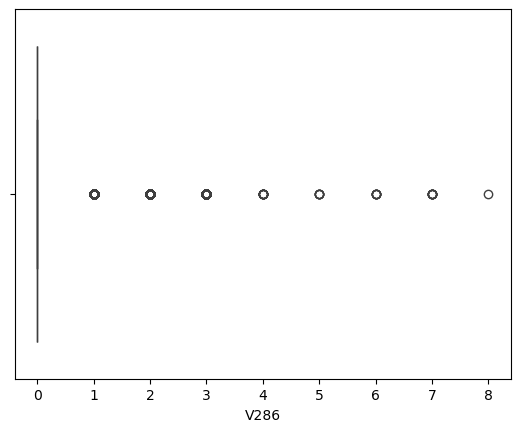


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          0.031492
std           0.190939
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           8.000000
Name: V286, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 163
Kolom :  V287


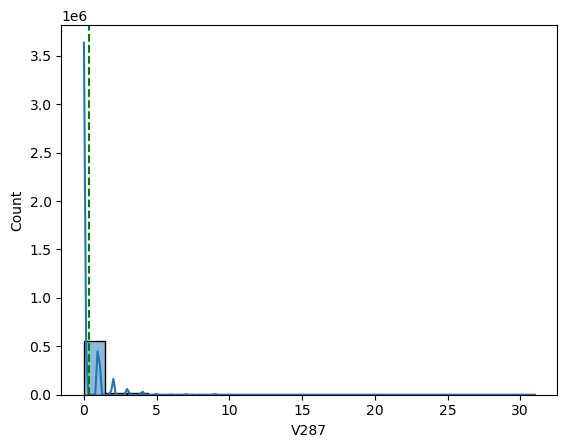

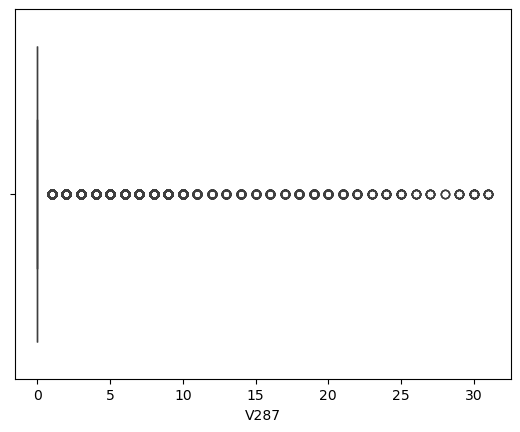


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          0.358579
std           1.078995
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          31.000000
Name: V287, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 164
Kolom :  V288


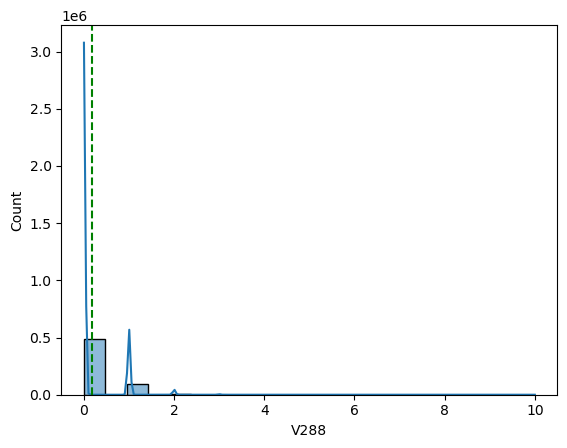

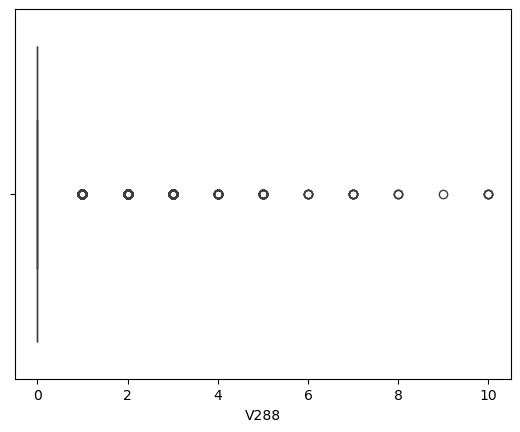


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    589271.000000
mean          0.184350
std           0.430989
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          10.000000
Name: V288, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 165
Kolom :  V289


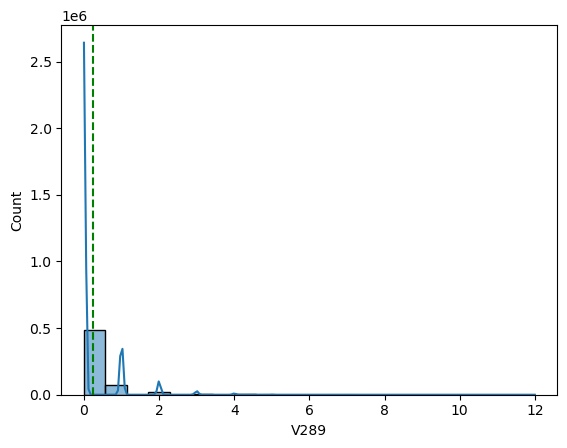

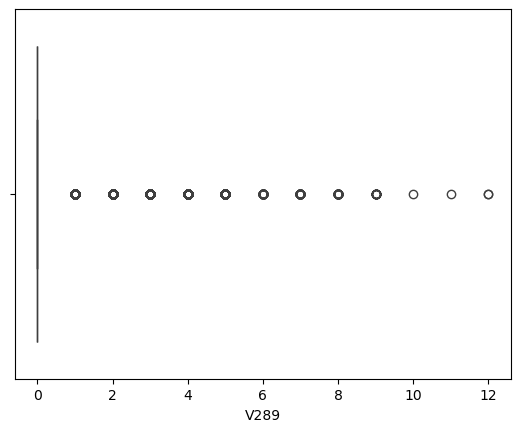


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    589271.000000
mean          0.235975
std           0.599231
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          12.000000
Name: V289, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 166
Kolom :  V290


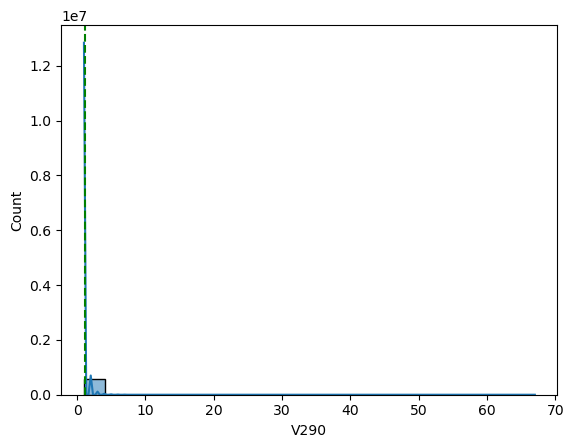

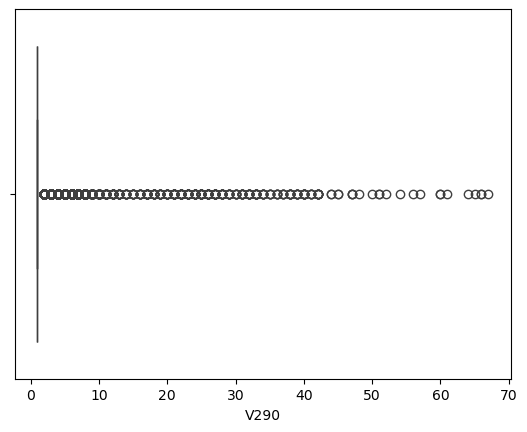


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          1.103011
std           0.768897
min           1.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          67.000000
Name: V290, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 167
Kolom :  V291


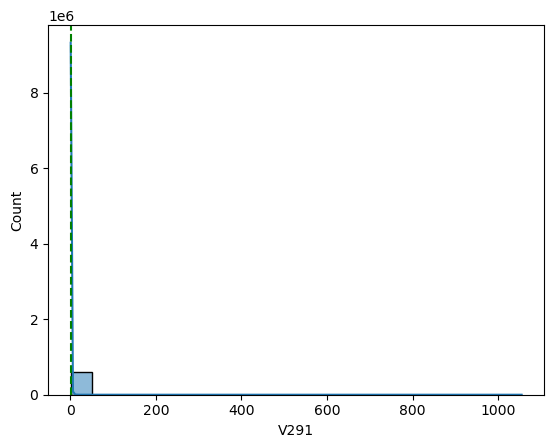

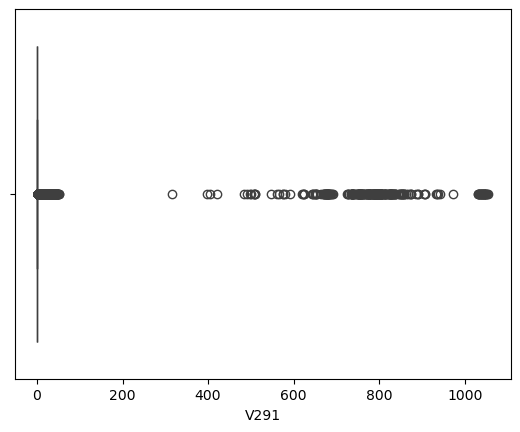


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          1.659811
std          16.252538
min           1.000000
25%           1.000000
50%           1.000000
75%           1.000000
max        1055.000000
Name: V291, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 168
Kolom :  V292


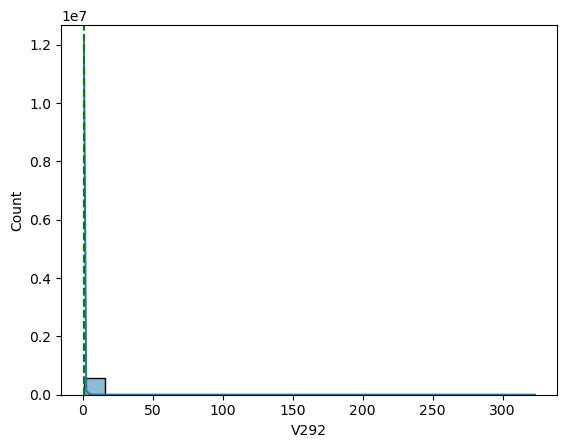

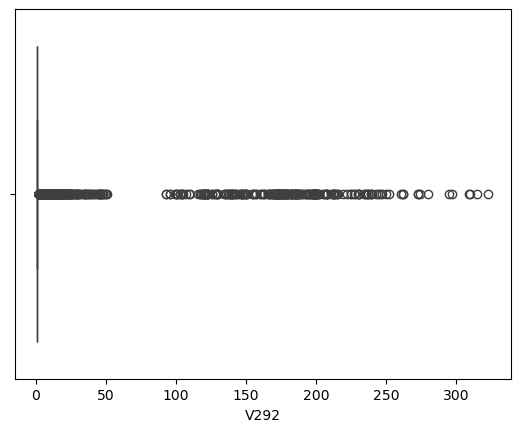


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          1.239916
std           3.775050
min           1.000000
25%           1.000000
50%           1.000000
75%           1.000000
max         323.000000
Name: V292, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 169
Kolom :  V293


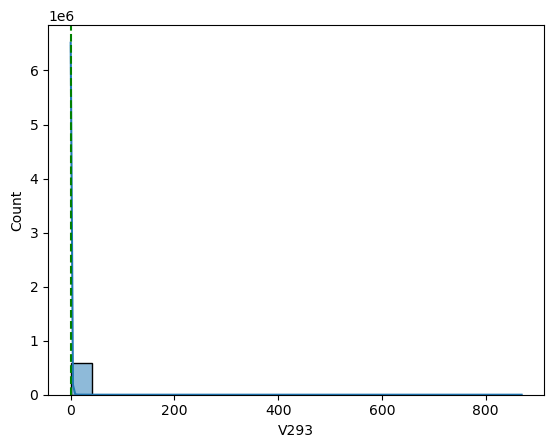

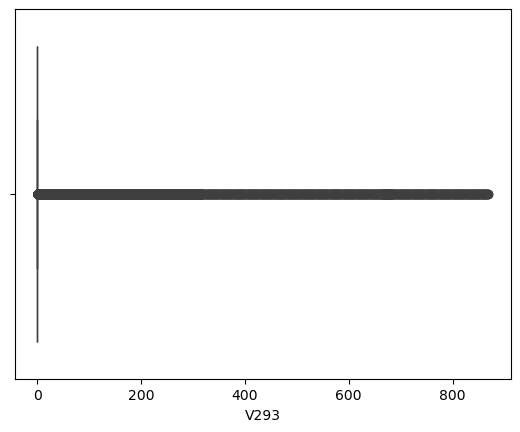


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          0.942599
std          20.588816
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max         869.000000
Name: V293, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 170
Kolom :  V294


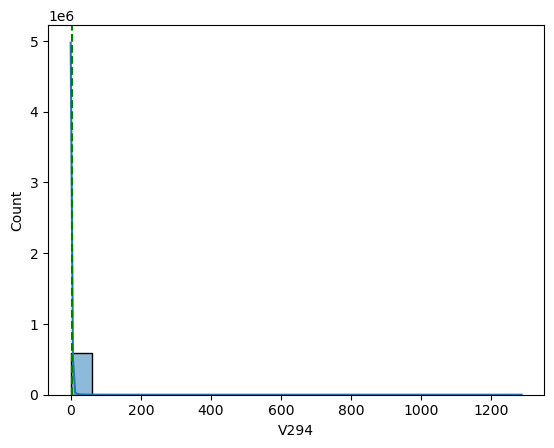

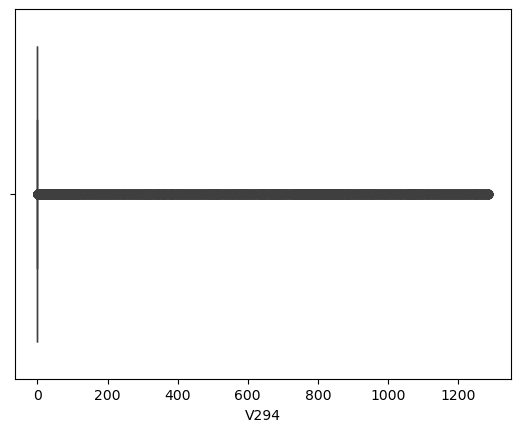


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          2.313863
std          39.526468
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max        1286.000000
Name: V294, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 171
Kolom :  V295


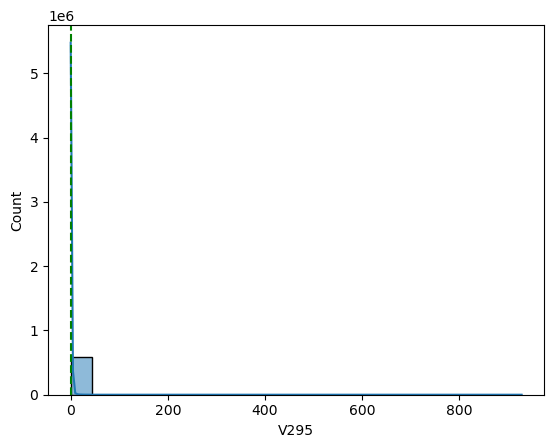

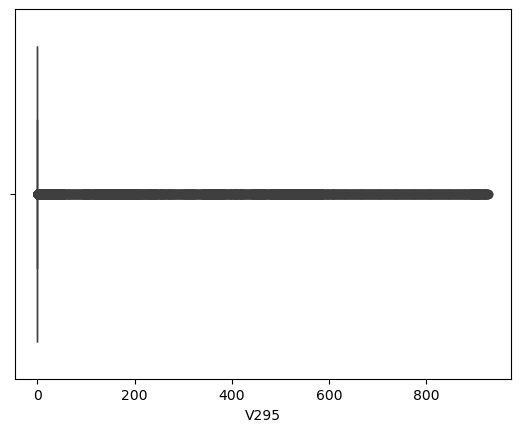


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          1.433424
std          25.962948
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max         928.000000
Name: V295, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 172
Kolom :  V296


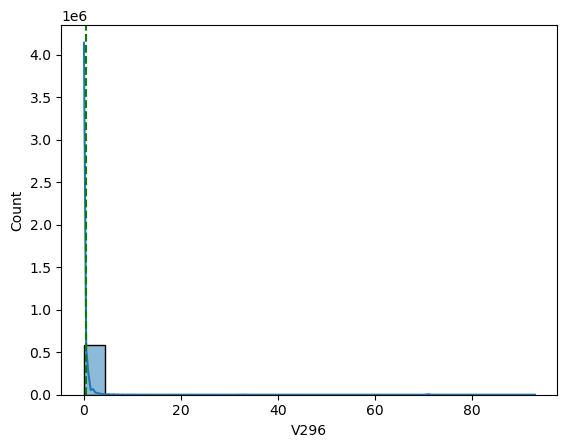

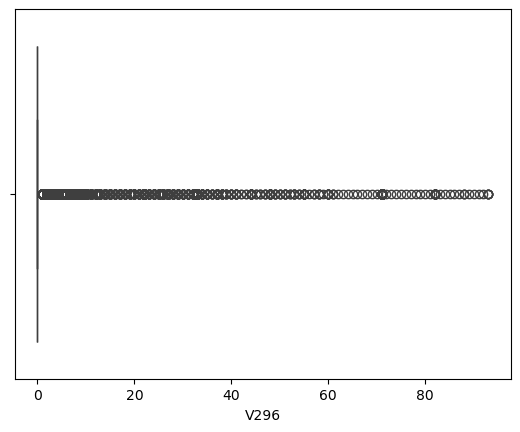


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    589271.000000
mean          0.328917
std           3.264745
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          93.000000
Name: V296, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 173
Kolom :  V297


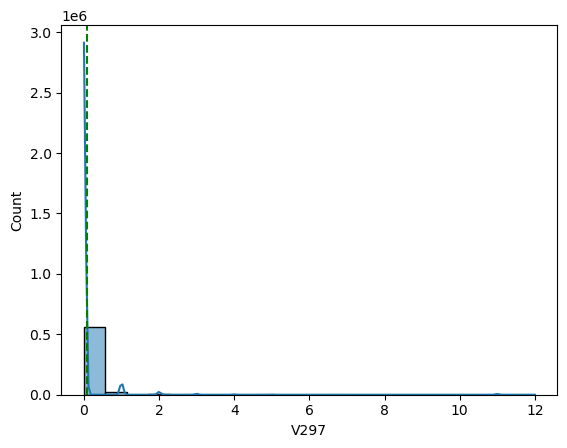

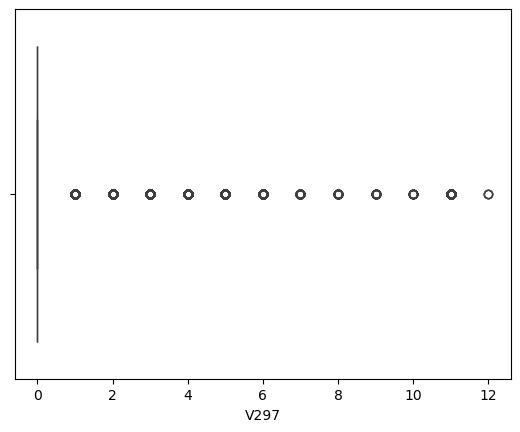


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          0.089034
std           0.628352
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          12.000000
Name: V297, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 174
Kolom :  V298


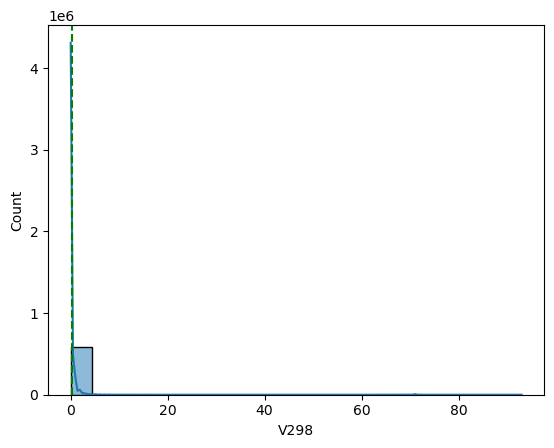

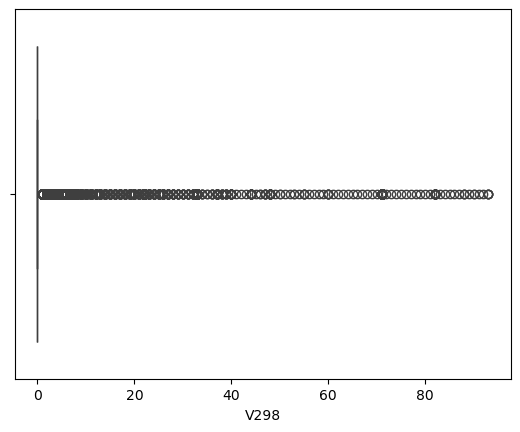


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          0.298829
std           3.175062
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          93.000000
Name: V298, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 175
Kolom :  V299


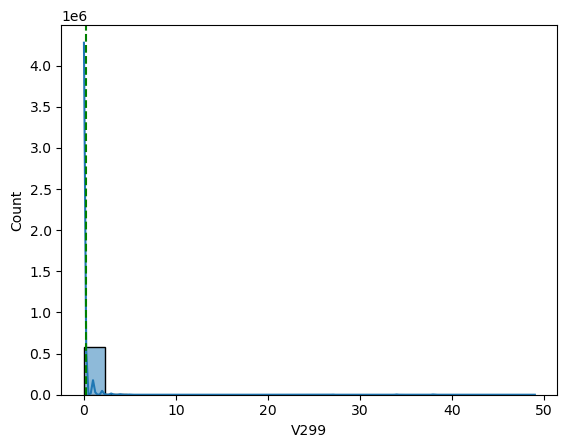

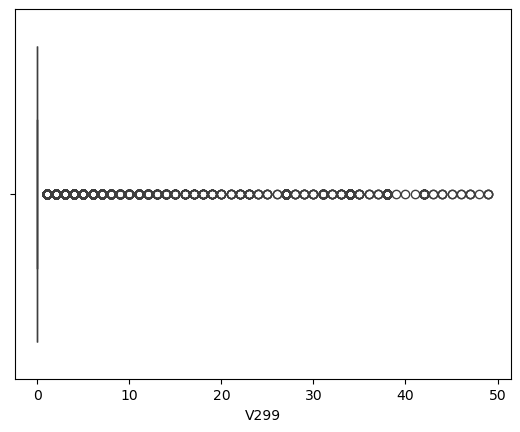


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          0.171655
std           1.724218
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          49.000000
Name: V299, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 176
Kolom :  V300


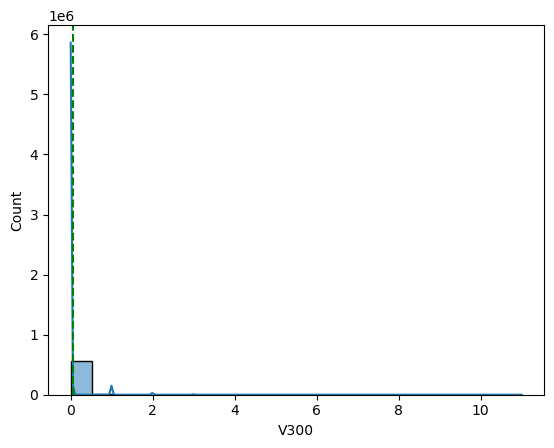

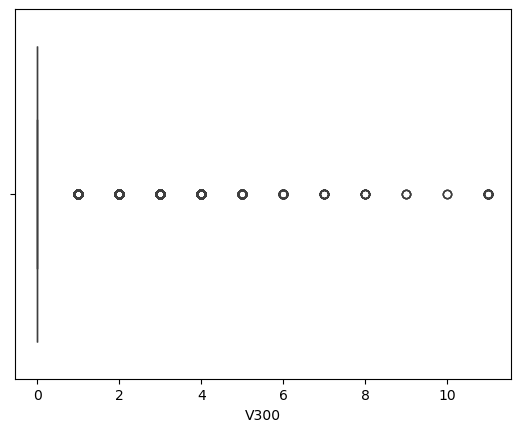


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    589271.000000
mean          0.045507
std           0.289573
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          11.000000
Name: V300, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 177
Kolom :  V301


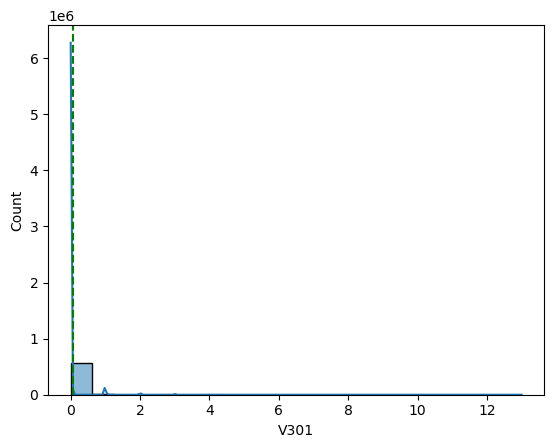

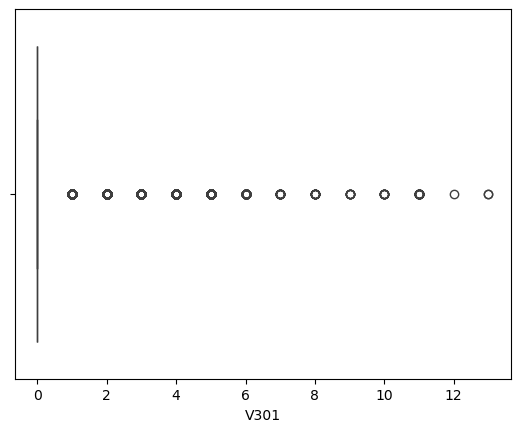


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    589271.000000
mean          0.052002
std           0.318310
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          13.000000
Name: V301, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 178
Kolom :  V302


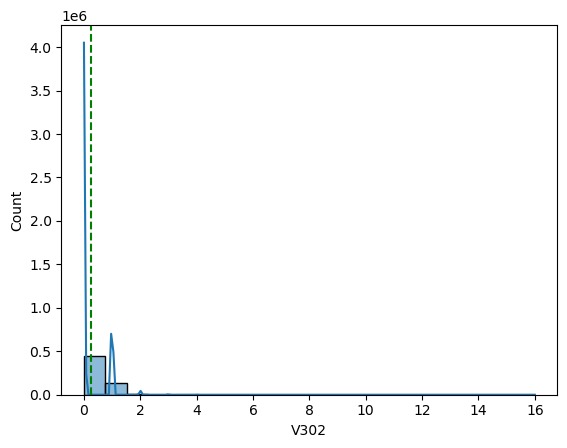

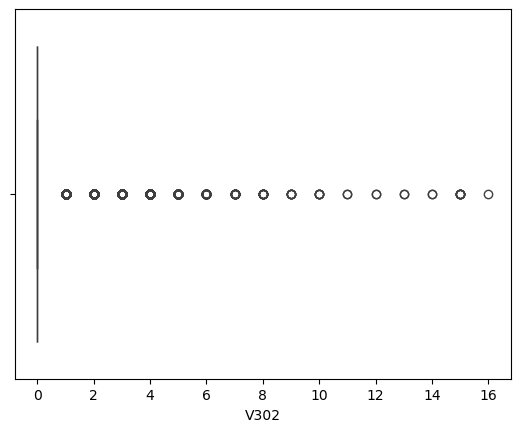


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          0.251761
std           0.481889
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          16.000000
Name: V302, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 179
Kolom :  V303


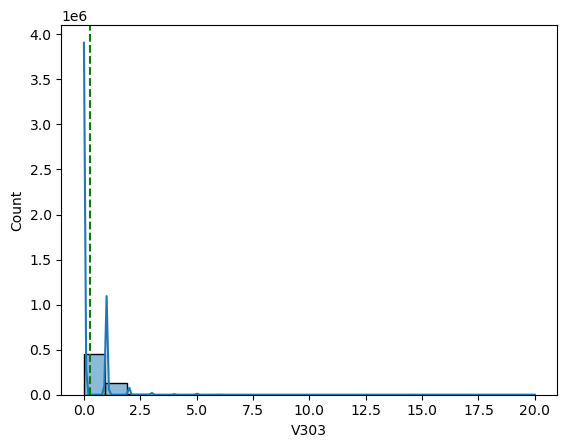

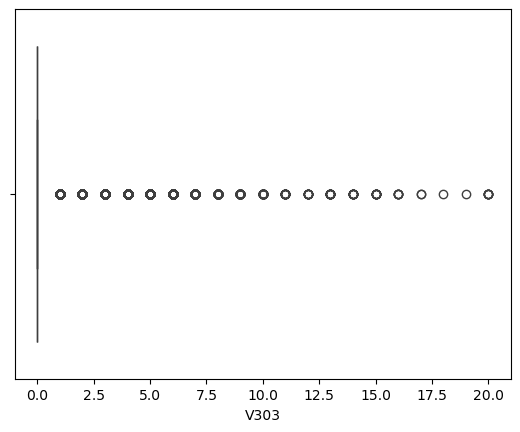


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          0.283140
std           0.623608
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          20.000000
Name: V303, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 180
Kolom :  V304


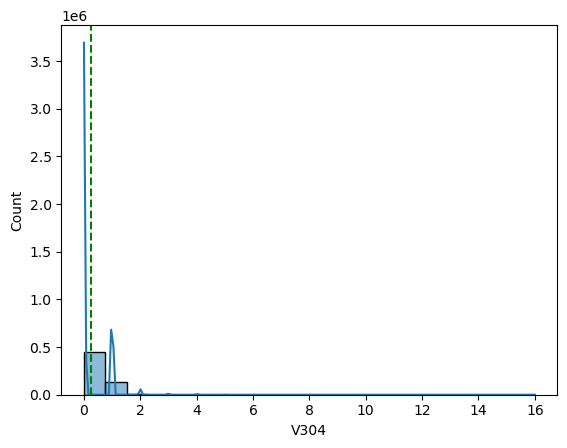

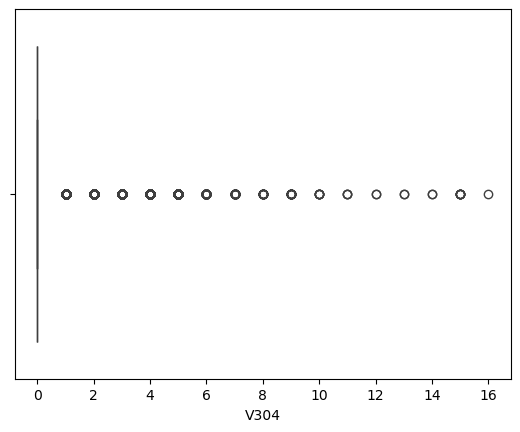


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          0.264208
std           0.528238
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          16.000000
Name: V304, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 181
Kolom :  V305


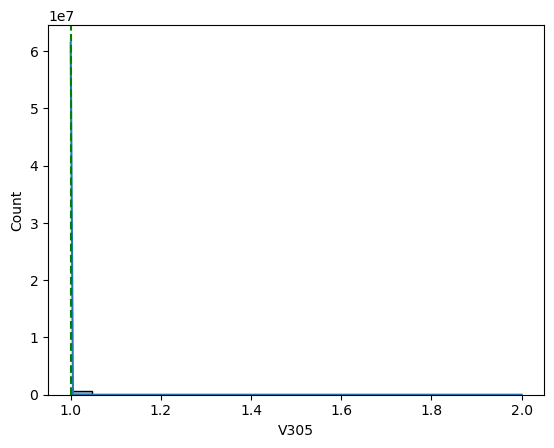

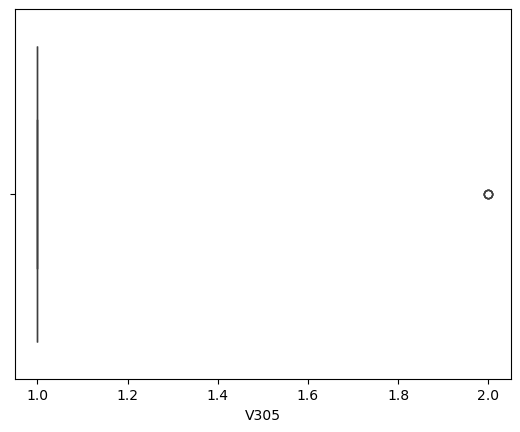


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          1.000007
std           0.002603
min           1.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           2.000000
Name: V305, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 182
Kolom :  V306


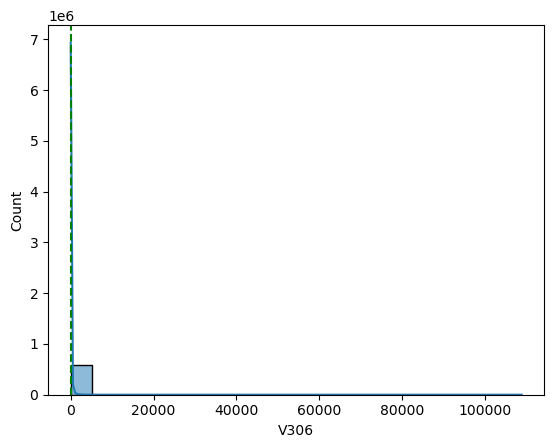

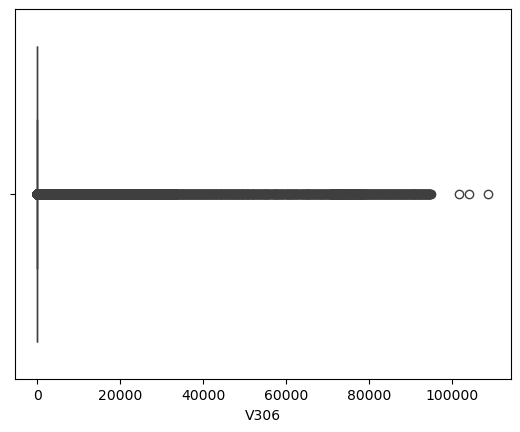


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean        139.748713
std        2348.849634
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max      108800.000000
Name: V306, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 183
Kolom :  V307


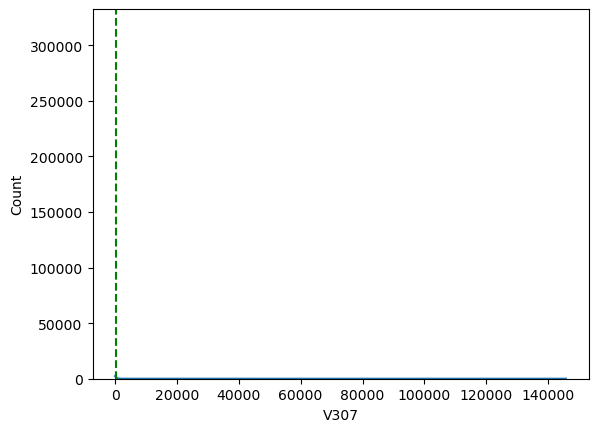

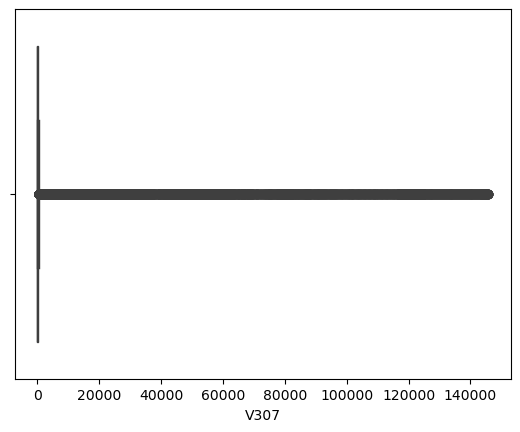


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean        408.682375
std        4391.992977
min           0.000000
25%           0.000000
50%           0.000000
75%         151.380680
max      145765.000000
Name: V307, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 184
Kolom :  V308


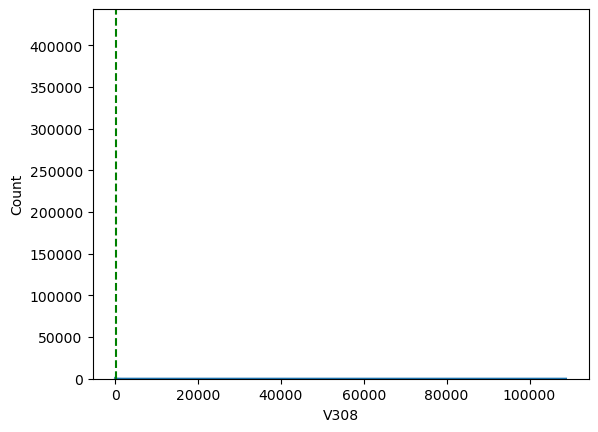

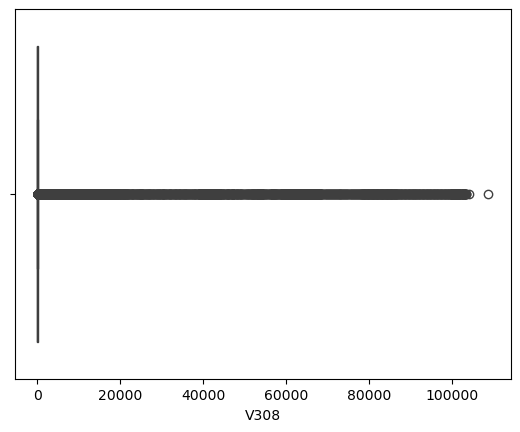


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean        230.413180
std        3021.924247
min           0.000000
25%           0.000000
50%           0.000000
75%          35.970001
max      108800.000000
Name: V308, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 185
Kolom :  V309


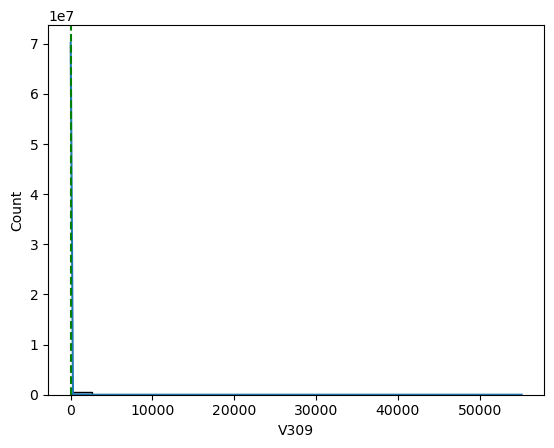

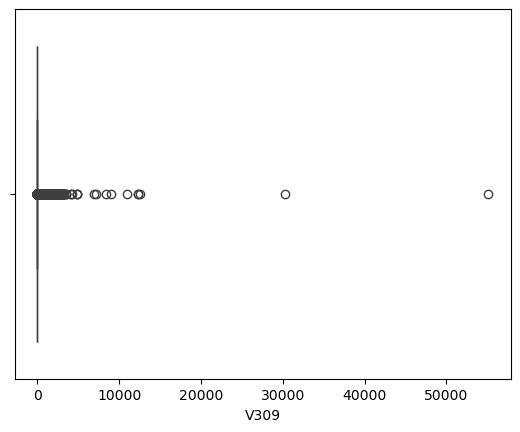


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean         10.995986
std         116.254277
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       55125.000000
Name: V309, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 186
Kolom :  V310


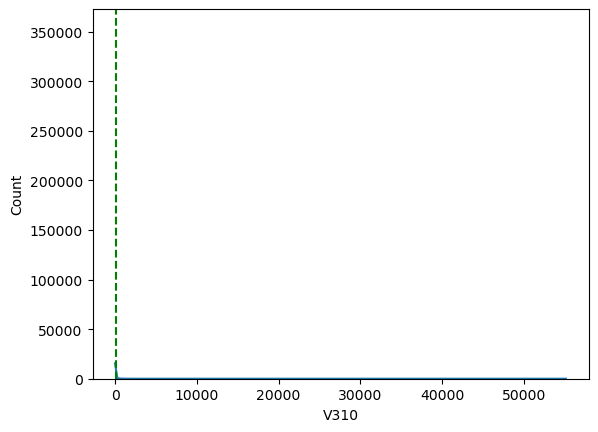

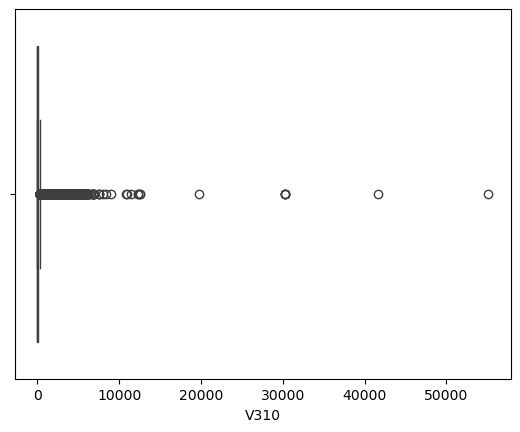


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean        118.195658
std         352.983093
min           0.000000
25%           0.000000
50%           0.000000
75%         107.949997
max       55125.000000
Name: V310, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 187
Kolom :  V311


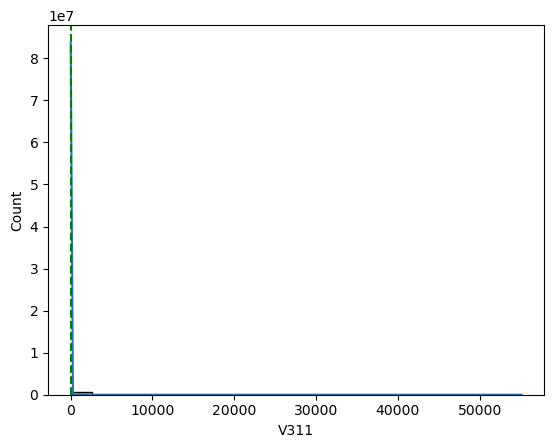

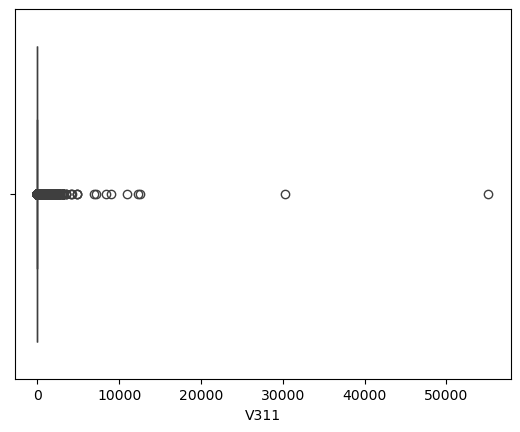


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean          4.202175
std         102.374938
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       55125.000000
Name: V311, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 188
Kolom :  V312


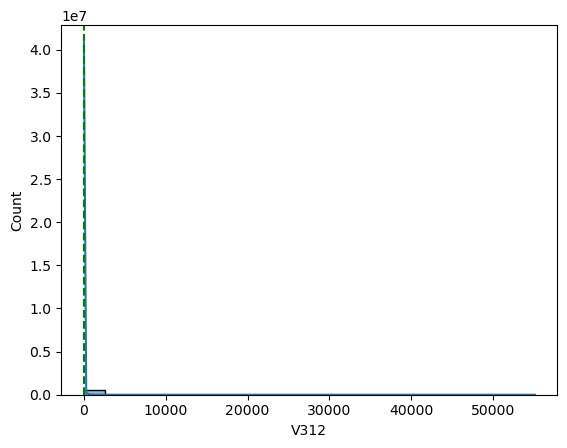

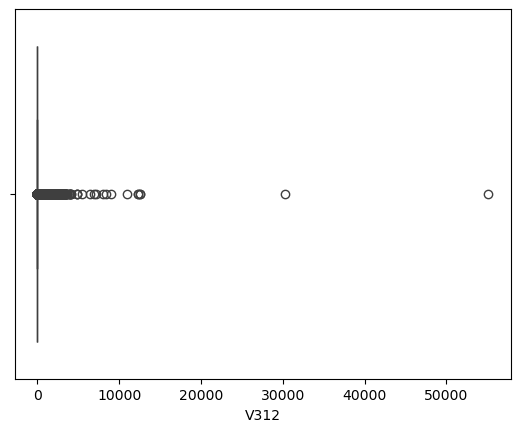


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean         39.173910
std         172.128339
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       55125.000000
Name: V312, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 189
Kolom :  V313


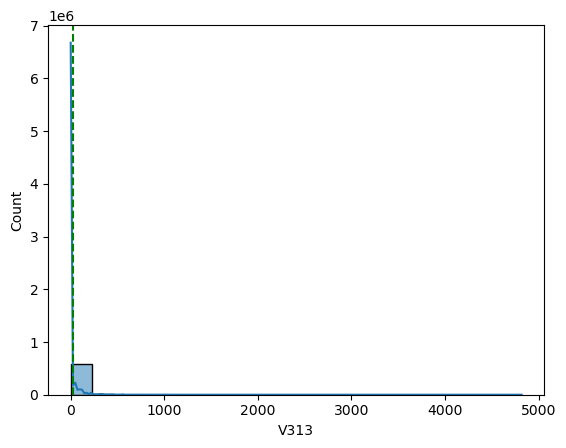

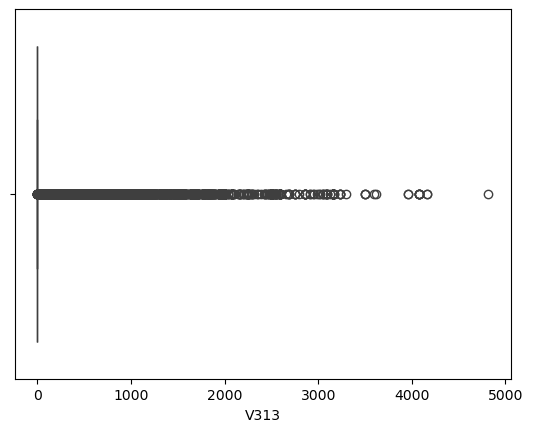


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    589271.000000
mean         21.351473
std          95.902970
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max        4817.470215
Name: V313, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 190
Kolom :  V314


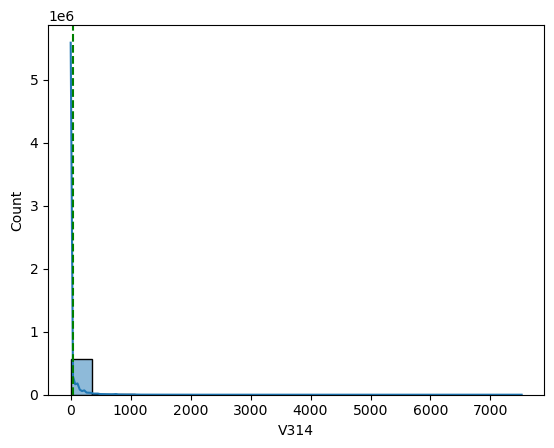

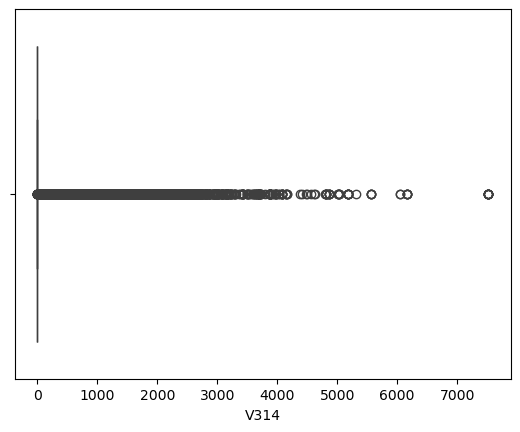


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    589271.000000
mean         43.319174
std         173.619028
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max        7519.870117
Name: V314, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 191
Kolom :  V315


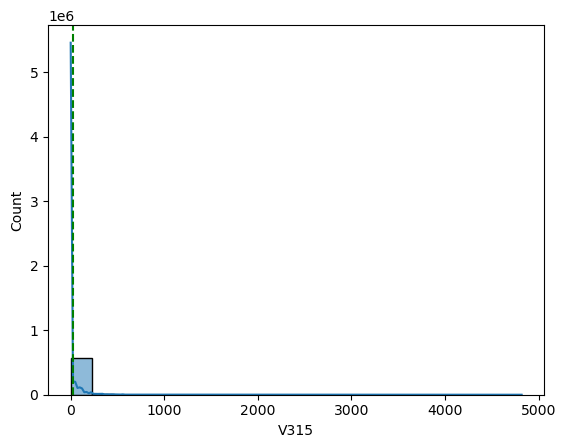

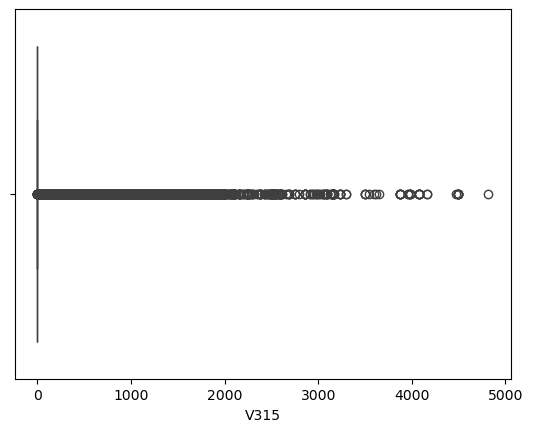


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    589271.000000
mean         26.806977
std         116.853222
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max        4817.470215
Name: V315, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 192
Kolom :  V316


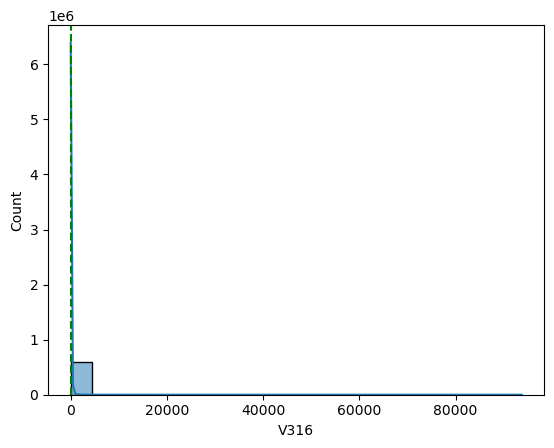

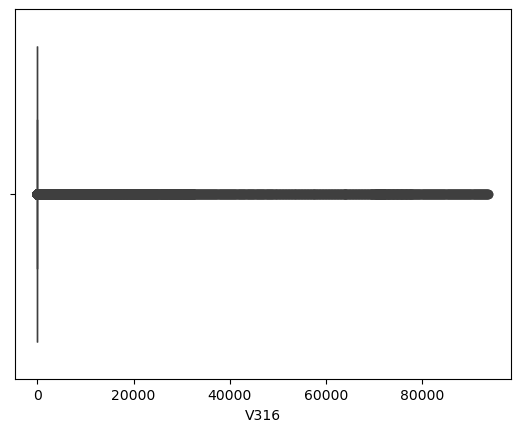


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean        109.818544
std        2270.033202
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       93736.000000
Name: V316, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 193
Kolom :  V317


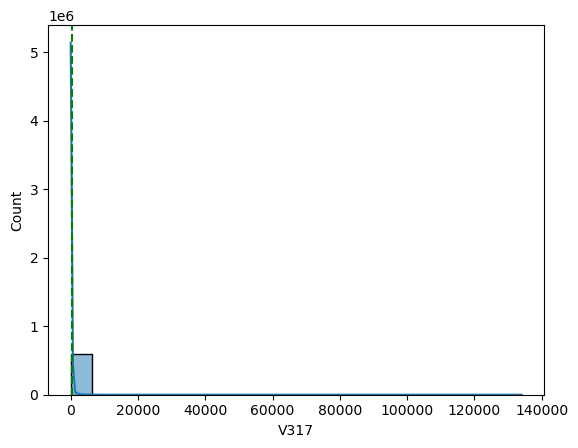

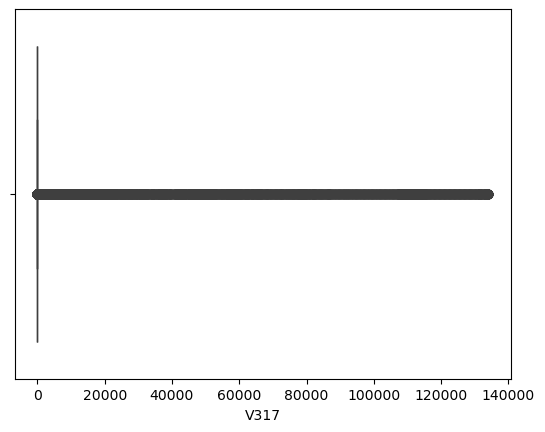


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean        247.606741
std        3980.042828
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max      134021.000000
Name: V317, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 194
Kolom :  V318


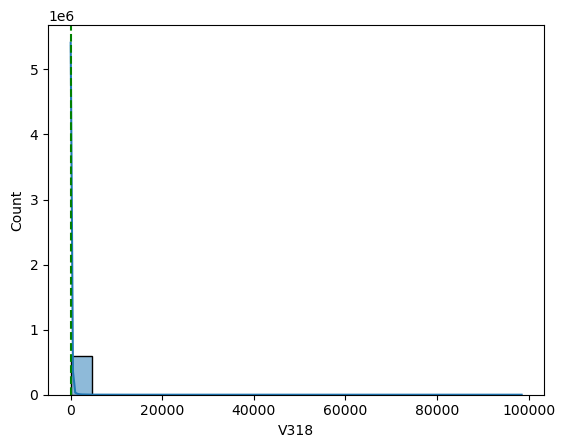

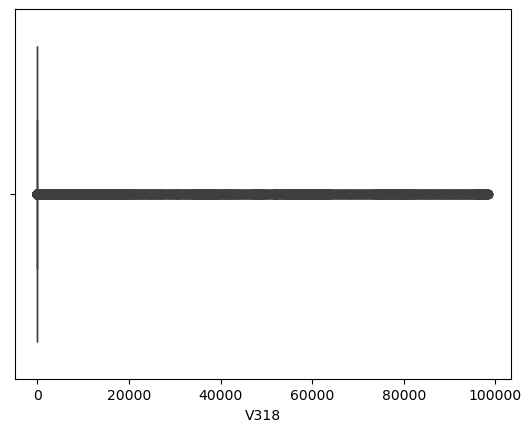


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean        162.153398
std        2793.343636
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       98476.000000
Name: V318, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 195
Kolom :  V319


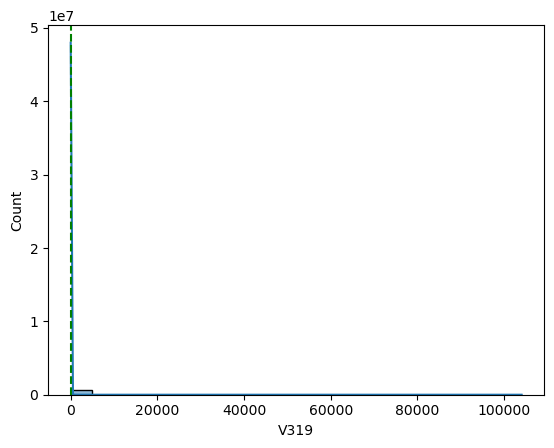

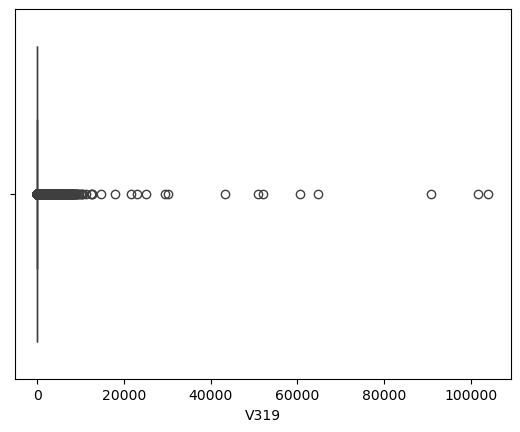


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean         18.372476
std         332.304848
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max      104060.000000
Name: V319, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 196
Kolom :  V320


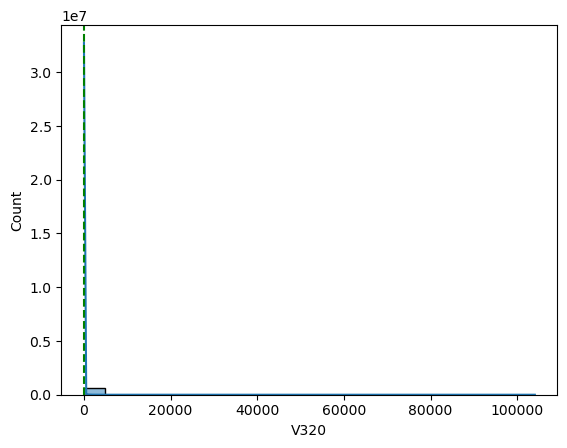

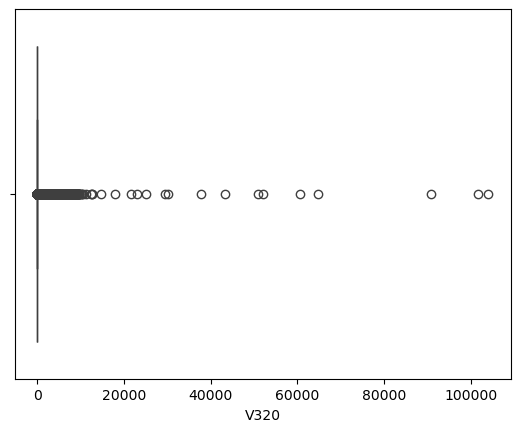


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean         42.073133
std         473.499307
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max      104060.000000
Name: V320, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]


Iterasi ke- 197
Kolom :  V321


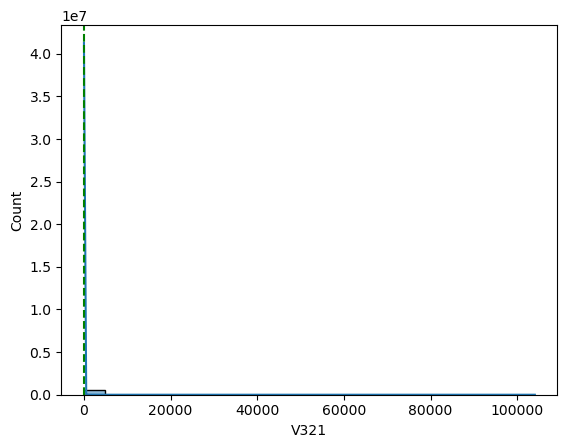

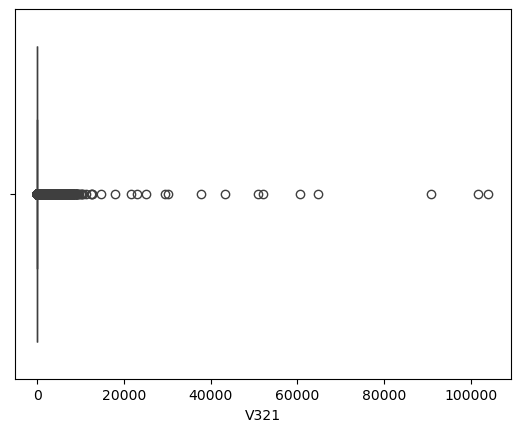


Skew Value :  nan
Skew Test Value :  SkewtestResult(statistic=nan, pvalue=nan)
count    590528.000000
mean         28.326584
std         382.053171
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max      104060.000000
Name: V321, dtype: float64

nilai max di luar outlier = nan
nilai min di luar outlier = nan
jumlah outlier:0
outlier:
[]



In [105]:
# Melakukan EDA Univariat pada setiap kolom numerik dataset

# Membuat list nama kolom numerik
list_kontinu = list(df_num.columns)

# Membuat loop
iter = 1
for i in list_kontinu:
  print()
  print('Iterasi ke-',iter)
  print('Kolom : ',i)
  sns.histplot(df_num[i],kde=True)
  plt.axvline(np.mean(df_num[i]),c='green',linestyle='--')
  plt.axvline(np.percentile(df_num[i],25),c='red',linestyle='--')
  plt.axvline(np.percentile(df_num[i],50),c='red',linestyle='--')
  plt.axvline(np.percentile(df_num[i],75),c='red',linestyle='--')
  plt.show()
  sns.boxplot(data=df_num, x=df_num[i])
  plt.show()

  print()
  print('Skew Value : ',skew(df_num[i]))
  print('Skew Test Value : ',skewtest(df_num[i]))
  print(df_num[i].describe())
  
  print()
  Q1 = np.percentile(df_num[i],25)
  Q2 = np.percentile(df_num[i],50)
  Q3 = np.percentile(df_num[i],75)
  IQR = Q3-Q1

  upper_f = Q3 + 1.5 * IQR
  lower_f = Q1 - 1.5 * IQR

  upper_w = np.max(df_num[df_num[i] <= upper_f][i])
  lower_w = np.min(df_num[df_num[i] >= lower_f][i])
  outlier = list(df_num[(df_num[i] < lower_w) | (df_num[i] > upper_f)][i])

  print('nilai max di luar outlier = {}'.format(upper_w))
  print('nilai min di luar outlier = {}'.format(lower_w))
  print('jumlah outlier:{}'.format(len(outlier)))
  print('outlier:')
  print(outlier)
  iter+=1
  print()

EDA univariat untuk setiap kolom kategorikal dengan countplot untuk tiap kolom dan jumlah kategori unik, daftar kategori unik dan value counts tiap kategori unik<p>


Iterasi ke- 1
Kolom :  ProductCD


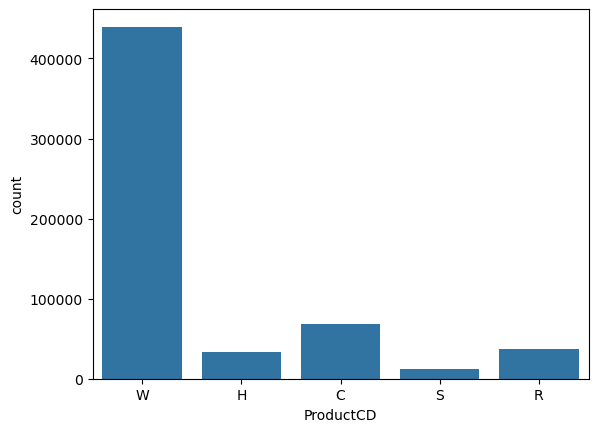

Jumlah kategori unik : 5
Jumlah nilai kategori unik : ['W', 'H', 'C', 'S', 'R']
Jumlah total nilai kategori unik :
ProductCD
W    439670
C     68519
R     37699
H     33024
S     11628
Name: count, dtype: int64


Iterasi ke- 2
Kolom :  card4


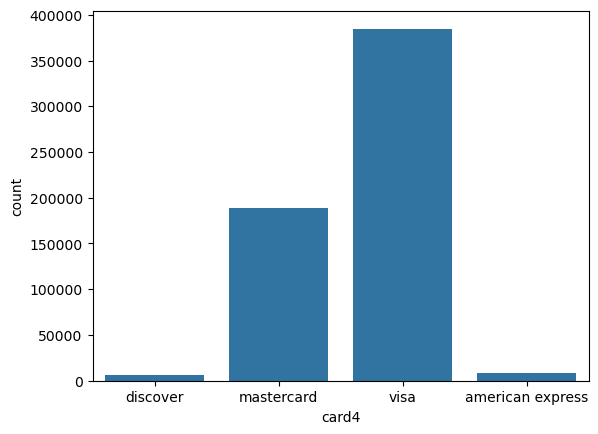

Jumlah kategori unik : 5
Jumlah nilai kategori unik : ['discover', 'mastercard', 'visa', 'american express', nan]
Jumlah total nilai kategori unik :
card4
visa                384767
mastercard          189217
american express      8328
discover              6651
Name: count, dtype: int64


Iterasi ke- 3
Kolom :  card6


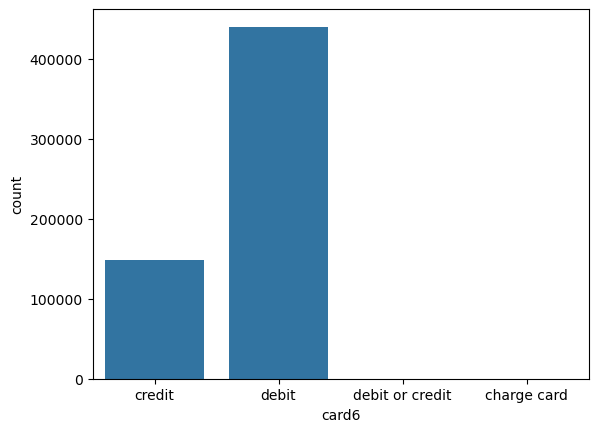

Jumlah kategori unik : 5
Jumlah nilai kategori unik : ['credit', 'debit', nan, 'debit or credit', 'charge card']
Jumlah total nilai kategori unik :
card6
debit              439938
credit             148986
debit or credit        30
charge card            15
Name: count, dtype: int64


Iterasi ke- 4
Kolom :  P_emaildomain


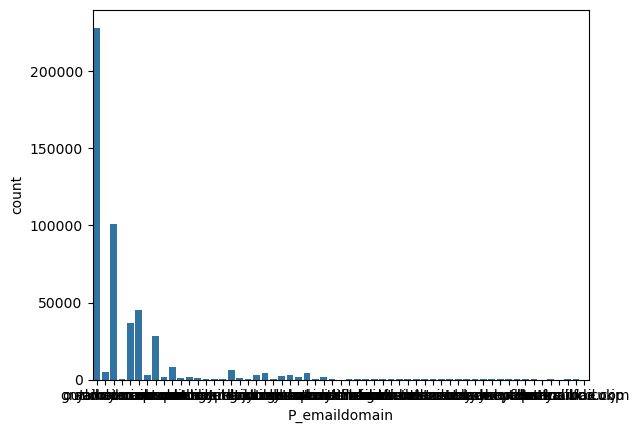

Jumlah kategori unik : 60
Jumlah nilai kategori unik : [nan, 'gmail.com', 'outlook.com', 'yahoo.com', 'mail.com', 'anonymous.com', 'hotmail.com', 'verizon.net', 'aol.com', 'me.com', 'comcast.net', 'optonline.net', 'cox.net', 'charter.net', 'rocketmail.com', 'prodigy.net.mx', 'embarqmail.com', 'icloud.com', 'live.com.mx', 'gmail', 'live.com', 'att.net', 'juno.com', 'ymail.com', 'sbcglobal.net', 'bellsouth.net', 'msn.com', 'q.com', 'yahoo.com.mx', 'centurylink.net', 'servicios-ta.com', 'earthlink.net', 'hotmail.es', 'cfl.rr.com', 'roadrunner.com', 'netzero.net', 'gmx.de', 'suddenlink.net', 'frontiernet.net', 'windstream.net', 'frontier.com', 'outlook.es', 'mac.com', 'netzero.com', 'aim.com', 'web.de', 'twc.com', 'cableone.net', 'yahoo.fr', 'yahoo.de', 'yahoo.es', 'sc.rr.com', 'ptd.net', 'live.fr', 'yahoo.co.uk', 'hotmail.fr', 'hotmail.de', 'hotmail.co.uk', 'protonmail.com', 'yahoo.co.jp']
Jumlah total nilai kategori unik :
P_emaildomain
gmail.com           228355
yahoo.com           1009

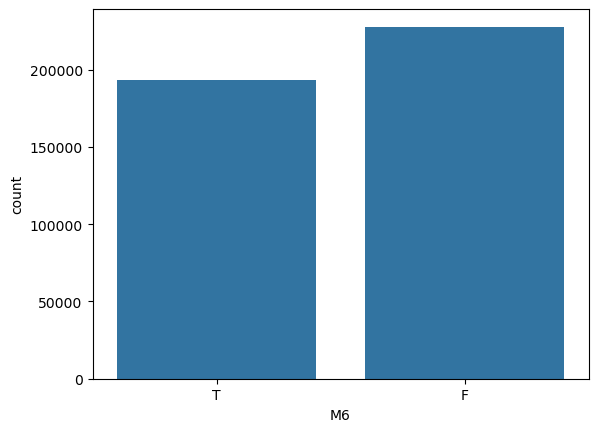

Jumlah kategori unik : 3
Jumlah nilai kategori unik : ['T', 'F', nan]
Jumlah total nilai kategori unik :
M6
F    227856
T    193324
Name: count, dtype: int64



In [106]:
# Melakukan EDA Univariat pada setiap kolom kategorikal dataset

# Membuat list nama kolom kategorikal
list_kategori = list(df_cat.columns)

# Membuat loop
iter = 1
for i in list_kategori:
  print()
  print('Iterasi ke-',iter)
  print('Kolom : ',i)
  sns.countplot(data = df_cat, x = i)
  plt.show()
    
  print('Jumlah kategori unik :', len(df_cat[i].unique()))
  print('Jumlah nilai kategori unik :', list(df_cat[i].unique()))
  print('Jumlah total nilai kategori unik :')
  print(df_cat[i].value_counts())
  iter+=1
  print()

EDA multivariat untuk tiap pasangan kolom numerik-numerik dengan lmplot antar kolom numerik dengan kolom 'label' sebagai hue

In [114]:
# Membuat list pasangan nama kolom numerikal
col1 = list(df_num.columns)
# col2 = list(df_num['isFraud'])

col1.remove('isFraud')

list_pasangan = []
for i in col1:
    list_temp = sorted([i,'isFraud'])
    if list_temp not in list_pasangan :
        list_pasangan.append(list_temp)

len(list_pasangan)

196

iterasi ke- 1
Hubungan label dengan kolom ProductCD


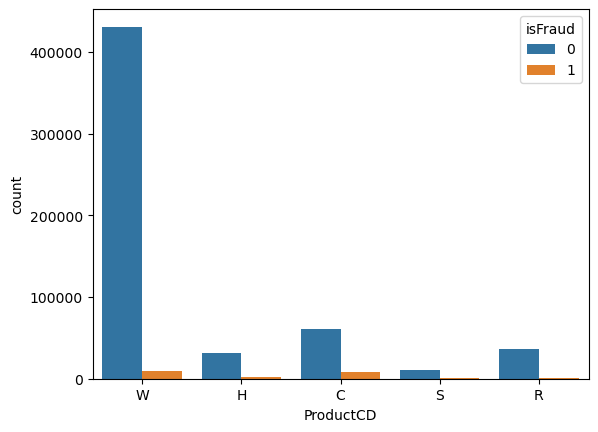

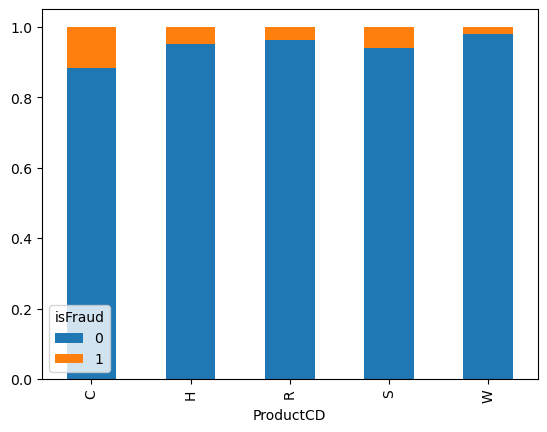


iterasi ke- 2
Hubungan label dengan kolom card4


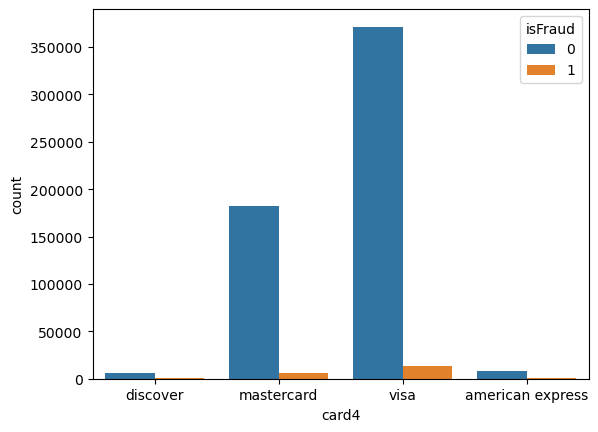

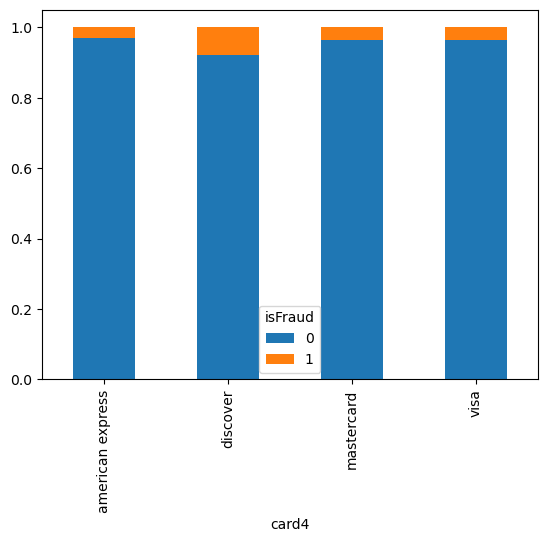


iterasi ke- 3
Hubungan label dengan kolom card6


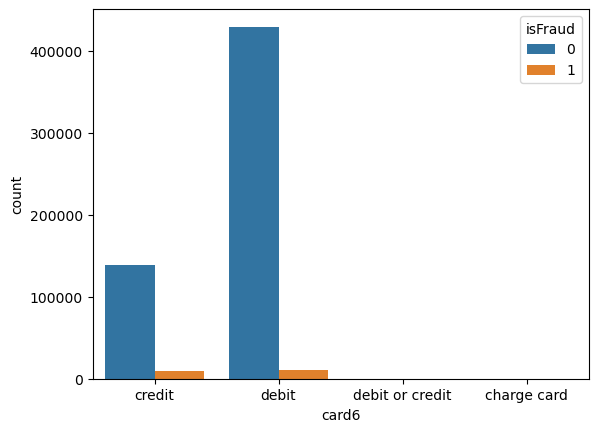

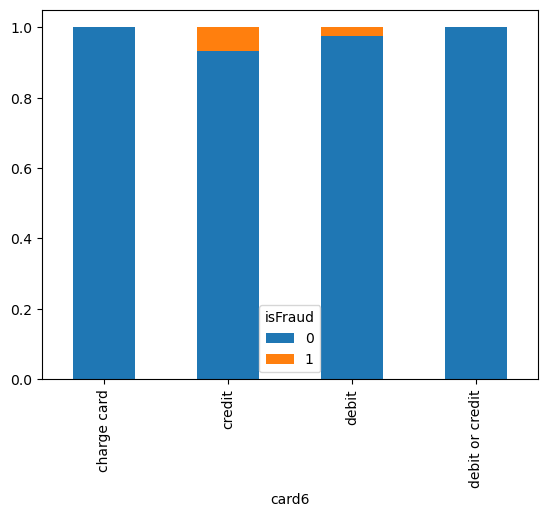


iterasi ke- 4
Hubungan label dengan kolom P_emaildomain


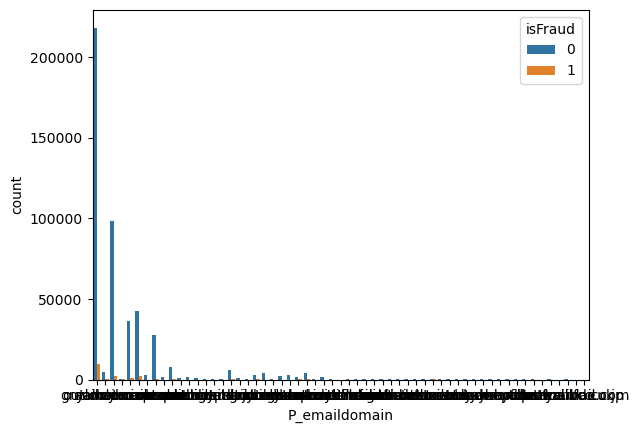

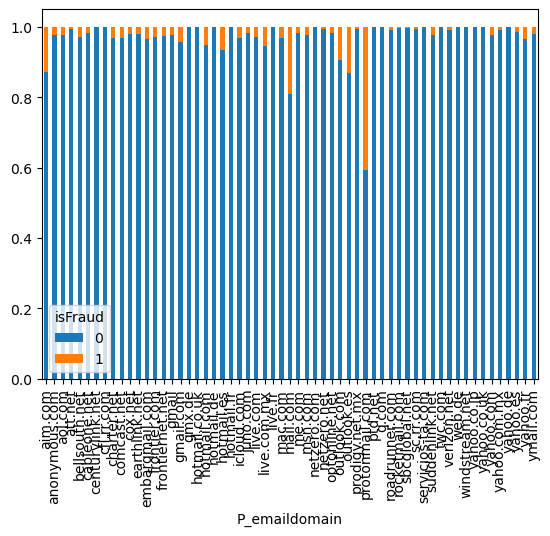


iterasi ke- 5
Hubungan label dengan kolom M6


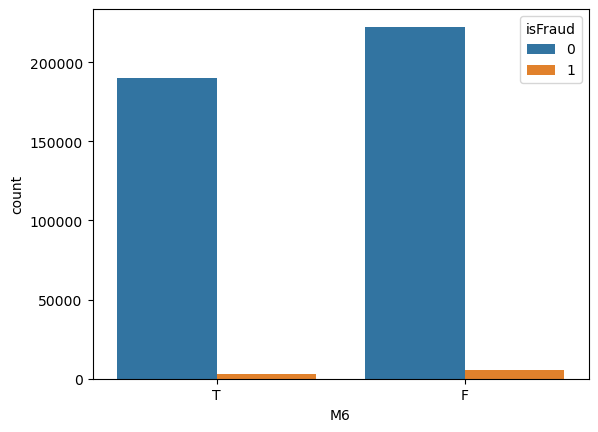

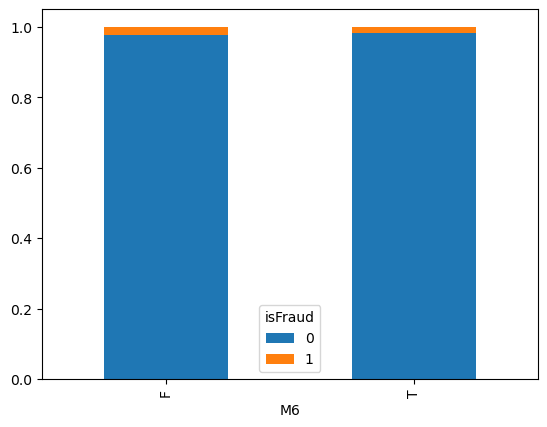

In [117]:
# Melakukan EDA Multivariat pada setiap pasangan kolom kategorikal dengan kolom label dataset 

# Membuat list nama kolom kategorikal
list_kategorikal = list(df_cat.columns)

iter = 1
# Membuat loop
for i in list_kategorikal:
  print('iterasi ke-',iter)
  print('Hubungan label dengan kolom',i)
  sns.countplot(data=df_cat, x=i, hue=df_train['isFraud'])
  plt.show()
  pd.crosstab(df_cat[i], df_train['isFraud'], normalize='index').plot(kind='bar', stacked=True)
  plt.show()
  iter+=1
  print()


iterasi ke- 1
Hubungan label dengan kolom TransactionID_1


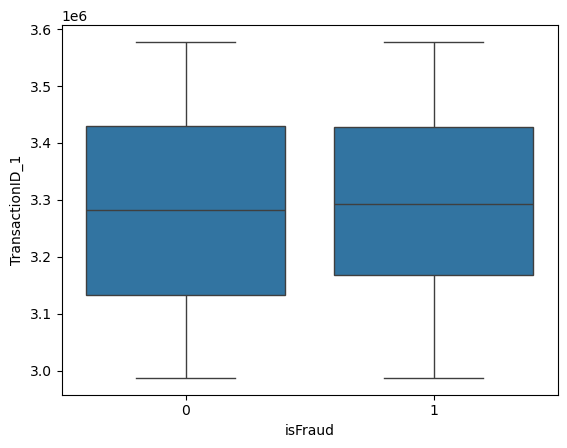

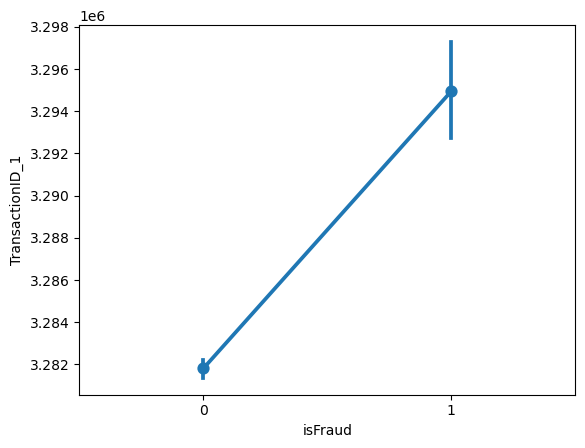

Nilai t-test : 10.886988710700278
Nilai pvalue t-test : 1.3377066820712757e-27
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 2
Hubungan label dengan kolom TransactionDT


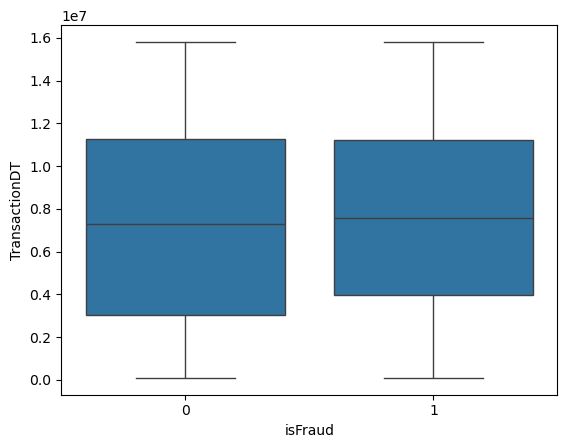

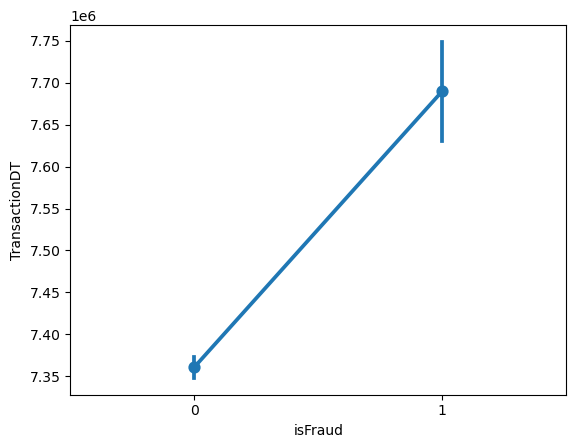

Nilai t-test : 10.07009977077525
Nilai pvalue t-test : 7.523524454605488e-24
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 3
Hubungan label dengan kolom TransactionAmt


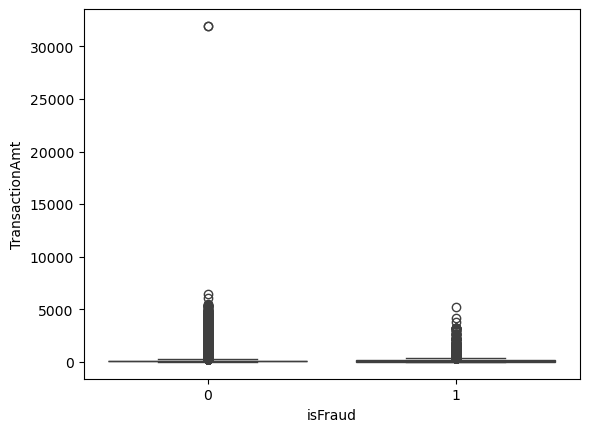

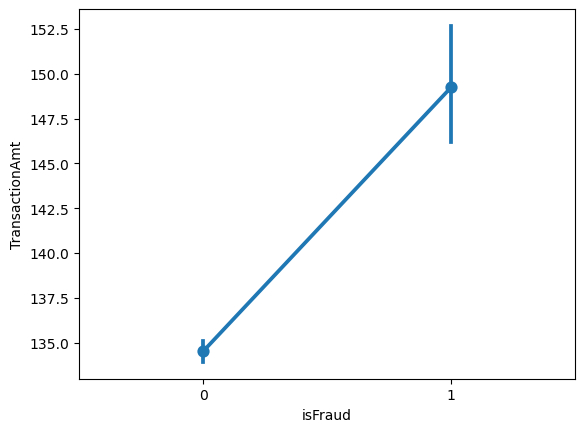

Nilai t-test : 8.699443598937854
Nilai pvalue t-test : 3.343462460228642e-18
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 4
Hubungan label dengan kolom card1


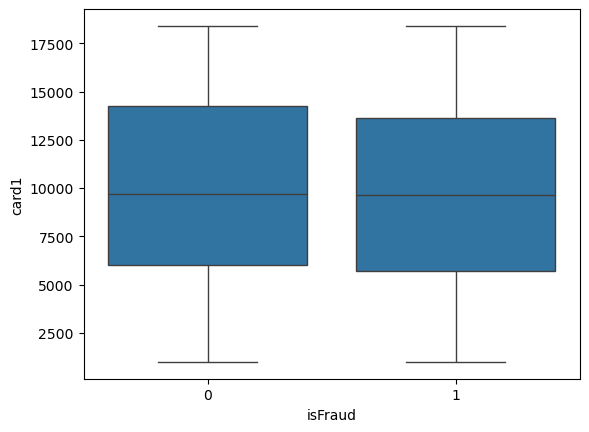

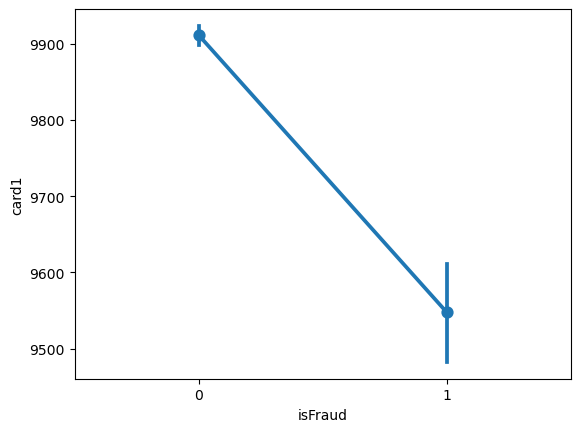

Nilai t-test : -10.482810601982456
Nilai pvalue t-test : 1.0415838209253097e-25
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 5
Hubungan label dengan kolom card2


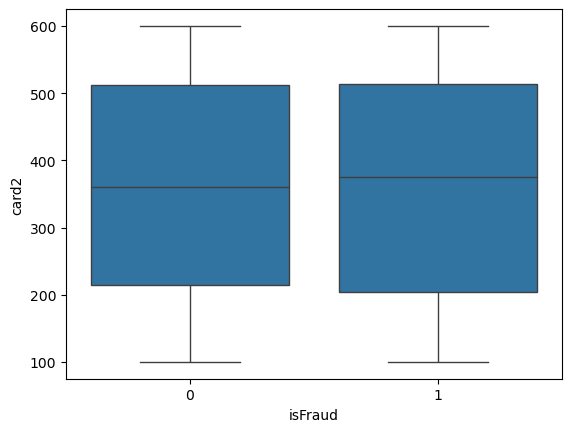

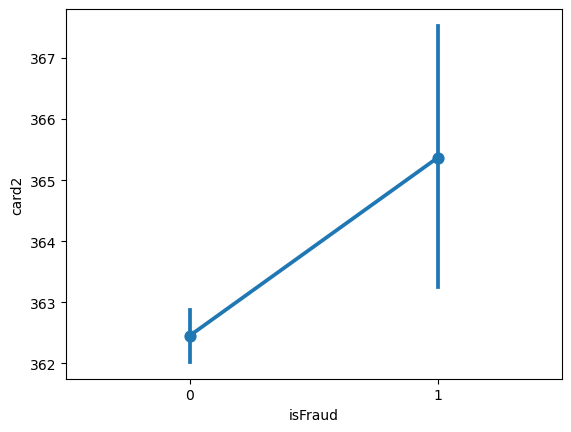

Nilai t-test : 2.583714198400588
Nilai pvalue t-test : 0.009774516814967842
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 6
Hubungan label dengan kolom card3


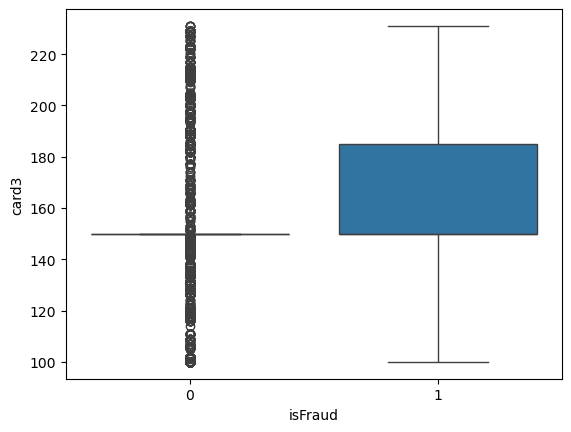

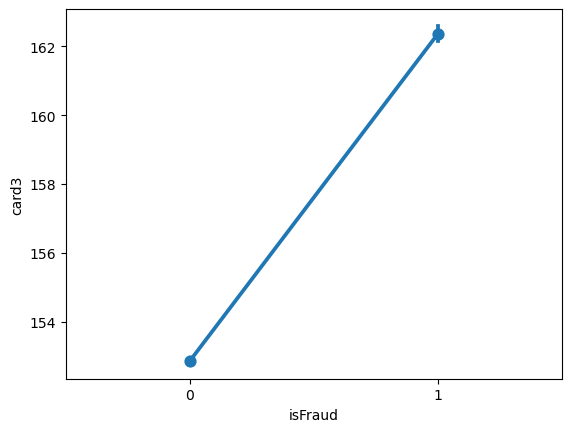

Nilai t-test : 119.7339374473693
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 7
Hubungan label dengan kolom card5


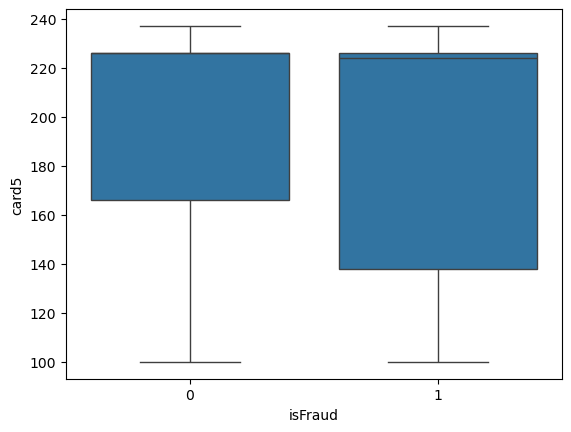

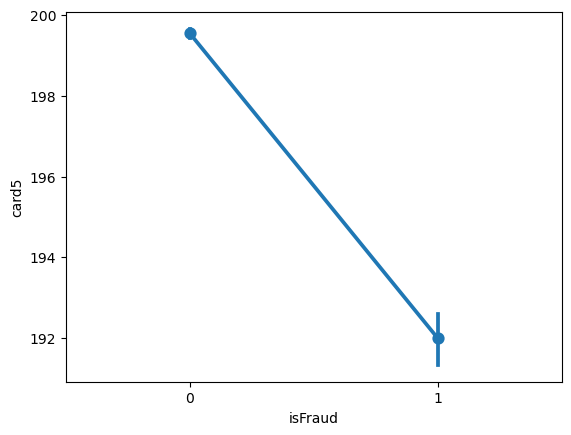

Nilai t-test : -25.725990604845595
Nilai pvalue t-test : 7.2176497355823295e-146
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 8
Hubungan label dengan kolom addr1


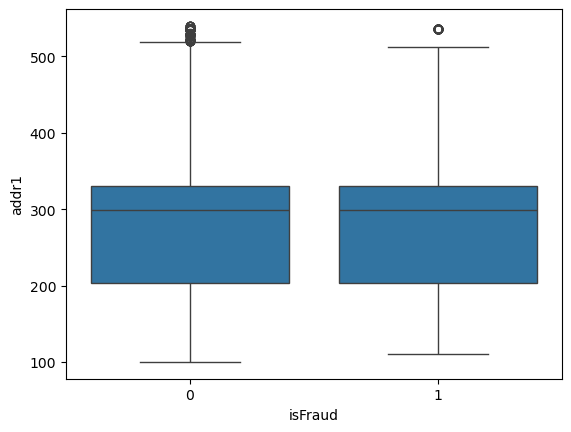

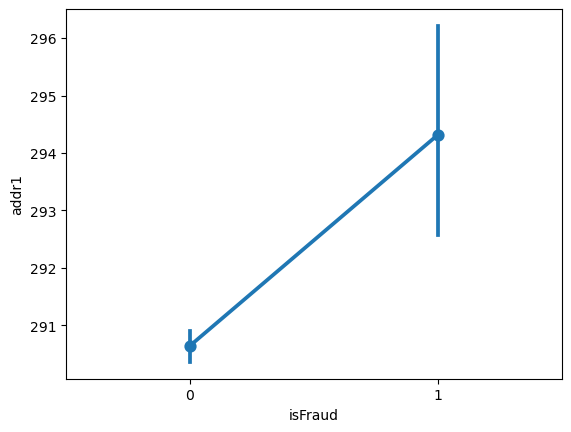

Nilai t-test : 4.05393001070839
Nilai pvalue t-test : 5.037154292527585e-05
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 9
Hubungan label dengan kolom addr2


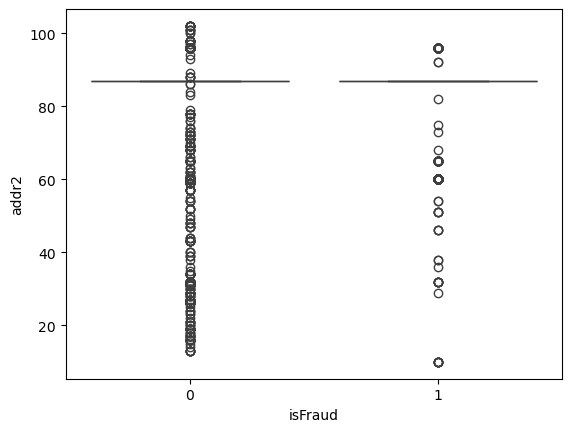

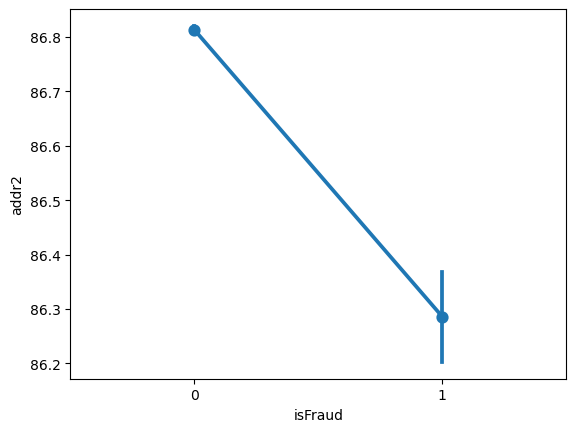

Nilai t-test : -22.024227604755737
Nilai pvalue t-test : 1.8885127383518523e-107
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 10
Hubungan label dengan kolom C1


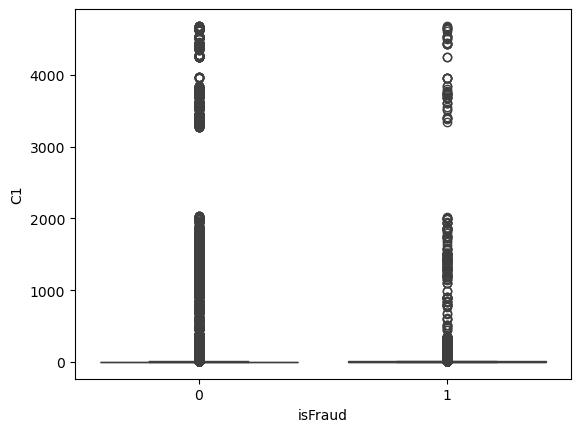

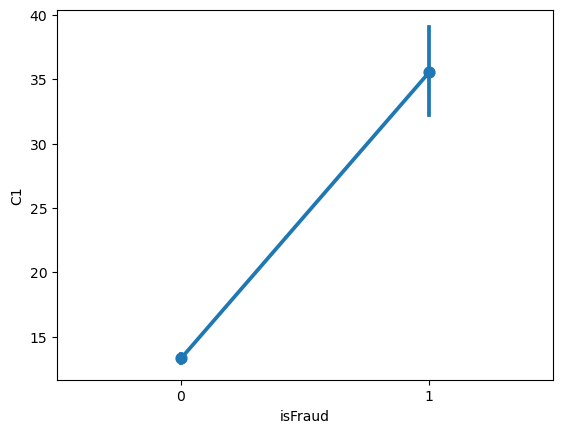

Nilai t-test : 23.50276563002018
Nilai pvalue t-test : 4.3502442601662877e-122
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 11
Hubungan label dengan kolom C2


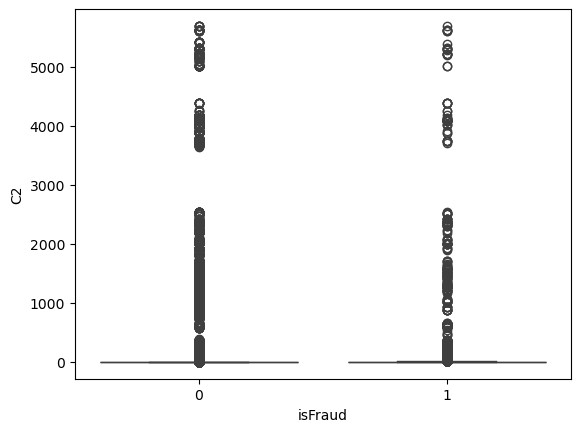

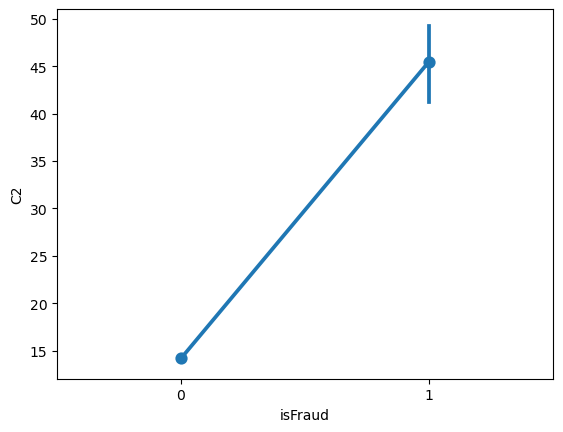

Nilai t-test : 28.628972636080007
Nilai pvalue t-test : 3.894921199743122e-180
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 12
Hubungan label dengan kolom C3


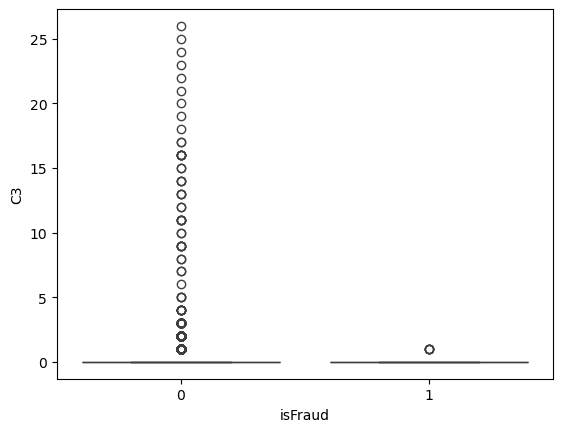

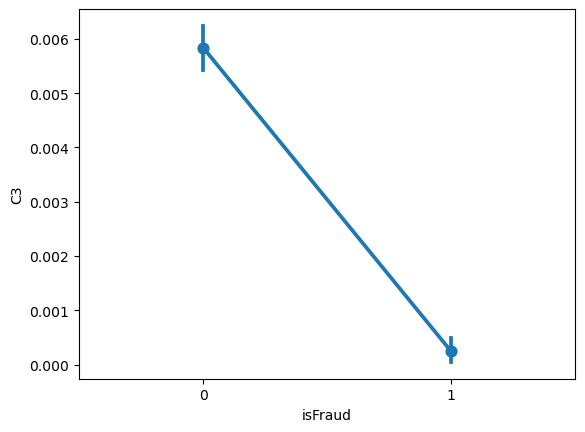

Nilai t-test : -5.251175492396247
Nilai pvalue t-test : 1.5118373751441077e-07
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 13
Hubungan label dengan kolom C4


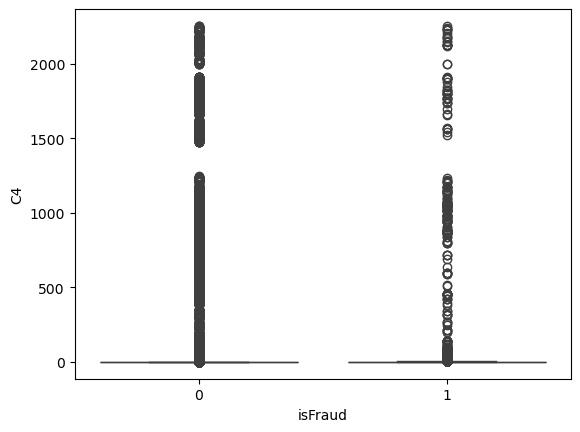

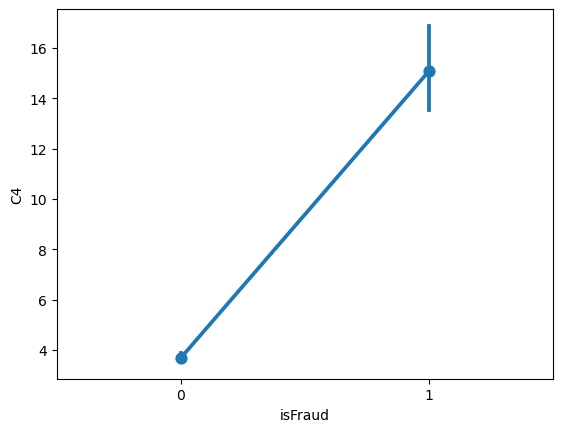

Nilai t-test : 23.358382606246767
Nilai pvalue t-test : 1.2853500300922749e-120
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 14
Hubungan label dengan kolom C5


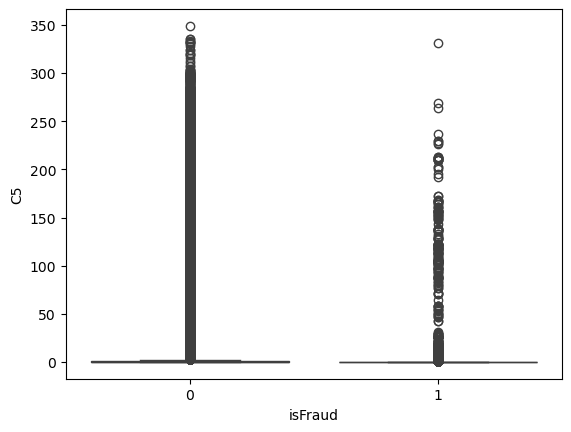

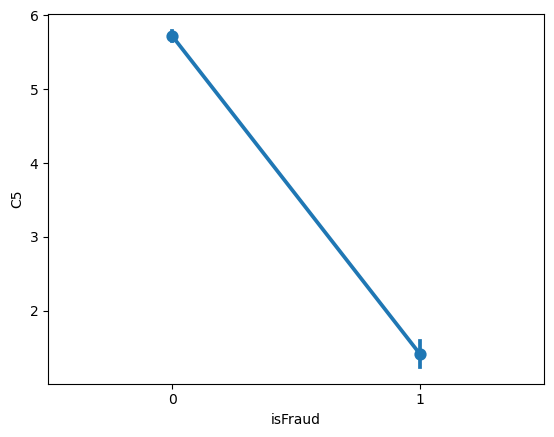

Nilai t-test : -23.64452211737062
Nilai pvalue t-test : 1.5345783006907284e-123
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 15
Hubungan label dengan kolom C6


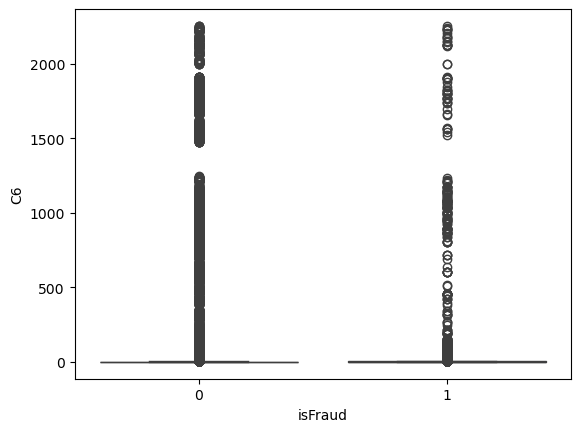

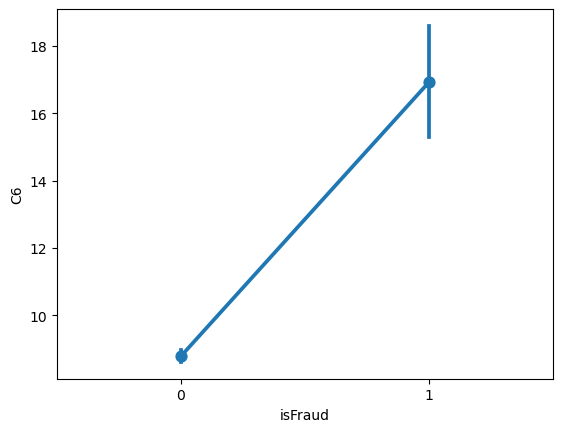

Nilai t-test : 16.07132930086621
Nilai pvalue t-test : 4.169982226866964e-58
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 16
Hubungan label dengan kolom C7


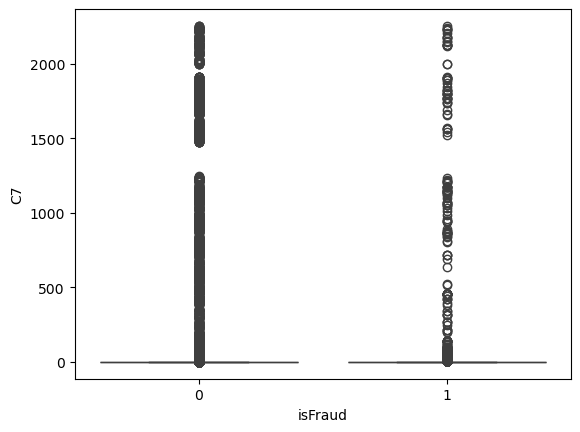

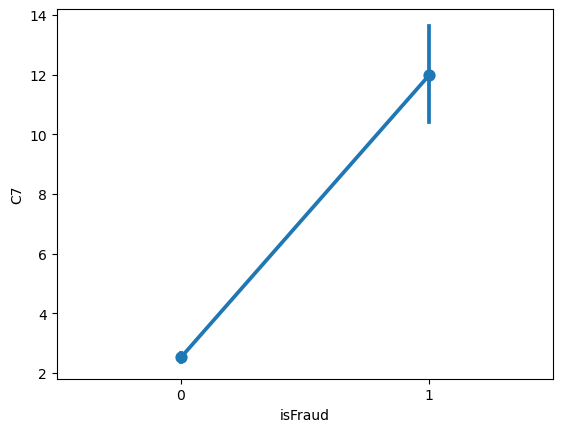

Nilai t-test : 21.648775620334973
Nilai pvalue t-test : 6.85226207898197e-104
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 17
Hubungan label dengan kolom C8


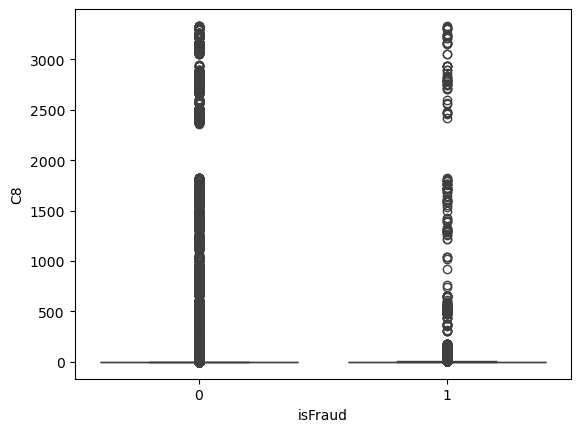

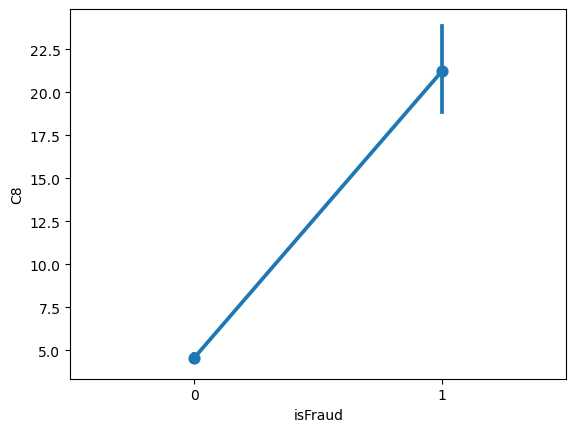

Nilai t-test : 24.710231524686158
Nilai pvalue t-test : 9.726147585560328e-135
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 18
Hubungan label dengan kolom C9


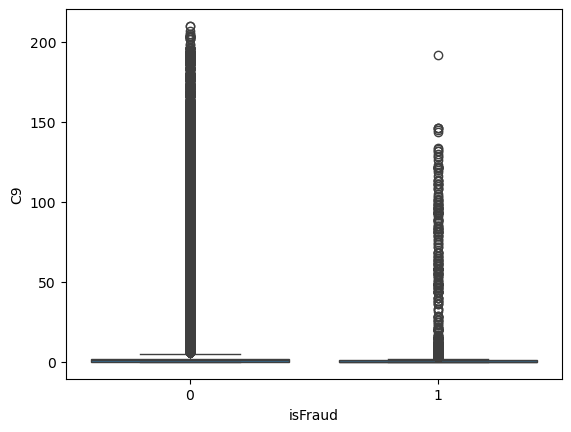

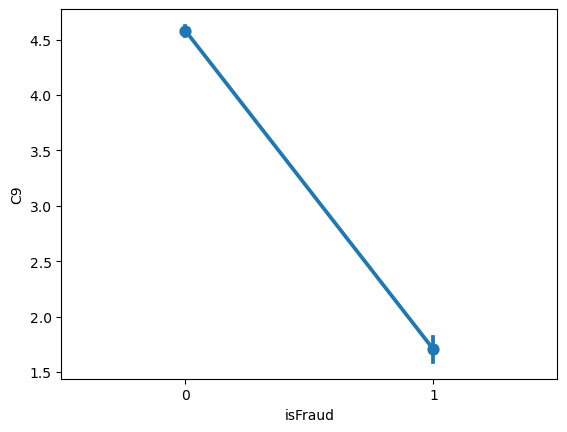

Nilai t-test : -24.375208982263093
Nilai pvalue t-test : 3.640260989497105e-131
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 19
Hubungan label dengan kolom C10


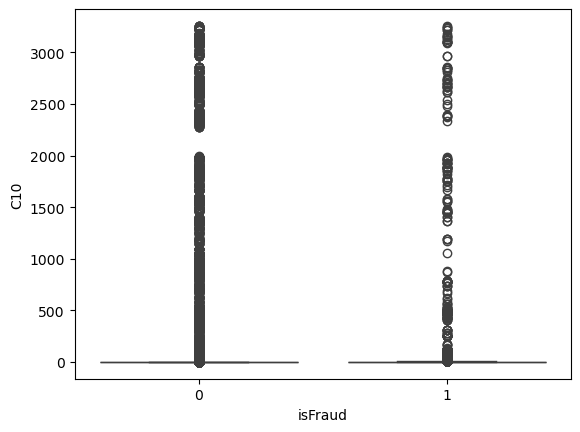

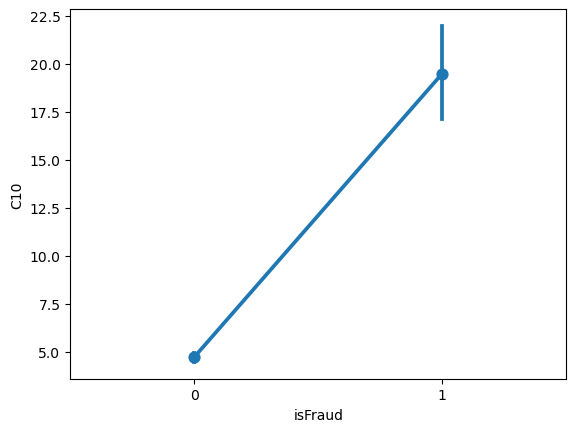

Nilai t-test : 21.830117008831827
Nilai pvalue t-test : 1.3228057002698351e-105
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 20
Hubungan label dengan kolom C11


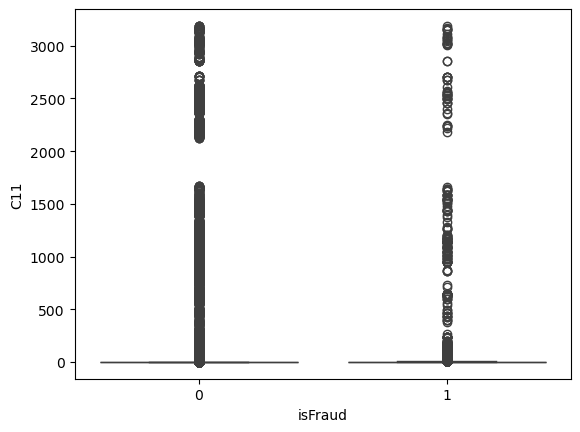

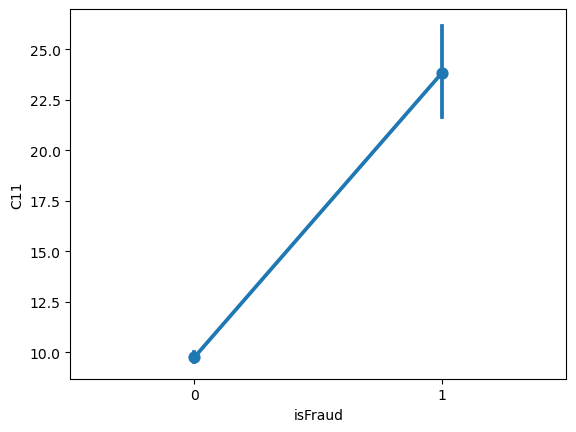

Nilai t-test : 21.12826113354203
Nilai pvalue t-test : 4.760160157498903e-99
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 21
Hubungan label dengan kolom C12


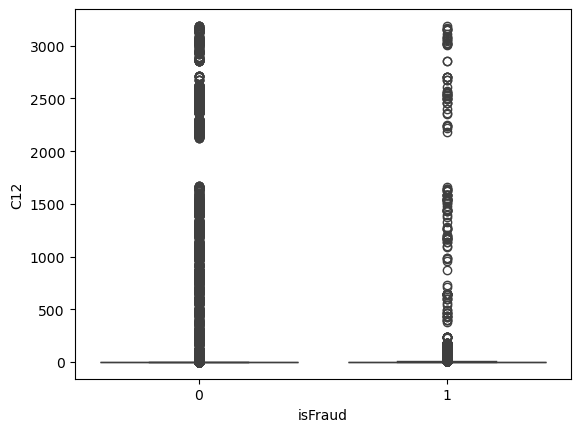

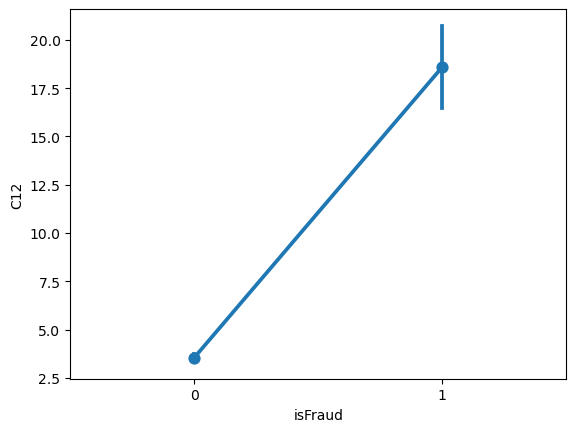

Nilai t-test : 24.530571429195334
Nilai pvalue t-test : 8.130980351017202e-133
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 22
Hubungan label dengan kolom C13


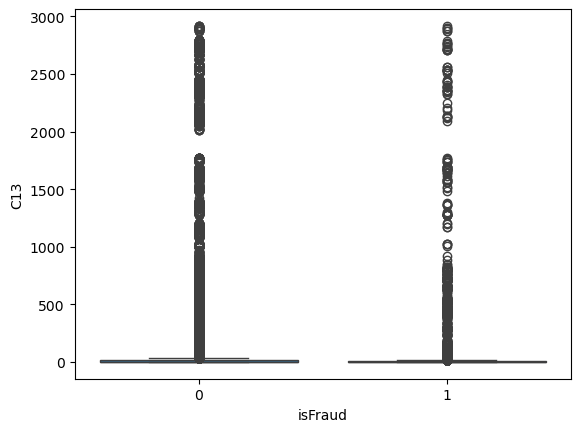

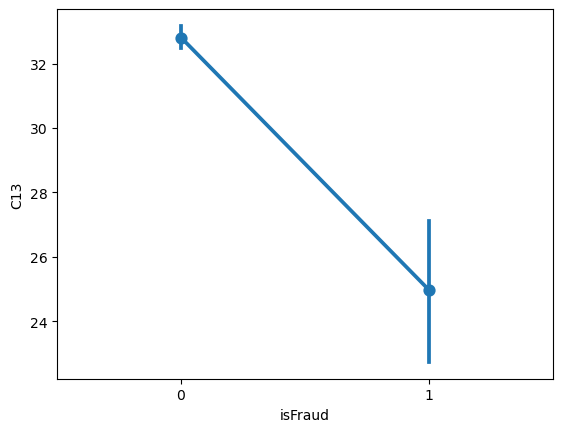

Nilai t-test : -8.565649240544476
Nilai pvalue t-test : 1.0772039397845054e-17
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 23
Hubungan label dengan kolom C14


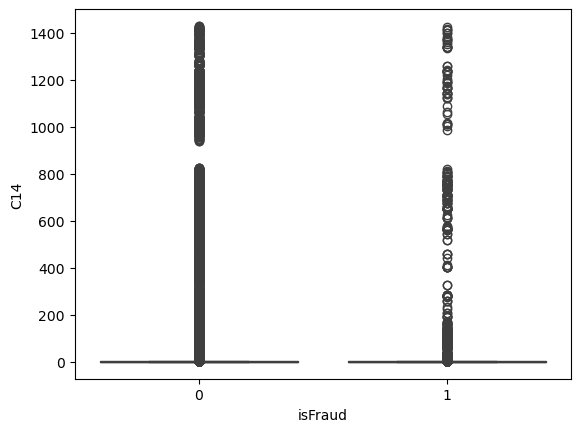

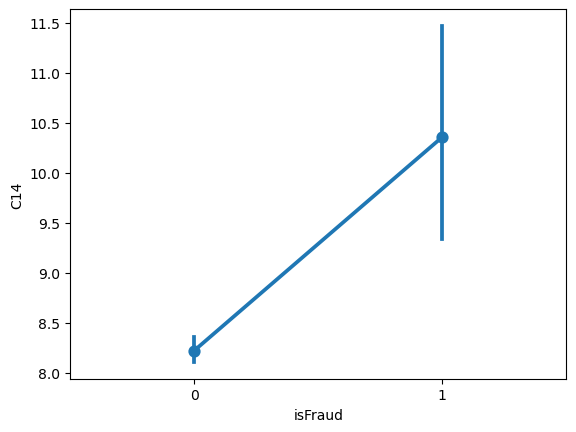

Nilai t-test : 6.086860716383981
Nilai pvalue t-test : 1.1521656197786482e-09
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 24
Hubungan label dengan kolom D1


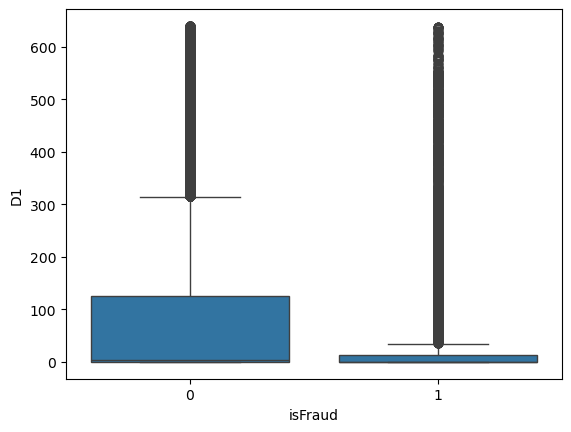

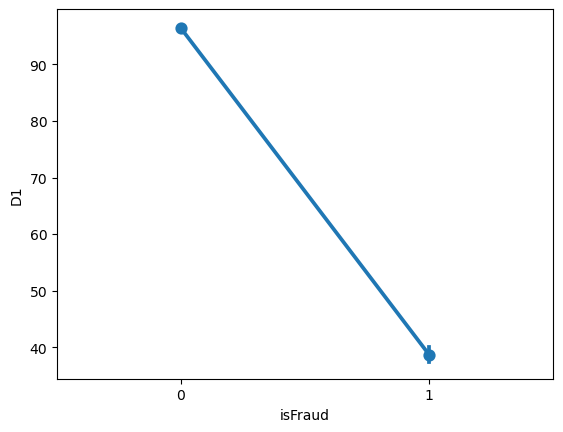

Nilai t-test : -51.69682007973107
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 25
Hubungan label dengan kolom D4


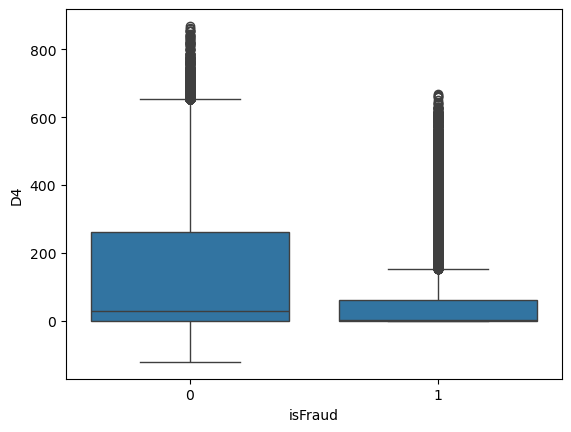

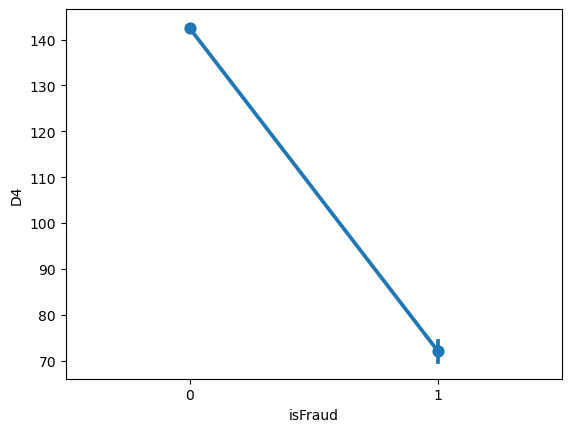

Nilai t-test : -43.743795432168135
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 26
Hubungan label dengan kolom D10


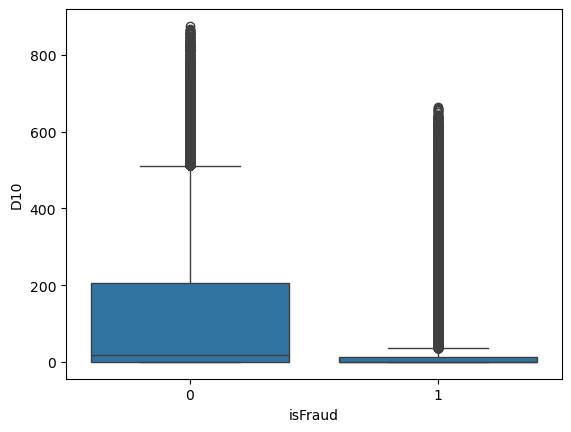

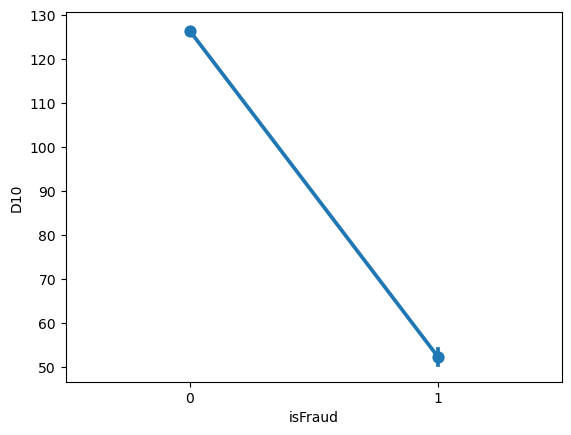

Nilai t-test : -51.781202336311125
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 27
Hubungan label dengan kolom D15


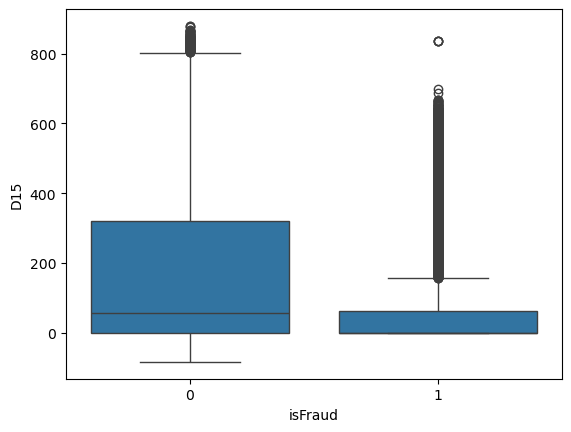

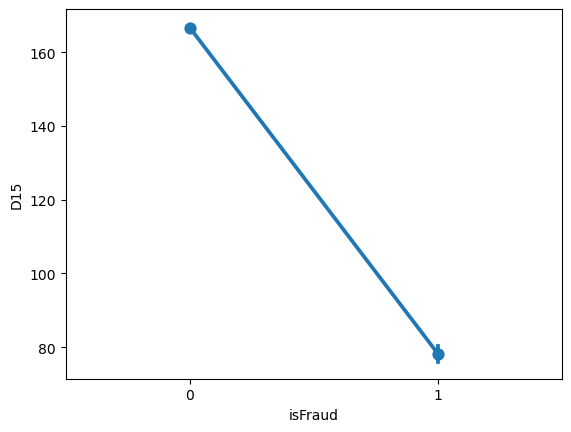

Nilai t-test : -55.05822777831429
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 28
Hubungan label dengan kolom V12


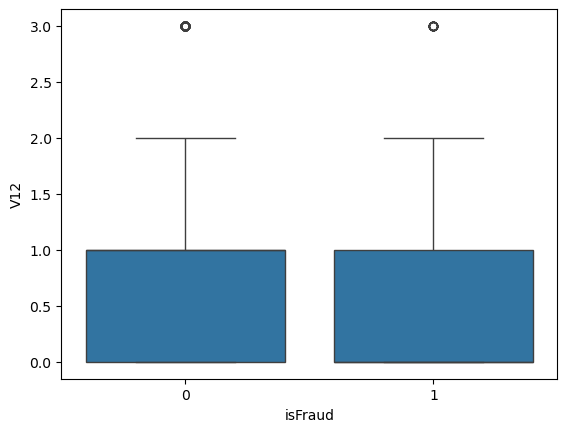

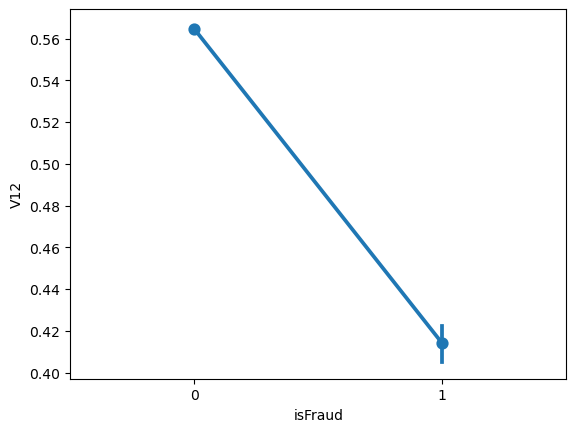

Nilai t-test : -37.640570489522155
Nilai pvalue t-test : 1.237370056888226e-309
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 29
Hubungan label dengan kolom V13


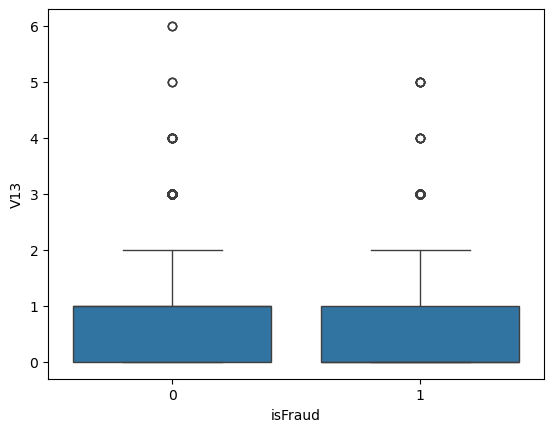

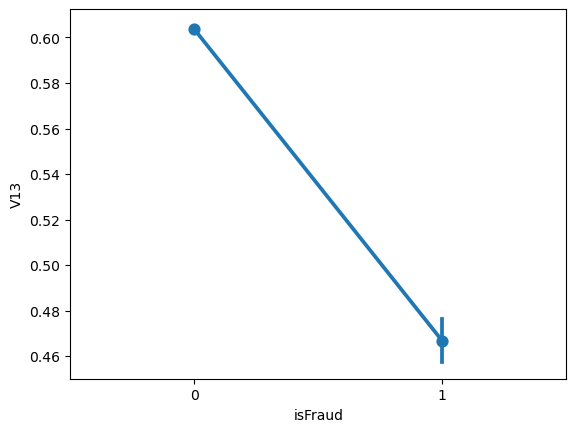

Nilai t-test : -32.81767537071248
Nilai pvalue t-test : 5.791585093971035e-236
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 30
Hubungan label dengan kolom V14


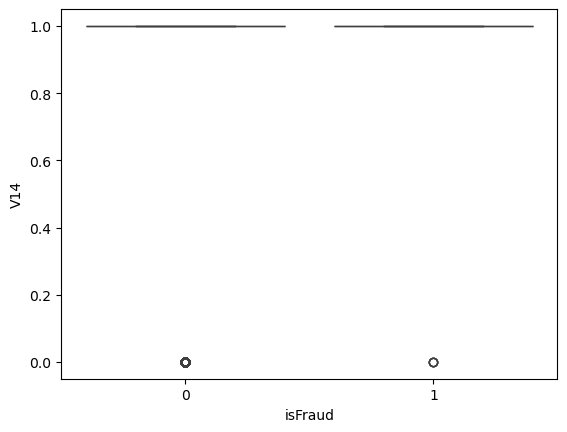

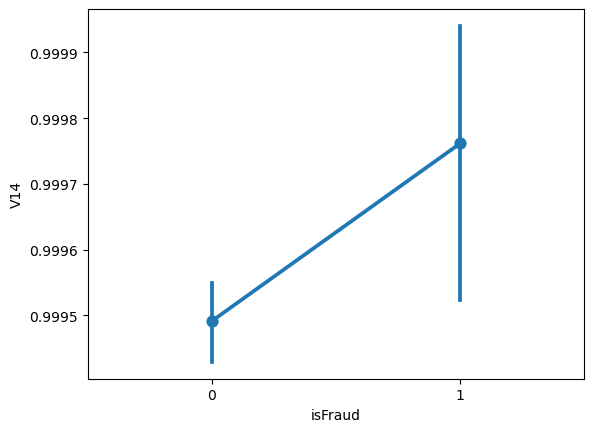

Nilai t-test : 1.5388202394845591
Nilai pvalue t-test : 0.12384880237245618
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 31
Hubungan label dengan kolom V15


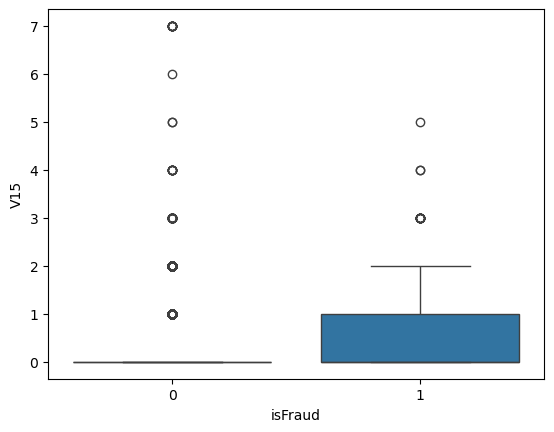

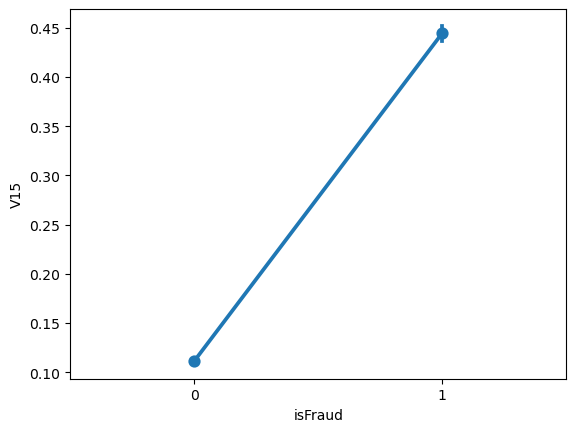

Nilai t-test : 129.71680803558547
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 32
Hubungan label dengan kolom V16


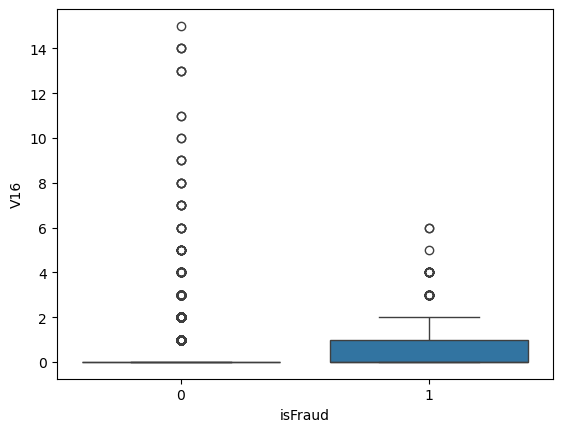

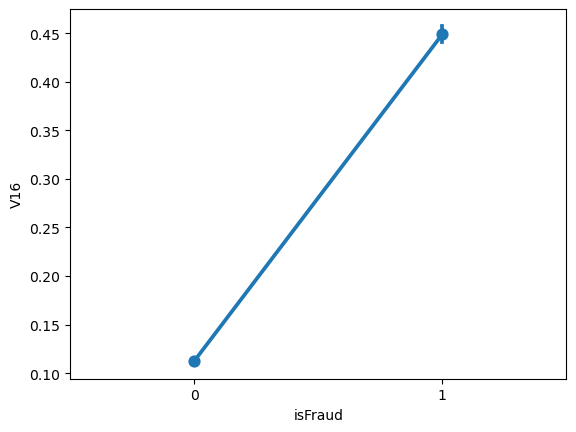

Nilai t-test : 126.97595155813192
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 33
Hubungan label dengan kolom V17


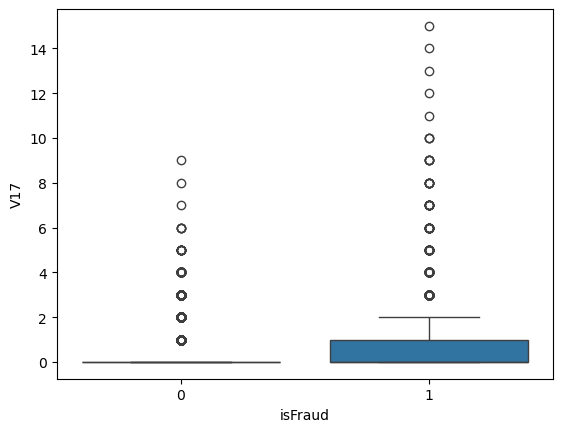

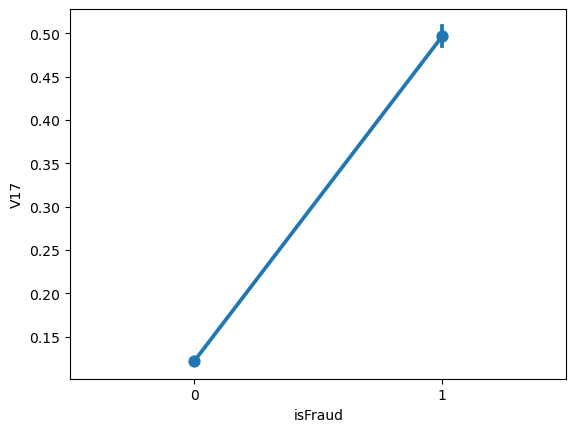

Nilai t-test : 133.2665289341924
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 34
Hubungan label dengan kolom V18


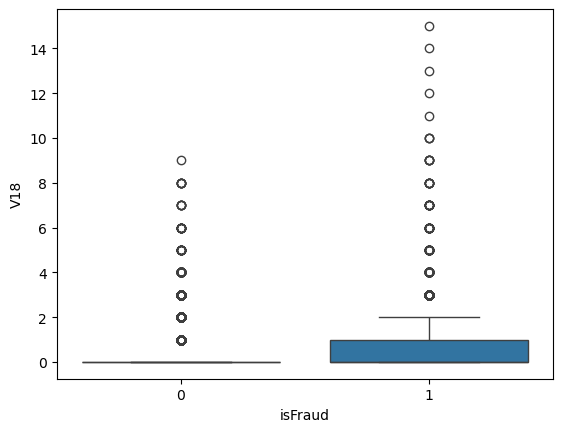

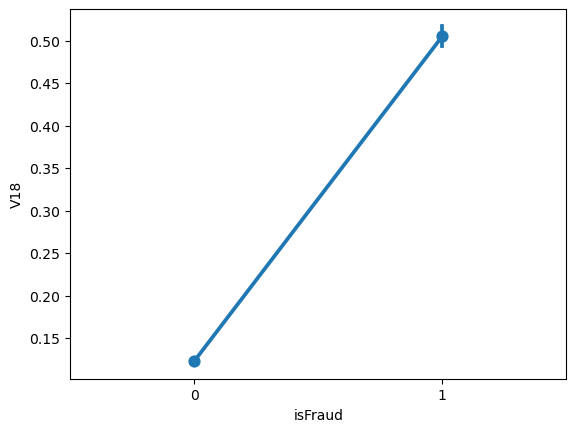

Nilai t-test : 133.17390927367097
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 35
Hubungan label dengan kolom V19


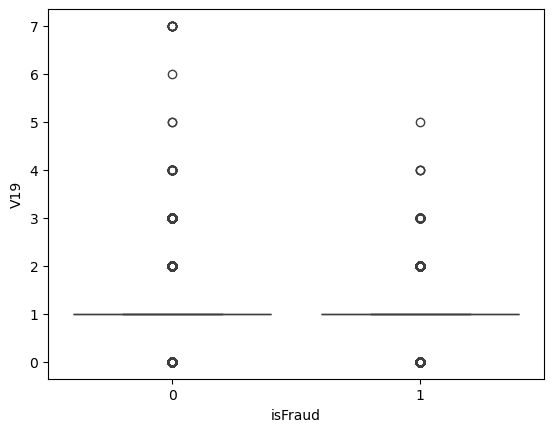

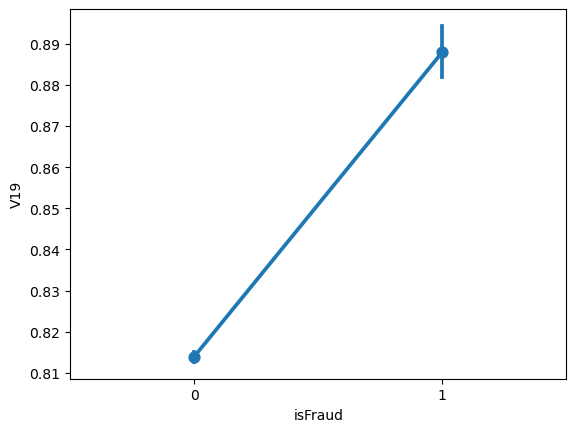

Nilai t-test : 22.17659272480501
Nilai pvalue t-test : 6.5027637878566e-109
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 36
Hubungan label dengan kolom V20


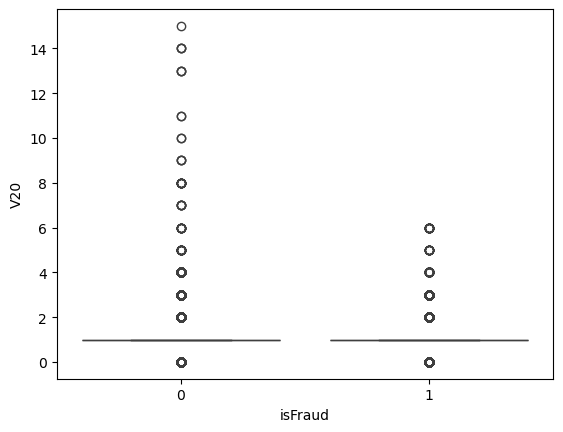

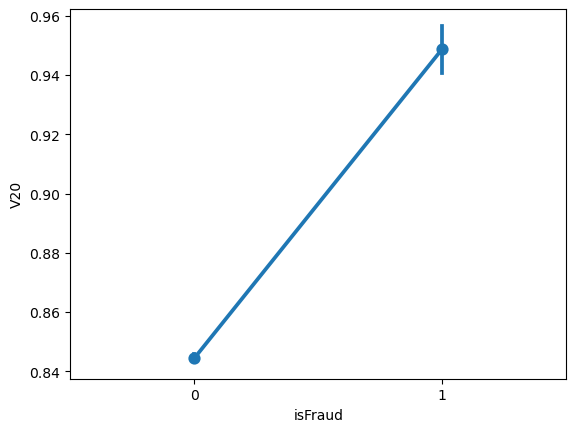

Nilai t-test : 28.95865379614745
Nilai pvalue t-test : 3.074607702986045e-184
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 37
Hubungan label dengan kolom V21


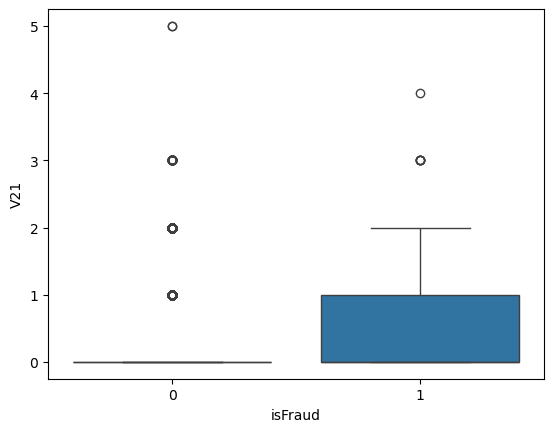

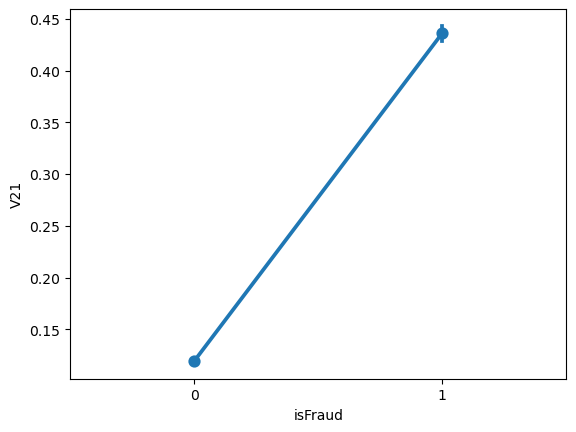

Nilai t-test : 120.72930635289892
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 38
Hubungan label dengan kolom V22


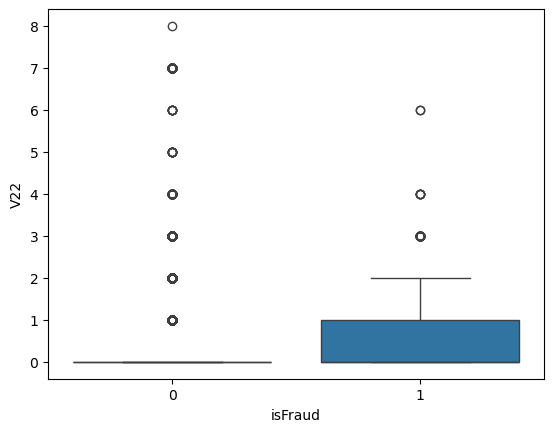

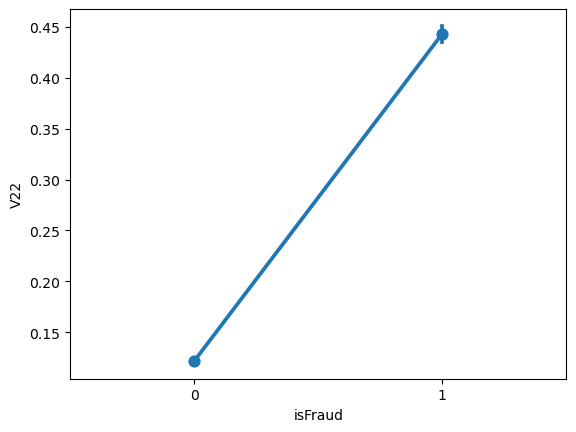

Nilai t-test : 115.37591885424081
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 39
Hubungan label dengan kolom V23


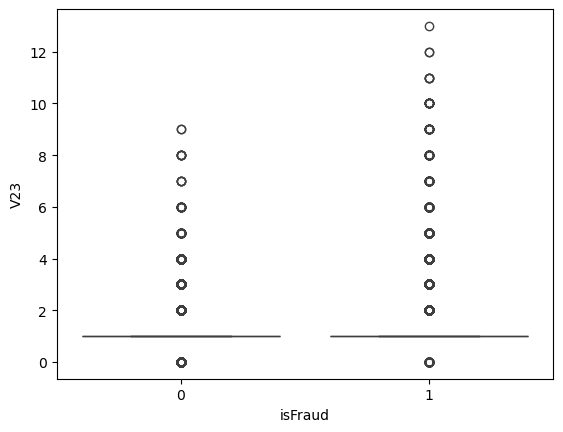

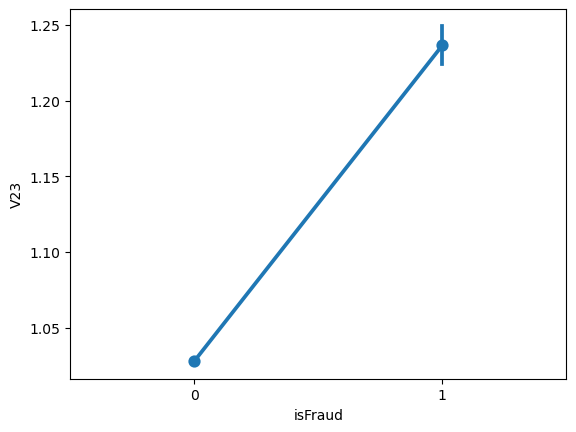

Nilai t-test : 108.38104695223531
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 40
Hubungan label dengan kolom V24


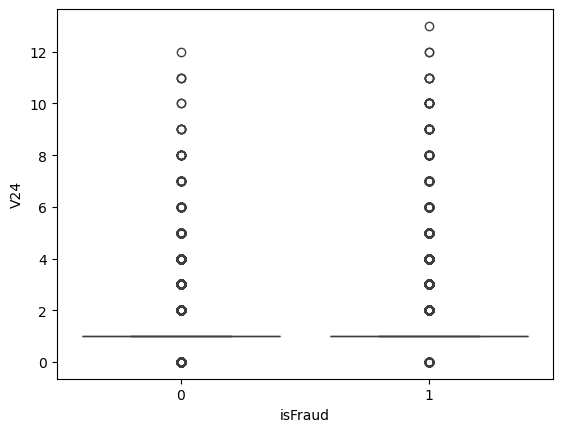

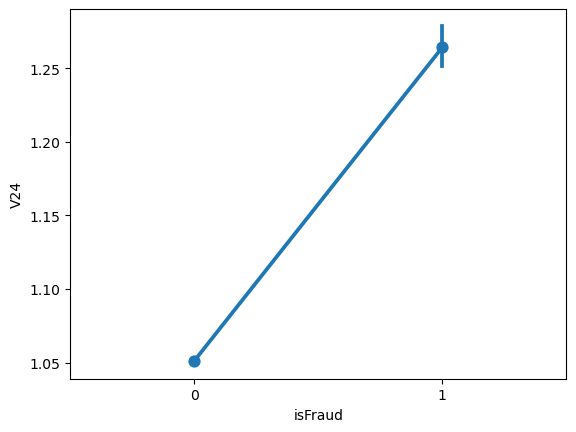

Nilai t-test : 89.5032898008587
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 41
Hubungan label dengan kolom V25


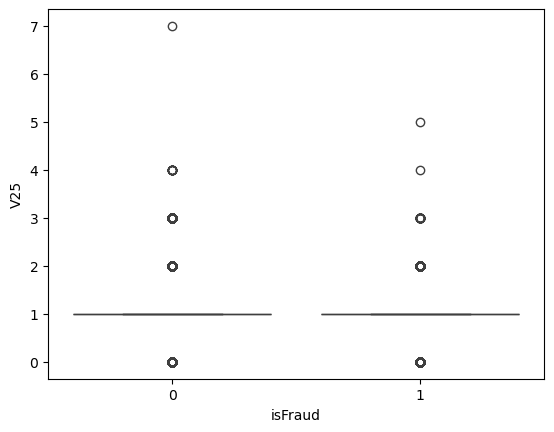

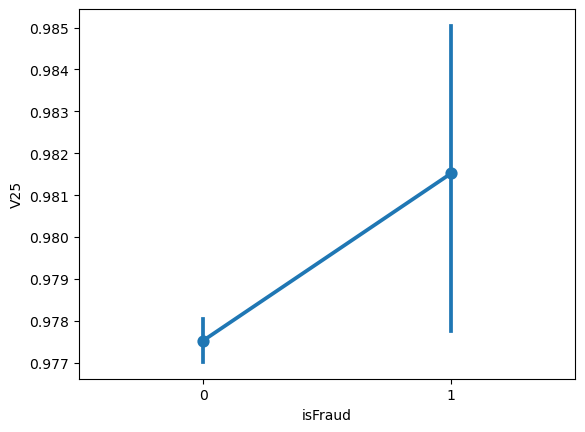

Nilai t-test : 2.7446186855116124
Nilai pvalue t-test : 0.00605833445671762
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 42
Hubungan label dengan kolom V26


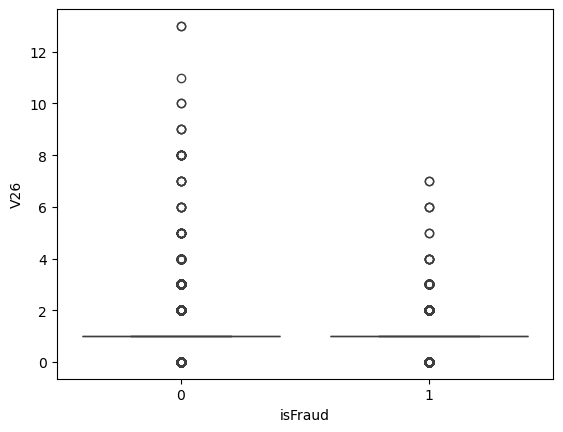

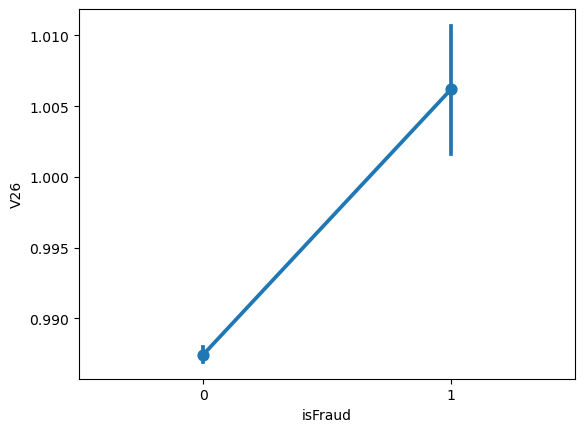

Nilai t-test : 11.42675174890605
Nilai pvalue t-test : 3.099896768911293e-30
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 43
Hubungan label dengan kolom V27


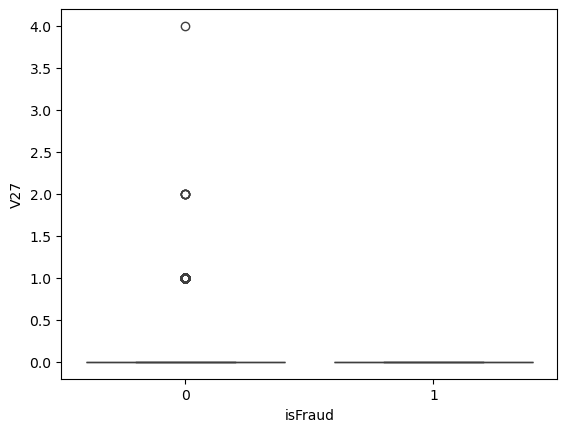

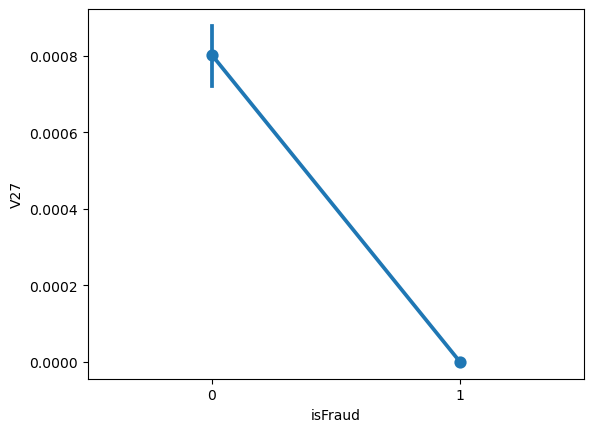

Nilai t-test : -3.5715799119713147
Nilai pvalue t-test : 0.00035486659813939507
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 44
Hubungan label dengan kolom V28


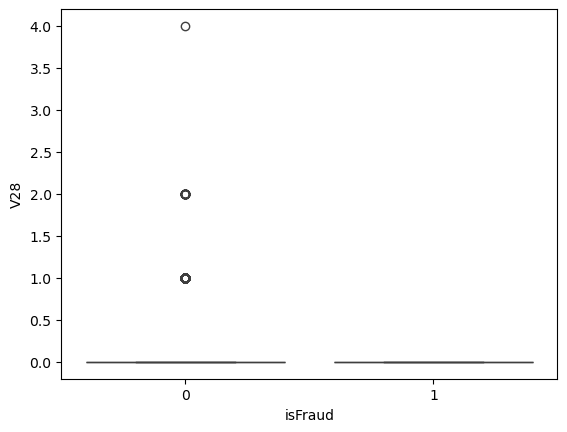

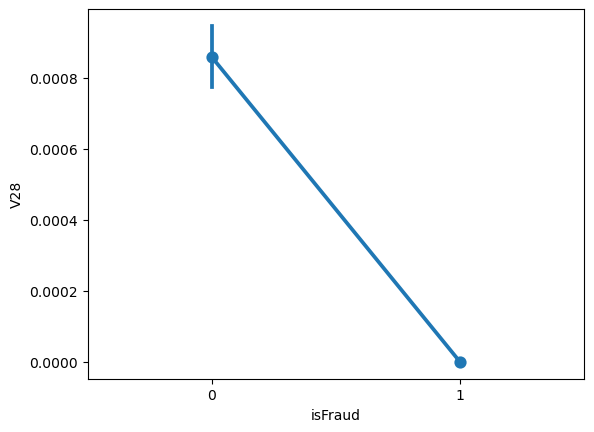

Nilai t-test : -3.510755252269392
Nilai pvalue t-test : 0.0004468738018860894
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 45
Hubungan label dengan kolom V29


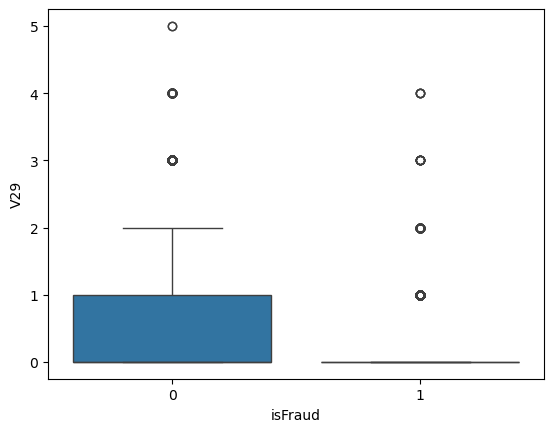

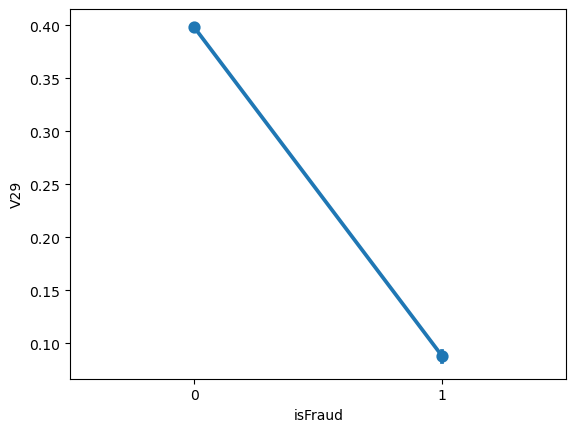

Nilai t-test : -77.81187273579016
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 46
Hubungan label dengan kolom V30


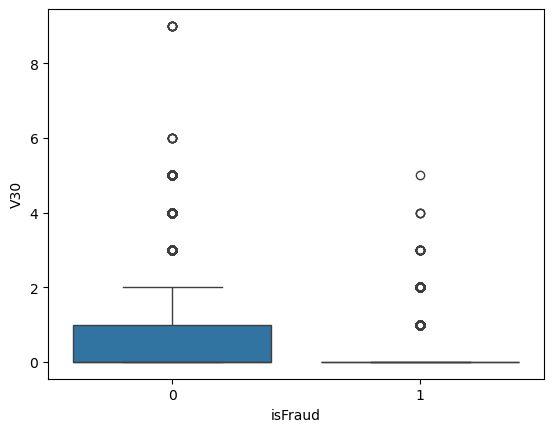

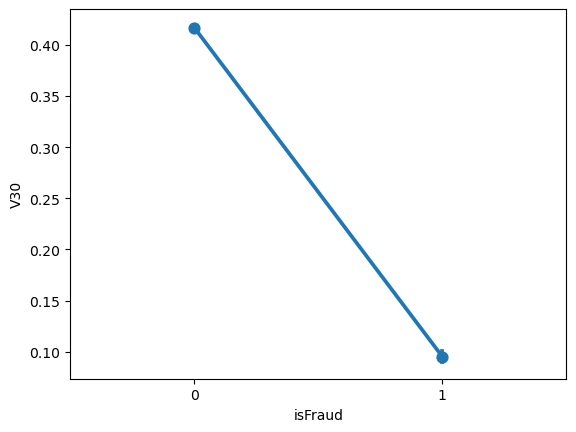

Nilai t-test : -74.33711649139364
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 47
Hubungan label dengan kolom V31


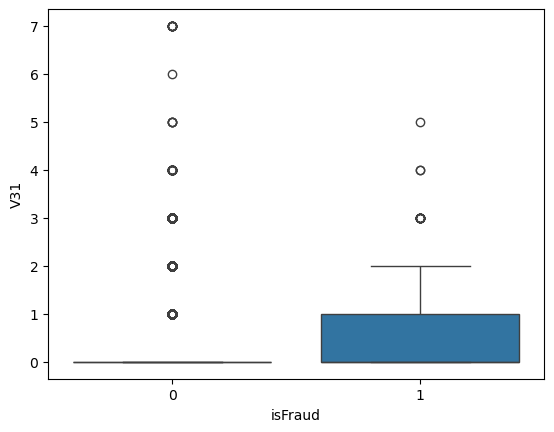

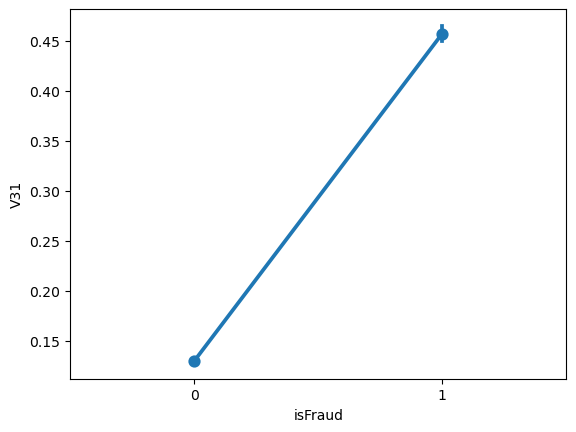

Nilai t-test : 118.62286111788416
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 48
Hubungan label dengan kolom V32


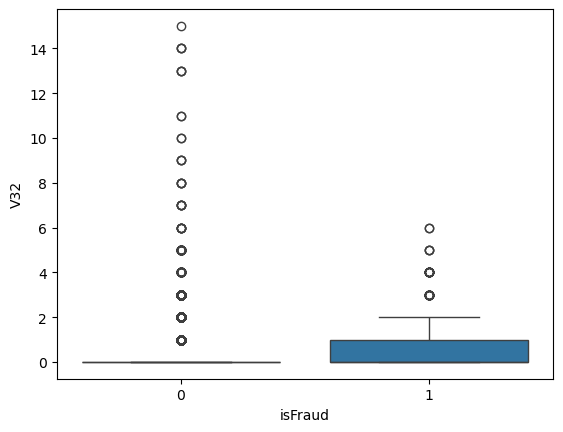

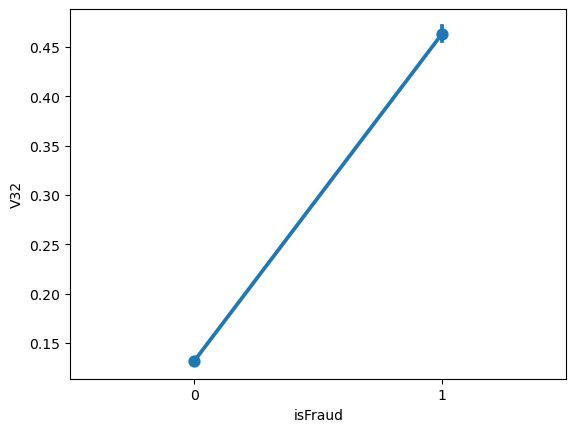

Nilai t-test : 116.40672772726865
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 49
Hubungan label dengan kolom V33


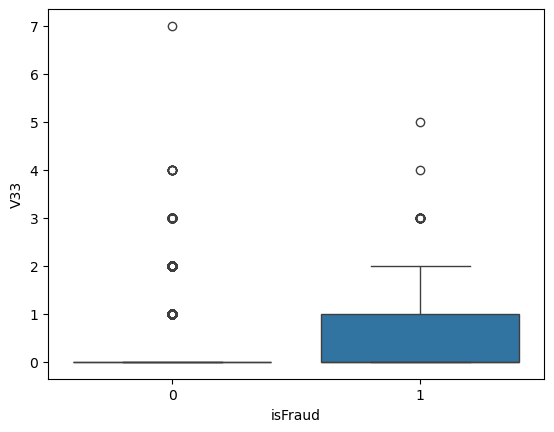

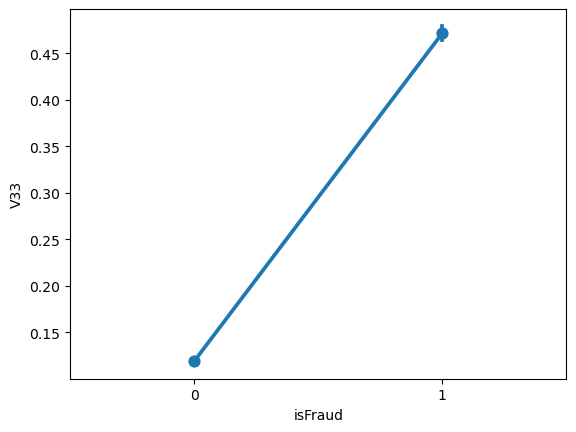

Nilai t-test : 133.88068727770465
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 50
Hubungan label dengan kolom V34


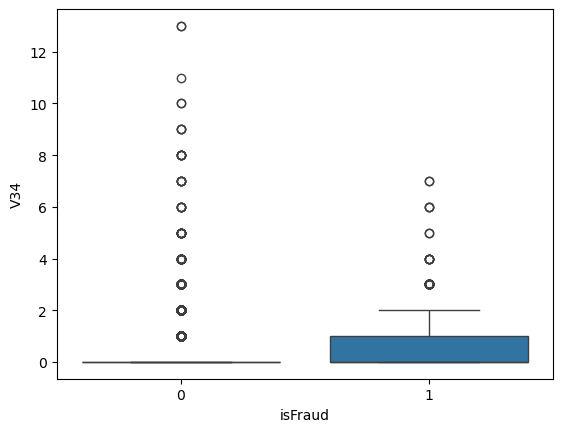

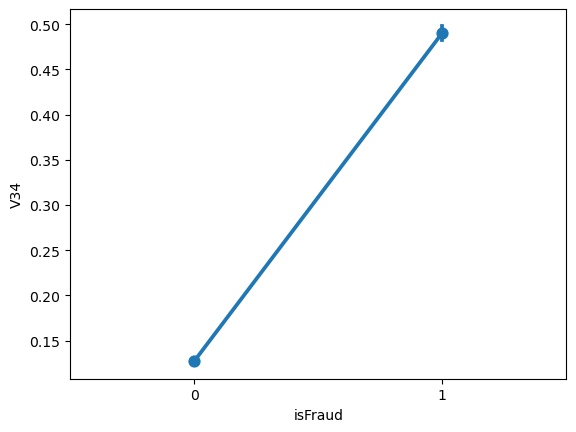

Nilai t-test : 131.47750437779115
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 51
Hubungan label dengan kolom V35


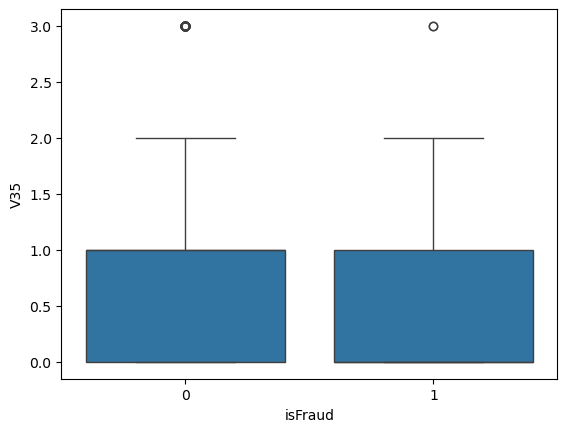

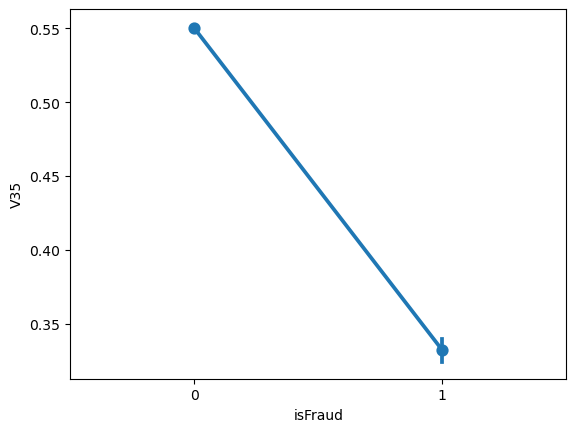

Nilai t-test : -50.21946304757557
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 52
Hubungan label dengan kolom V36


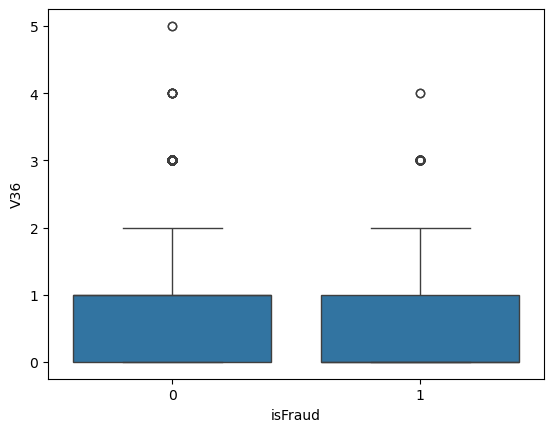

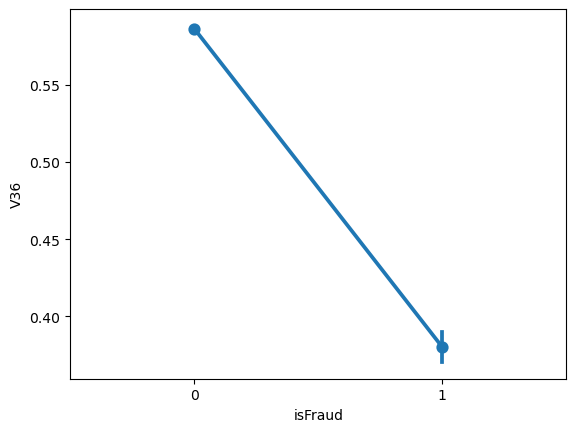

Nilai t-test : -45.47968359948377
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 53
Hubungan label dengan kolom V37


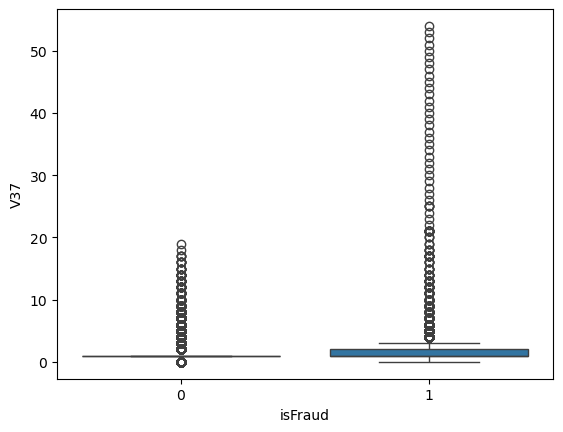

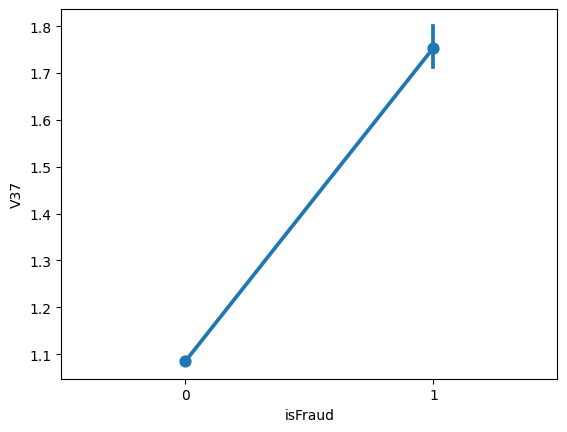

Nilai t-test : 116.73062022321322
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 54
Hubungan label dengan kolom V38


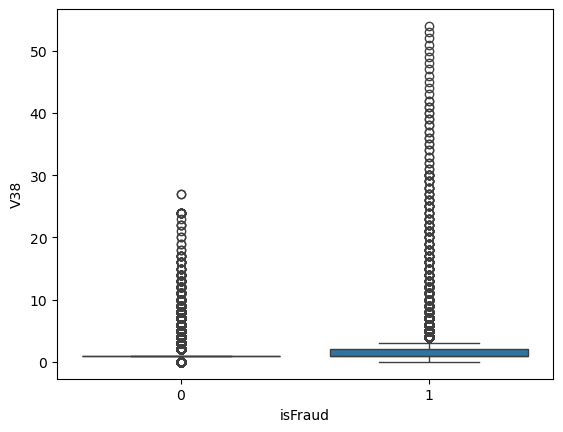

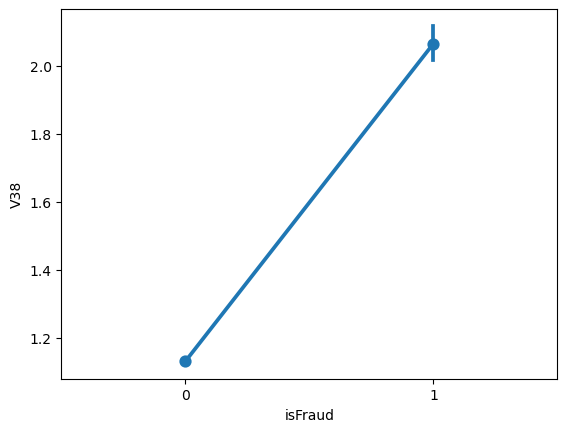

Nilai t-test : 131.84747273073077
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 55
Hubungan label dengan kolom V39


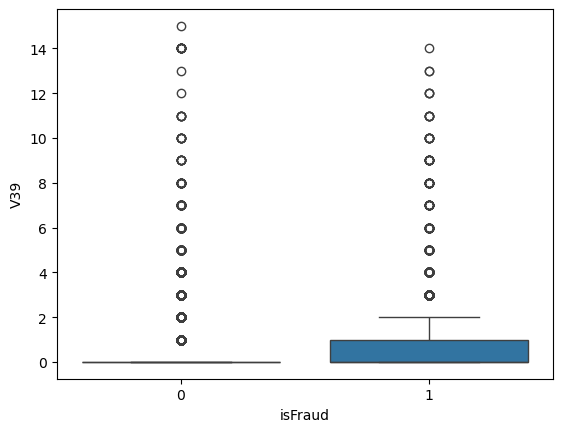

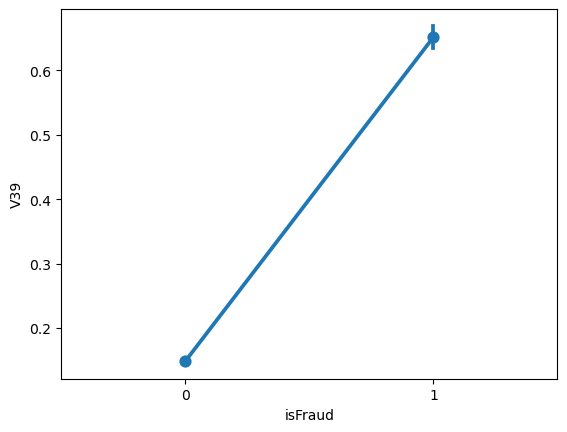

Nilai t-test : 134.6739936737543
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 56
Hubungan label dengan kolom V40


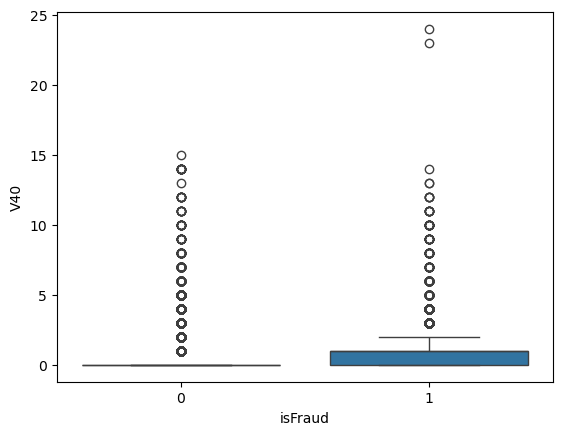

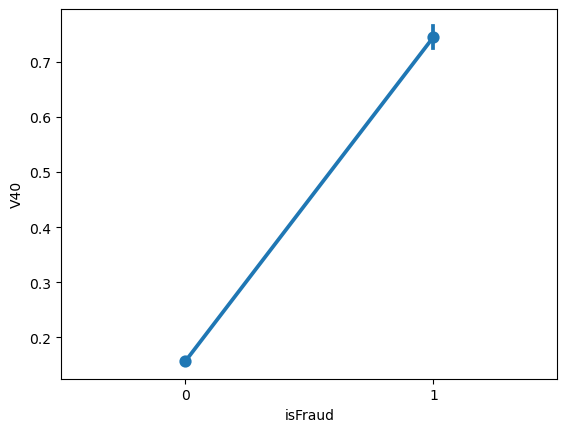

Nilai t-test : 141.15705562559745
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 57
Hubungan label dengan kolom V41


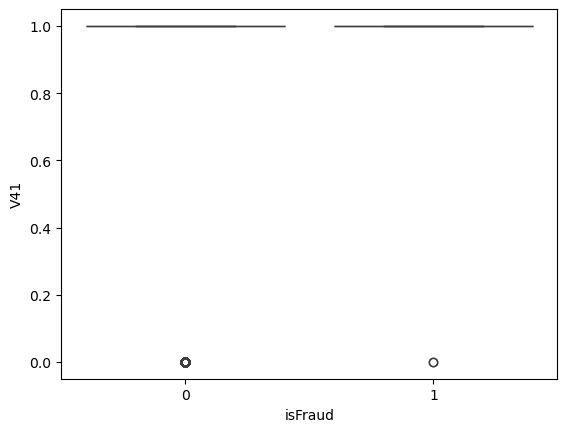

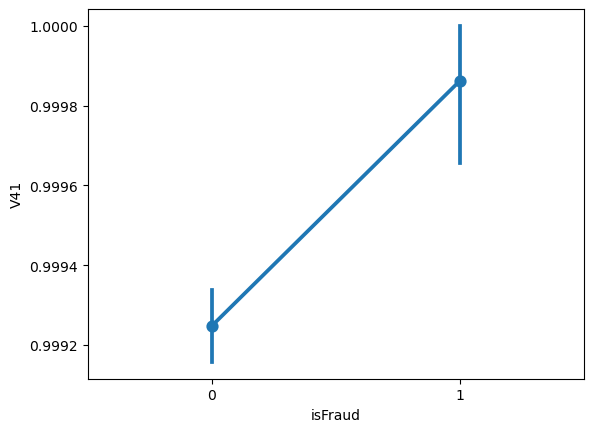

Nilai t-test : 2.697240825852055
Nilai pvalue t-test : 0.006991946550336508
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 58
Hubungan label dengan kolom V42


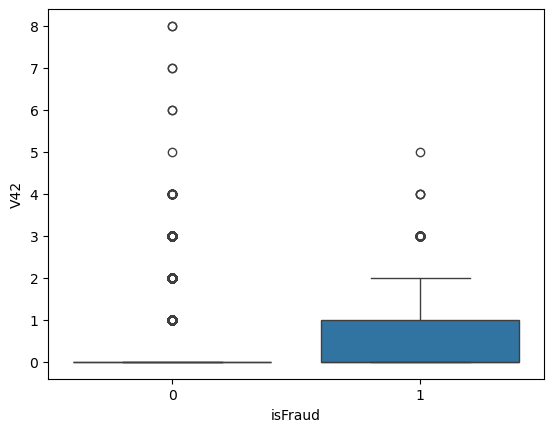

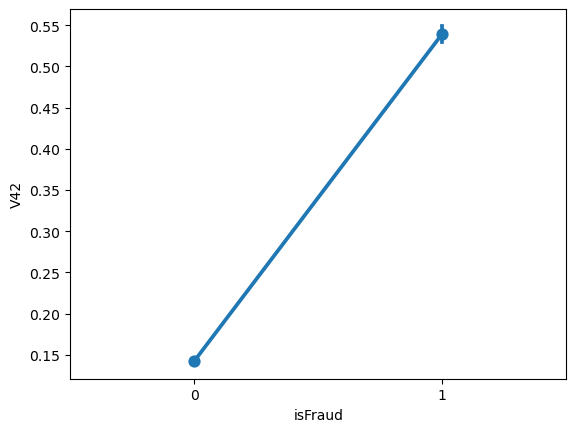

Nilai t-test : 125.26054655673423
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 59
Hubungan label dengan kolom V43


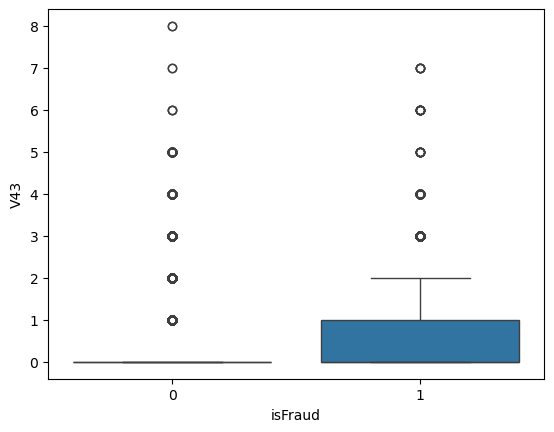

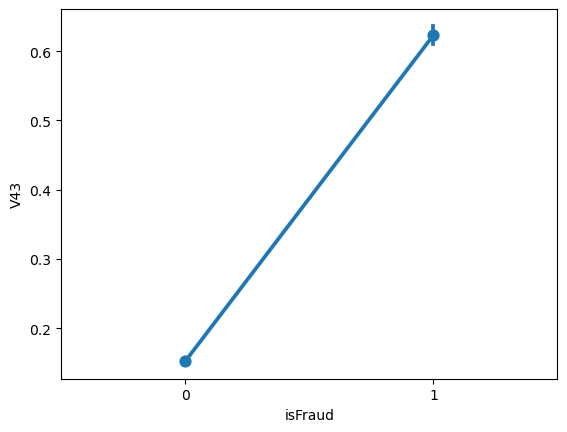

Nilai t-test : 131.34356181261256
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 60
Hubungan label dengan kolom V44


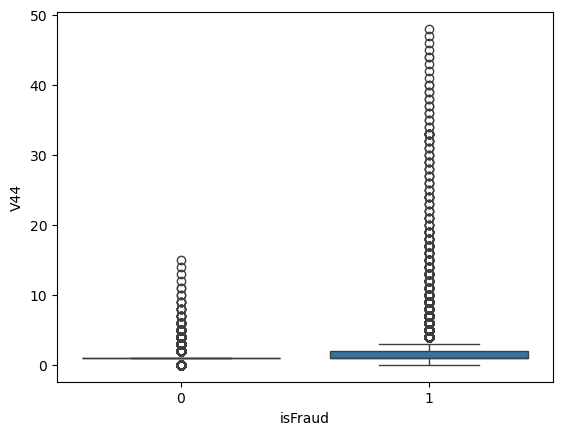

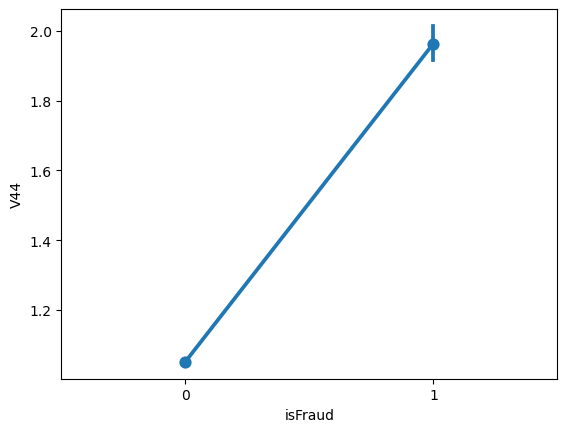

Nilai t-test : 175.09753178176612
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 61
Hubungan label dengan kolom V45


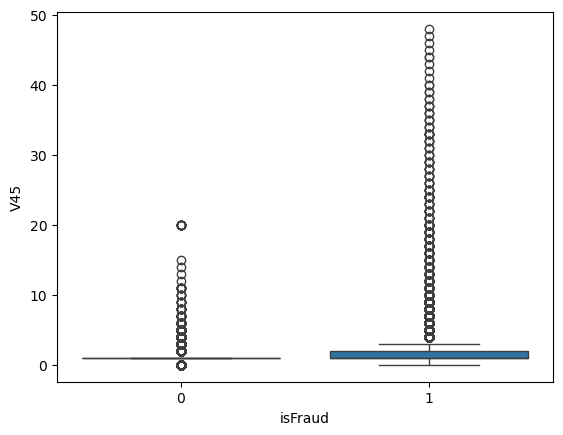

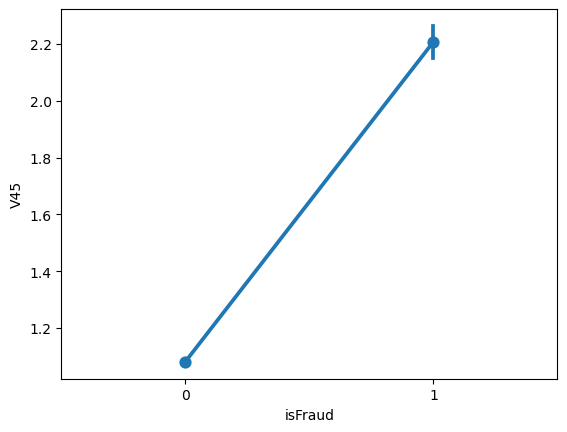

Nilai t-test : 190.71988097317507
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 62
Hubungan label dengan kolom V46


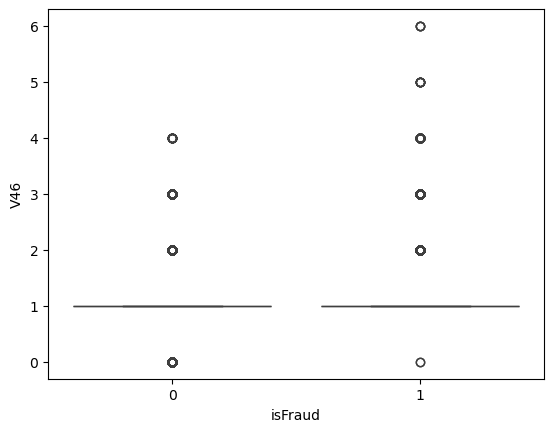

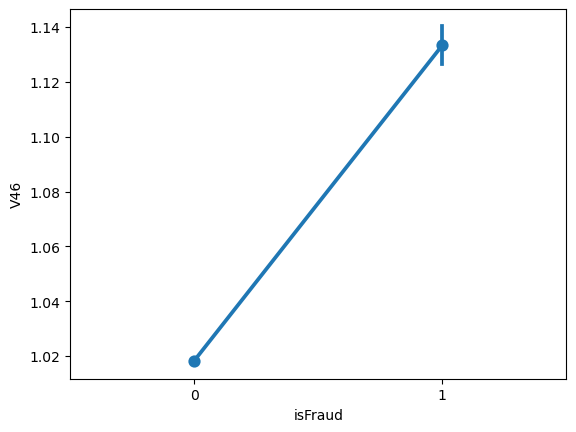

Nilai t-test : 82.46087455959177
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 63
Hubungan label dengan kolom V47


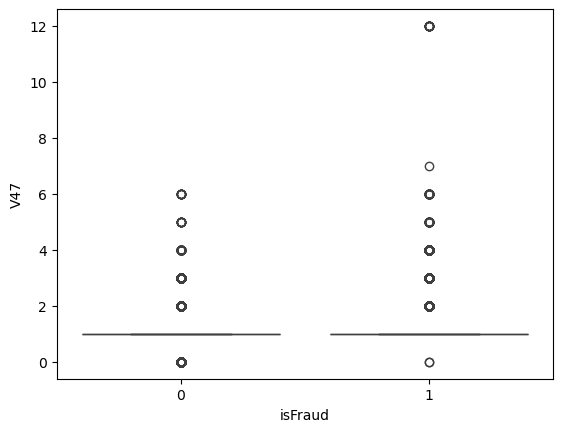

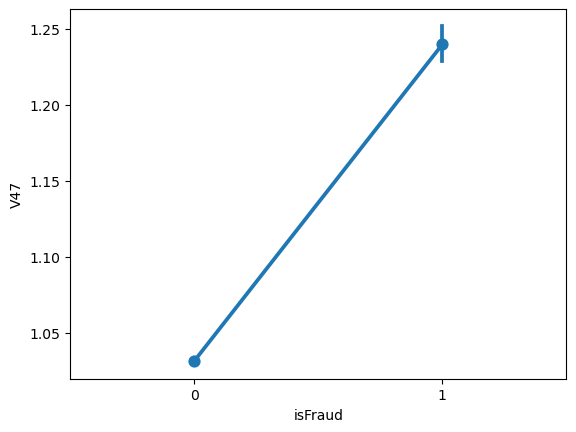

Nilai t-test : 108.02116462458198
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 64
Hubungan label dengan kolom V48


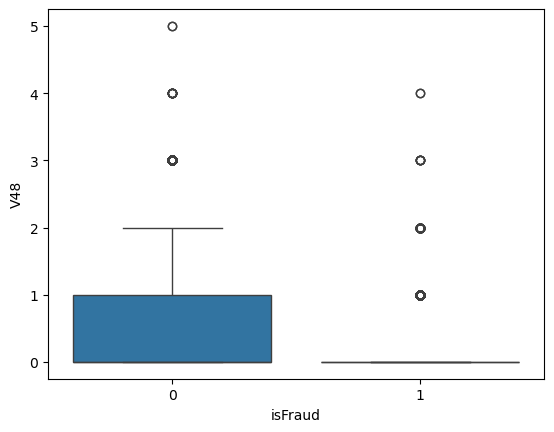

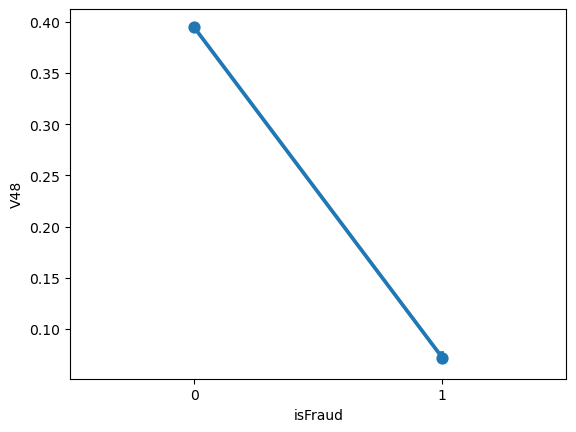

Nilai t-test : -75.68691009380974
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 65
Hubungan label dengan kolom V49


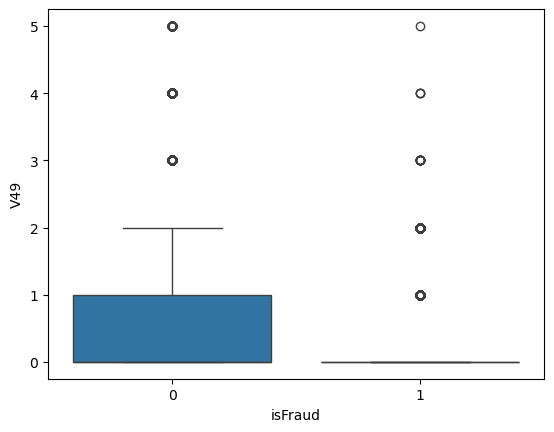

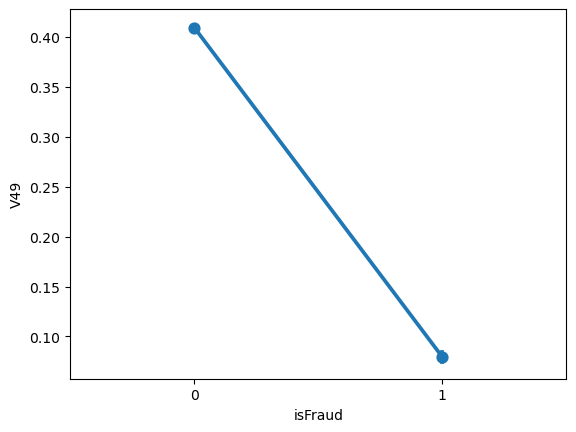

Nilai t-test : -72.46574186355245
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 66
Hubungan label dengan kolom V50


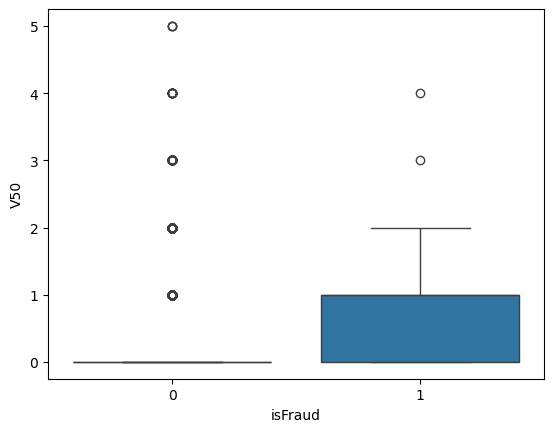

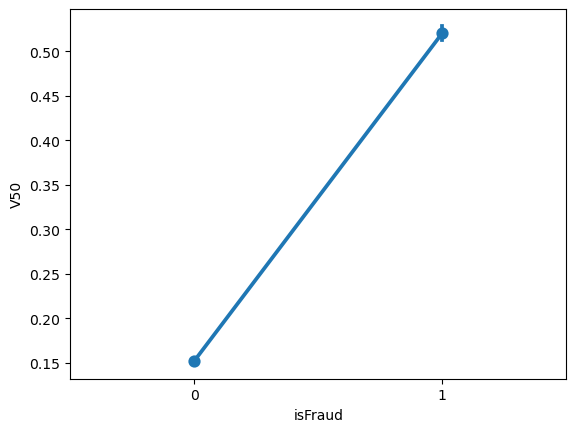

Nilai t-test : 118.77975113159845
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 67
Hubungan label dengan kolom V51


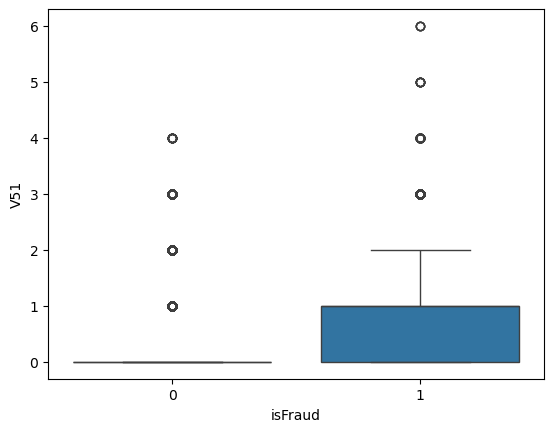

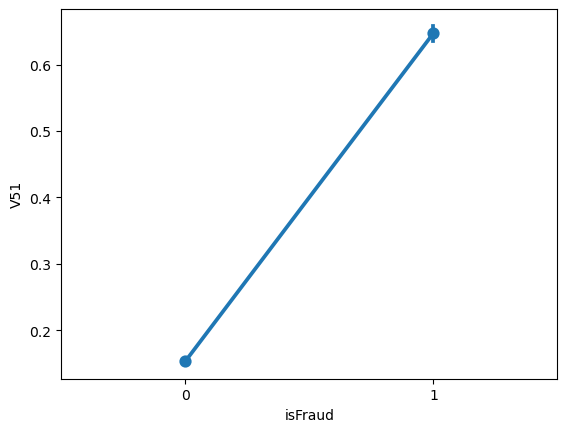

Nilai t-test : 148.66439174064837
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 68
Hubungan label dengan kolom V52


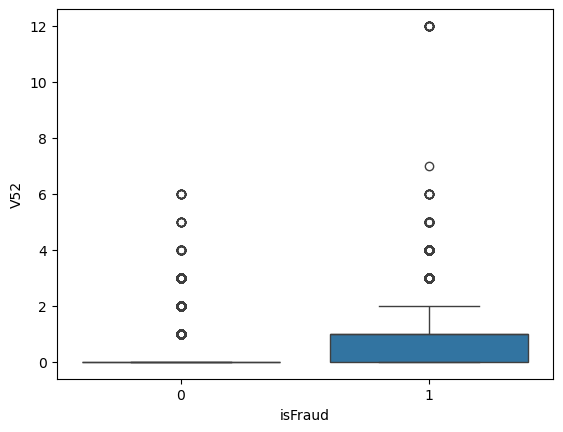

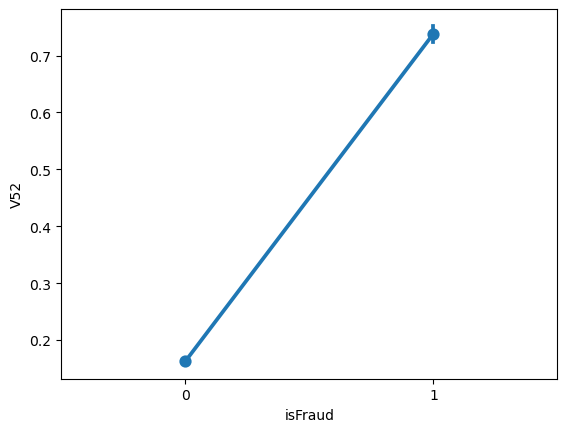

Nilai t-test : 160.14289020604403
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 69
Hubungan label dengan kolom V53


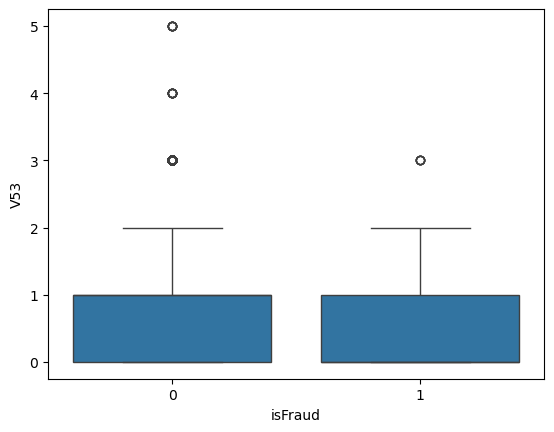

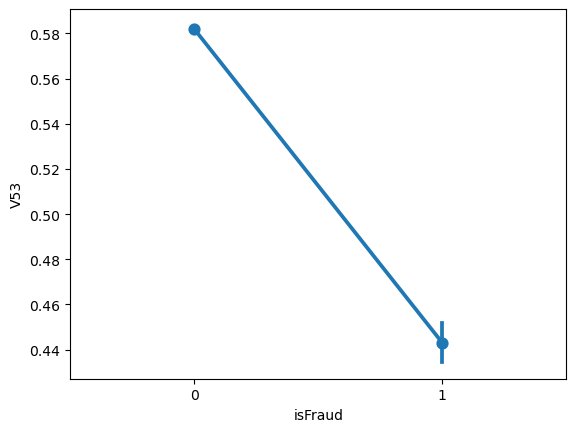

Nilai t-test : -34.00229529512282
Nilai pvalue t-test : 3.9507408203464133e-253
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 70
Hubungan label dengan kolom V54


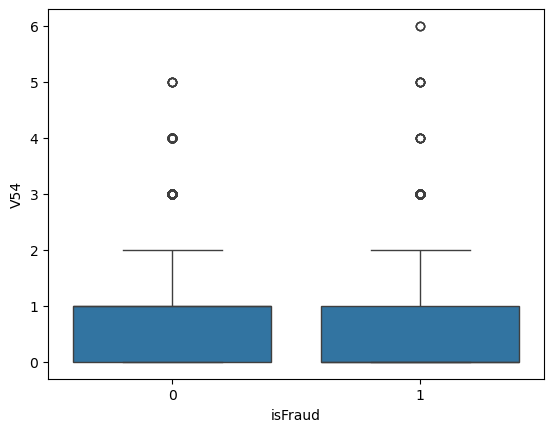

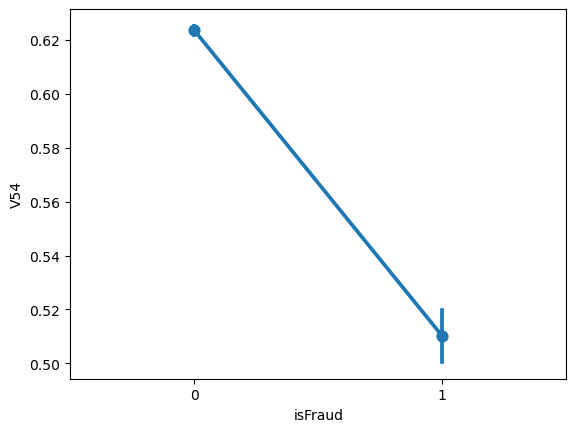

Nilai t-test : -26.54859582339251
Nilai pvalue t-test : 3.3969904857333935e-155
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 71
Hubungan label dengan kolom V55


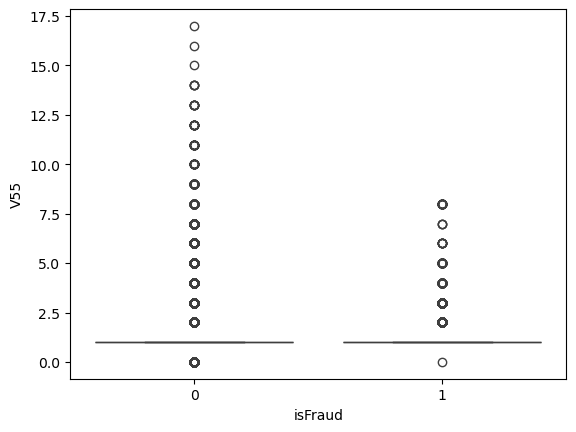

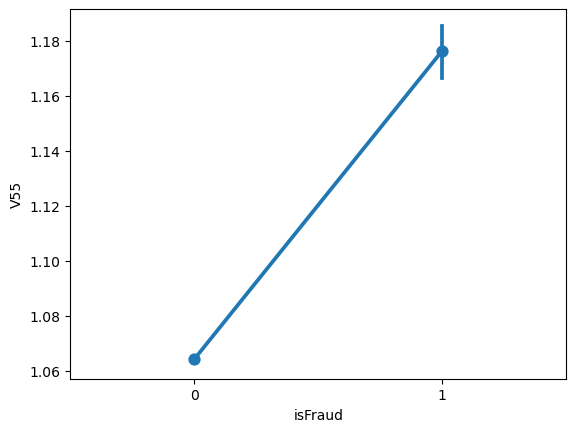

Nilai t-test : 35.95412804913514
Nilai pvalue t-test : 9.842079718917306e-283
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 72
Hubungan label dengan kolom V56


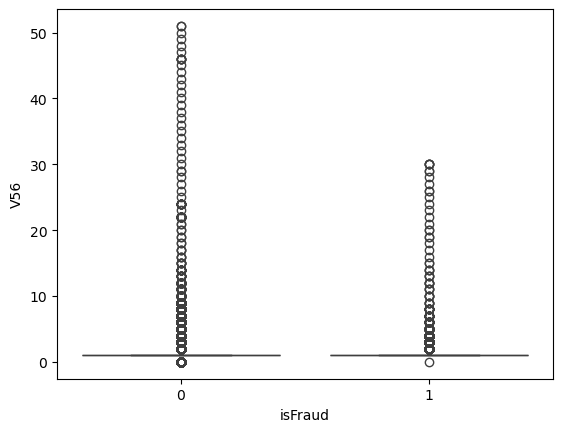

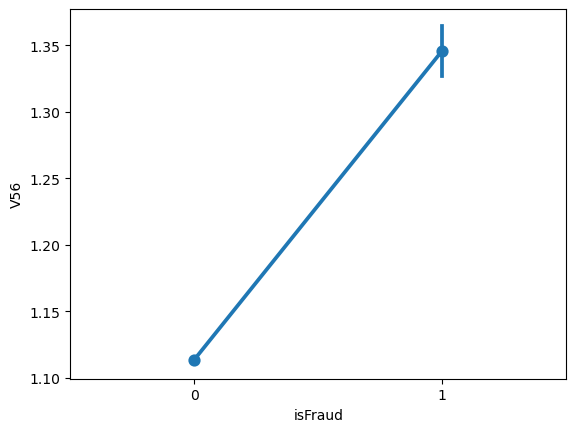

Nilai t-test : 44.047654925234234
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 73
Hubungan label dengan kolom V57


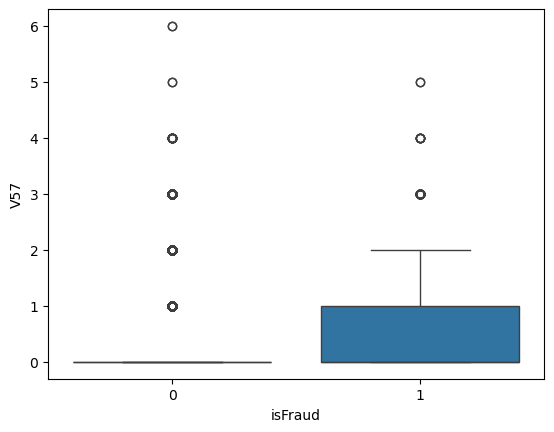

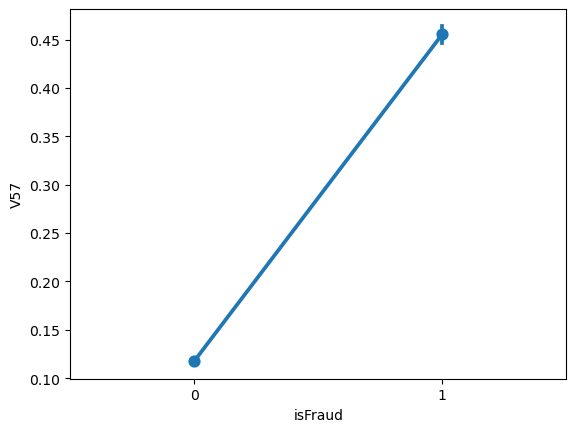

Nilai t-test : 122.7793621262093
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 74
Hubungan label dengan kolom V58


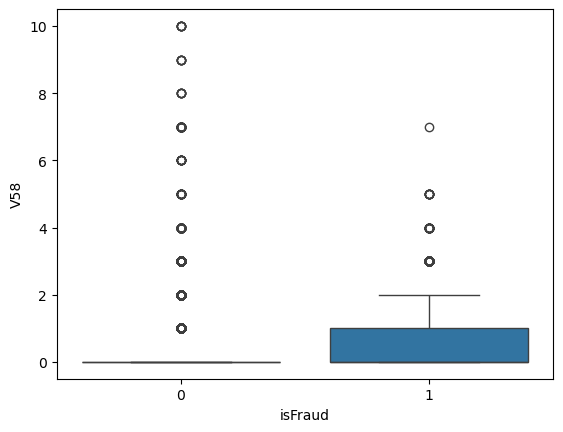

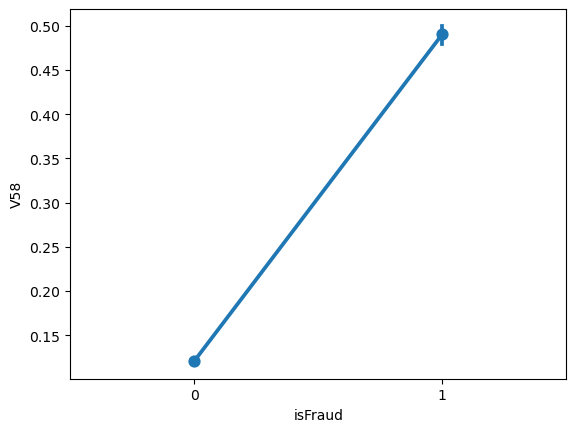

Nilai t-test : 125.9096513034941
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 75
Hubungan label dengan kolom V59


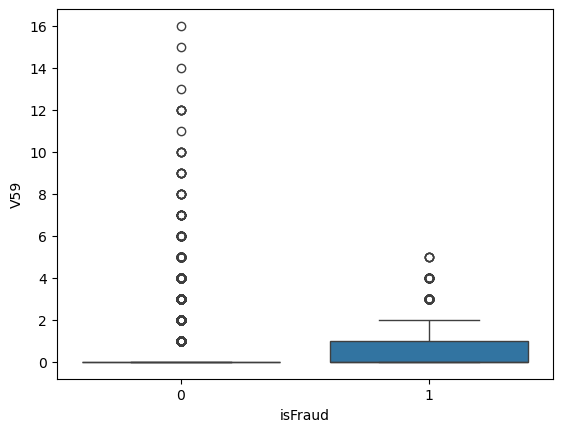

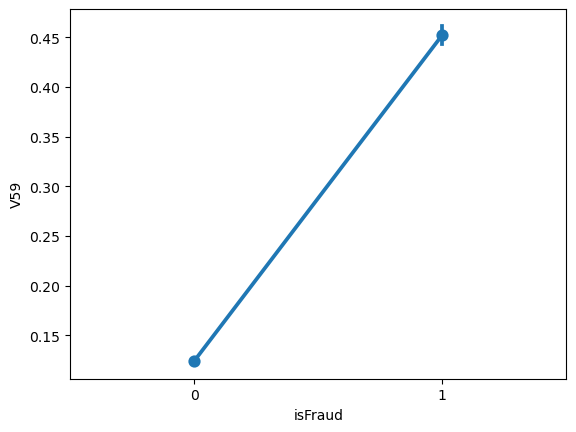

Nilai t-test : 109.49951070190339
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 76
Hubungan label dengan kolom V60


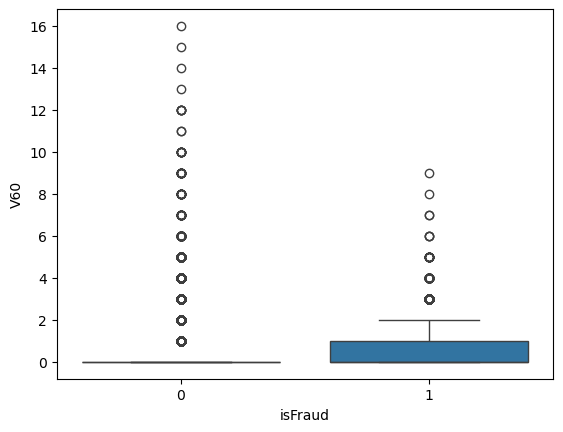

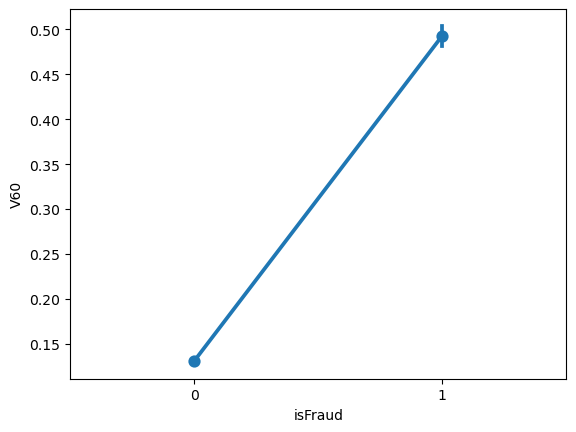

Nilai t-test : 109.41810396988878
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 77
Hubungan label dengan kolom V61


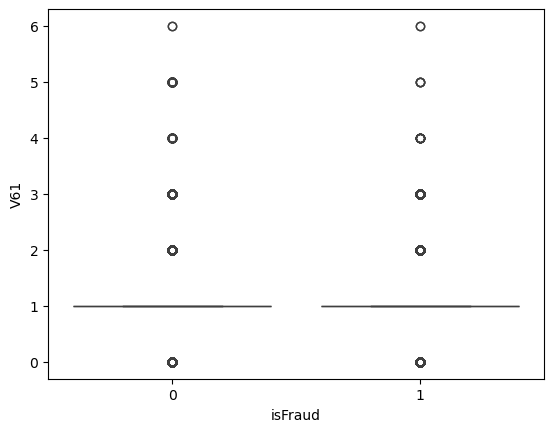

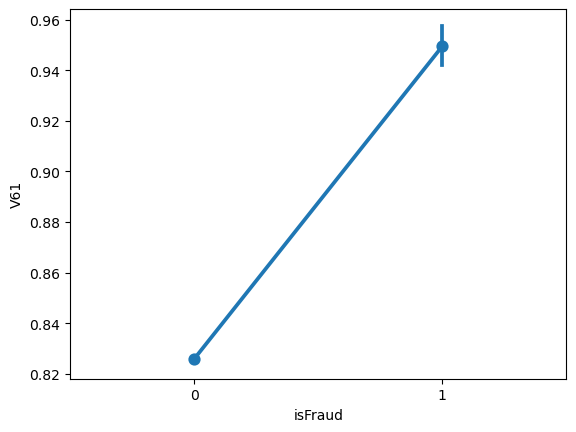

Nilai t-test : 35.44956883520677
Nilai pvalue t-test : 6.354403625781715e-275
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 78
Hubungan label dengan kolom V62


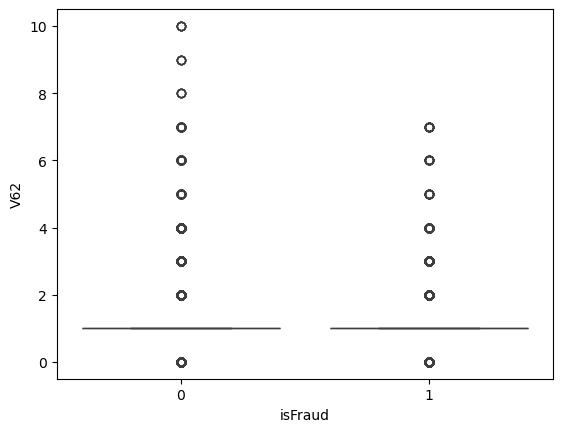

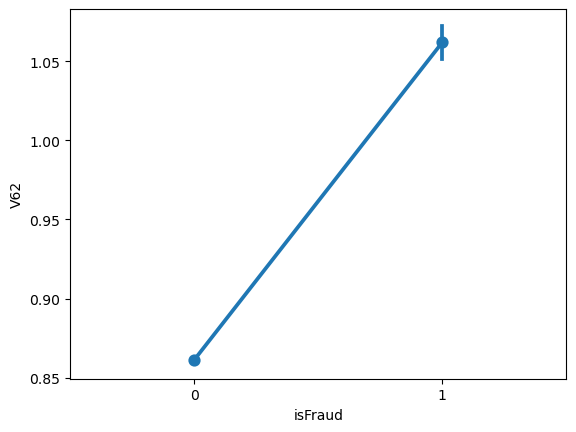

Nilai t-test : 52.013784590245436
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 79
Hubungan label dengan kolom V63


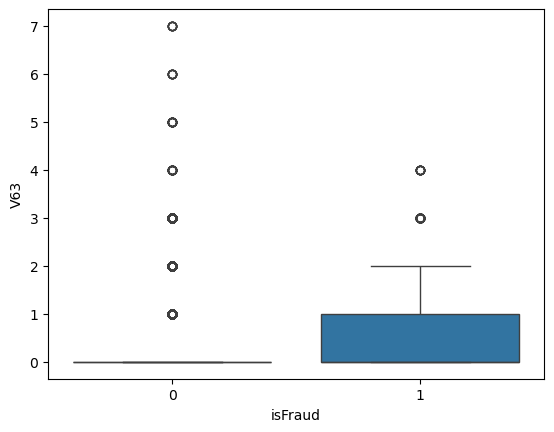

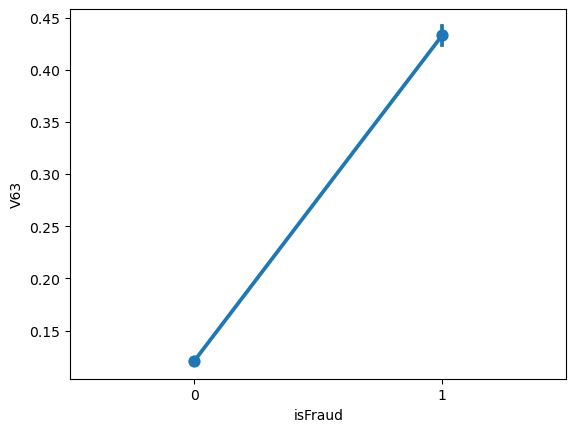

Nilai t-test : 111.20001317836137
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 80
Hubungan label dengan kolom V64


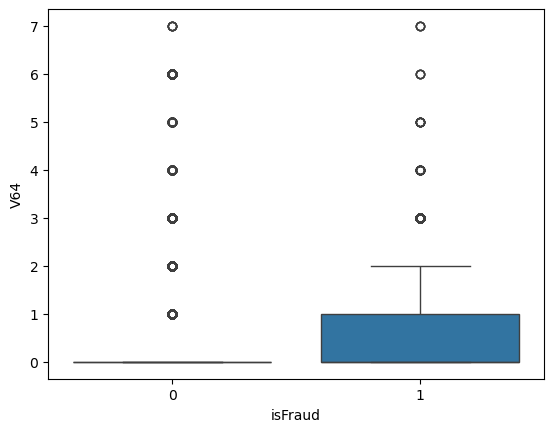

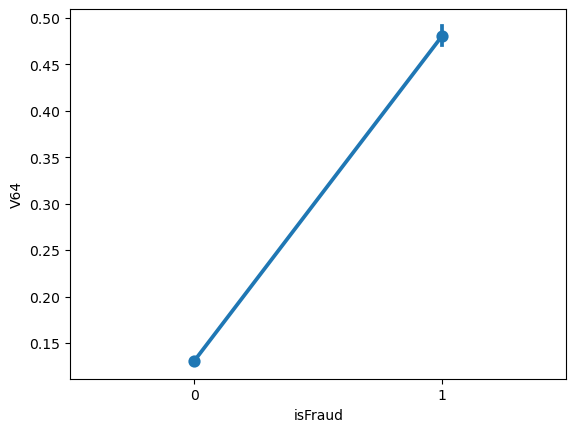

Nilai t-test : 108.98716614326051
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 81
Hubungan label dengan kolom V65


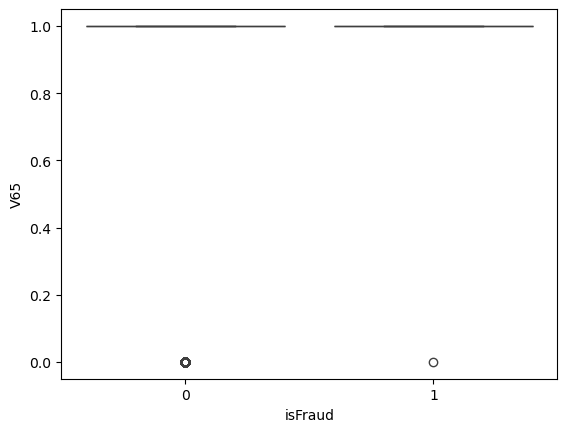

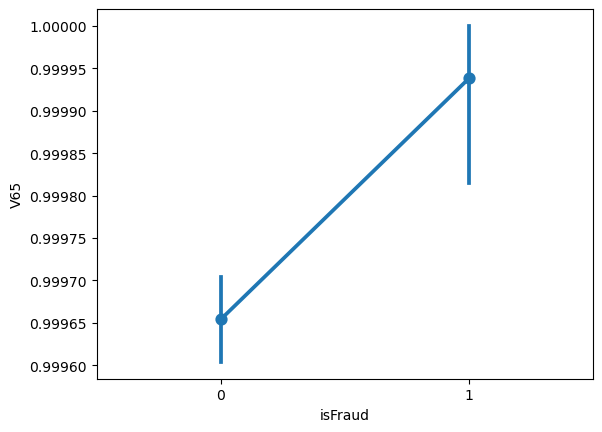

Nilai t-test : 1.9353920134960143
Nilai pvalue t-test : 0.05294275700544496
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 82
Hubungan label dengan kolom V66


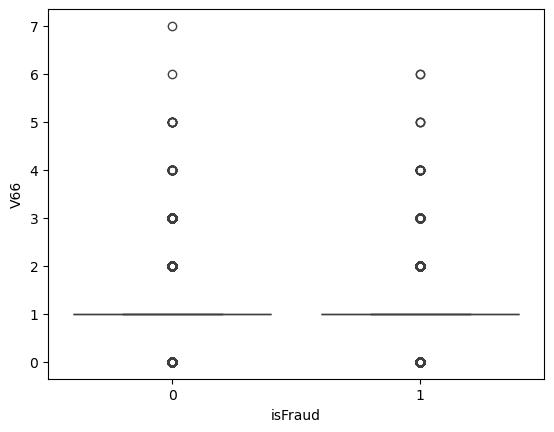

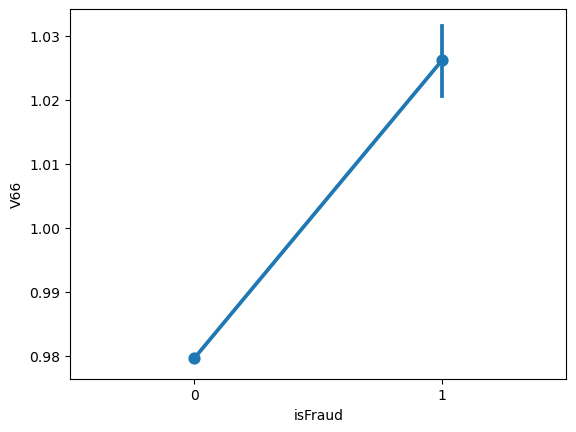

Nilai t-test : 26.983450044337047
Nilai pvalue t-test : 2.993781284788316e-160
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 83
Hubungan label dengan kolom V67


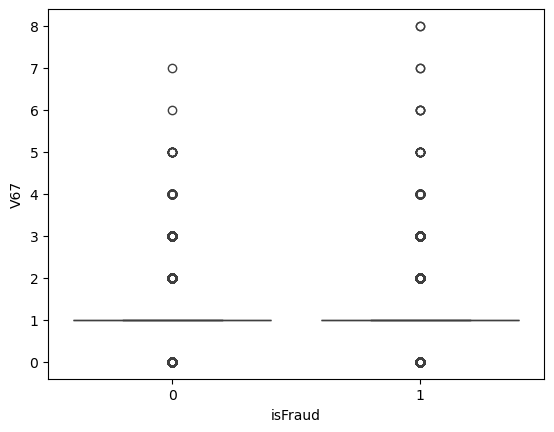

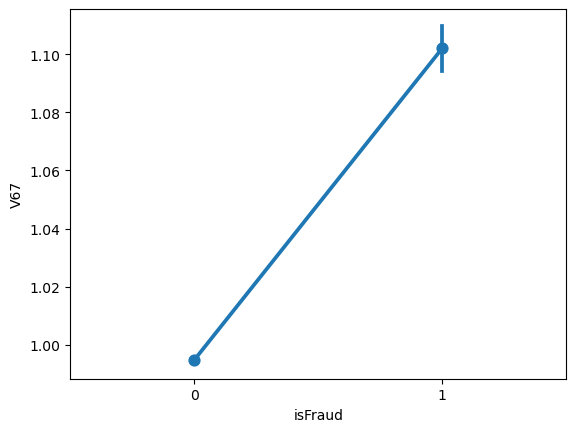

Nilai t-test : 54.755857037095296
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 84
Hubungan label dengan kolom V68


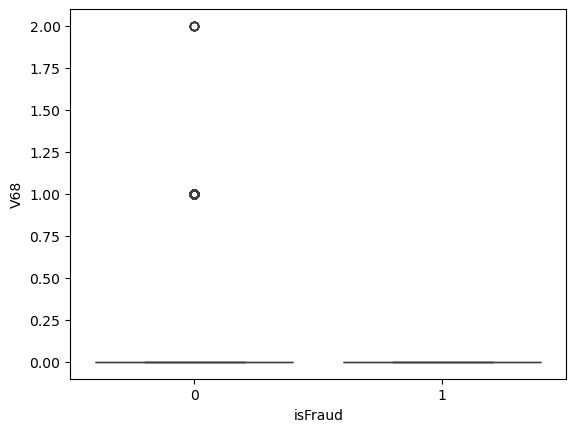

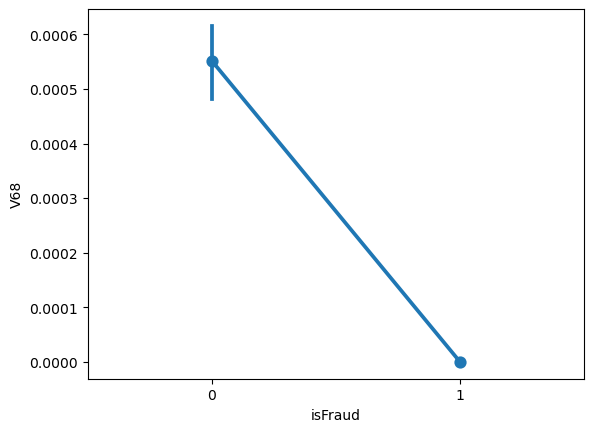

Nilai t-test : -2.9006743041363006
Nilai pvalue t-test : 0.003723764791712642
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 85
Hubungan label dengan kolom V69


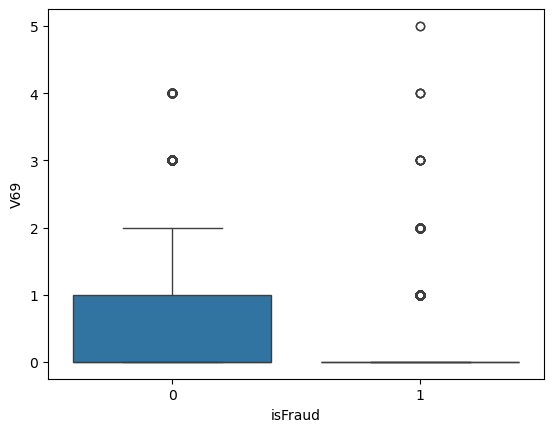

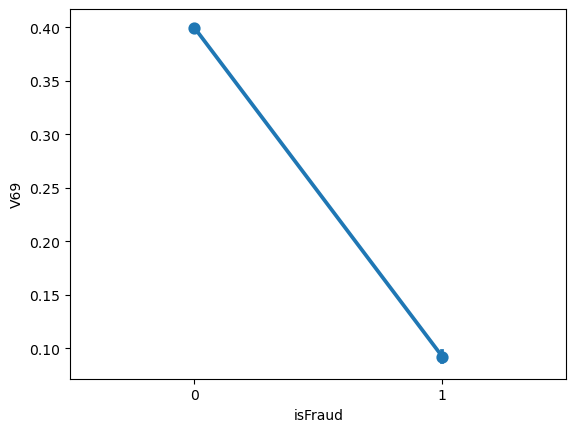

Nilai t-test : -75.30659471453183
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 86
Hubungan label dengan kolom V70


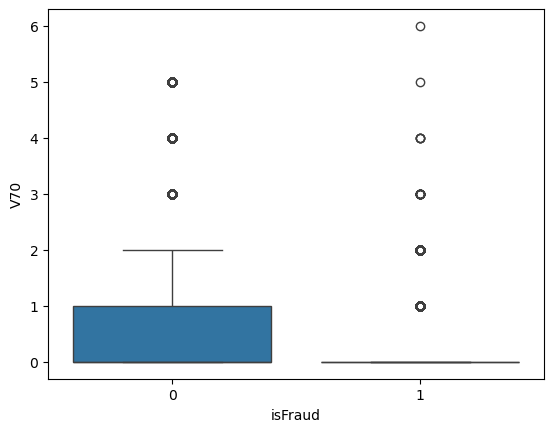

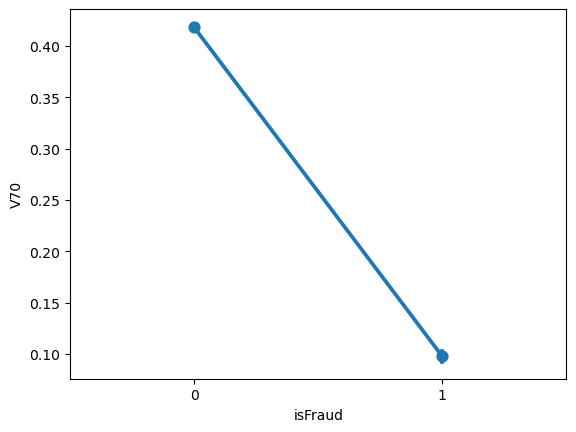

Nilai t-test : -72.67058449938443
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 87
Hubungan label dengan kolom V71


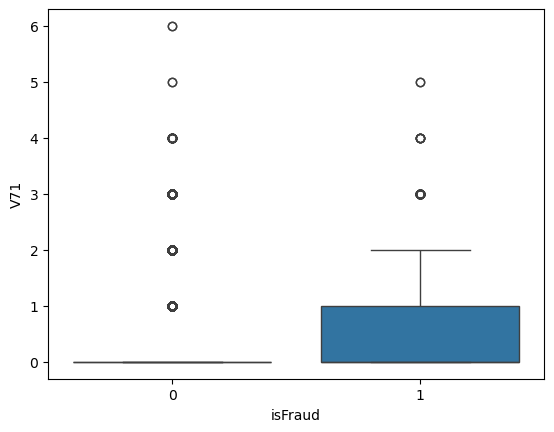

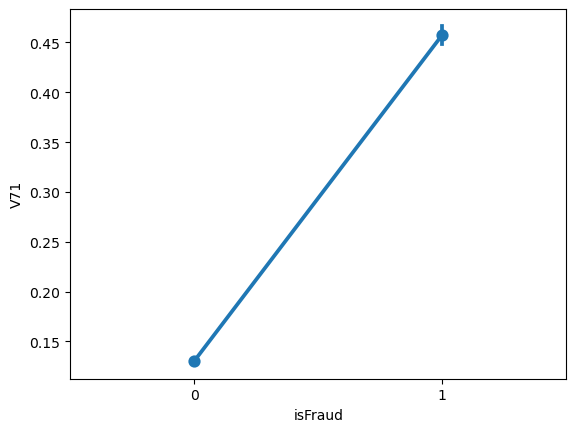

Nilai t-test : 113.79210403476536
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 88
Hubungan label dengan kolom V72


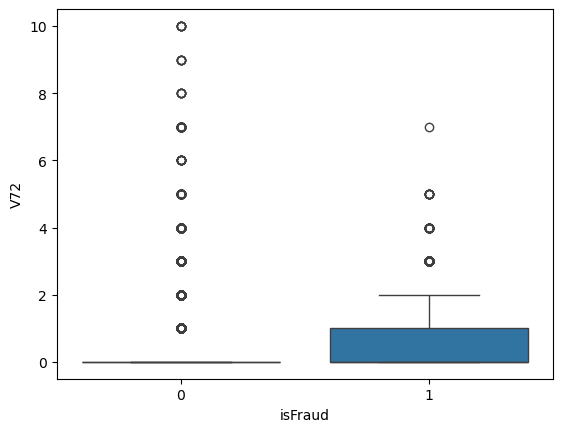

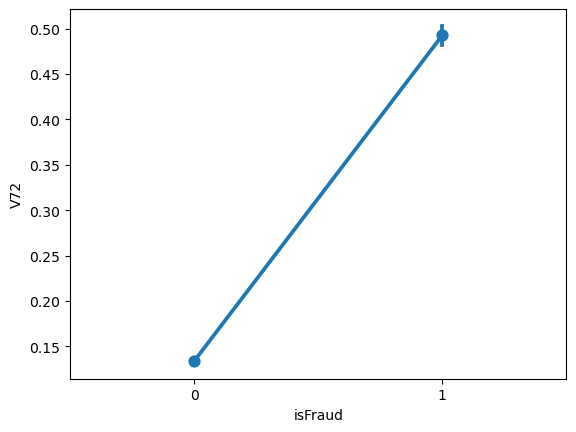

Nilai t-test : 116.85265638329375
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 89
Hubungan label dengan kolom V73


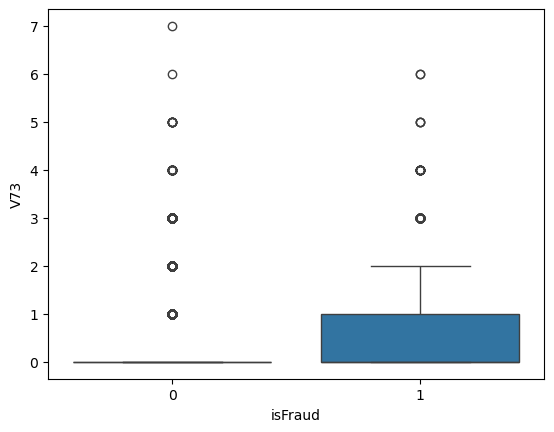

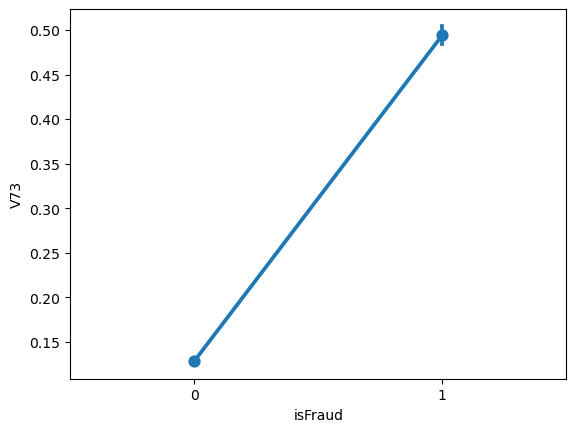

Nilai t-test : 126.51333895041502
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 90
Hubungan label dengan kolom V74


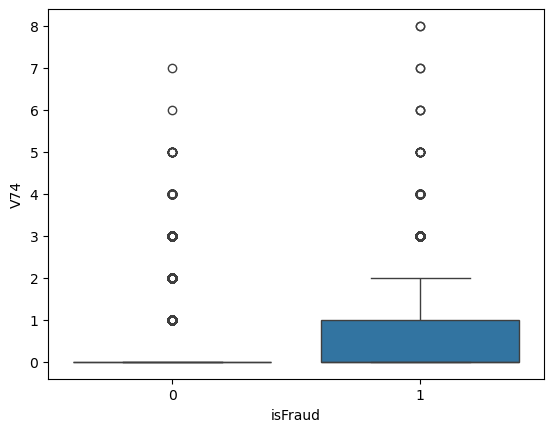

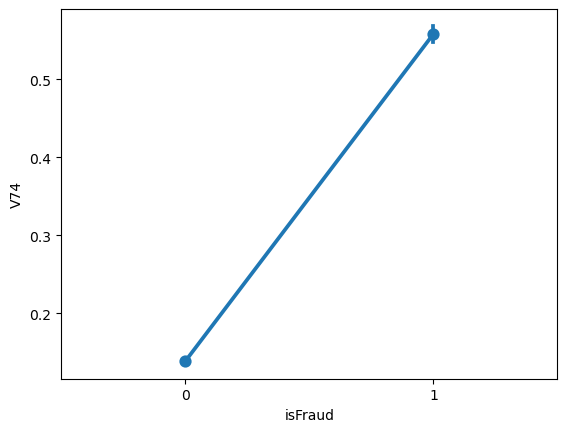

Nilai t-test : 135.58095686508995
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 91
Hubungan label dengan kolom V75


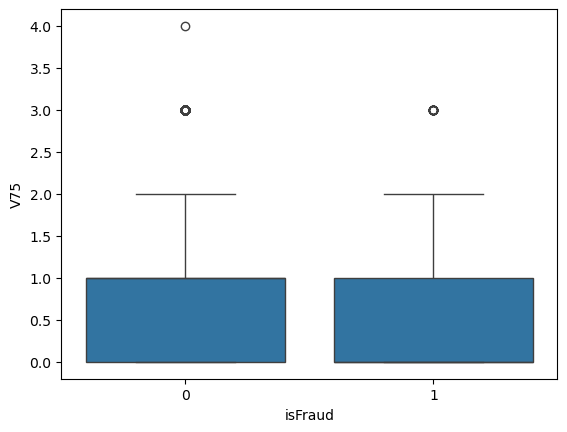

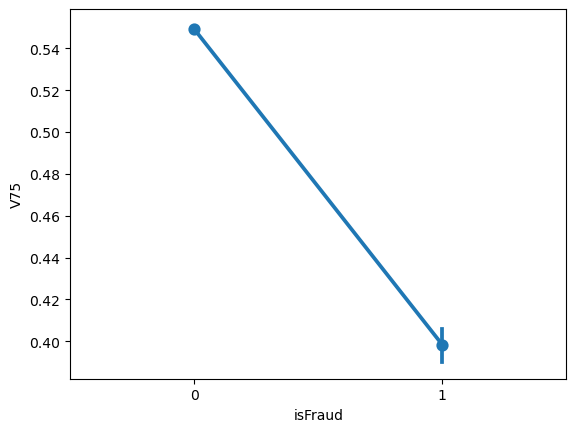

Nilai t-test : -36.99158106528773
Nilai pvalue t-test : 3.976992687088769e-299
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 92
Hubungan label dengan kolom V76


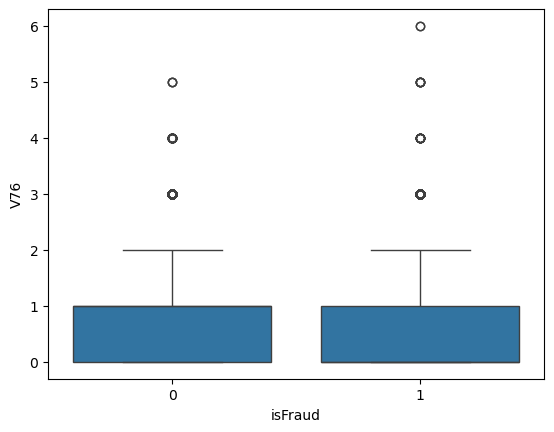

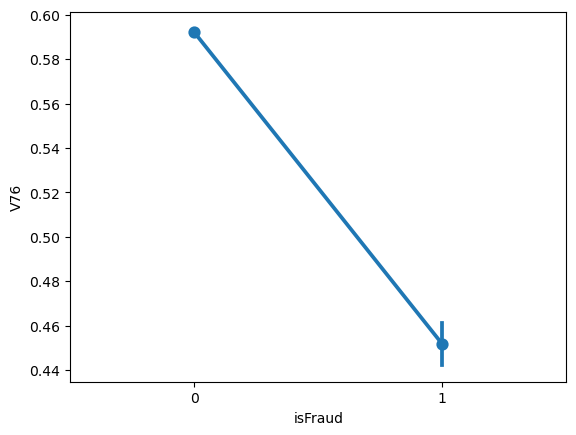

Nilai t-test : -32.90364291408959
Nilai pvalue t-test : 3.498062991394729e-237
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 93
Hubungan label dengan kolom V77


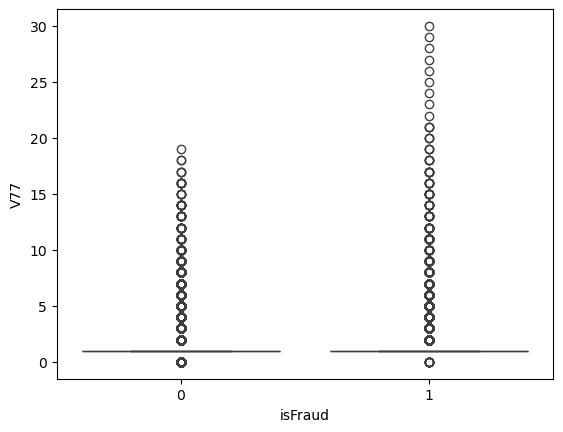

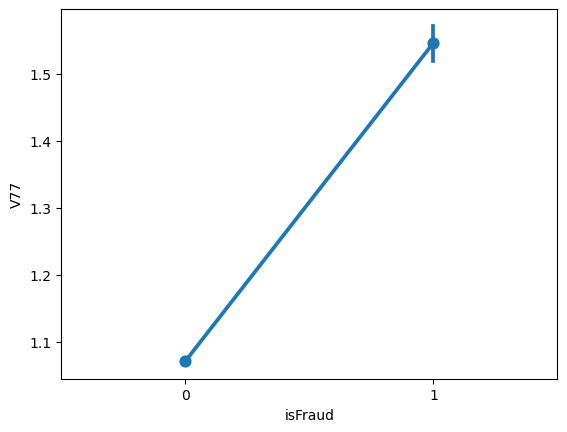

Nilai t-test : 113.57979933772285
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 94
Hubungan label dengan kolom V78


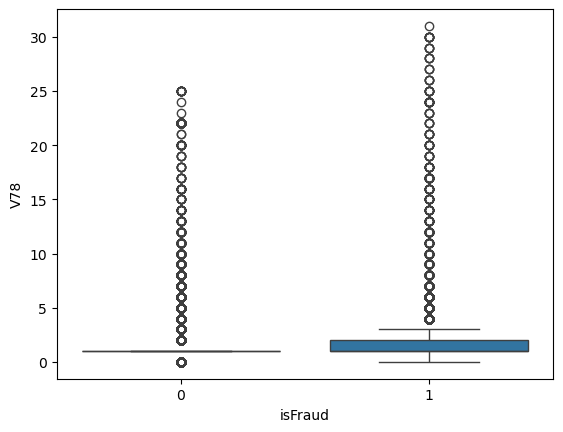

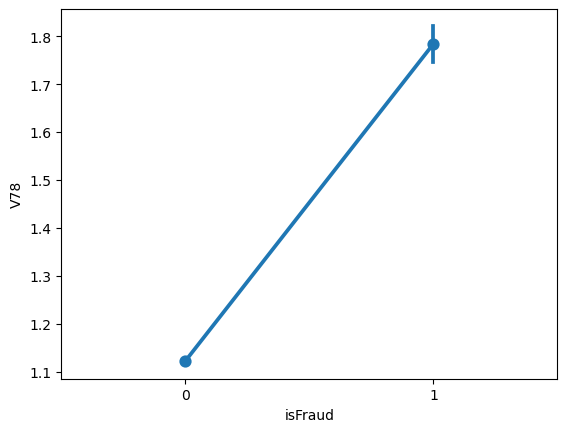

Nilai t-test : 107.73818206034444
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 95
Hubungan label dengan kolom V79


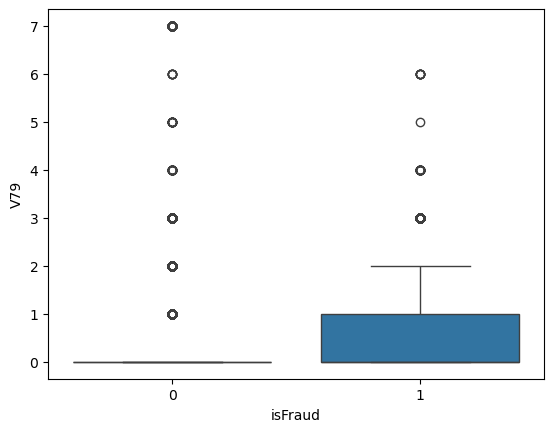

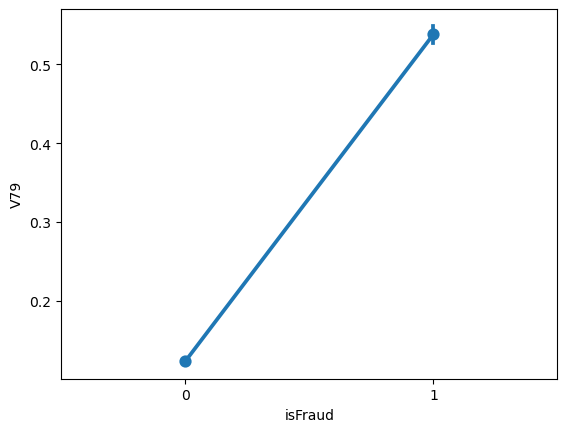

Nilai t-test : 140.13309127045633
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 96
Hubungan label dengan kolom V80


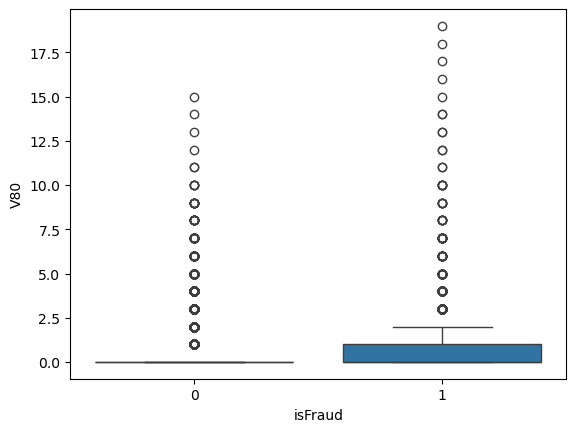

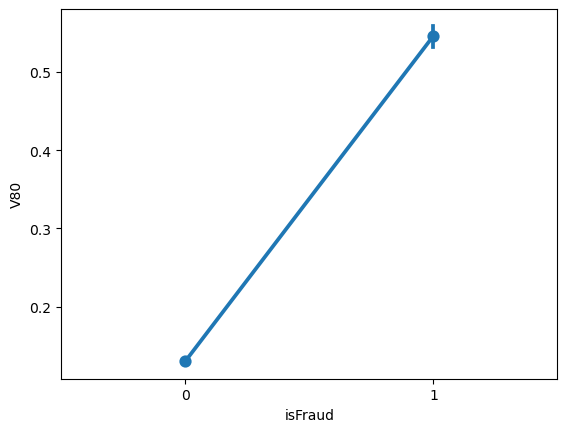

Nilai t-test : 129.79311212438333
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 97
Hubungan label dengan kolom V81


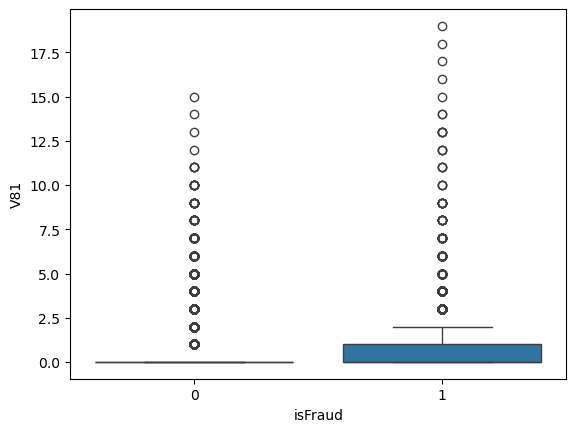

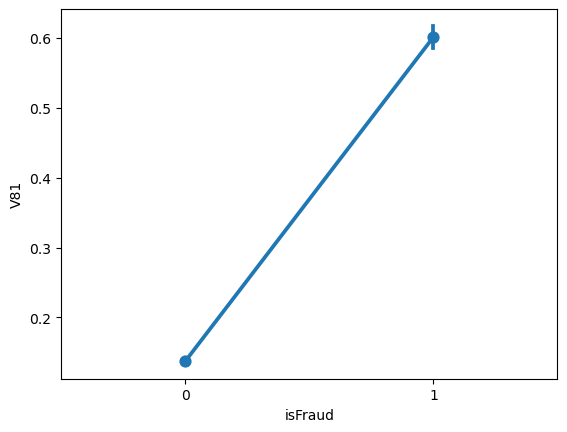

Nilai t-test : 131.34000020148707
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 98
Hubungan label dengan kolom V82


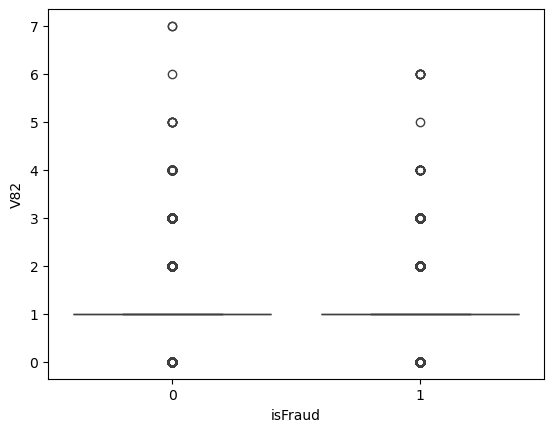

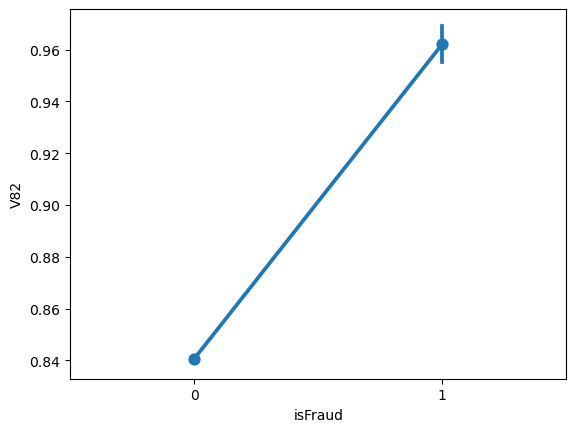

Nilai t-test : 36.240528429712896
Nilai pvalue t-test : 3.310717253961092e-287
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 99
Hubungan label dengan kolom V83


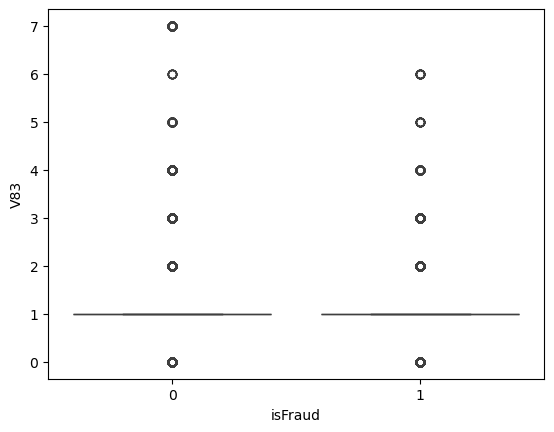

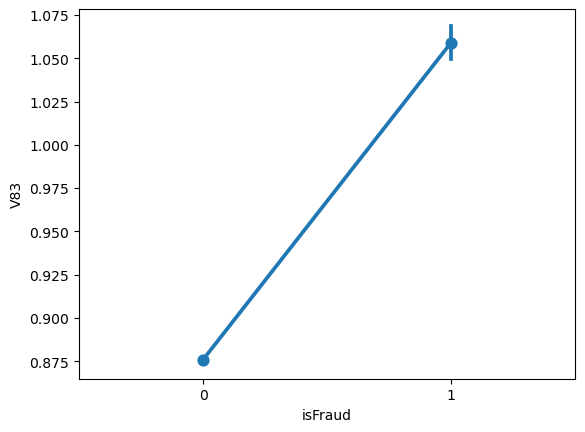

Nilai t-test : 49.084428616948365
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 100
Hubungan label dengan kolom V84


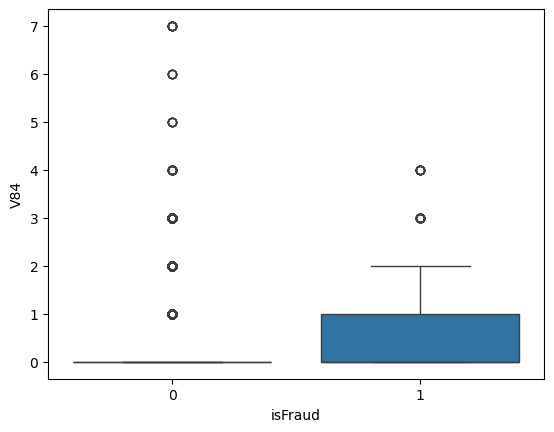

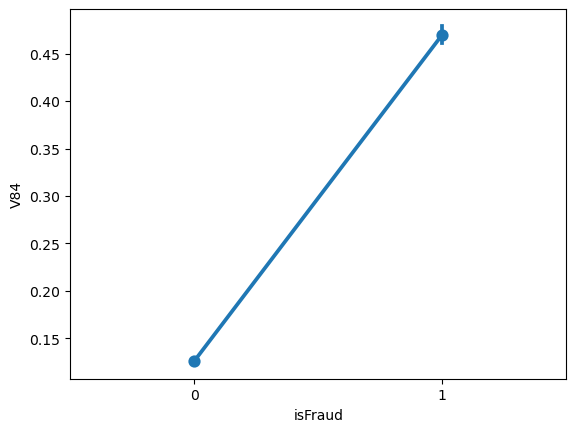

Nilai t-test : 121.49297325704791
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 101
Hubungan label dengan kolom V85


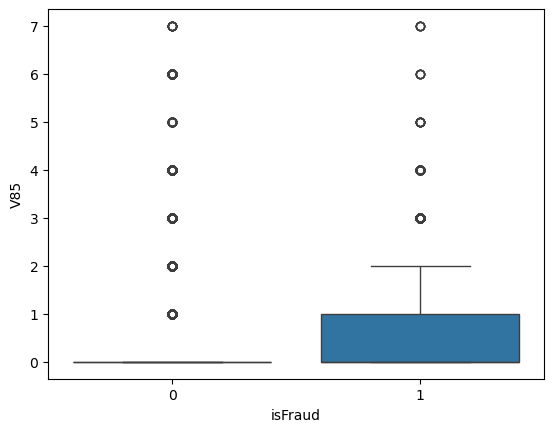

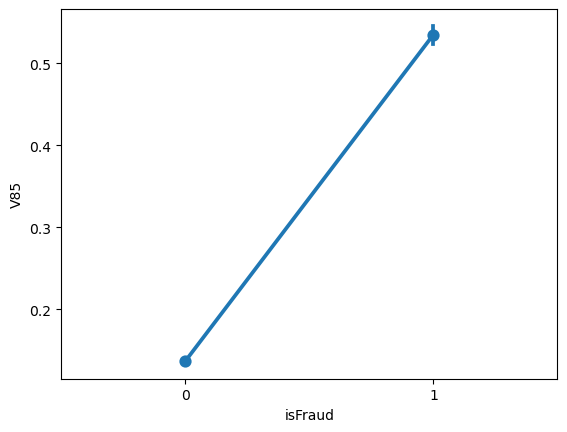

Nilai t-test : 121.2930877828107
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 102
Hubungan label dengan kolom V86


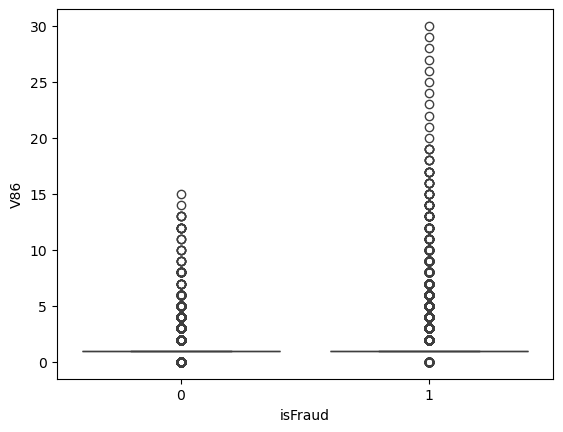

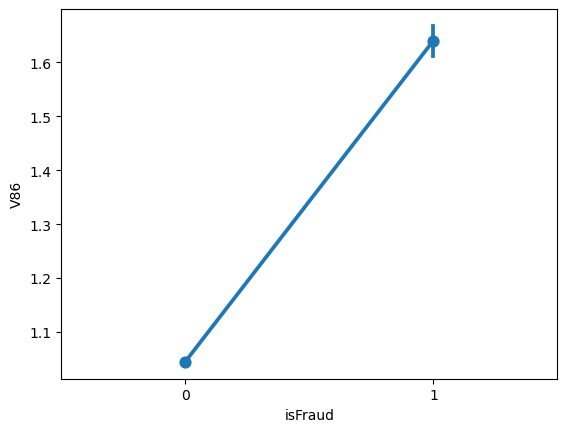

Nilai t-test : 184.2518425815609
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 103
Hubungan label dengan kolom V87


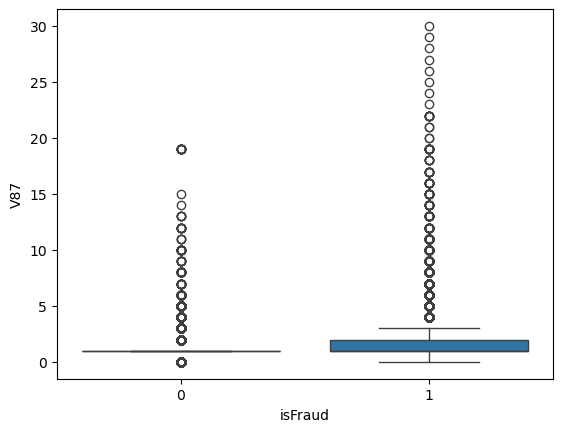

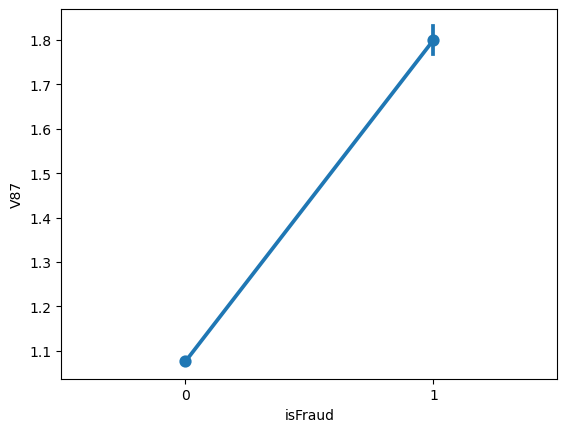

Nilai t-test : 184.18111210834206
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 104
Hubungan label dengan kolom V88


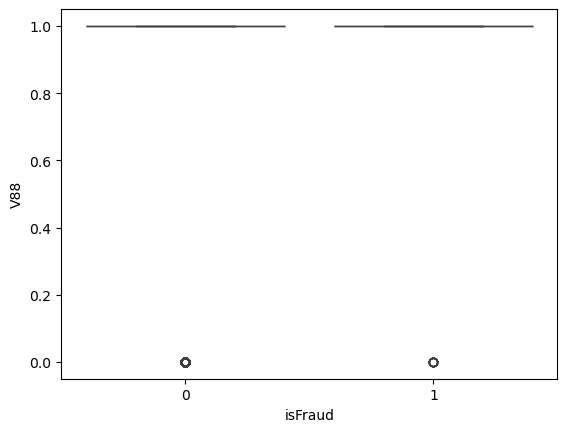

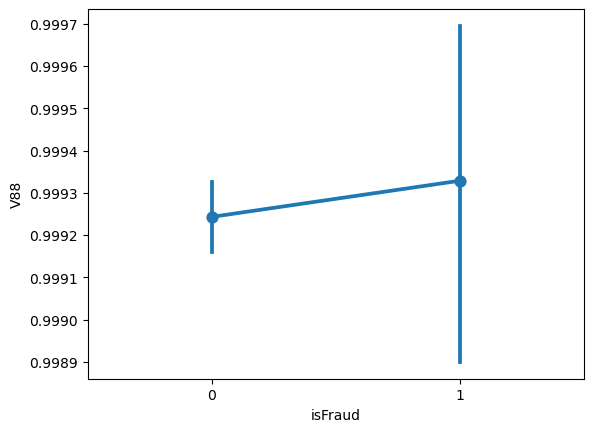

Nilai t-test : 0.3919828884838782
Nilai pvalue t-test : 0.6950710237637021
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 105
Hubungan label dengan kolom V89


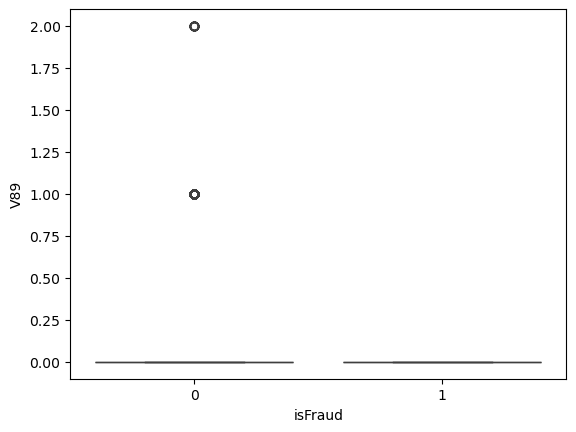

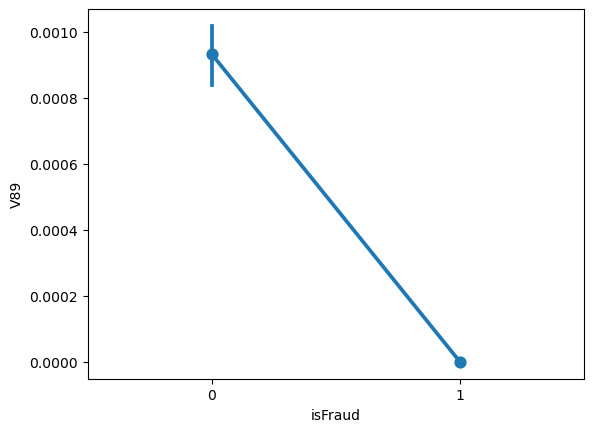

Nilai t-test : -3.673373639092952
Nilai pvalue t-test : 0.00023939395419882826
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 106
Hubungan label dengan kolom V90


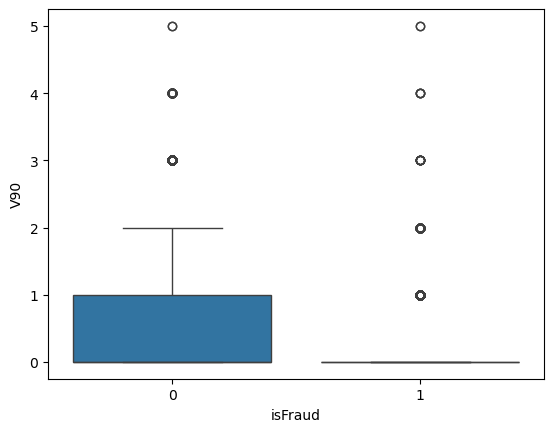

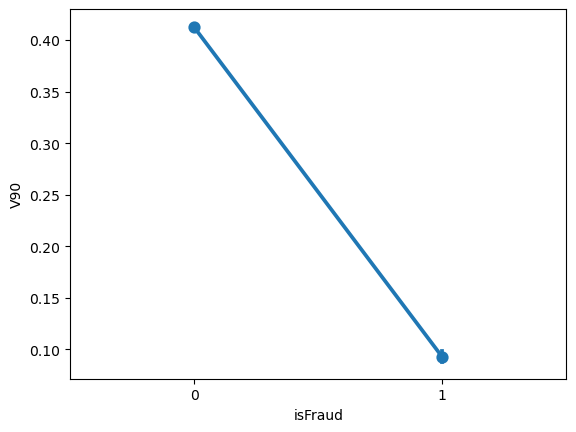

Nilai t-test : -78.48526358448636
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 107
Hubungan label dengan kolom V91


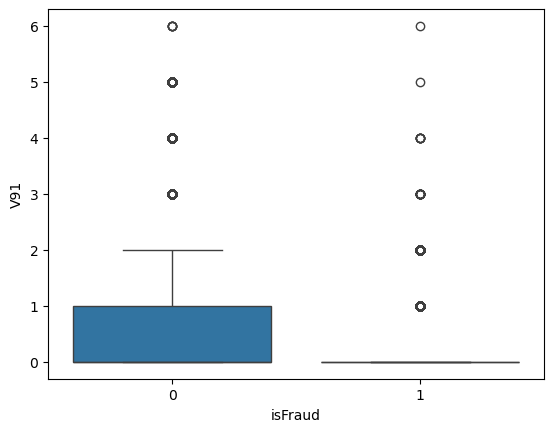

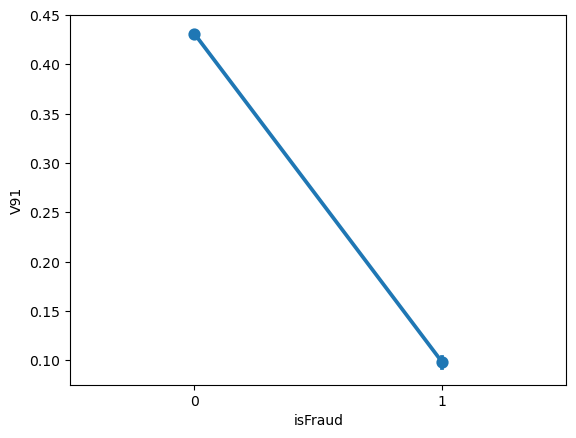

Nilai t-test : -75.0875945253266
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 108
Hubungan label dengan kolom V92


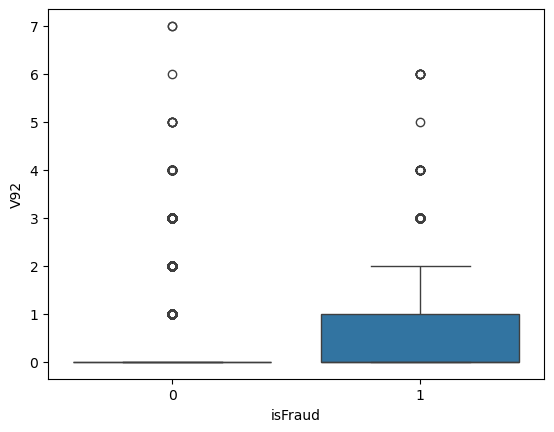

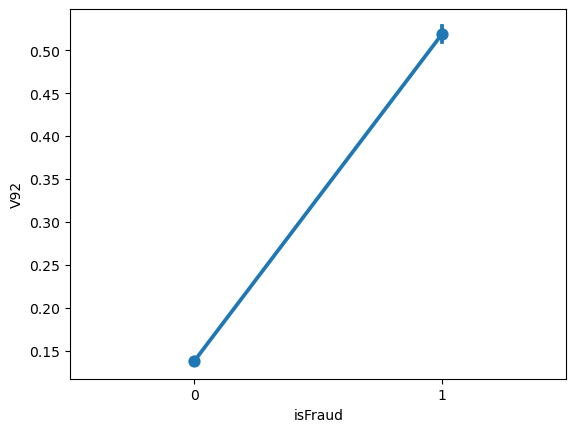

Nilai t-test : 129.95209871422557
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 109
Hubungan label dengan kolom V93


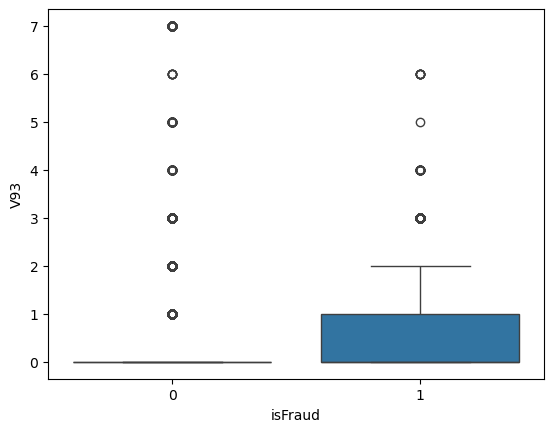

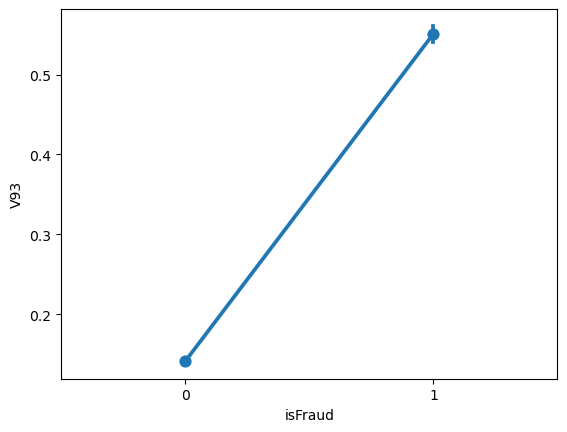

Nilai t-test : 130.3019138708813
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 110
Hubungan label dengan kolom V94


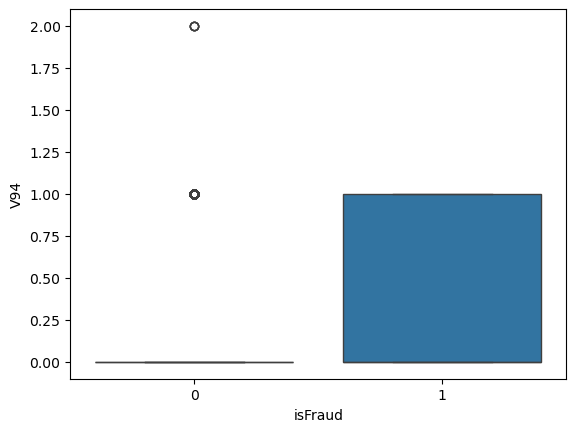

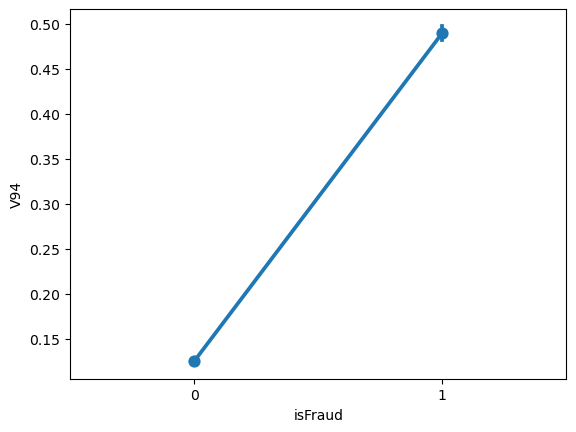

Nilai t-test : 135.83960774989293
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 111
Hubungan label dengan kolom V95


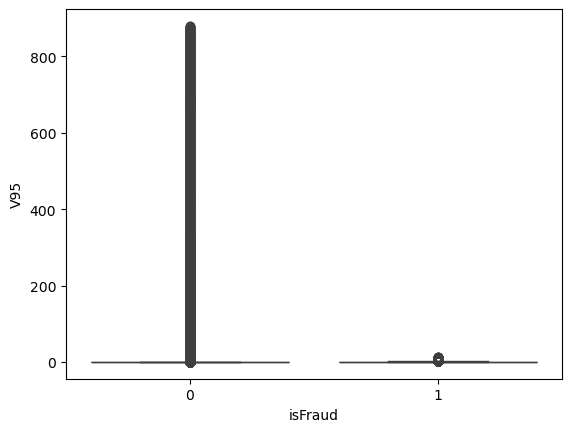

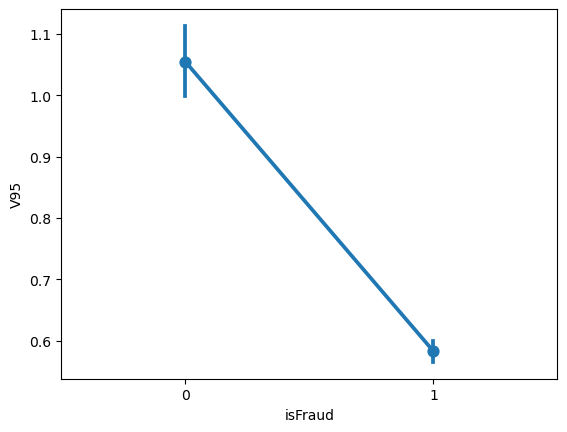

Nilai t-test : -3.1650152374684373
Nilai pvalue t-test : 0.0015508270178884685
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 112
Hubungan label dengan kolom V96


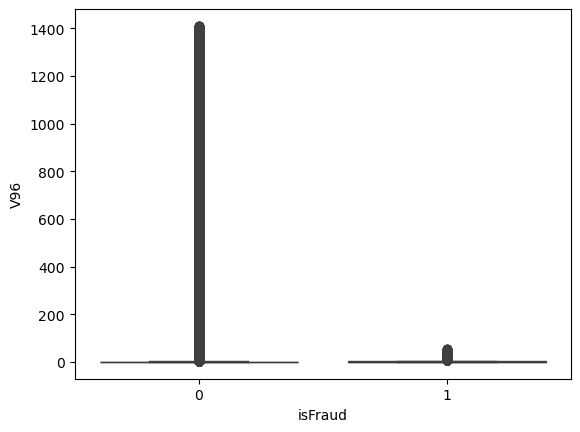

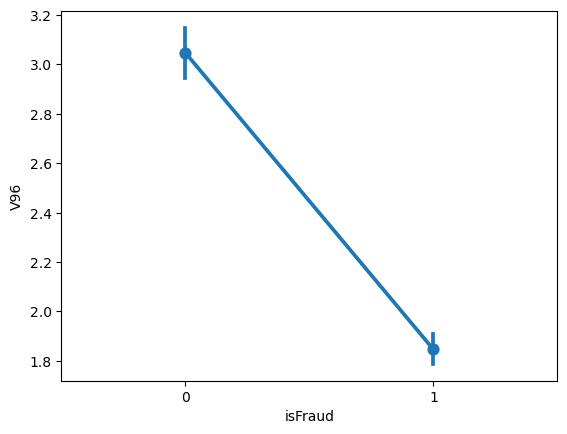

Nilai t-test : -4.213559468302742
Nilai pvalue t-test : 2.5141463296819337e-05
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 113
Hubungan label dengan kolom V97


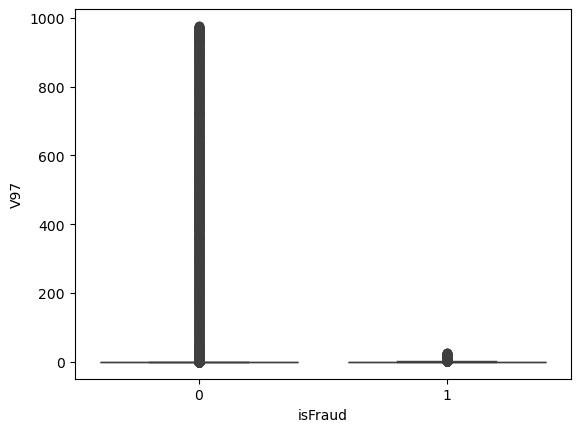

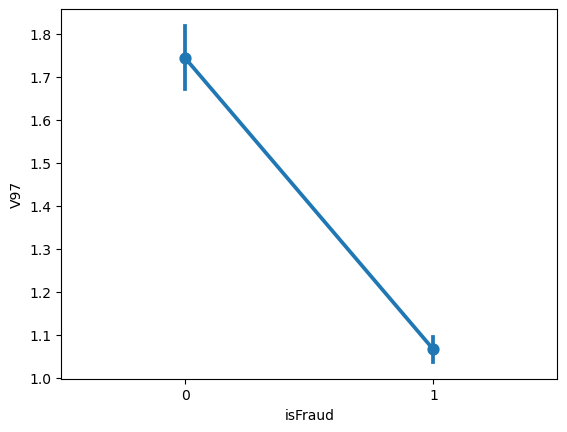

Nilai t-test : -3.4499577806595045
Nilai pvalue t-test : 0.0005607133889658256
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 114
Hubungan label dengan kolom V98


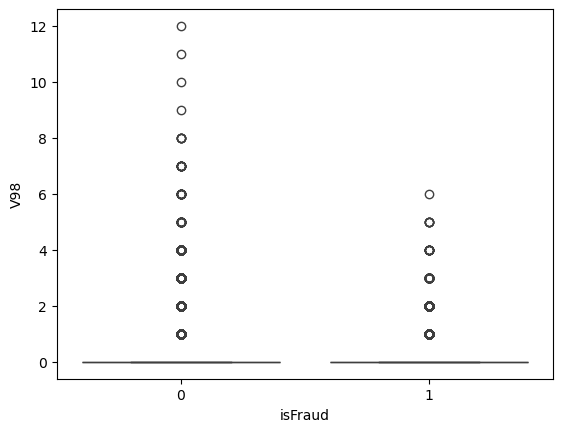

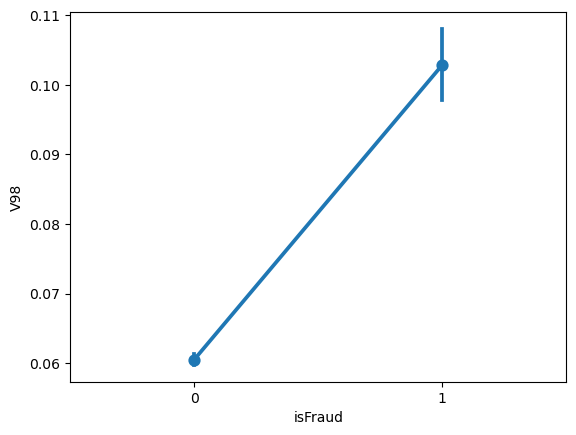

Nilai t-test : 20.995028560751987
Nilai pvalue t-test : 7.909178215567789e-98
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 115
Hubungan label dengan kolom V99


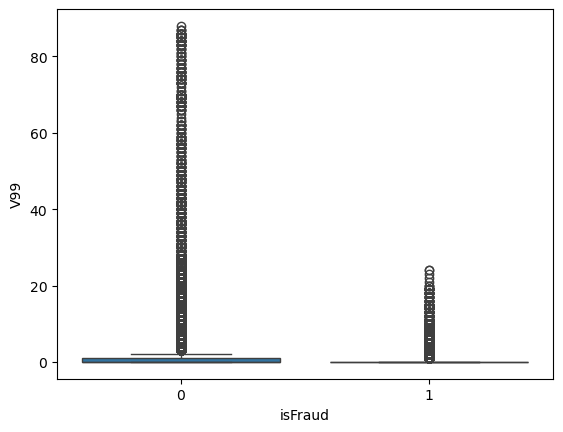

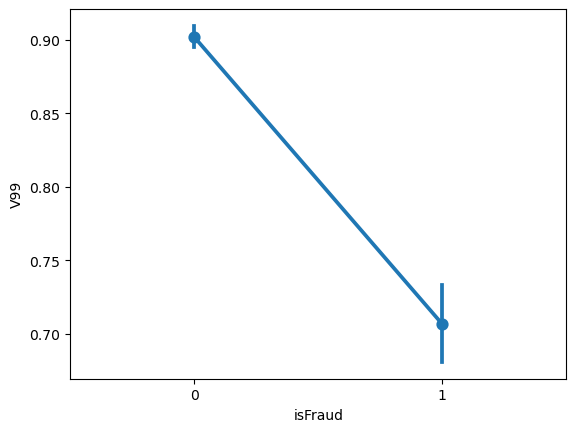

Nilai t-test : -10.12564970231638
Nilai pvalue t-test : 4.270796977048124e-24
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 116
Hubungan label dengan kolom V100


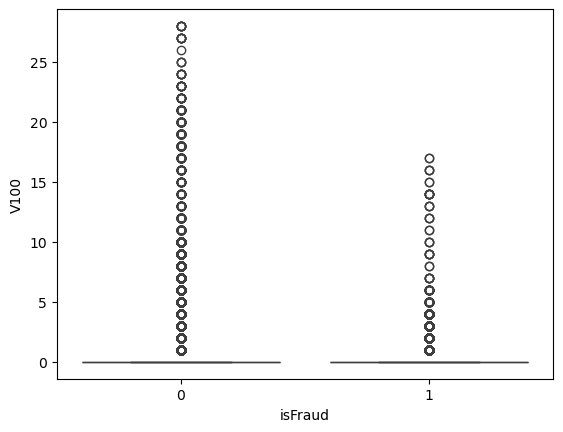

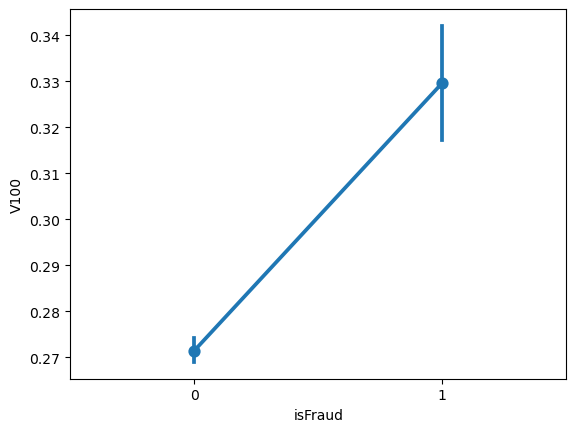

Nilai t-test : 8.671312473395608
Nilai pvalue t-test : 4.2821889369920365e-18
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 117
Hubungan label dengan kolom V101


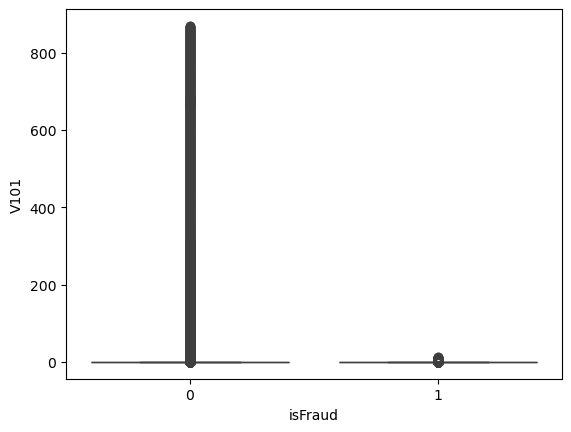

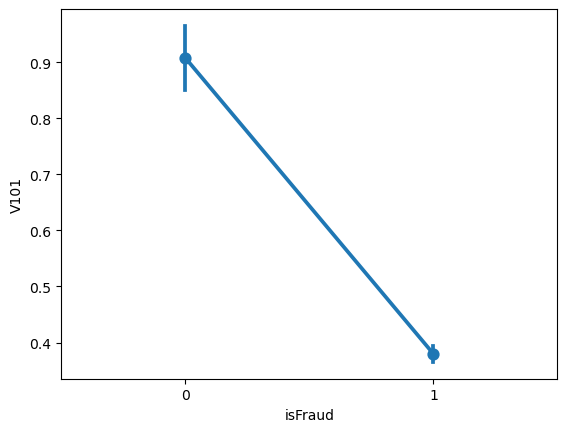

Nilai t-test : -3.6201675644092774
Nilai pvalue t-test : 0.00029443690366832823
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 118
Hubungan label dengan kolom V102


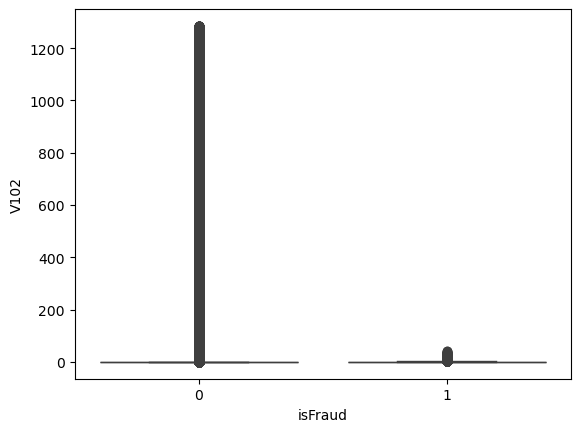

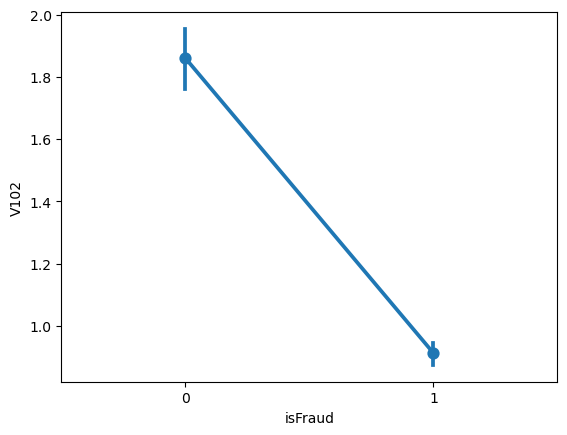

Nilai t-test : -3.7242794841873716
Nilai pvalue t-test : 0.00019589204889147838
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 119
Hubungan label dengan kolom V103


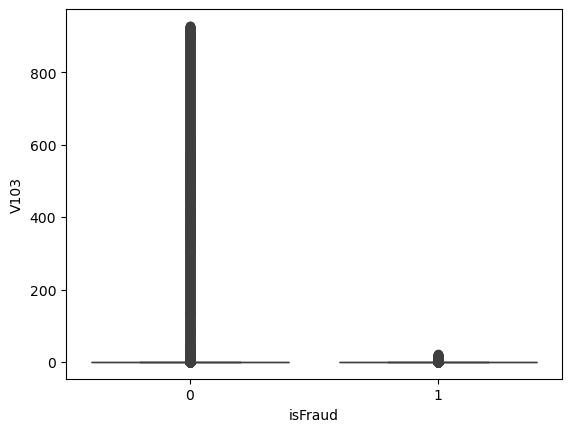

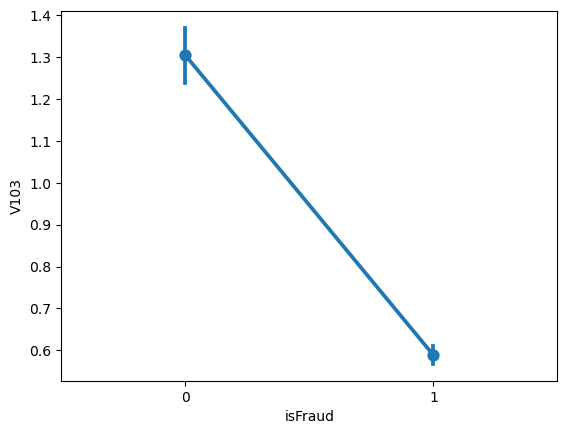

Nilai t-test : -3.9340970051680815
Nilai pvalue t-test : 8.351959920201138e-05
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 120
Hubungan label dengan kolom V104


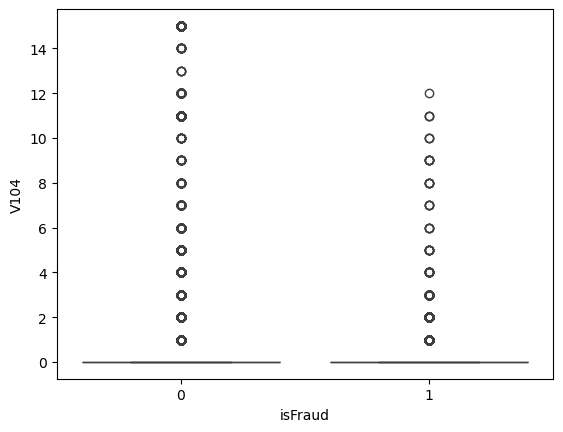

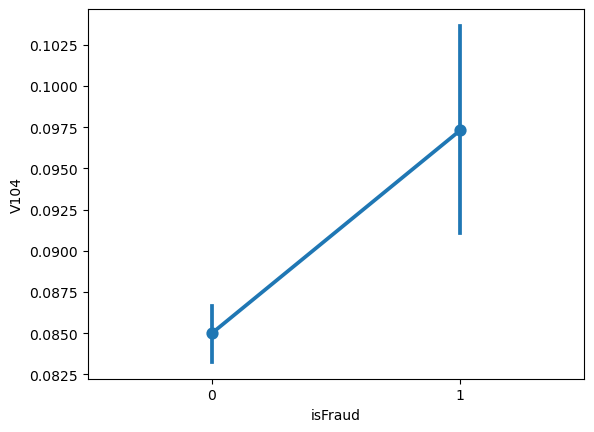

Nilai t-test : 2.6771893673013247
Nilai pvalue t-test : 0.007424471276162119
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 121
Hubungan label dengan kolom V105


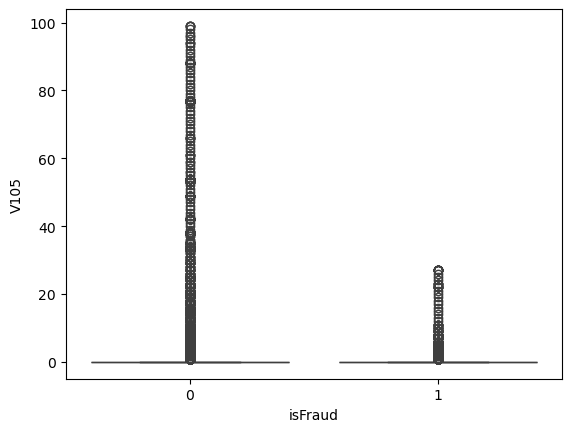

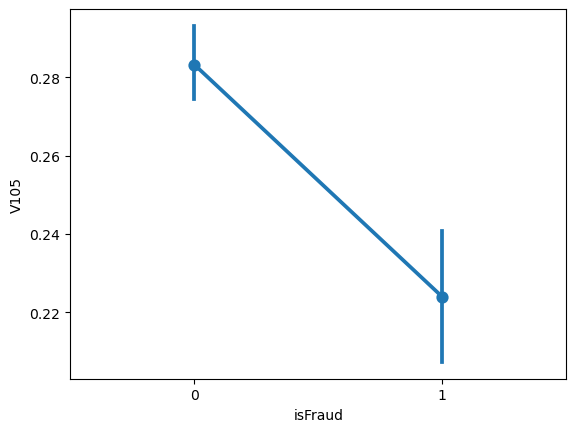

Nilai t-test : -2.480944993881459
Nilai pvalue t-test : 0.013103735613467076
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 122
Hubungan label dengan kolom V106


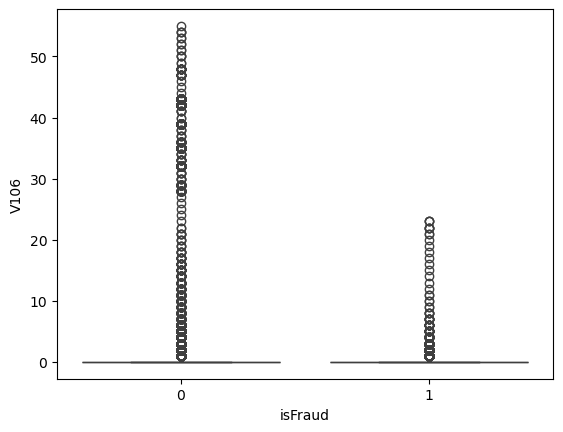

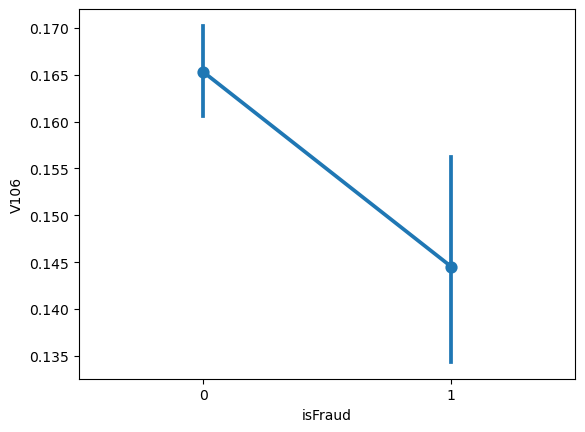

Nilai t-test : -1.6065855374597295
Nilai pvalue t-test : 0.10814585212211322
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 123
Hubungan label dengan kolom V107


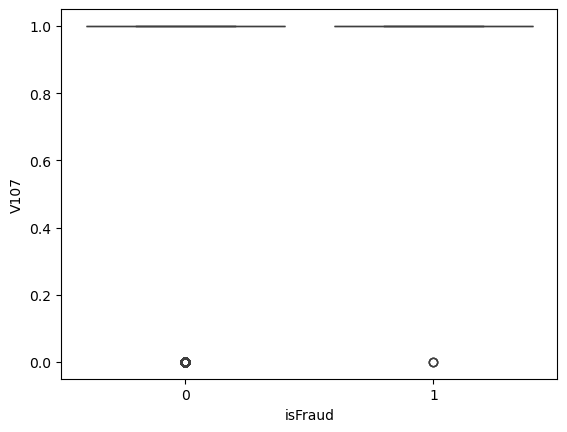

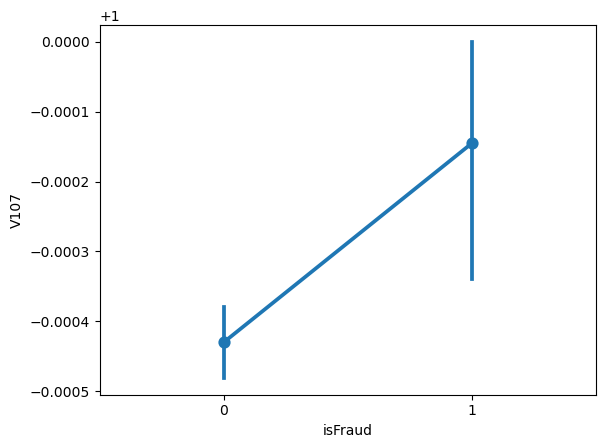

Nilai t-test : 1.9617996113263898
Nilai pvalue t-test : 0.04978628822710329
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 124
Hubungan label dengan kolom V108


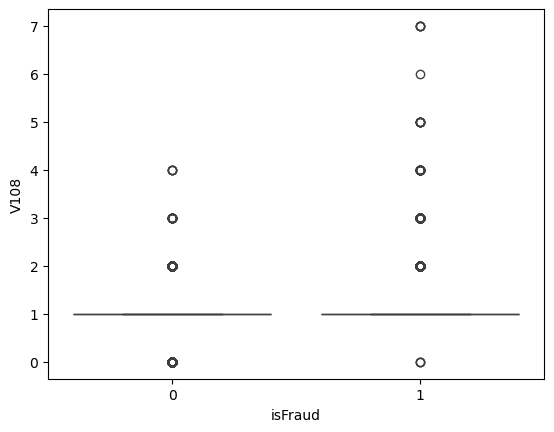

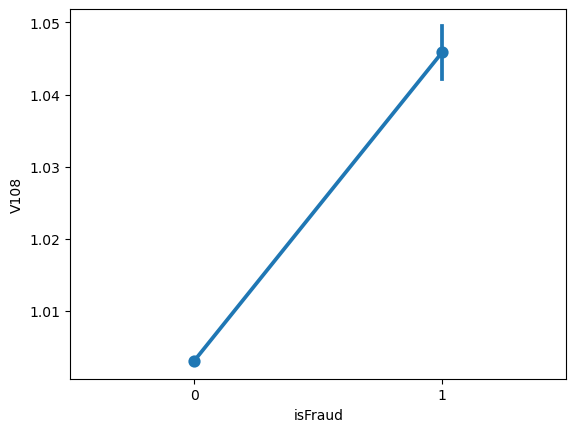

Nilai t-test : 74.71410906885357
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 125
Hubungan label dengan kolom V109


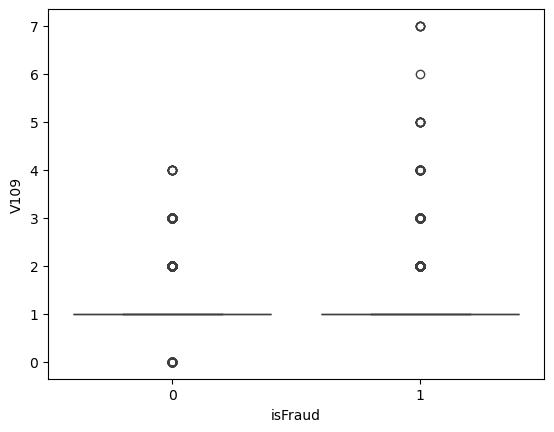

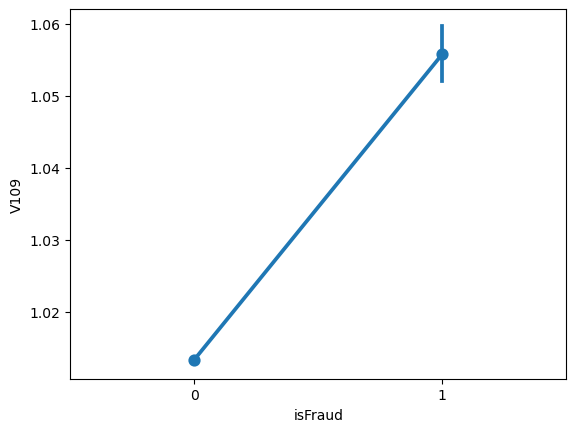

Nilai t-test : 46.94668247712391
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 126
Hubungan label dengan kolom V110


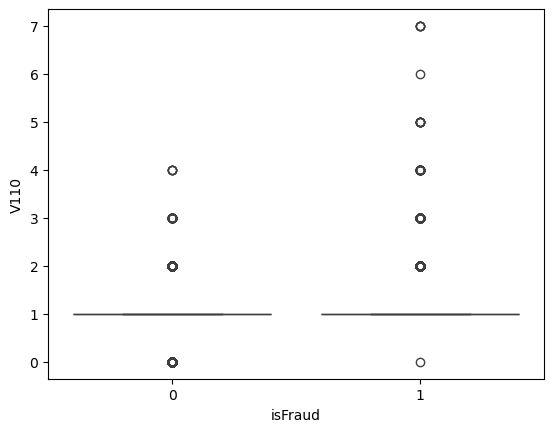

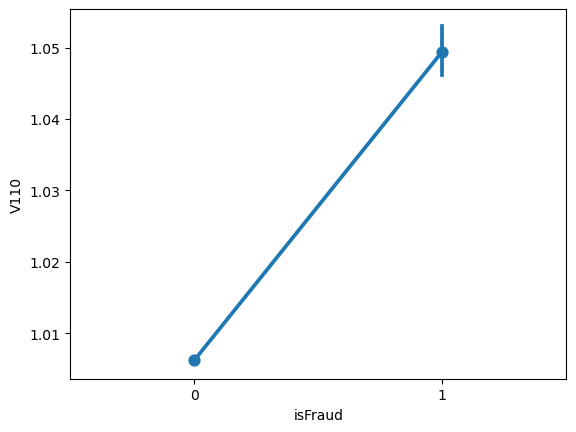

Nilai t-test : 62.92288521815321
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 127
Hubungan label dengan kolom V111


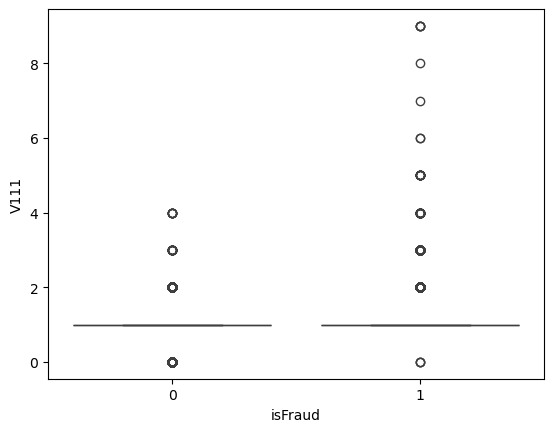

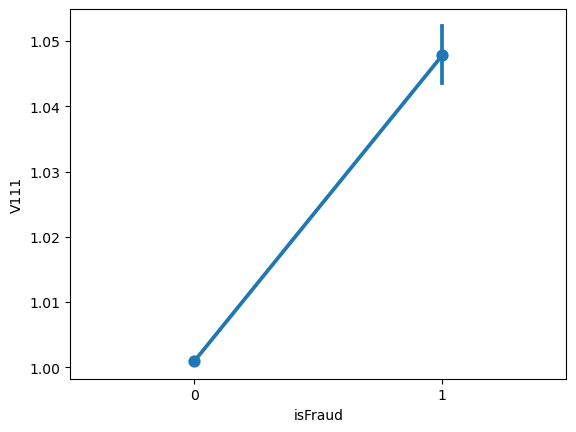

Nilai t-test : 94.12641130156851
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 128
Hubungan label dengan kolom V112


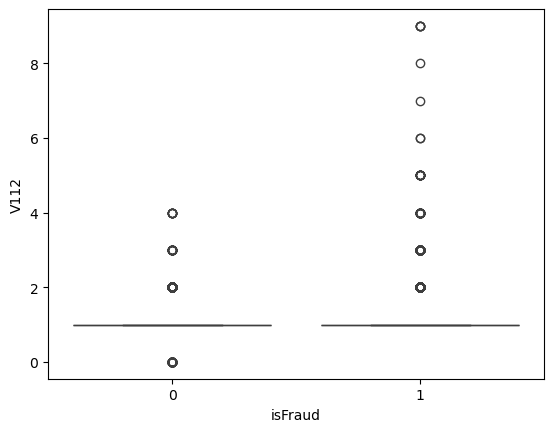

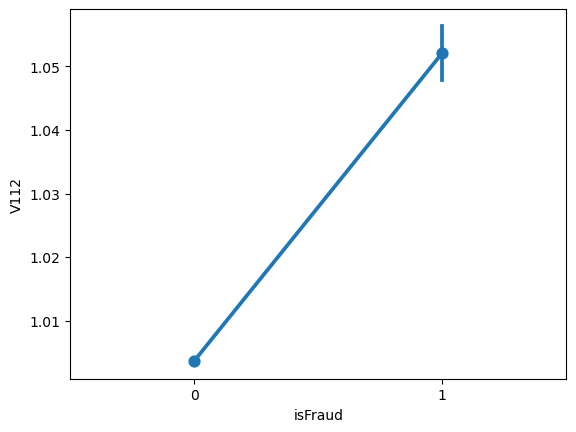

Nilai t-test : 81.28141481673873
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 129
Hubungan label dengan kolom V113


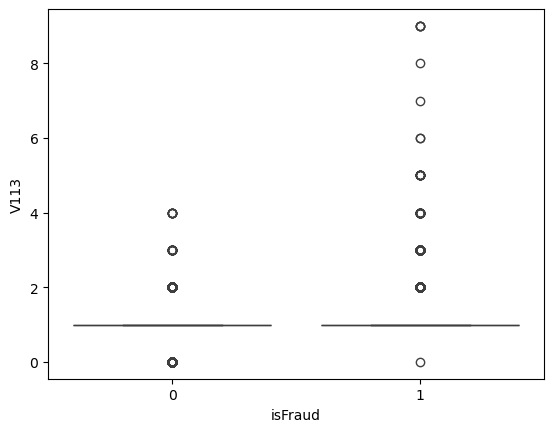

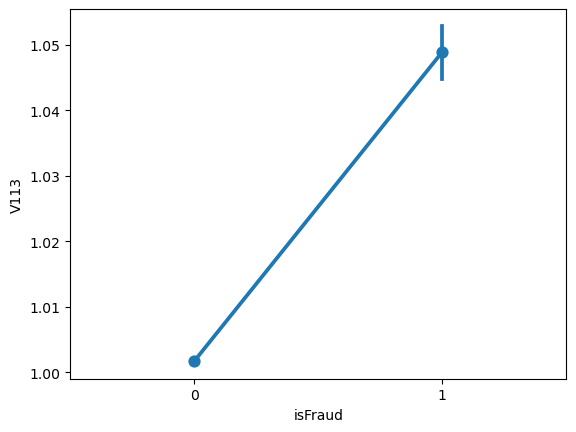

Nilai t-test : 89.70495780116362
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 130
Hubungan label dengan kolom V114


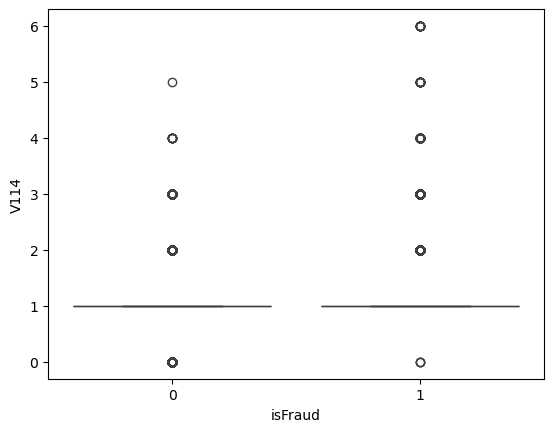

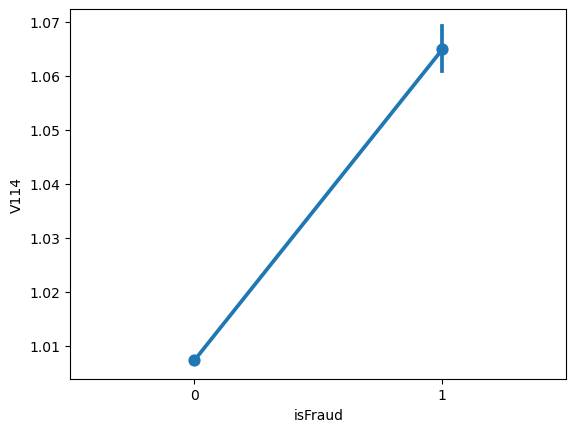

Nilai t-test : 74.16221206041706
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 131
Hubungan label dengan kolom V115


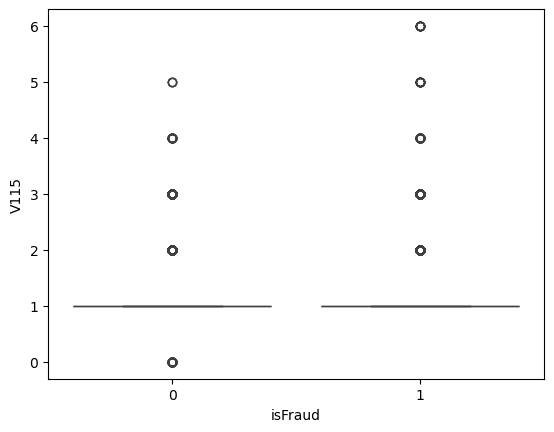

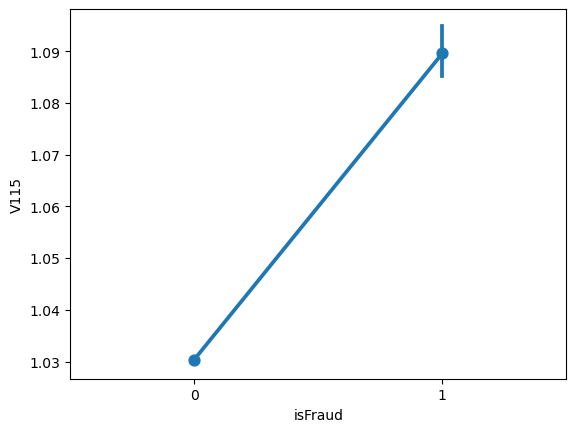

Nilai t-test : 43.9456922803968
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 132
Hubungan label dengan kolom V116


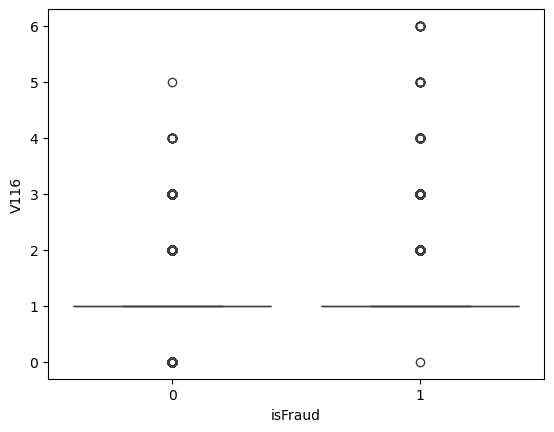

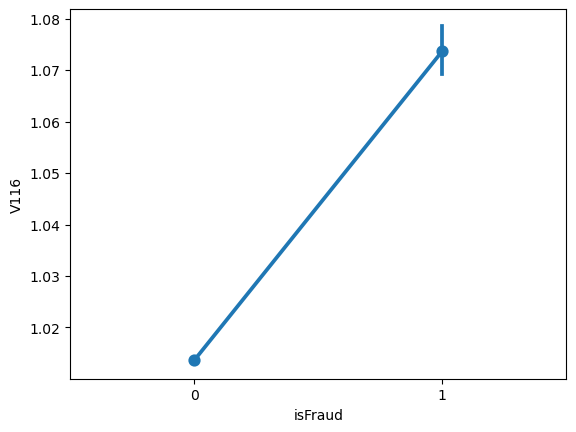

Nilai t-test : 62.15786850409593
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 133
Hubungan label dengan kolom V117


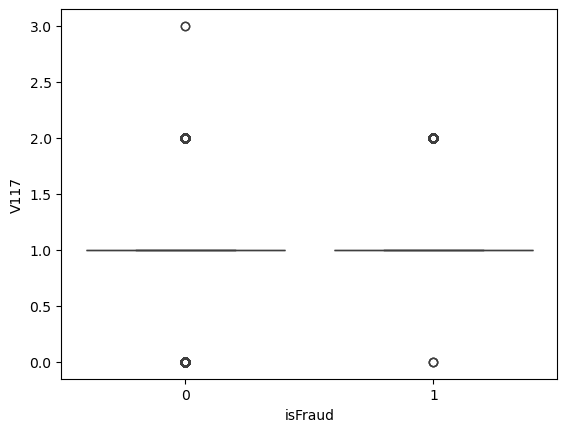

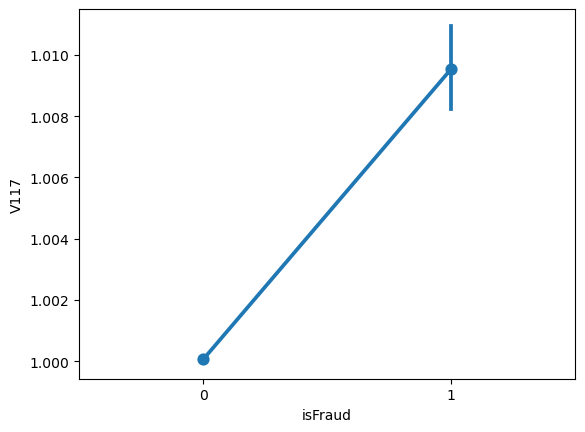

Nilai t-test : 38.028187255903134
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 134
Hubungan label dengan kolom V118


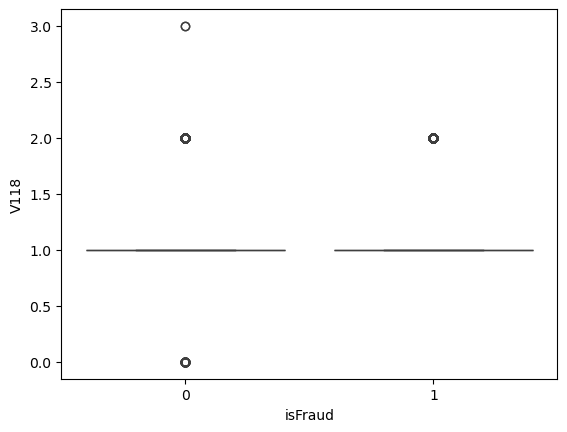

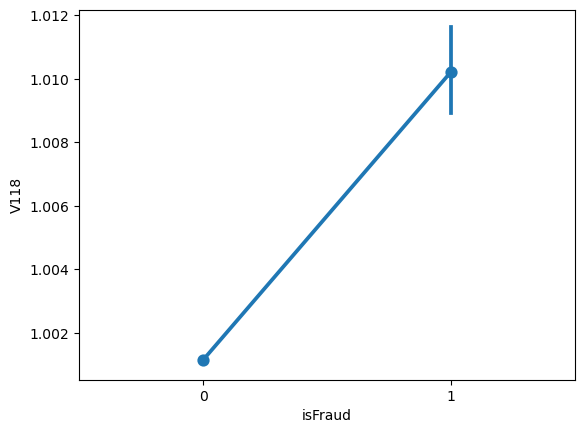

Nilai t-test : 31.218166008844012
Nilai pvalue t-test : 9.035263423545383e-214
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 135
Hubungan label dengan kolom V119


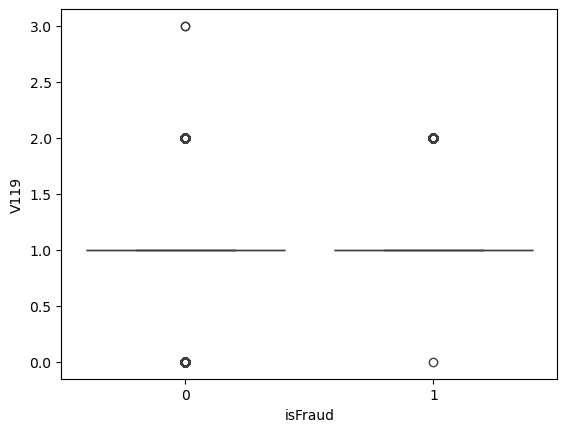

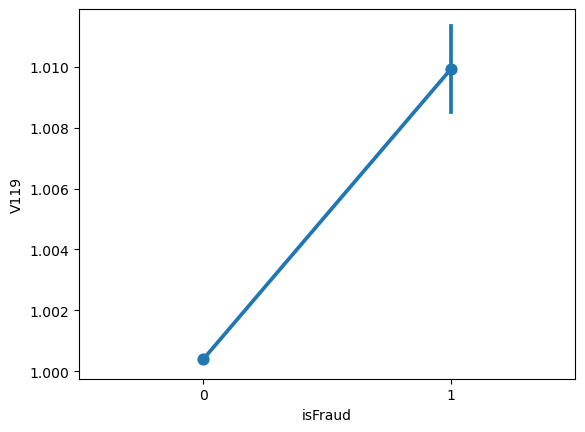

Nilai t-test : 37.022755494210045
Nilai pvalue t-test : 1.0924218114588065e-299
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 136
Hubungan label dengan kolom V120


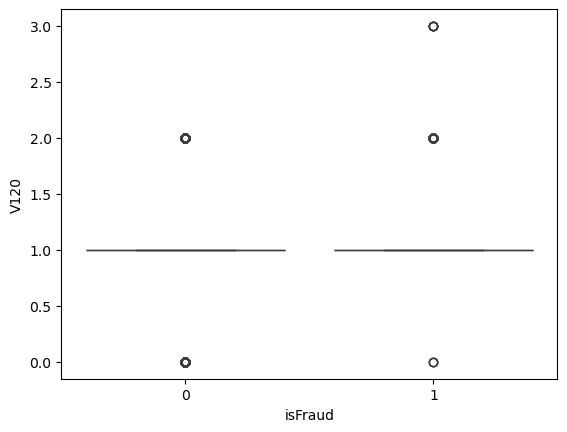

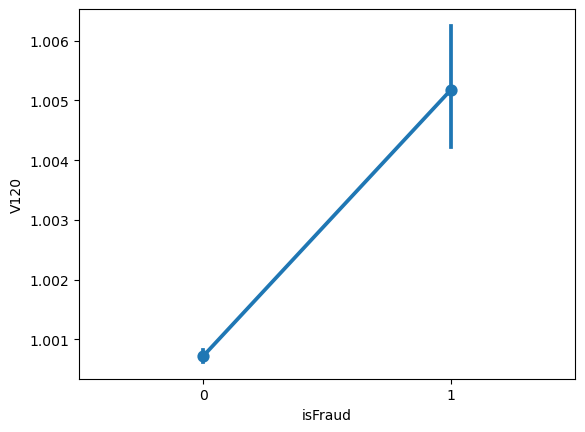

Nilai t-test : 15.12084828306466
Nilai pvalue t-test : 1.2067740627115648e-51
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 137
Hubungan label dengan kolom V121


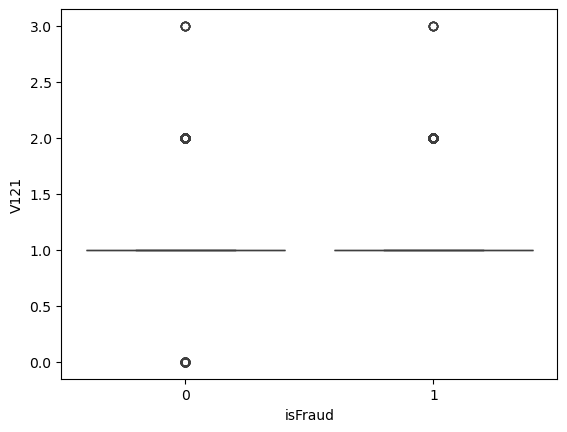

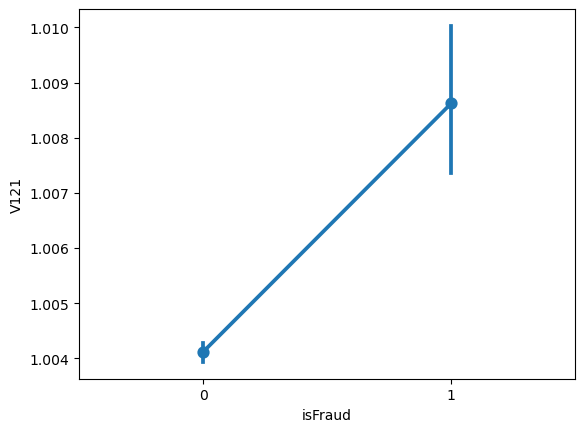

Nilai t-test : 9.473009948837326
Nilai pvalue t-test : 2.7284329703785645e-21
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 138
Hubungan label dengan kolom V122


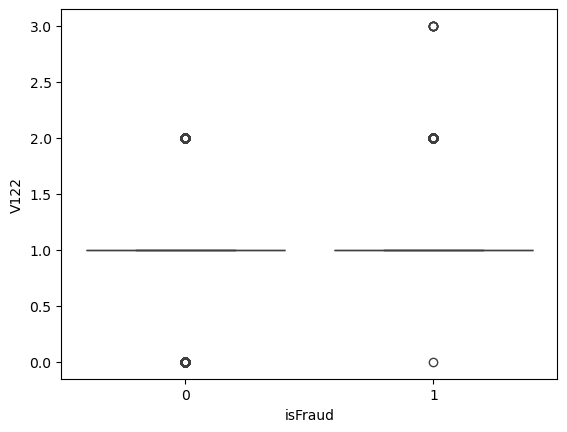

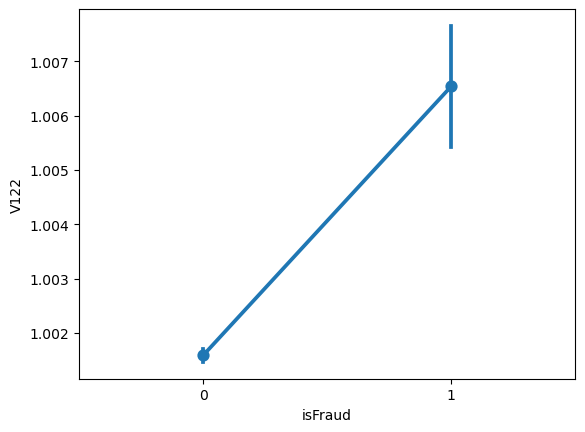

Nilai t-test : 14.378241518998315
Nilai pvalue t-test : 7.217947736350162e-47
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 139
Hubungan label dengan kolom V123


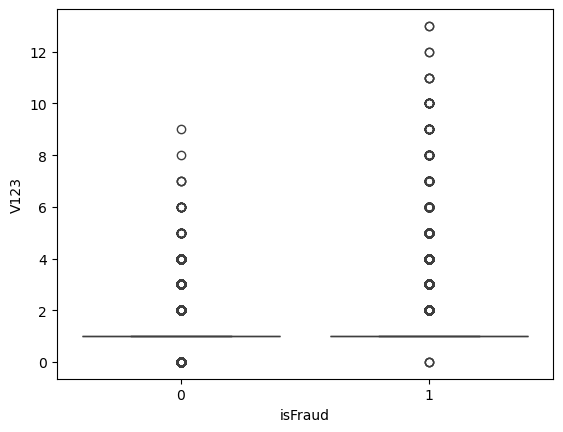

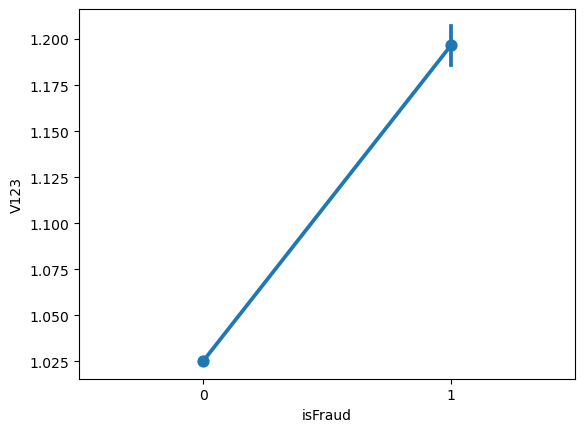

Nilai t-test : 107.21938454574256
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 140
Hubungan label dengan kolom V124


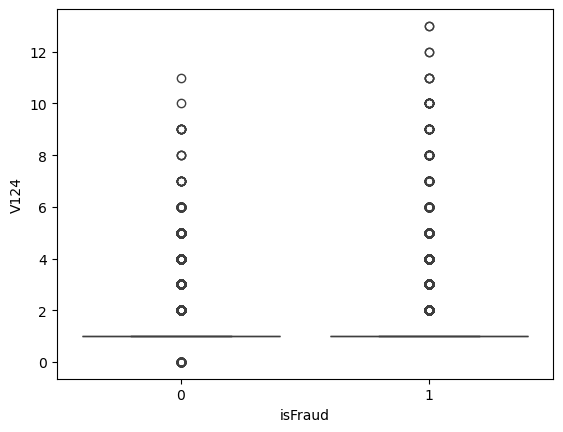

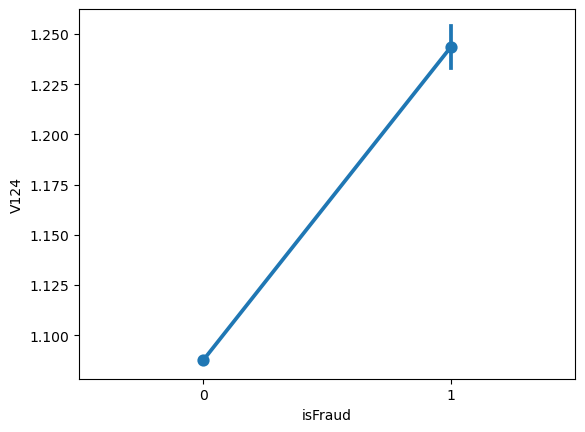

Nilai t-test : 59.116112982286005
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 141
Hubungan label dengan kolom V125


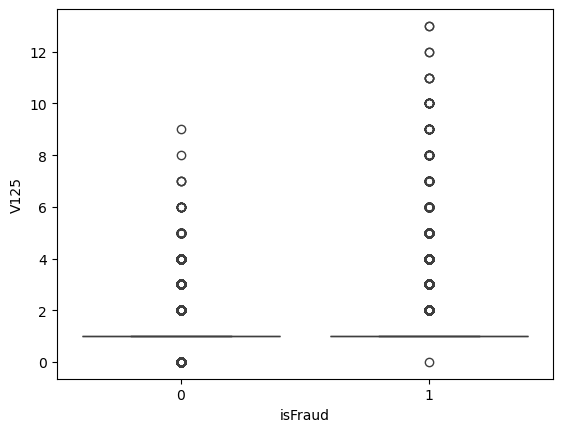

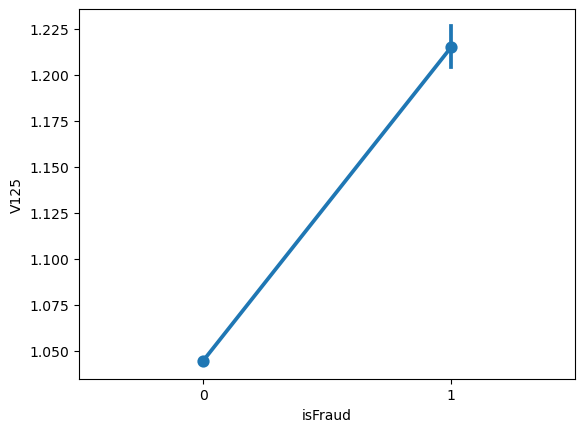

Nilai t-test : 86.5892002500184
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 142
Hubungan label dengan kolom V126


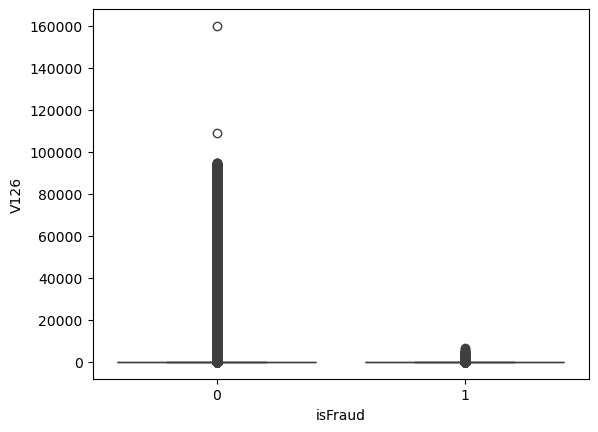

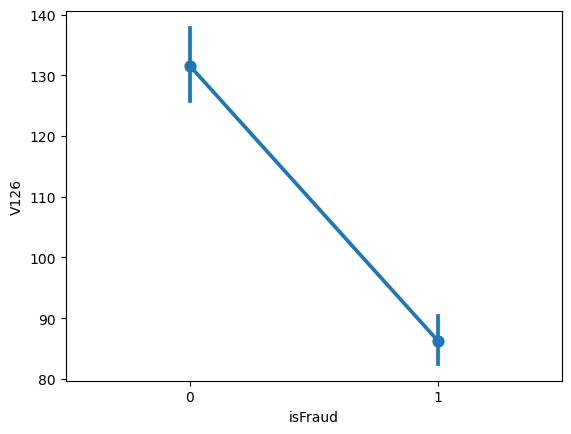

Nilai t-test : -2.7239404640774656
Nilai pvalue t-test : 0.006451003135758751
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 143
Hubungan label dengan kolom V127


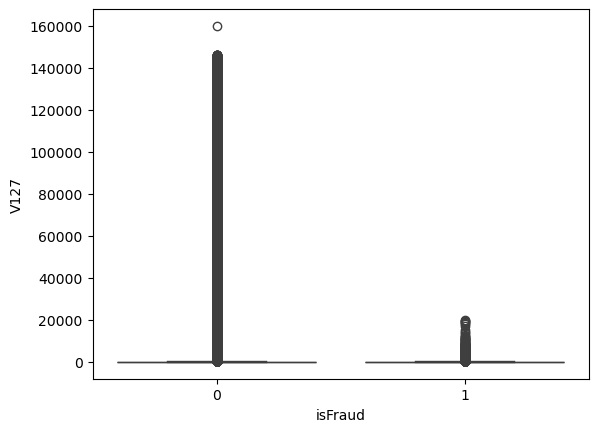

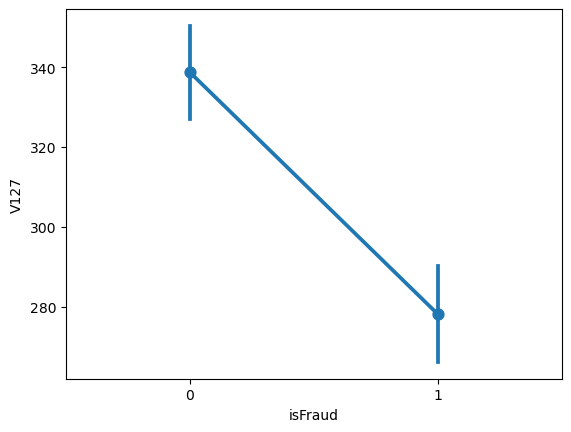

Nilai t-test : -2.0194893347790304
Nilai pvalue t-test : 0.043436835764862396
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 144
Hubungan label dengan kolom V128


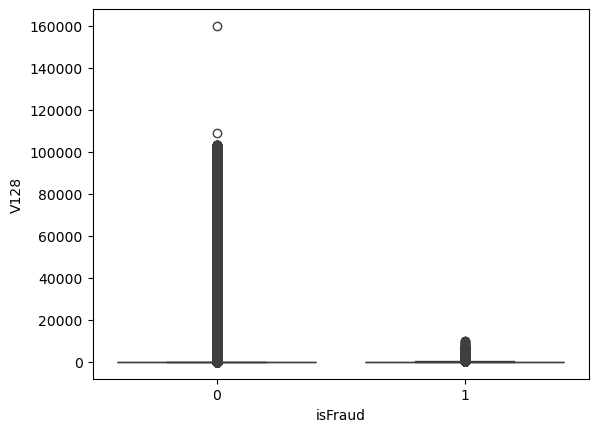

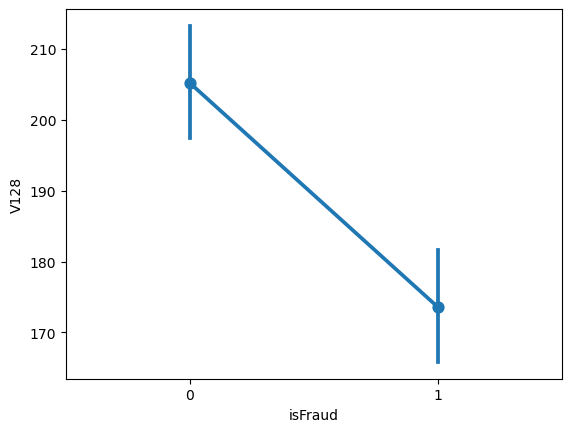

Nilai t-test : -1.482939939156552
Nilai pvalue t-test : 0.13809090280545033
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 145
Hubungan label dengan kolom V129


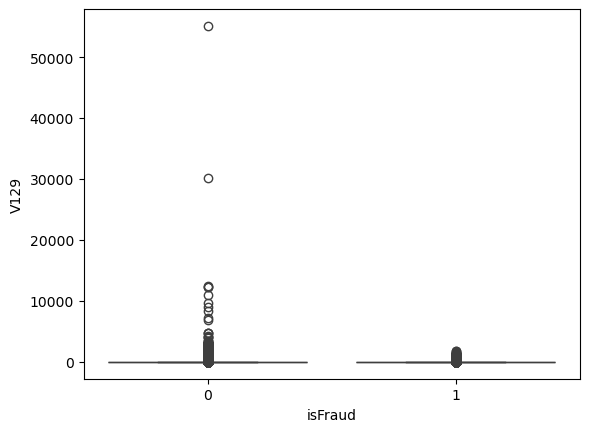

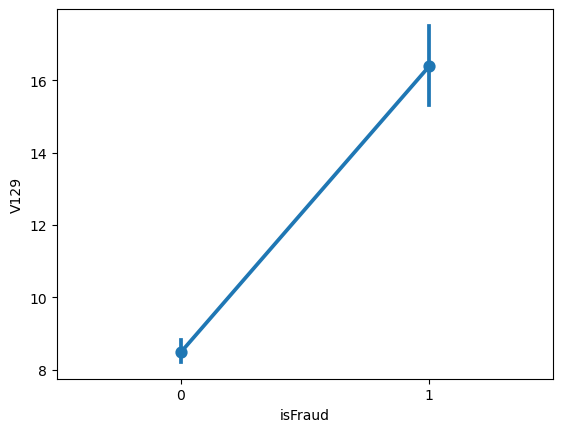

Nilai t-test : 9.78119905574492
Nilai pvalue t-test : 1.3613215244245551e-22
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 146
Hubungan label dengan kolom V130


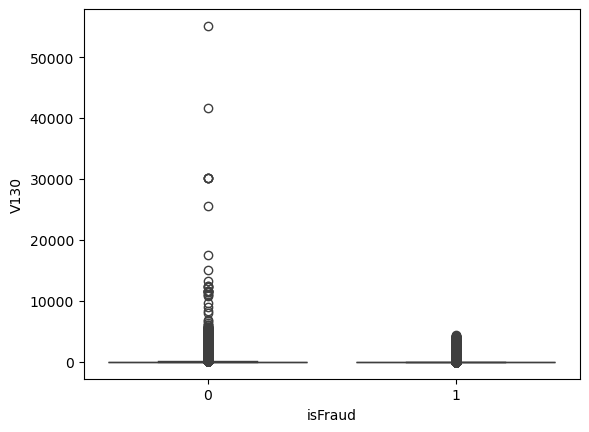

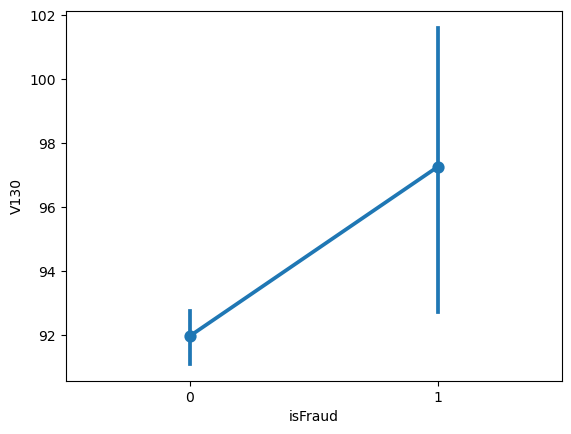

Nilai t-test : 2.363162824378508
Nilai pvalue t-test : 0.01812002888360884
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 147
Hubungan label dengan kolom V131


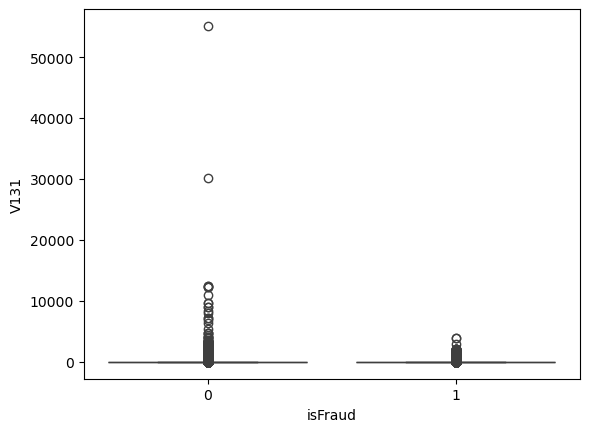

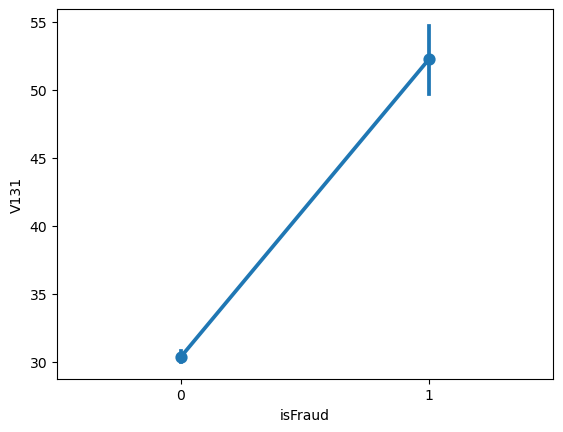

Nilai t-test : 19.193041480892084
Nilai pvalue t-test : 4.482973654569501e-82
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 148
Hubungan label dengan kolom V132


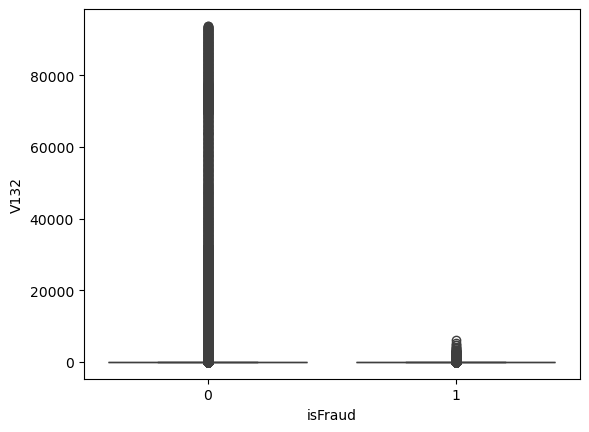

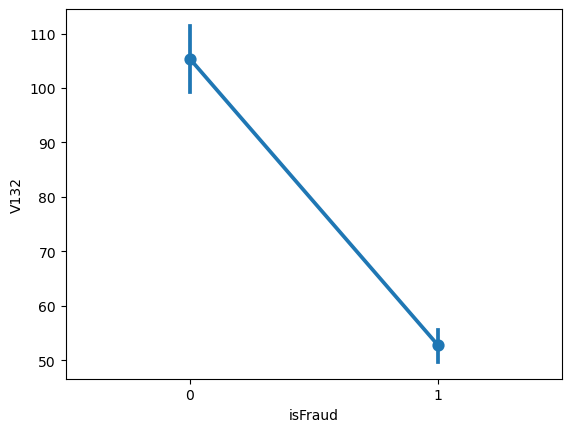

Nilai t-test : -3.275211716540921
Nilai pvalue t-test : 0.0010558889461297293
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 149
Hubungan label dengan kolom V133


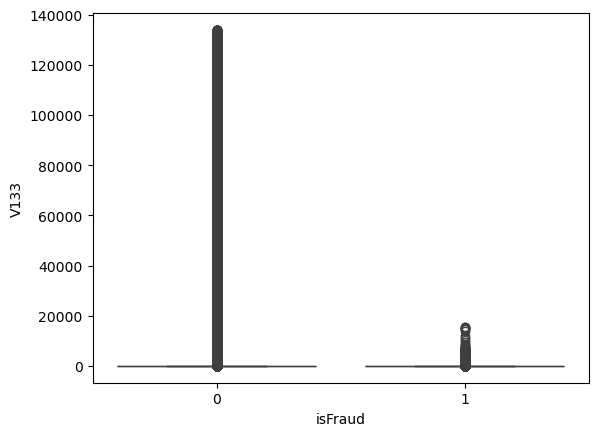

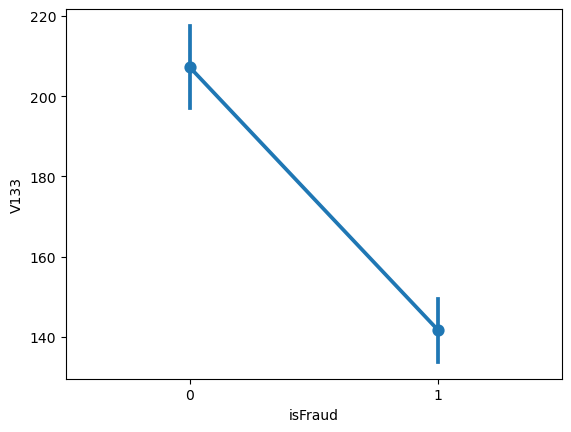

Nilai t-test : -2.431796186295149
Nilai pvalue t-test : 0.015024454244786541
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 150
Hubungan label dengan kolom V134


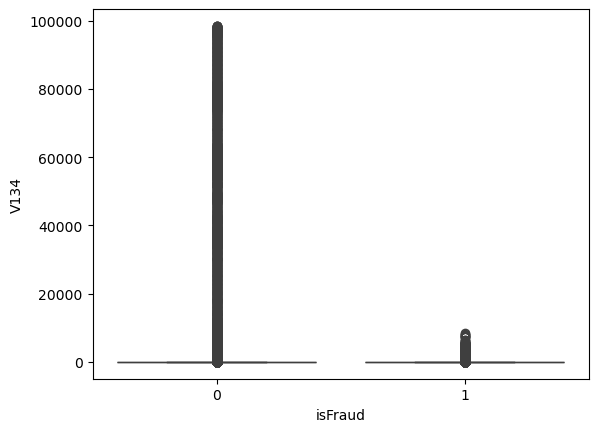

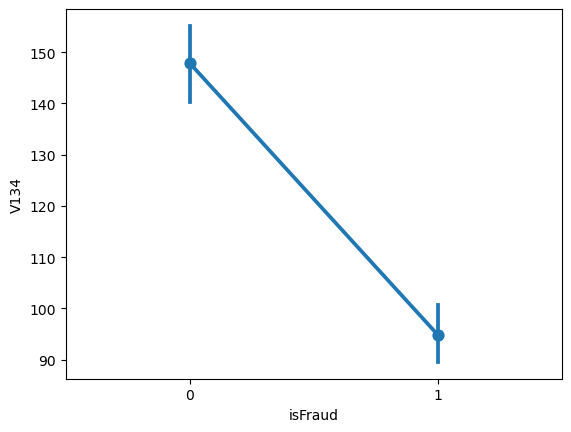

Nilai t-test : -2.6980716467412207
Nilai pvalue t-test : 0.006974441114343316
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 151
Hubungan label dengan kolom V135


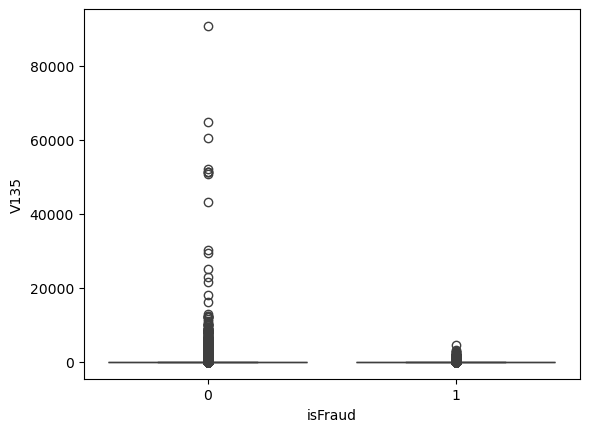

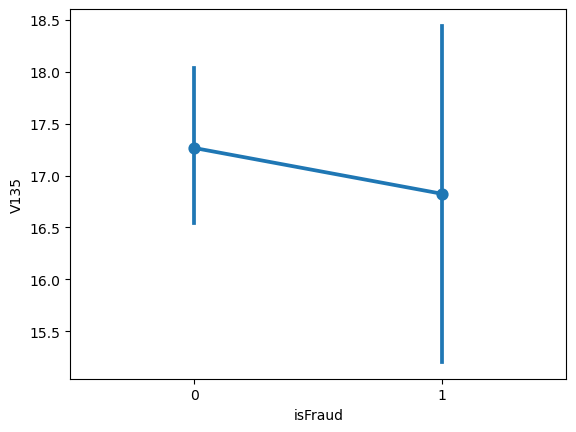

Nilai t-test : -0.21224215238807786
Nilai pvalue t-test : 0.8319181961983304
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 152
Hubungan label dengan kolom V136


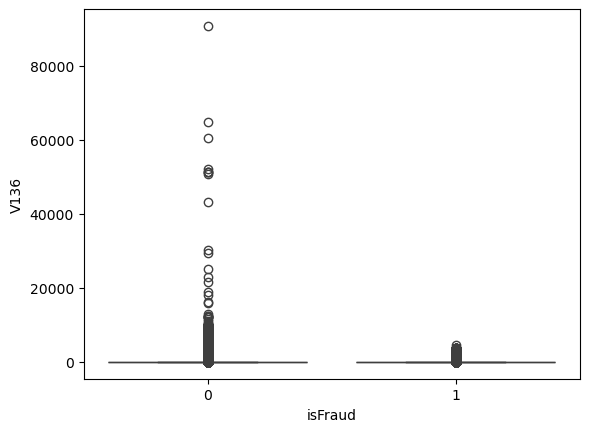

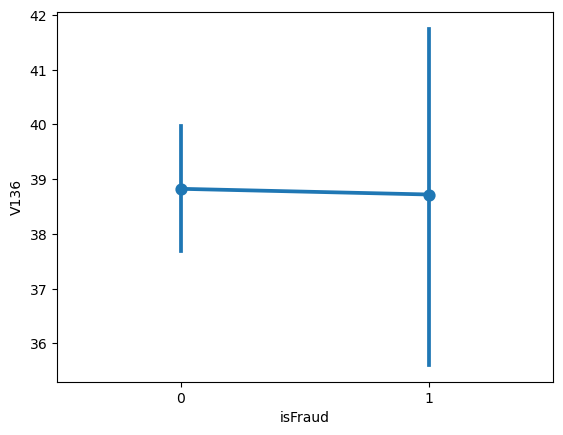

Nilai t-test : -0.0324603958101563
Nilai pvalue t-test : 0.9741049099147445
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 153
Hubungan label dengan kolom V137


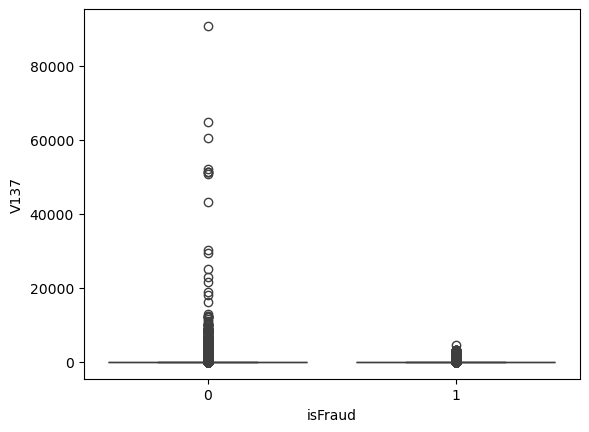

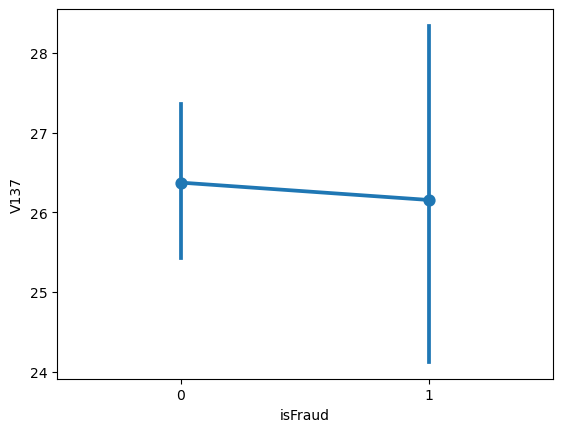

Nilai t-test : -0.08819597161235342
Nilai pvalue t-test : 0.9297209489514715
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 154
Hubungan label dengan kolom V279


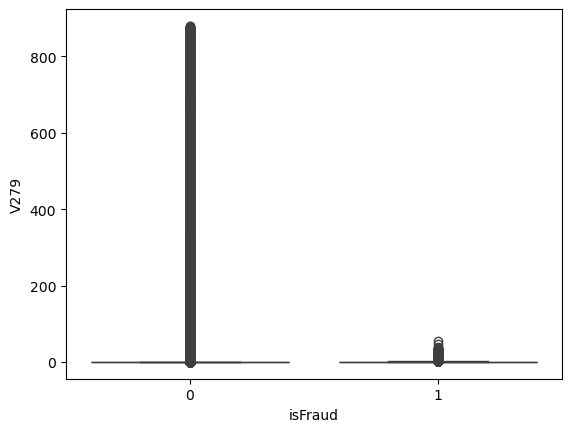

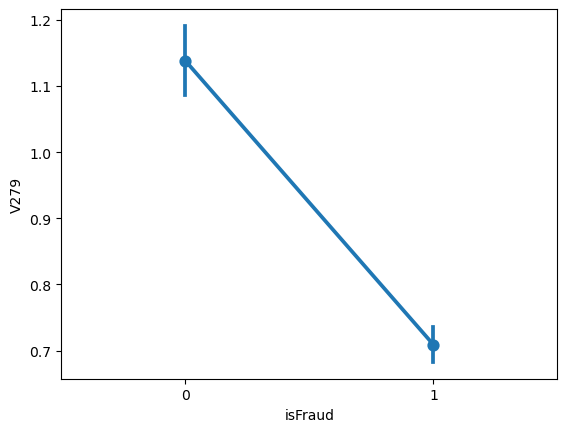

Nilai t-test : -2.8826169353661455
Nilai pvalue t-test : 0.003944009459000083
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 155
Hubungan label dengan kolom V280


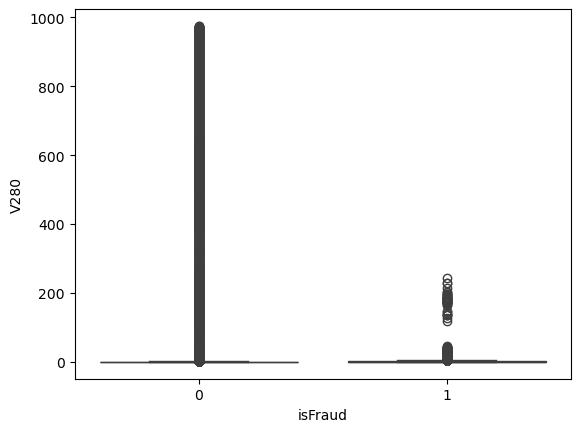

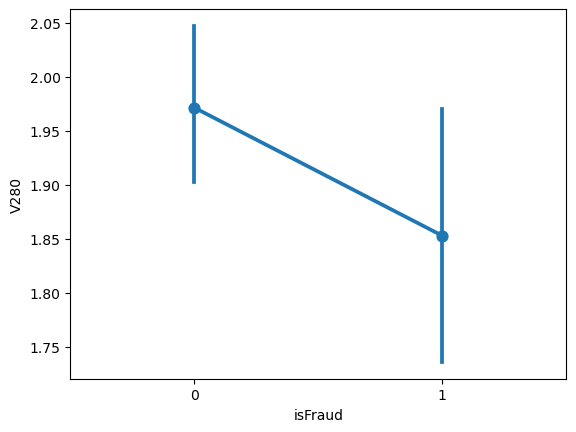

Nilai t-test : -0.6010772426464966
Nilai pvalue t-test : 0.5477887708088363
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 156
Hubungan label dengan kolom V281


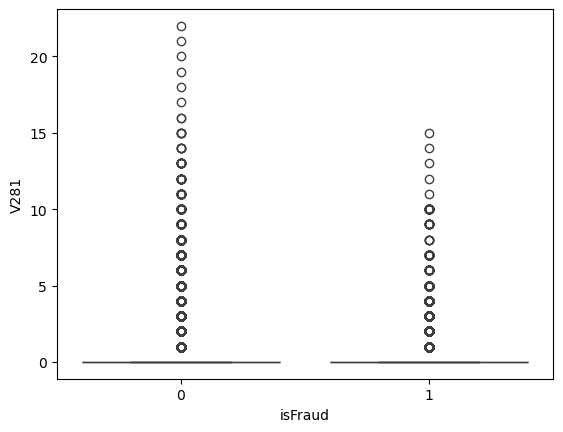

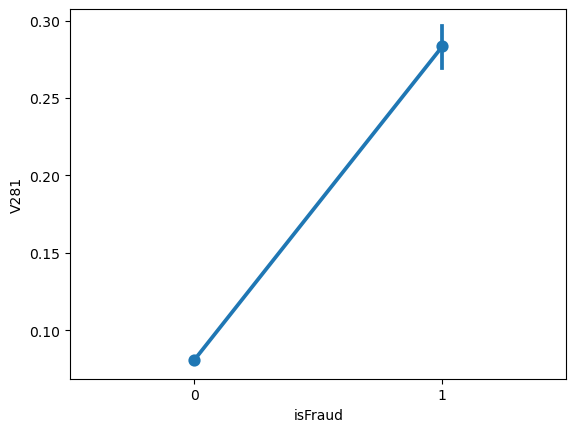

Nilai t-test : 55.89907049931254
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 157
Hubungan label dengan kolom V282


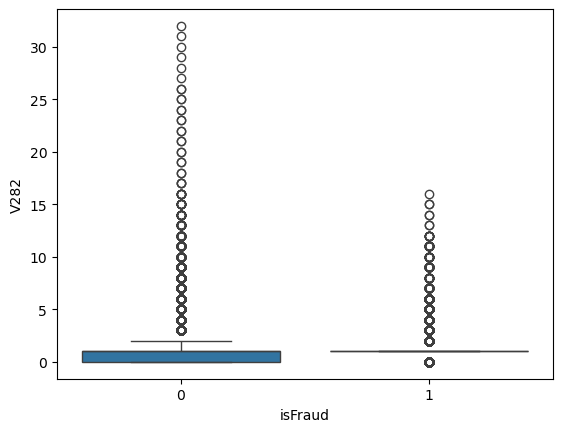

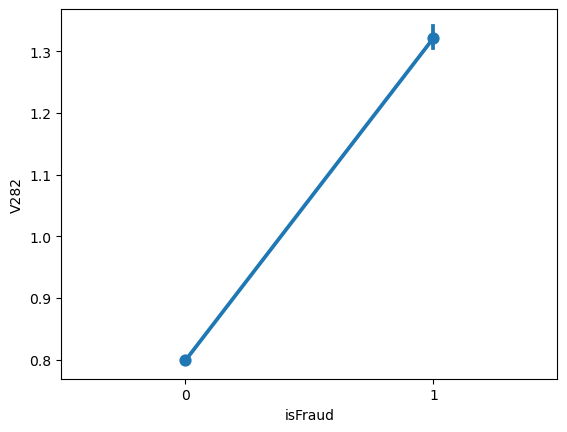

Nilai t-test : 80.36562234083507
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 158
Hubungan label dengan kolom V283


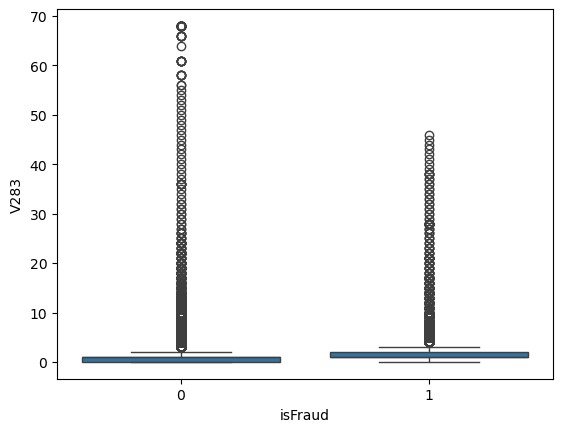

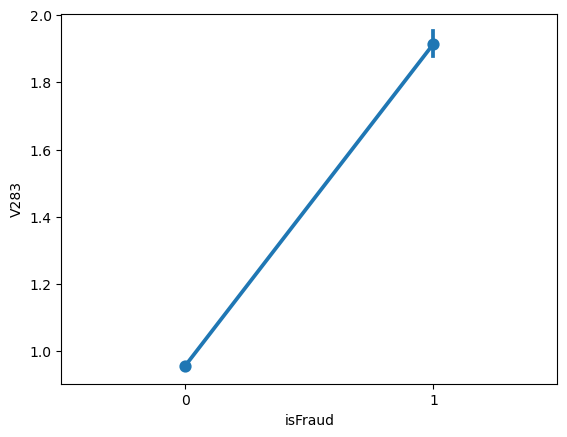

Nilai t-test : 87.09201941281873
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 159
Hubungan label dengan kolom V284


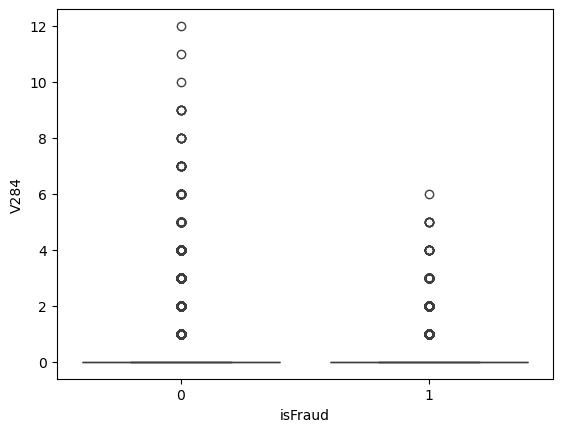

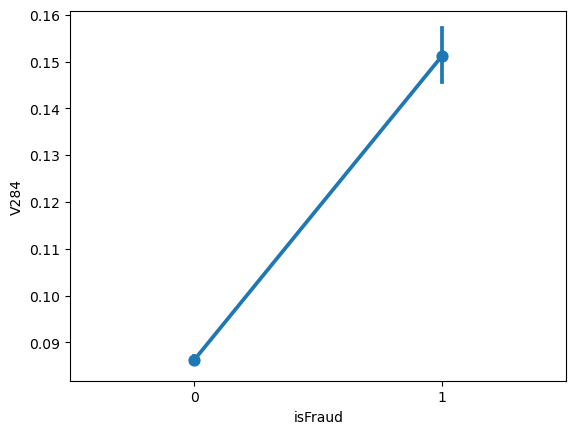

Nilai t-test : 27.15060763330348
Nilai pvalue t-test : 3.1360853790865274e-162
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 160
Hubungan label dengan kolom V285


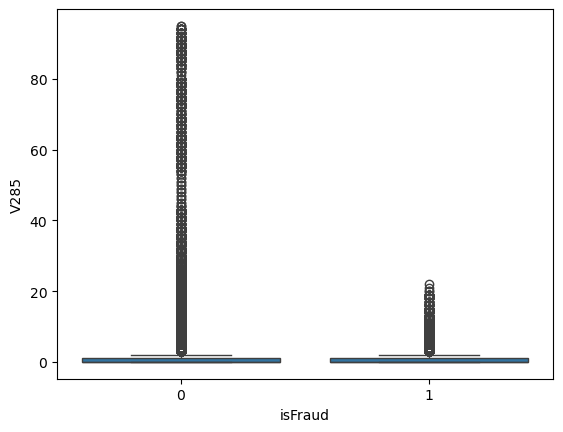

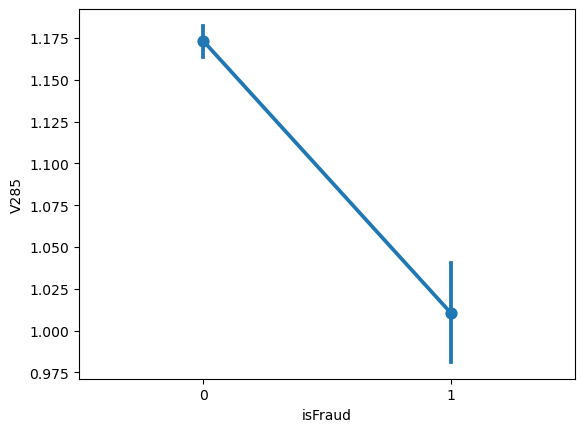

Nilai t-test : -7.014510612532533
Nilai pvalue t-test : 2.310013663444438e-12
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 161
Hubungan label dengan kolom V286


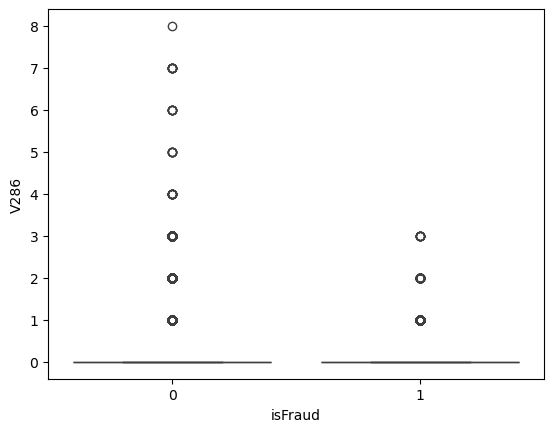

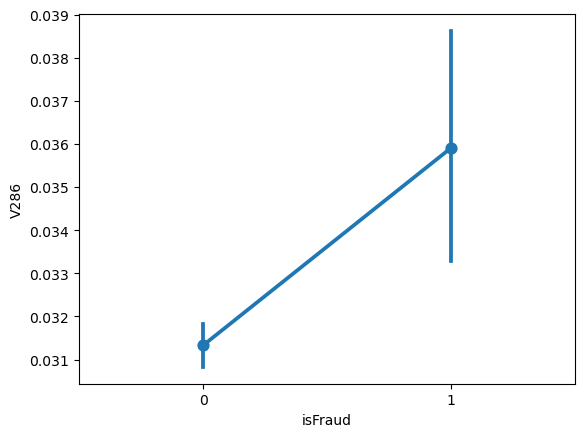

Nilai t-test : 3.387894446204653
Nilai pvalue t-test : 0.0007043595915976562
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 162
Hubungan label dengan kolom V287


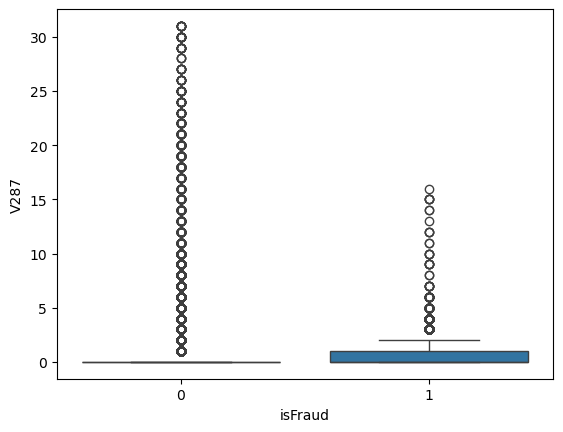

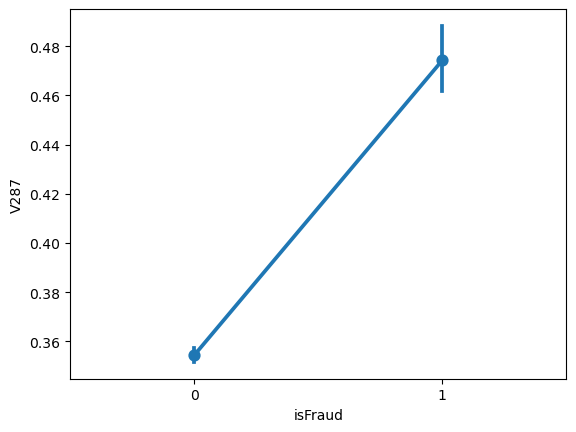

Nilai t-test : 15.692732849067973
Nilai pvalue t-test : 1.7403976573895993e-55
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 163
Hubungan label dengan kolom V288


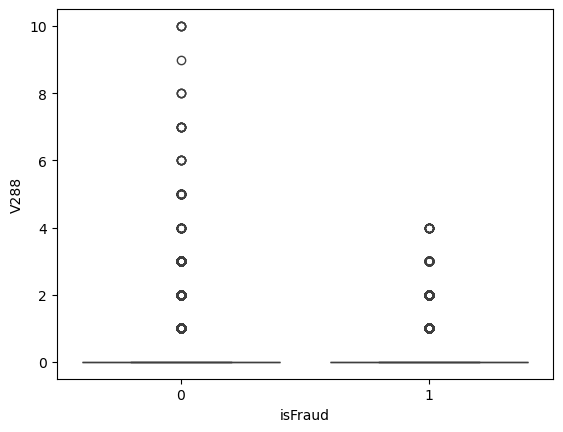

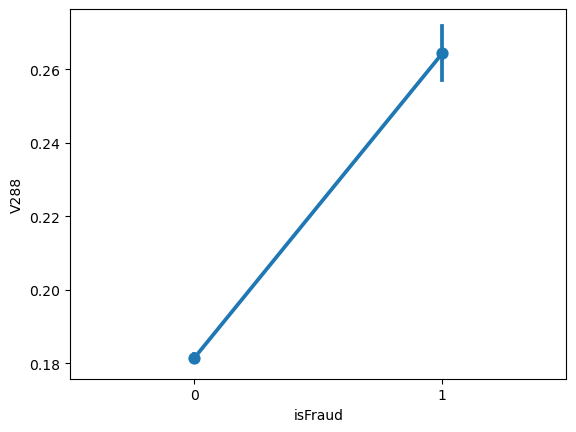

Nilai t-test : 27.13008236117696
Nilai pvalue t-test : 5.477163427993822e-162
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 164
Hubungan label dengan kolom V289


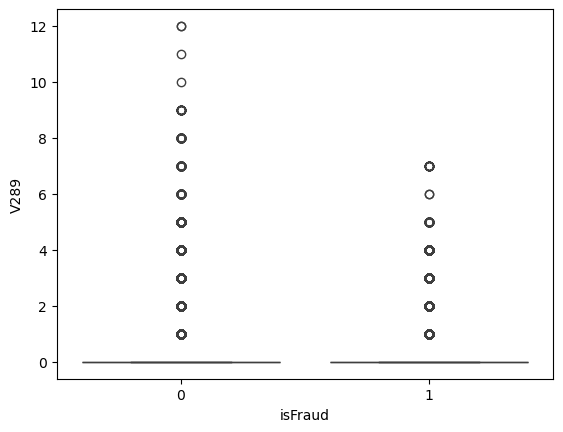

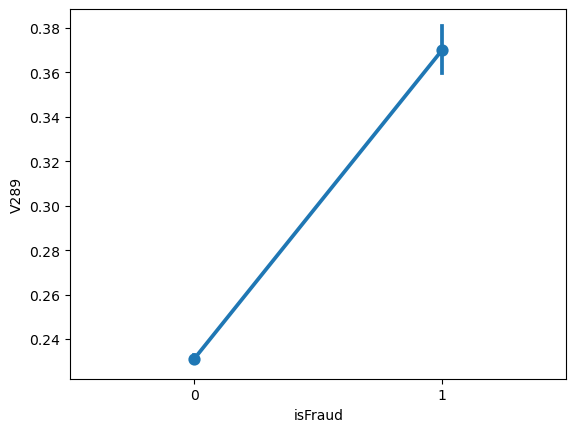

Nilai t-test : 32.75360177031954
Nilai pvalue t-test : 4.397949016788741e-235
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 165
Hubungan label dengan kolom V290


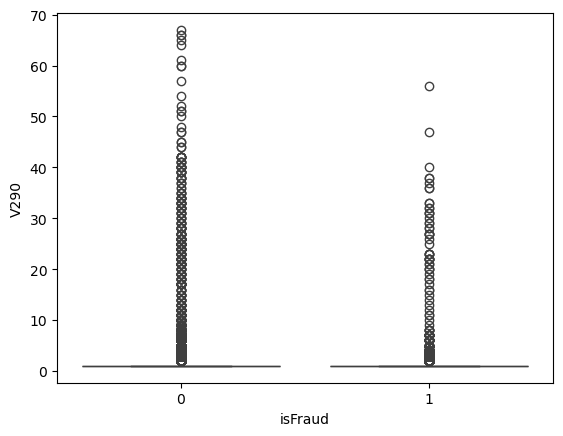

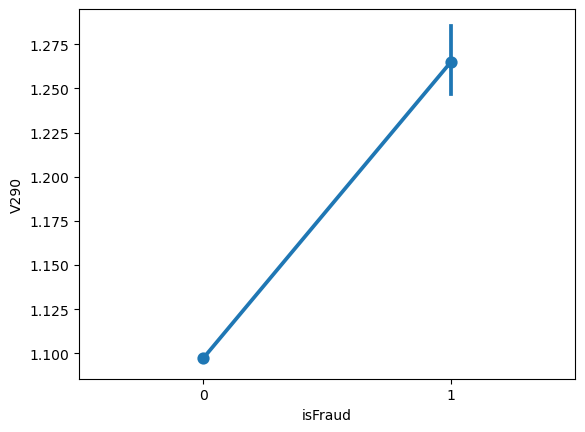

Nilai t-test : 30.877623460991497
Nilai pvalue t-test : 3.5072388023801105e-209
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 166
Hubungan label dengan kolom V291


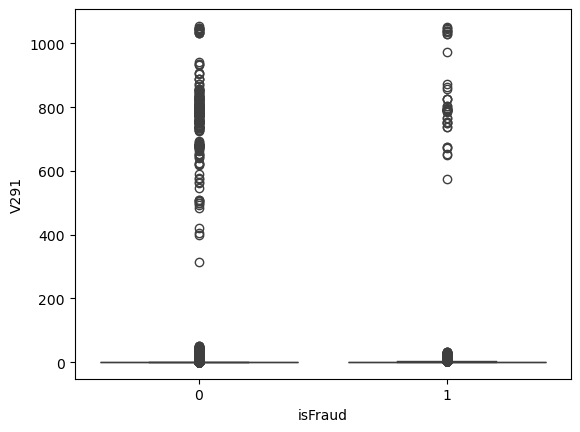

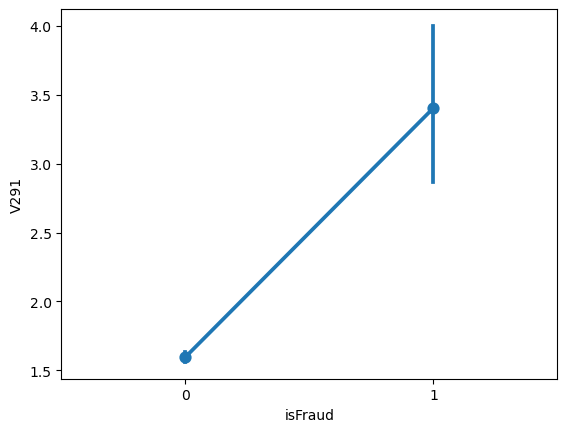

Nilai t-test : 15.71100092327784
Nilai pvalue t-test : 1.3050440164177566e-55
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 167
Hubungan label dengan kolom V292


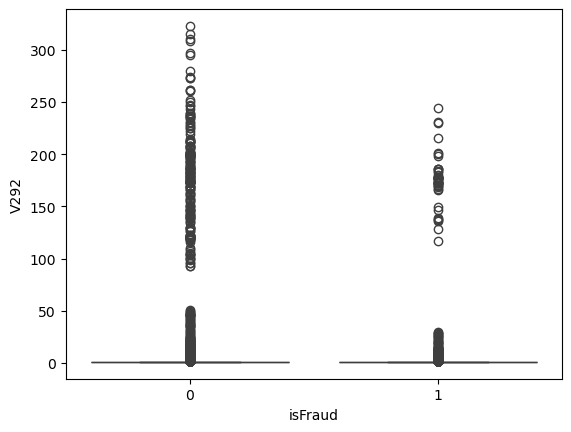

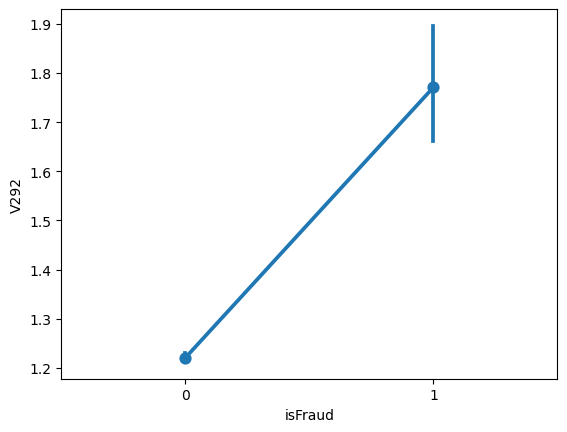

Nilai t-test : 20.5855052282192
Nilai pvalue t-test : 3.995252046757884e-94
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 168
Hubungan label dengan kolom V293


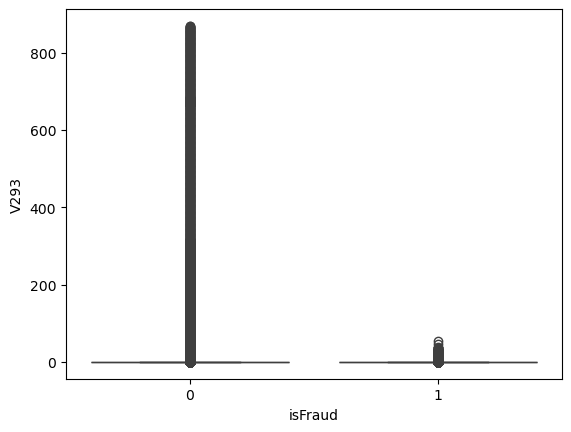

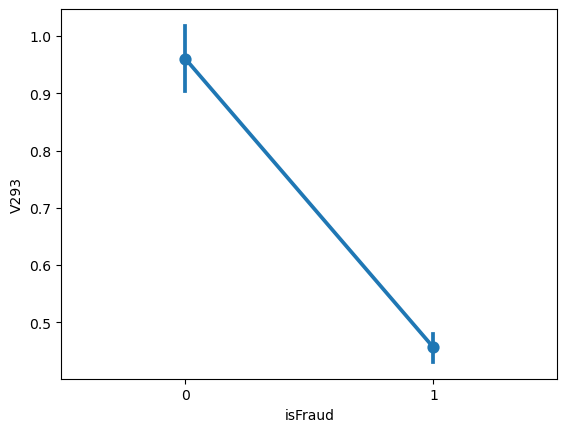

Nilai t-test : -3.4587090936509455
Nilai pvalue t-test : 0.0005428090393678946
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 169
Hubungan label dengan kolom V294


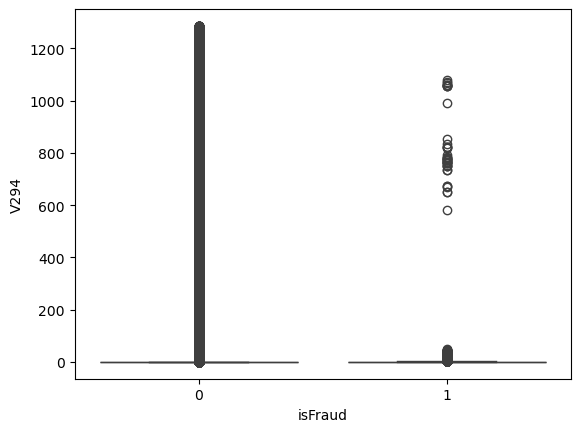

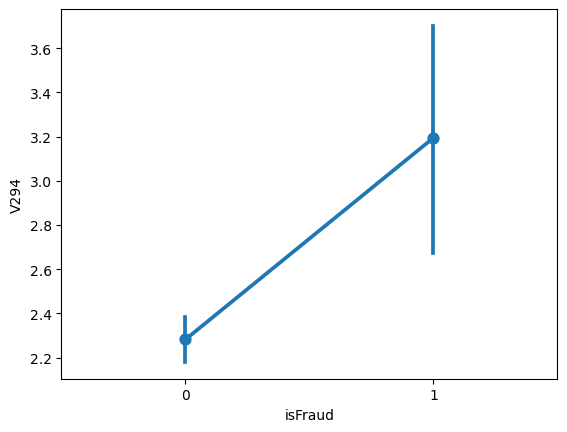

Nilai t-test : 3.258674099193935
Nilai pvalue t-test : 0.001119404960235994
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 170
Hubungan label dengan kolom V295


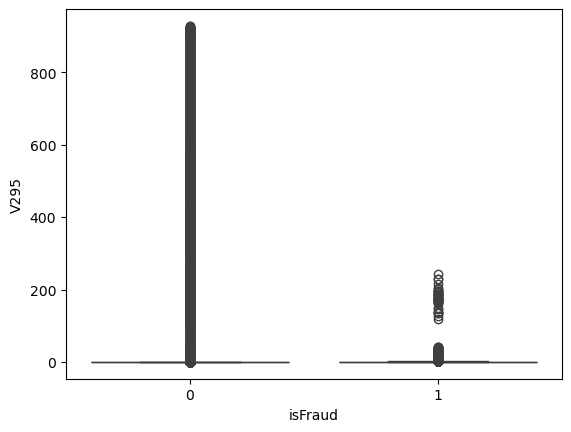

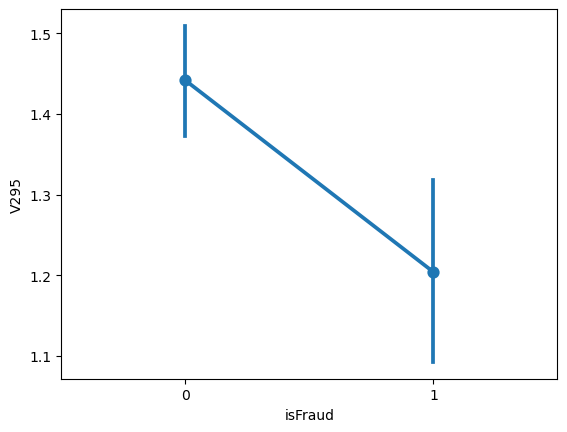

Nilai t-test : -1.2921263387135529
Nilai pvalue t-test : 0.19631390154955283
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 171
Hubungan label dengan kolom V296


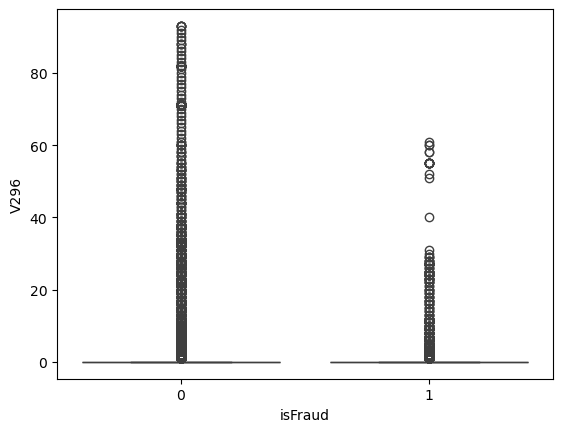

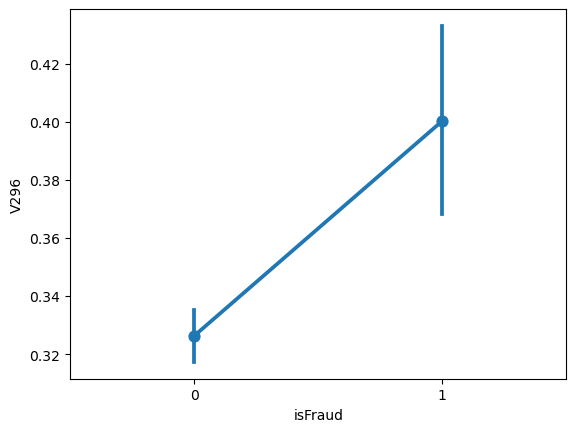

Nilai t-test : 3.1937945511295633
Nilai pvalue t-test : 0.0014042339037753857
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 172
Hubungan label dengan kolom V297


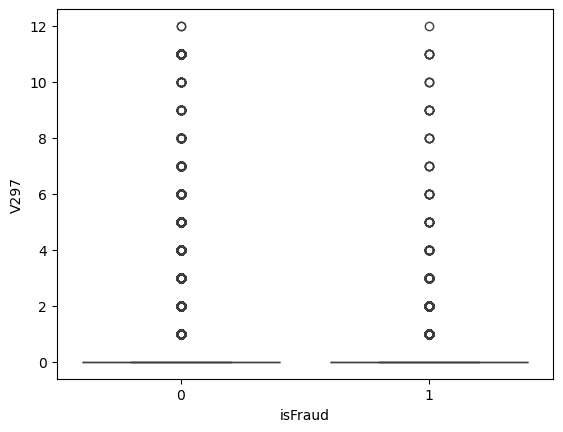

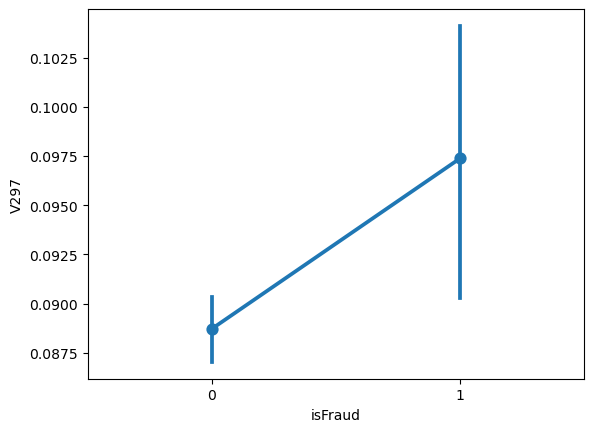

Nilai t-test : 1.943889470320392
Nilai pvalue t-test : 0.051909255637439776
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 173
Hubungan label dengan kolom V298


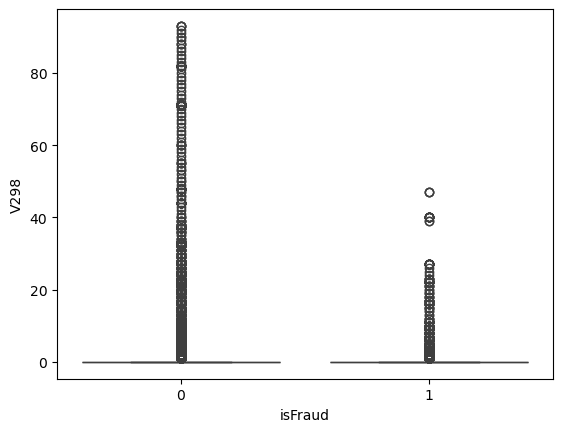

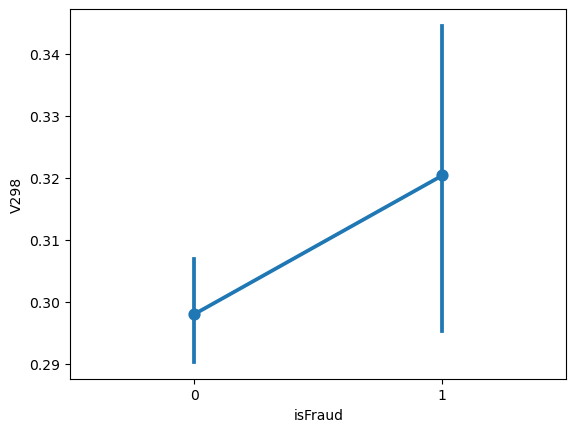

Nilai t-test : 0.9945659498358785
Nilai pvalue t-test : 0.31994782258965826
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 174
Hubungan label dengan kolom V299


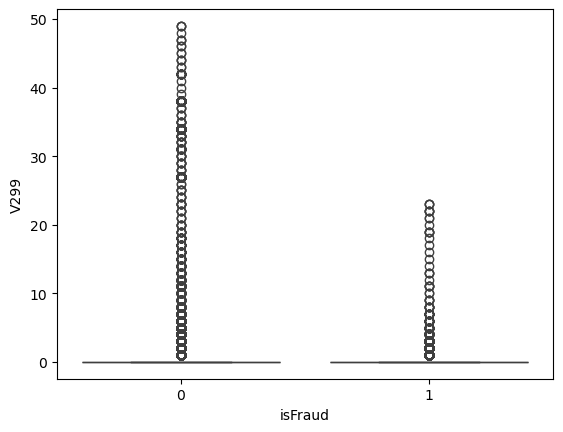

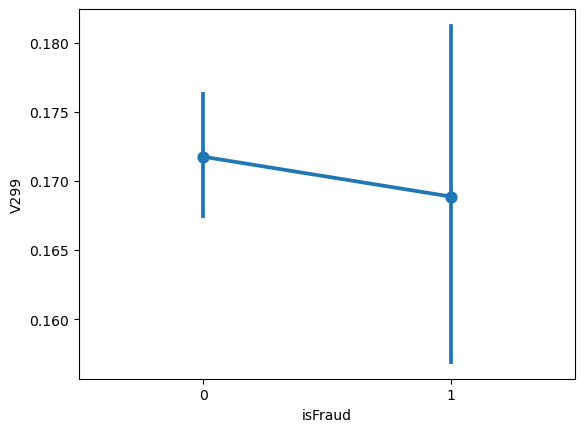

Nilai t-test : -0.23642516443518122
Nilai pvalue t-test : 0.8131028532078257
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 175
Hubungan label dengan kolom V300


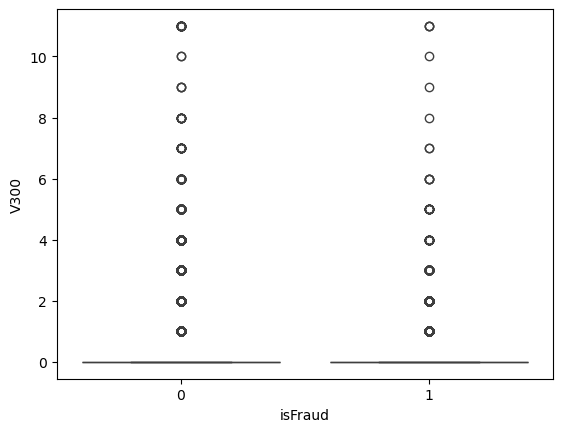

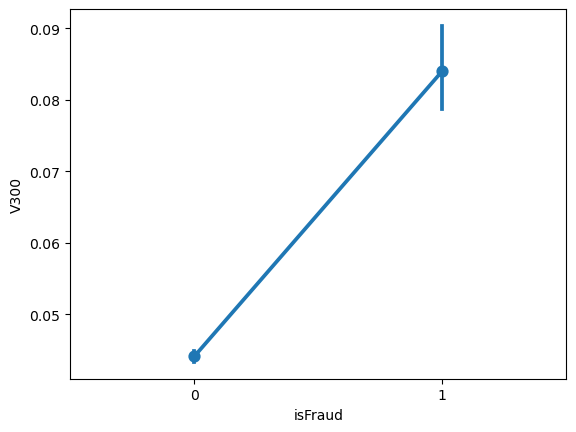

Nilai t-test : 19.44027661156968
Nilai pvalue t-test : 3.743767597849125e-84
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 176
Hubungan label dengan kolom V301


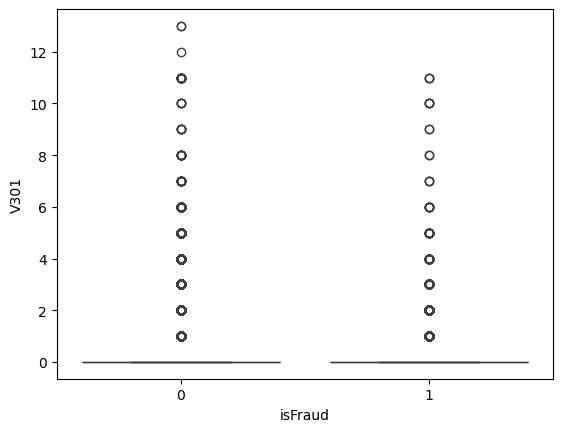

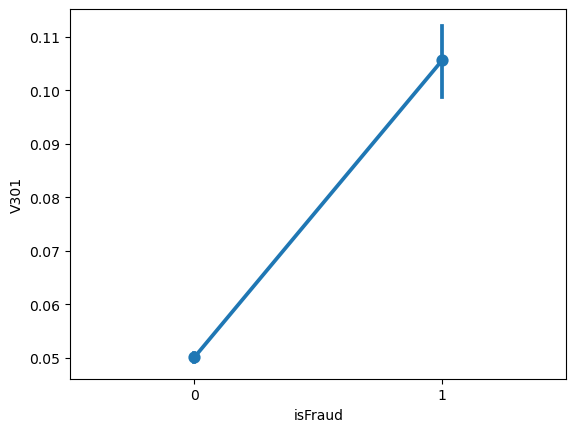

Nilai t-test : 24.643572150893803
Nilai pvalue t-test : 5.045575510189914e-134
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 177
Hubungan label dengan kolom V302


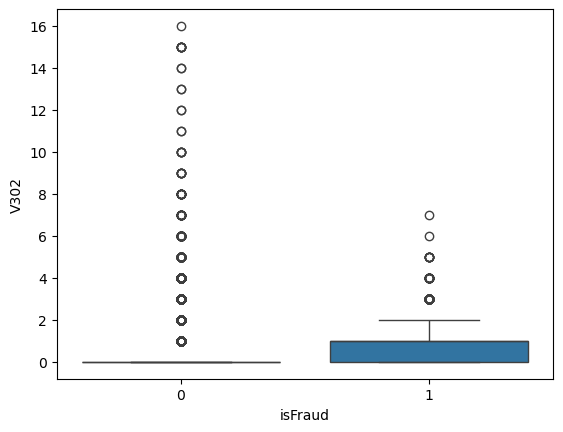

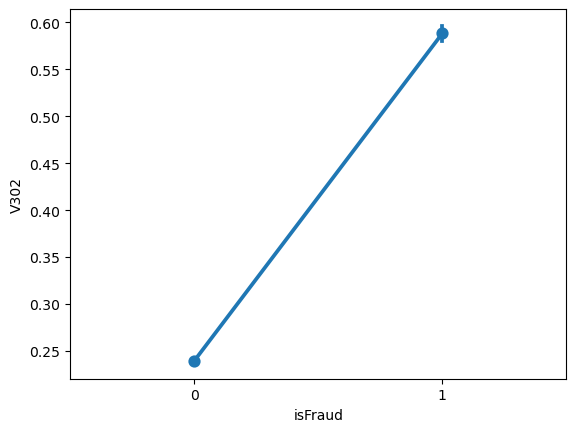

Nilai t-test : 103.04470075303686
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 178
Hubungan label dengan kolom V303


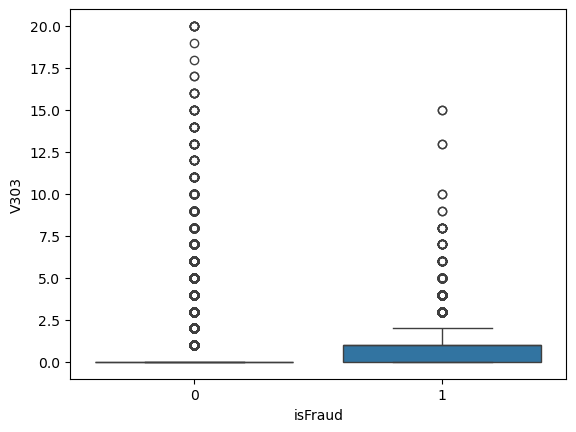

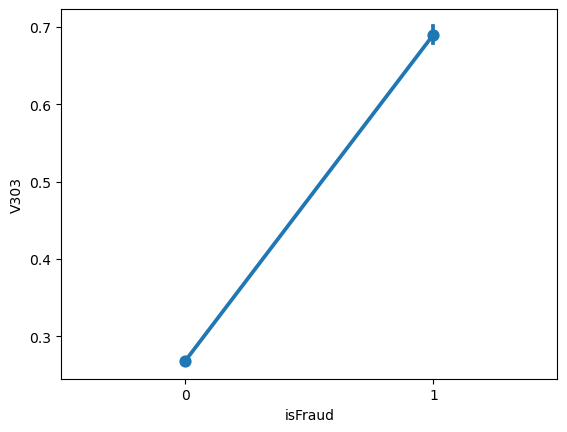

Nilai t-test : 96.25527315981448
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 179
Hubungan label dengan kolom V304


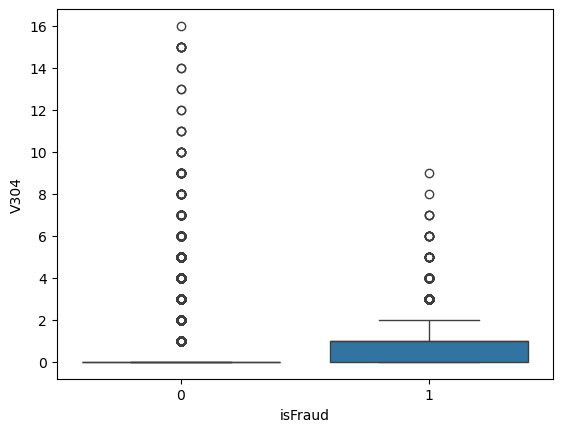

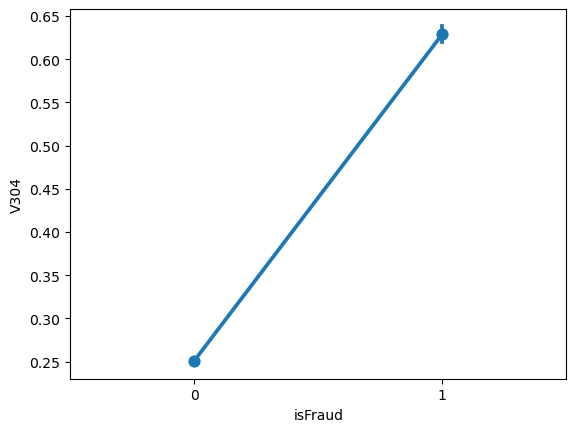

Nilai t-test : 101.9356456350931
Nilai pvalue t-test : 0.0
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 180
Hubungan label dengan kolom V305


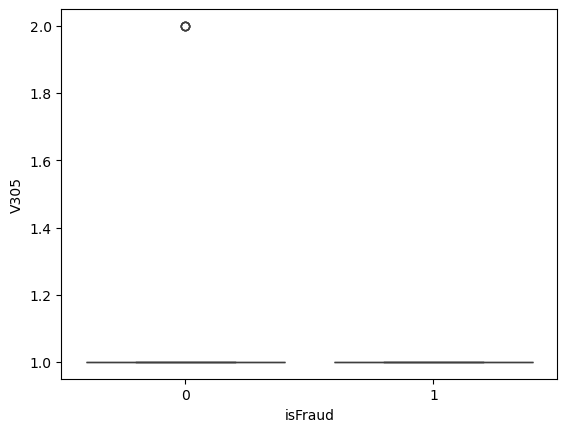

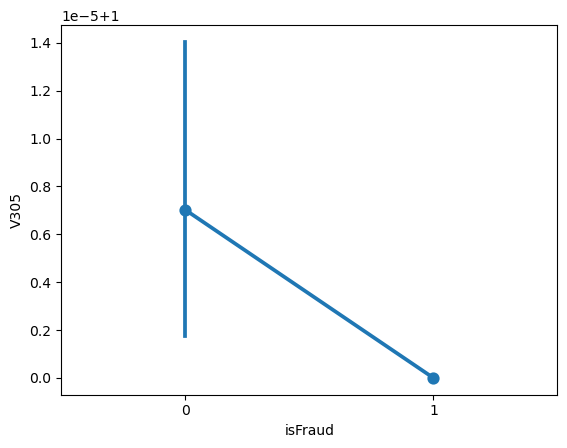

Nilai t-test : -0.38081995646804156
Nilai pvalue t-test : 0.7033369869745292
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 181
Hubungan label dengan kolom V306


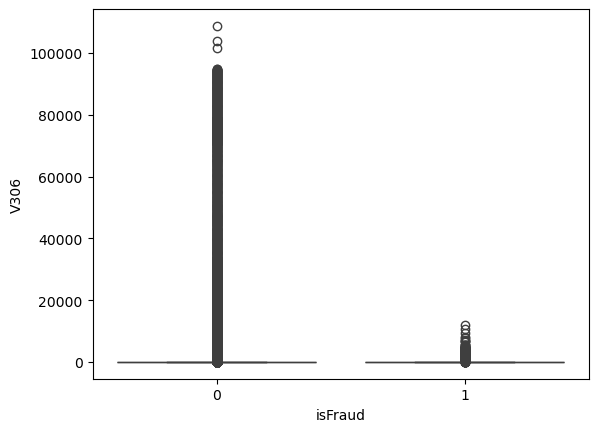

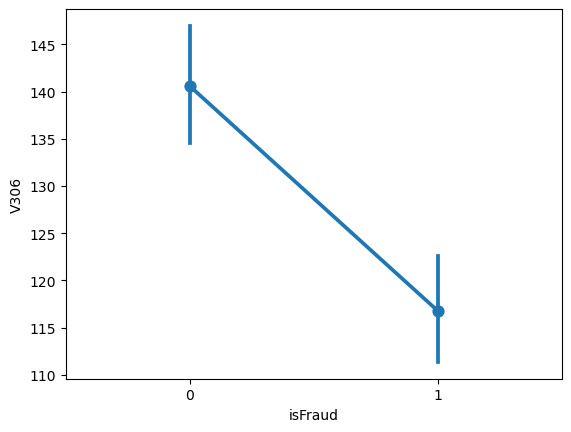

Nilai t-test : -1.4317524227715057
Nilai pvalue t-test : 0.15221521697433682
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 182
Hubungan label dengan kolom V307


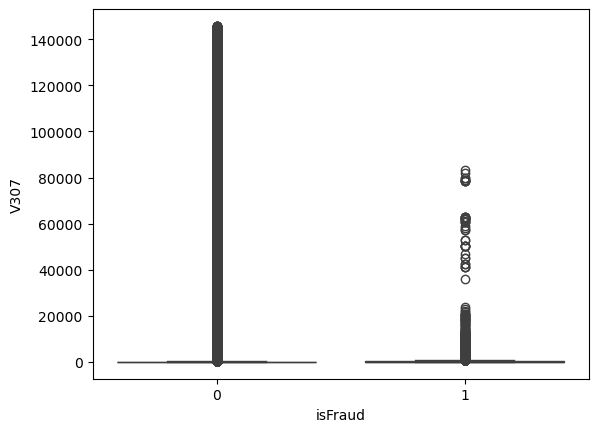

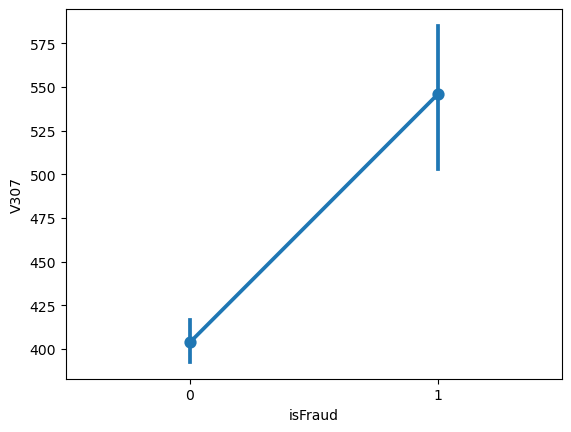

Nilai t-test : 4.570950085223883
Nilai pvalue t-test : 4.8561610747728975e-06
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 183
Hubungan label dengan kolom V308


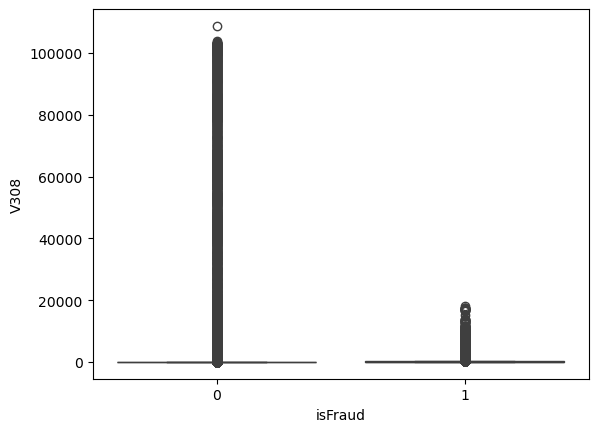

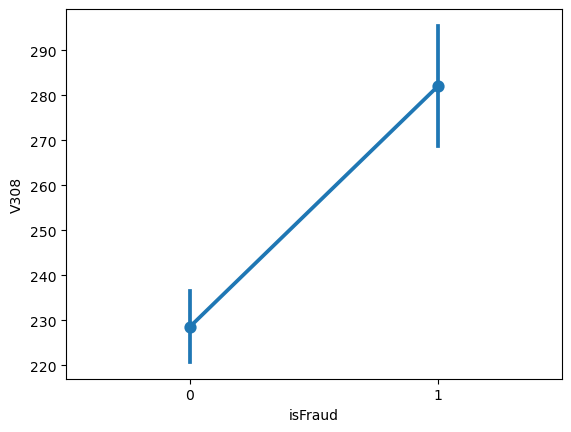

Nilai t-test : 2.500018201304981
Nilai pvalue t-test : 0.012418961582238012
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 184
Hubungan label dengan kolom V309


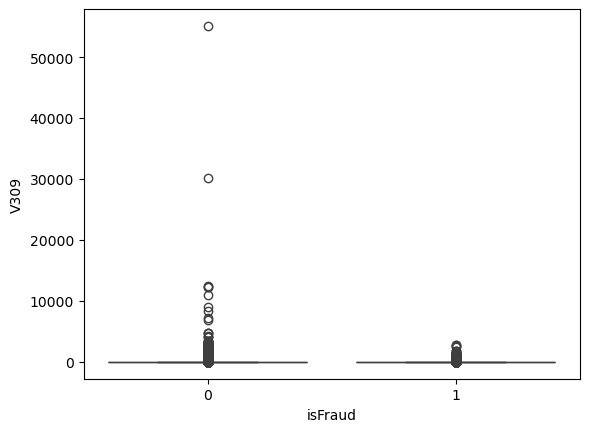

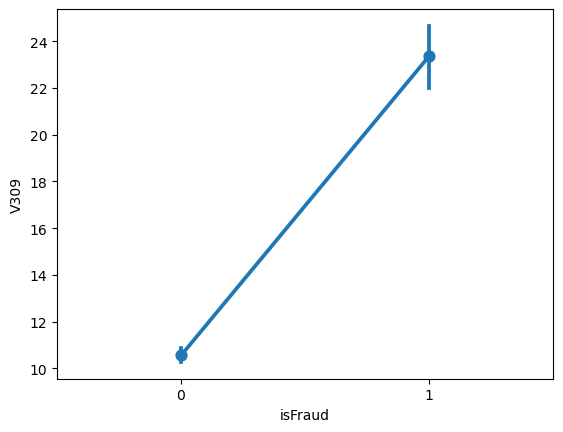

Nilai t-test : 15.568909061982938
Nilai pvalue t-test : 1.2141575949763372e-54
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 185
Hubungan label dengan kolom V310


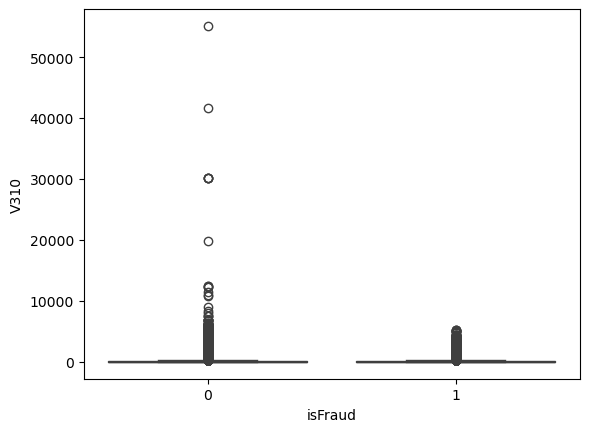

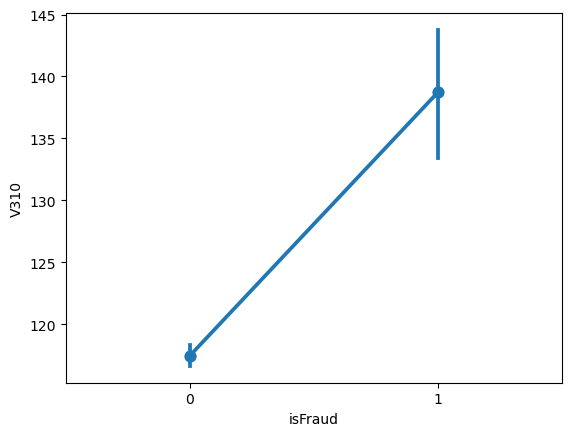

Nilai t-test : 8.508134775476776
Nilai pvalue t-test : 1.7715696981496434e-17
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 186
Hubungan label dengan kolom V311


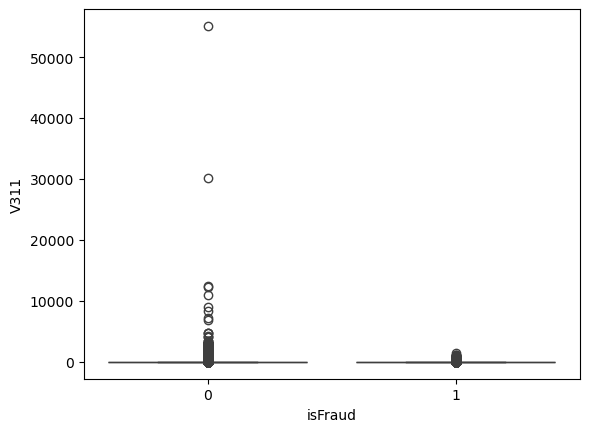

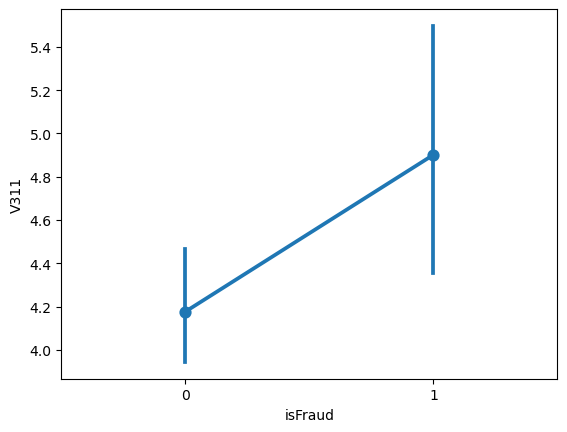

Nilai t-test : 0.9991143584824318
Nilai pvalue t-test : 0.3177397056859407
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 187
Hubungan label dengan kolom V312


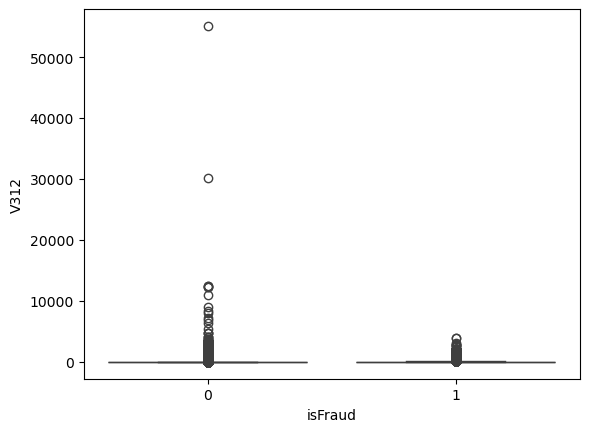

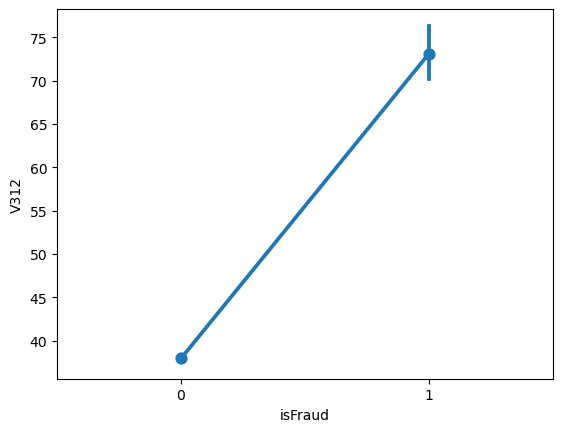

Nilai t-test : 28.89758071140003
Nilai pvalue t-test : 1.7209771802125418e-183
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 188
Hubungan label dengan kolom V313


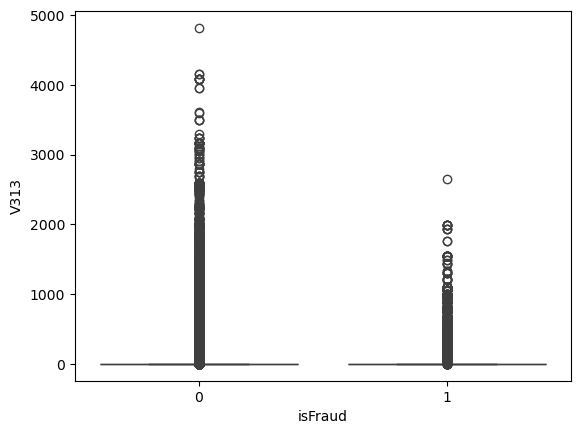

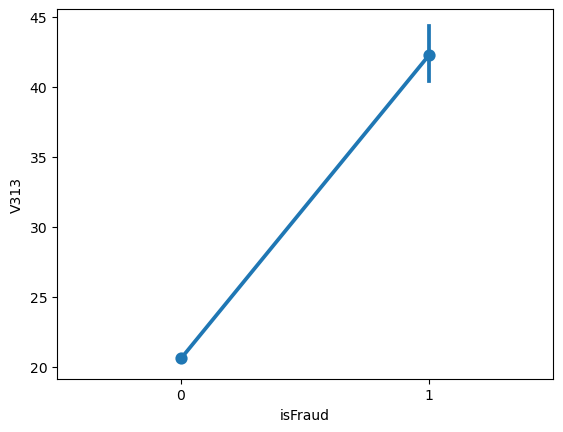

Nilai t-test : 31.880046591129137
Nilai pvalue t-test : 7.827360056964985e-223
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 189
Hubungan label dengan kolom V314


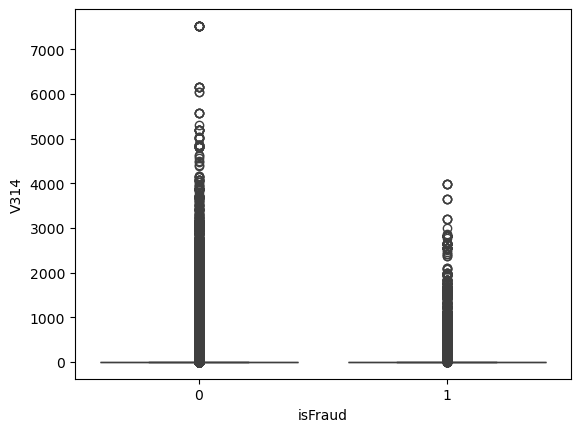

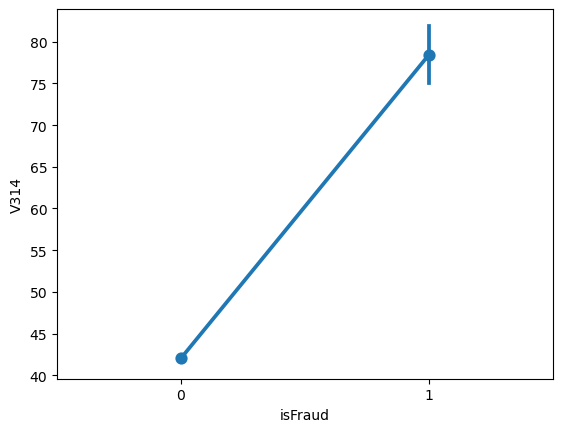

Nilai t-test : 29.603192691203027
Nilai pvalue t-test : 1.8837411464511685e-192
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 190
Hubungan label dengan kolom V315


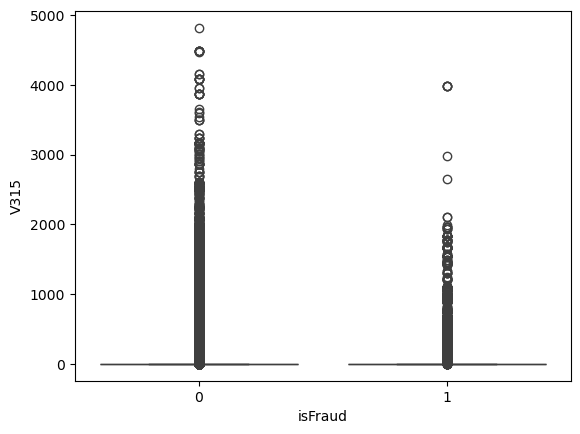

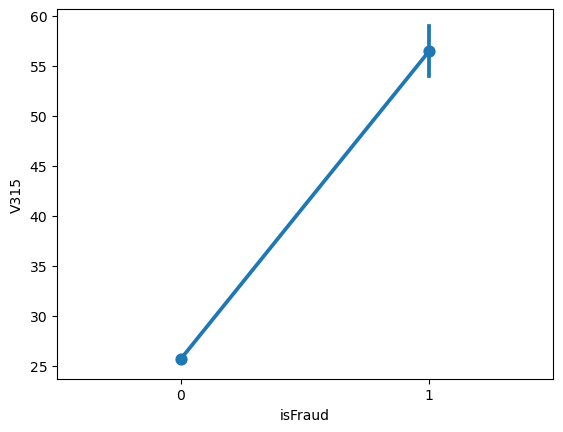

Nilai t-test : 37.118801123566314
Nilai pvalue t-test : 3.1269925137918693e-301
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 191
Hubungan label dengan kolom V316


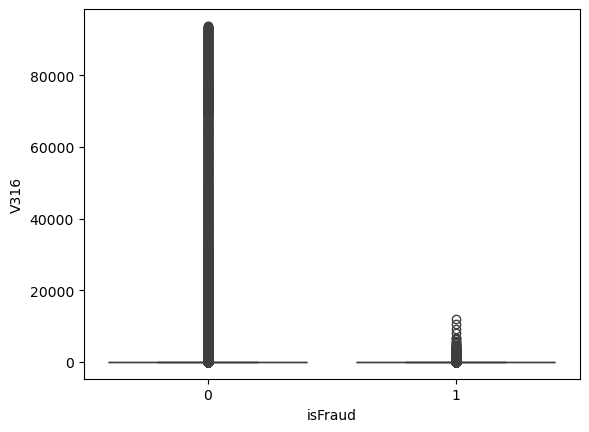

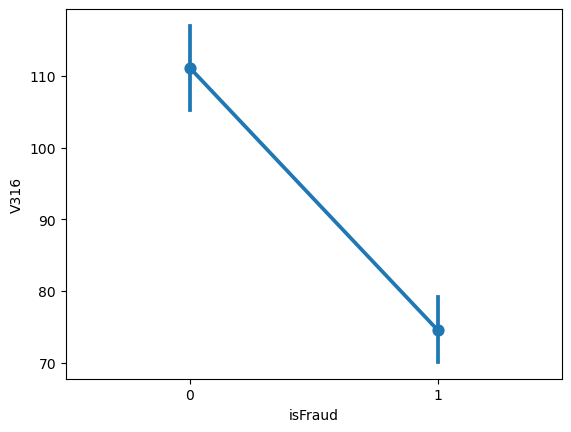

Nilai t-test : -2.2748580708165065
Nilai pvalue t-test : 0.02291480217461592
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 192
Hubungan label dengan kolom V317


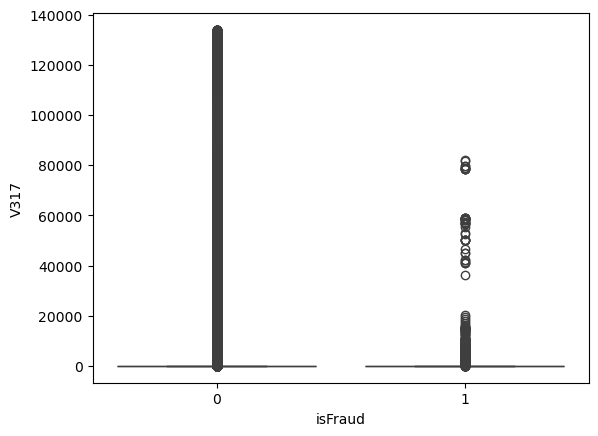

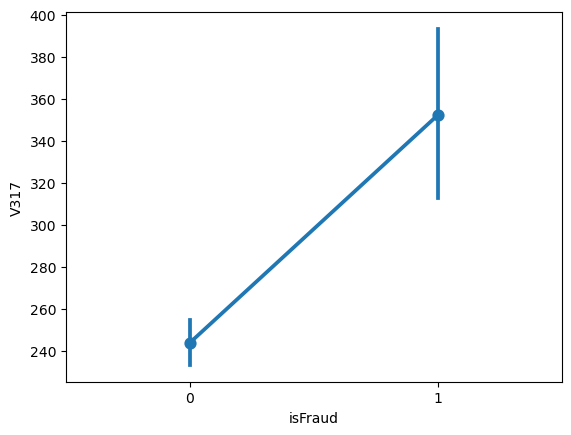

Nilai t-test : 3.8498328630171113
Nilai pvalue t-test : 0.00011821089691250212
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 193
Hubungan label dengan kolom V318


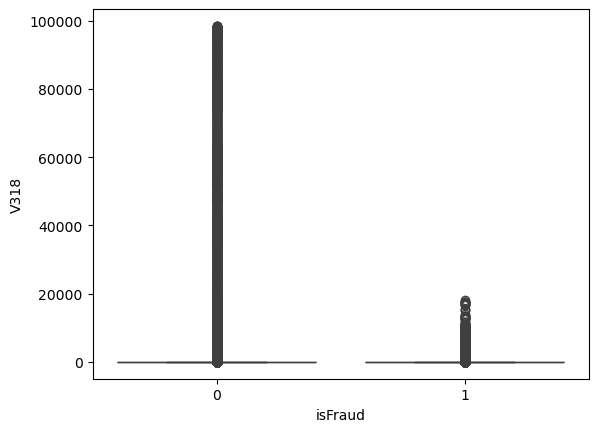

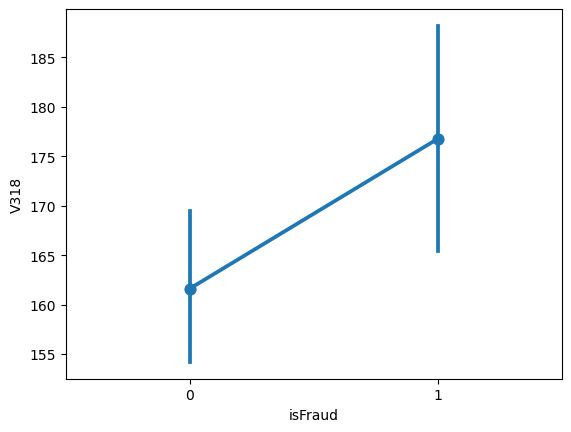

Nilai t-test : 0.7662552081835515
Nilai pvalue t-test : 0.44352477072672825
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 194
Hubungan label dengan kolom V319


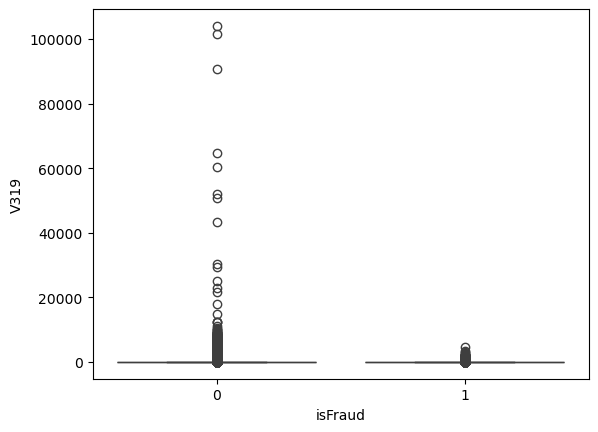

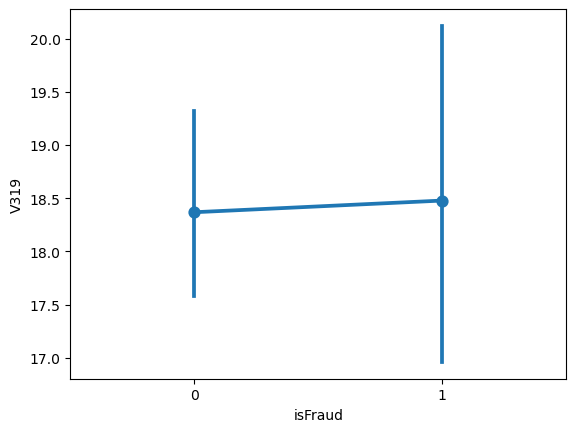

Nilai t-test : 0.04669135300237112
Nilai pvalue t-test : 0.9627592379242895
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0


iterasi ke- 195
Hubungan label dengan kolom V320


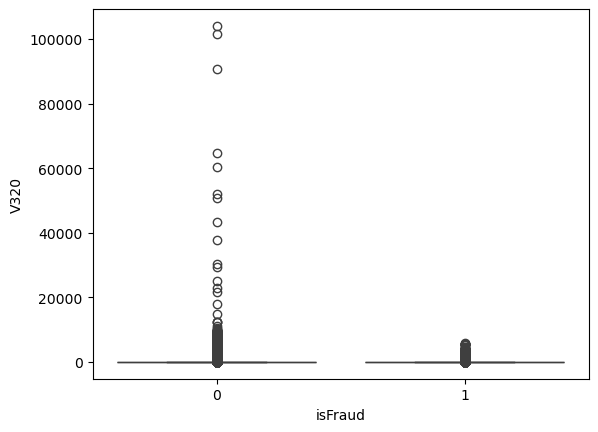

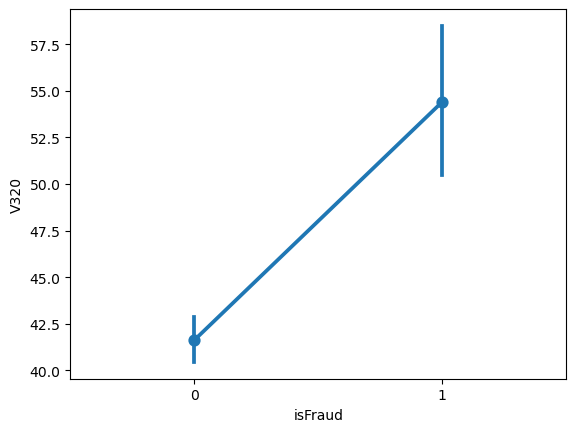

Nilai t-test : 3.812270103701212
Nilai pvalue t-test : 0.0001377102540323021
Dikarenakan nilai pvalue ttest < 0.05 maka terima H0
Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0


iterasi ke- 196
Hubungan label dengan kolom V321


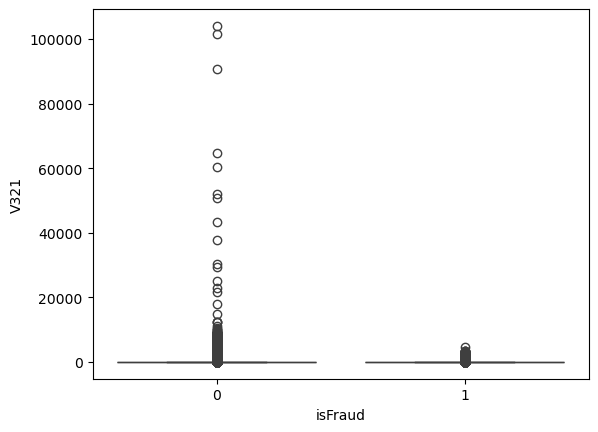

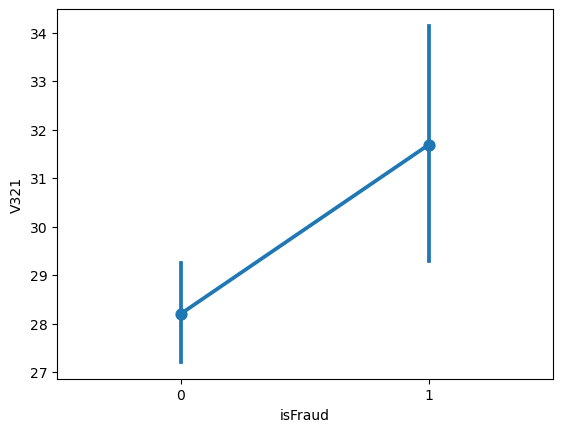

Nilai t-test : 1.288789659347988
Nilai pvalue t-test : 0.19747172682560957
Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0
Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0



In [119]:
# Melakukan EDA Multivariat pada setiap pasangan kolom kontinu dengan kolom label dataset 

# Membuat list nama kolom numerik
list_kontinu = list(df_num.columns)
list_kontinu.remove('isFraud')

# Membuat loop
iter=1
for i in list_kontinu:
  print()
  print('iterasi ke-',iter)
  print('Hubungan label dengan kolom',i)
  
  sns.boxplot(data=df_train, x='isFraud', y=i)
  plt.show()
  print()
  sns.pointplot(data=df_train, x='isFraud', y=i)
  plt.show()

  alp = 0.05
  group1 = df_train[(df_train['isFraud']==1)][i]
  group0 = df_train[(df_train['isFraud']==0)][i]
  ttest_coef,ttest_pval = ttest_ind(group1,group0,nan_policy='omit', alternative='two-sided')
  print('Nilai t-test :',ttest_coef)
  print('Nilai pvalue t-test :',ttest_pval)
  if ttest_pval < 0.05 :
    print('Dikarenakan nilai pvalue ttest < 0.05 maka terima H0')
    print('Kesimpulan : mean variabel numerik kelompok label 1 = mean variabel numerik kelompok label 0')
  else : 
    print('Dikarenakan nilai pvalue ttest > 0.05 maka tolak H0')
    print('Kesimpulan : mean variabel numerik kelompok label 1 ≠ mean variabel numerik kelompok label 0')

  iter+=1
  print()

# **Data Preparation**

Metode penanganan missing value :

1. missing value ≤30% gunakan simple imputer yaitu median untuk kolom numerik dan modus untuk kolom kategorik <p>
2. missing value >30% drop kolom

Karena keseluruhan nilai missing value yang melebihi 30% sudah di drop, maka tindakan yang dilakukan hanyalah menggunakan simple imputer. Tahapannya adalah dengan memisahkan data kontinu dan kategorikal dahulu, kemudian dilakukan onehotencoder dan diimpute.

In [137]:
# Mengecek kembali informasi dan missing value data

df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 590540 entries, 0 to 590539
Columns: 203 entries, Unnamed: 0 to V321
dtypes: float64(193), int64(5), object(5)
memory usage: 914.6+ MB


In [138]:
df_train.isna().sum()/len(df_train)

Unnamed: 0         0.00000
TransactionID_1    0.00000
isFraud            0.00000
TransactionDT      0.00000
TransactionAmt     0.00000
                    ...   
V317               0.00002
V318               0.00002
V319               0.00002
V320               0.00002
V321               0.00002
Length: 203, dtype: float64

In [141]:
df_cat.columns

Index(['ProductCD', 'card4', 'card6', 'P_emaildomain', 'M6'], dtype='object')

In [142]:
# Check kolom null pada categorical
null_percent_cat = df_cat.isnull().mean() * 100
null_percent_cat = null_percent_cat.sort_values(ascending=False)

# Tampilkan hasil
null_percent_cat = null_percent_cat[null_percent_cat > 0]
null_percent_cat

M6               28.678836
P_emaildomain    15.994852
card4             0.267044
card6             0.266028
dtype: float64

In [143]:
df_num.columns

Index(['Unnamed: 0', 'TransactionID_1', 'isFraud', 'TransactionDT',
       'TransactionAmt', 'card1', 'card2', 'card3', 'card5', 'addr1',
       ...
       'V312', 'V313', 'V314', 'V315', 'V316', 'V317', 'V318', 'V319', 'V320',
       'V321'],
      dtype='object', length=198)

In [144]:
# Check kolom null pada numerical
null_percent_num = df_num.isnull().mean() * 100
null_percent_num = null_percent_num.sort_values(ascending=False)

# Tampilkan hasil
null_percent_num = null_percent_num[null_percent_num > 0]
null_percent_num

V43     28.612626
V46     28.612626
V44     28.612626
V52     28.612626
V51     28.612626
          ...    
V285     0.002032
V284     0.002032
V280     0.002032
V279     0.002032
V291     0.002032
Length: 178, dtype: float64

In [145]:
# Mengubah feature kategorikal menjadi numerik dengan ordinal encoder 
oe = OrdinalEncoder(handle_unknown ='use_encoded_value',unknown_value=np.nan)
df_cat_oe = pd.DataFrame(oe.fit_transform(df_cat),columns = oe.feature_names_in_)
df_cat_oe

,ProductCD,card4,card6,P_emaildomain,M6
0,4.0,1.0,1.0,NaN,1.0
1,4.0,2.0,1.0,16.0,1.0
2,4.0,3.0,2.0,35.0,0.0
3,4.0,2.0,2.0,53.0,0.0
4,1.0,2.0,1.0,16.0,NaN
...,...,...,...,...,...
590535,4.0,3.0,2.0,NaN,0.0
590536,4.0,2.0,2.0,16.0,1.0
590537,4.0,2.0,2.0,16.0,1.0
590538,4.0,2.0,2.0,2.0,1.0


In [29]:
# Menyatukan kedua jenis tipe data menjadi satu dataset

df_concat_imp = pd.concat([df_cat_oe, df_num], axis = 1)
df_concat_imp

,ProductCD,card4,card6,P_emaildomain,M6,TransactionID_1,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D4,D10,D15,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321
0,4.0,1.0,1.0,NaN,1.0,2987000,0,86400,68.50,13926,NaN,150.0,142.0,315.0,87.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,117.000000,0.000000,0.0,0.000000,0.0,0.0,117.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,117.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,117.0,0.0,0.000000,0.000000,0.000000
1,4.0,2.0,1.0,16.0,1.0,2987001,0,86401,29.00,2755,404.0,150.0,102.0,325.0,87.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000
2,4.0,3.0,2.0,35.0,0.0,2987002,0,86469,59.00,4663,490.0,150.0,166.0,330.0,87.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,315.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000
3,4.0,2.0,2.0,53.0,0.0,2987003,0,86499,50.00,18132,567.0,150.0,117.0,476.0,87.0,2.0,5.0,0.0,0.0,0.0,4.0,0.0,0.0,1.0,0.0,1.0,0.0,25.0,1.0,112.0,94.0,84.0,111.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,

In [147]:
# Memasukan nilai null kedalam dataset dengan kondisi yang telah didefinisikan
# impute mode : 4 kolom kategorikal transformed
# impute median : 178 kolom numeric

# Mengambil semua kolom yang terdapat null
cat_with_null = null_percent_cat.index.tolist()
num_with_null = null_percent_num.index.tolist()

# Menggunakan imputer mode
df_modus = df_concat_imp[cat_with_null]
Mod_imp = SimpleImputer(strategy='most_frequent')
Mod_imp_fit = pd.DataFrame(Mod_imp.fit_transform(df_modus), columns = Mod_imp.feature_names_in_)
df_concat_imp[cat_with_null] = Mod_imp_fit

# Menggunakan imputer median
df_mean = df_concat_imp[num_with_null]
Mean_imp = SimpleImputer(strategy='median')
Mean_imp_fit = pd.DataFrame(Mean_imp.fit_transform(df_mean), columns = Mean_imp.feature_names_in_)
df_concat_imp[num_with_null] = Mean_imp_fit


In [31]:
# Melakukan inverse numerik terhadap data kategorikal

df_concat_imp[oe.feature_names_in_] = oe.inverse_transform(df_concat_imp[oe.feature_names_in_])
df_concat_imp

,ProductCD,card4,card6,P_emaildomain,M6,TransactionID_1,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D4,D10,D15,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321
0,W,discover,credit,gmail.com,T,2987000,0,86400,68.50,13926,361.0,150.0,142.0,315.0,87.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,26.0,13.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,117.000000,0.000000,0.0,0.000000,0.0,0.0,117.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,117.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,117.0,0.0,0.000000,0.000000,0.000000
1,W,mastercard,credit,gmail.com,T,2987001,0,86401,29.00,2755,404.0,150.0,102.0,325.0,87.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000
2,W,visa,debit,outlook.com,F,2987002,0,86469,59.00,4663,490.0,150.0,166.0,330.0,87.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,315.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000
3,W,mastercard,debit,yahoo.com,F,2987003,0,86499,50.00,18132,567.0,150.0,117.0,476.0,87.0,2.0,5.0,0.0,0.0,0.0,4.0,0.0,0.0,1.0,0.0,1.0,0.0,25.0,1.0,112.0,94.0,84.0,111.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,

In [32]:
# Check null kembali
null_percent = df_concat_imp.isnull().mean() * 100
null_percent = null_percent.sort_values(ascending=False)

null_percent = null_percent[null_percent > 0]
null_percent

Series([], dtype: float64)

In [81]:
# # Checkpoint

# df_concat_imp.to_csv("df_concat_imp.csv",sep='+')
# df_train.to_csv("df_train.csv",sep='+')
# df_backtest.to_csv("df_backtest.csv",sep='+')

# **Feature Engineering**

## Feature Selection

In [ ]:
# Dikarenakan fitur terlalu banyak maka akan dikurangi dengan menggunakan beberapa metode pemilihan fitur yakni
# Korelasi, Kbest, Mutual

In [7]:
# pisahkan data numeric dan categori

# Numerical
df_num = df_concat_imp.select_dtypes('number')
df_num = df_num.drop(['TransactionID_1','TransactionDT'],axis=1)
# Categorical
df_cat = df_concat_imp.select_dtypes('object')

In [43]:
df_num

,isFraud,TransactionAmt,card1,card2,card3,card5,addr1,addr2,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D4,D10,D15,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321
0,0,68.50,13926,361.0,150.0,142.0,315.0,87.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,26.0,13.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,117.000000,0.000000,0.0,0.000000,0.0,0.0,117.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,117.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,117.0,0.0,0.000000,0.000000,0.000000
1,0,29.00,2755,404.0,150.0,102.0,325.0,87.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000
2,0,59.00,4663,490.0,150.0,166.0,330.0,87.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,315.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000
3,0,50.00,18132,567.0,150.0,117.0,476.0,87.0,2.0,5.0,0.0,0.0,0.0,4.0,0.0,0.0,1.0,0.0,1.0,0.0,25.0,1.0,112.0,94.0,84.0,111.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,48.0,28.0,0.0,10.

In [ ]:
# FEATURE NUMERCIAL

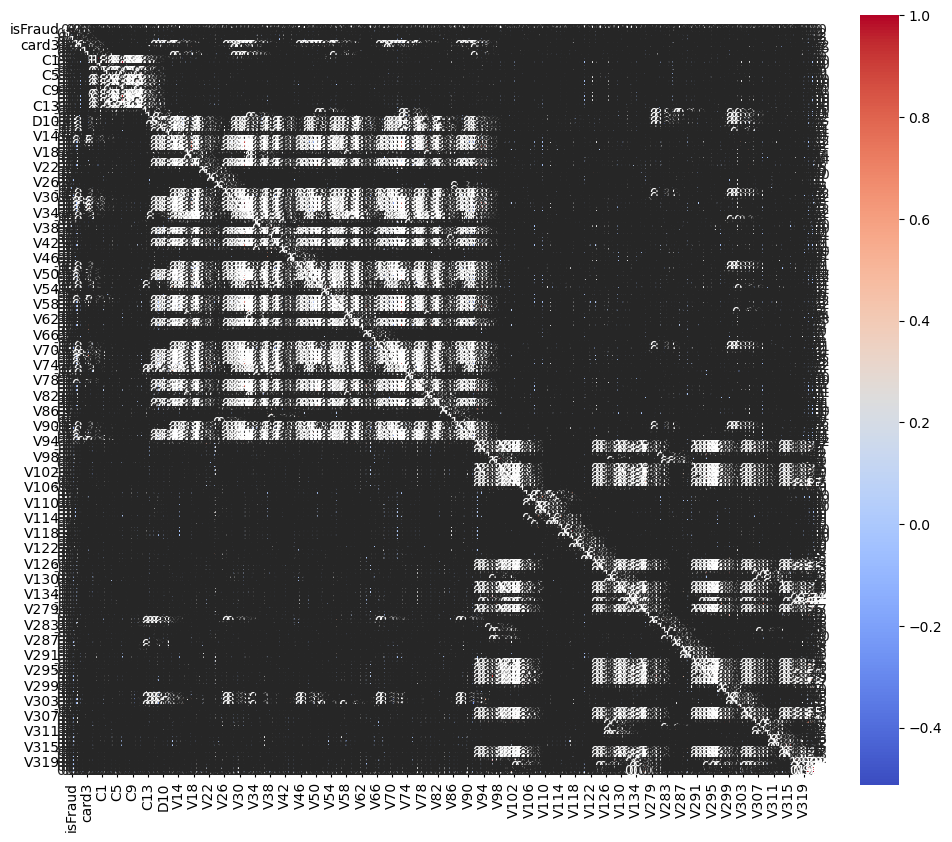

In [46]:
### Heatmap Correlation

# Create the heatmap
correlation_matrix = df_num.corr()
cor_flag_trx = correlation_matrix['isFraud'].sort_values()
cor_flag_trx = pd.DataFrame(cor_flag_trx.drop('isFraud'))

plt.figure(figsize = (12,10))
sns.heatmap(correlation_matrix, cmap = 'coolwarm',annot=True, fmt=".2f", square=True, linewidths=.5)
plt.show()

In [60]:
cor1 = pd.DataFrame(cor_flag_trx.head(15)).reset_index()
cor2 = pd.DataFrame(cor_flag_trx.tail(15)).reset_index()

corelation = pd.concat([cor1,cor2])
corelation = pd.DataFrame(corelation.rename({'index':'Feature','isFraud':'isFraud_Corr'},axis=1)).reset_index(drop=True)
corelation

,Feature,isFraud_Corr
0,V29,-0.102738
1,V90,-0.102635
2,V69,-0.102396
3,V70,-0.099106
4,V91,-0.098592
5,V30,-0.098517
6,V48,-0.091582
7,V49,-0.088094
8,D15,-0.073826
9,D10,-0.070583


In [65]:
### Mutual Information

mif = mutual_info_scores(df_num, target_col='isFraud')
mif_list = list(mif.head(30)['Feature'])
mif_sort = mif.sort_values(by = 'Mutual Information', ascending=False)
mif_sort 

,Feature,Mutual Information
0,addr2,0.164011
1,V23,0.157666
2,V77,0.156173
3,V114,0.155958
4,V123,0.154710
...,...,...
189,V104,0.000323
190,V28,0.000065
191,V27,0.000000
192,V68,0.000000


In [66]:
mif_get = mif_sort.head(30)
mif_get

,Feature,Mutual Information
0,addr2,0.164011
1,V23,0.157666
2,V77,0.156173
3,V114,0.155958
4,V123,0.154710
5,V67,0.152692
6,V87,0.150411
7,V88,0.146024
8,V122,0.140248
9,V110,0.139284


In [72]:
### KBEST

# Select KBEST
selector = SelectKBest(f_classif, k=30)
X = df_concat_imp.select_dtypes(include=[np.number]).drop(columns=['TransactionID_1','TransactionDT','isFraud'], errors='ignore')
y = df_concat_imp['isFraud']
X_new = selector.fit_transform(X, y)

selected_columns = X.columns[selector.get_support()]
print("Selected Columns:")
print(selected_columns)
kbest = list(selected_columns)


# Create DataFrame to inspect scores and p-values
kbest_results = pd.DataFrame({
    'Feature': X.columns,
    'Score': selector.scores_,
    'P-value': selector.pvalues_,
    'Selected': selector.get_support()
})

# Sort by score (descending)
kbest_results = kbest_results.sort_values(by='Score', ascending=False).reset_index(drop=True)

# Show all results
kbest_results

Selected Columns:
Index(['card3', 'V15', 'V16', 'V17', 'V18', 'V33', 'V34', 'V37', 'V38', 'V39',
       'V40', 'V42', 'V43', 'V44', 'V45', 'V50', 'V51', 'V52', 'V58', 'V73',
       'V74', 'V79', 'V80', 'V81', 'V85', 'V86', 'V87', 'V92', 'V93', 'V94'],
      dtype='object')


,Feature,Score,P-value,Selected
0,V45,34654.397214,0.000000,True
1,V86,30712.293319,0.000000,True
2,V87,30487.749511,0.000000,True
3,V44,29428.090115,0.000000,True
4,V52,23465.392530,0.000000,True
...,...,...,...,...
189,V299,0.056421,0.812245,False
190,V135,0.046102,0.829991,False
191,V137,0.008355,0.927169,False
192,V319,0.002123,0.963254,False


In [73]:
kbest_get = kbest_results.head(30)
kbest_get

,Feature,Score,P-value,Selected
0,V45,34654.397214,0.0,True
1,V86,30712.293319,0.0,True
2,V87,30487.749511,0.0,True
3,V44,29428.090115,0.0,True
4,V52,23465.392530,0.0,True
5,V51,20232.818937,0.0,True
6,V40,18584.539462,0.0,True
7,V79,17004.570226,0.0,True
8,V39,16866.858486,0.0,True
9,V38,16713.829453,0.0,True


In [74]:
### RFE

rfe = RFE(estimator=DecisionTreeClassifier(), n_features_to_select=30)
X = df_concat_imp.select_dtypes(include=[np.number]).drop(columns=['TransactionID_1','TransactionDT','isFraud'], errors='ignore')
y = df_concat_imp['isFraud']
rfe.fit(X,y)

print(rfe.support_)
print(rfe.ranking_)

# Initialize all importance values with NaN
importance_full = np.full(shape=X.shape[1], fill_value=np.nan)
# Fill importance values only for selected features
importance_full[rfe.support_] = rfe.estimator_.feature_importances_

X.columns[rfe.support_]
rfe_results = pd.DataFrame({
    'Feature': X.columns,
    'Selected': rfe.support_,
    'Ranking': rfe.ranking_,
    'Importance': importance_full
}).sort_values(by='Importance', ascending=False)

rfe_results['Ranking'].sort_values().unique()
rfe_res = pd.DataFrame(rfe_results[rfe_results['Ranking'] <= 2]['Feature'])
rfe_res_list = list(rfe_res['Feature'])
rfe_res_list

[ True  True  True  True  True  True False  True  True False False False
  True  True  True  True  True  True False  True  True  True  True  True
  True False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False  True False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False  True False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False  True False False False
 False False False False False False False False False False False  True
 False False False False False False False False Fa

['TransactionAmt',
 'card1',
 'V45',
 'C1',
 'addr1',
 'card2',
 'C13',
 'C7',
 'C14',
 'D15',
 'card5',
 'D4',
 'C9',
 'C2',
 'D1',
 'C11',
 'D10',
 'C6',
 'V127',
 'V307',
 'C8',
 'V310',
 'V318',
 'V315',
 'card3',
 'V313',
 'V283',
 'C10',
 'V87',
 'V306',
 'V40']

In [77]:
rfe_results = rfe_results.sort_values(by='Ranking').reset_index(drop=True)
rfe_results

rfe_results_sort = rfe_results.sort_values(by = 'Importance', ascending=False)
rfe_results_sort = rfe_results_sort.reset_index(drop=True)
rfe_get = rfe_results_sort.head(30)
rfe_get

,Feature,Selected,Ranking,Importance
0,TransactionAmt,True,1,0.098202
1,card1,True,1,0.092883
2,V45,True,1,0.077913
3,C1,True,1,0.076364
4,addr1,True,1,0.062884
5,card2,True,1,0.057425
6,C13,True,1,0.043435
7,C7,True,1,0.035735
8,C14,True,1,0.034996
9,D15,True,1,0.028803


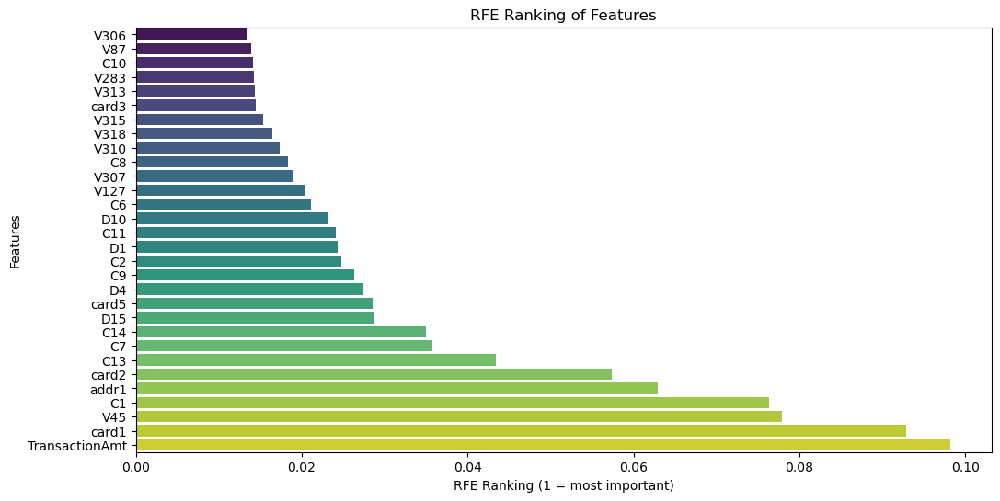

In [78]:
plt.figure(figsize=(12,6))
sns.barplot(x='Importance', y='Feature', data=rfe_get.sort_values('Importance'), palette="viridis")
plt.title("RFE Ranking of Features")
plt.xlabel("RFE Ranking (1 = most important)")
plt.ylabel("Features")
plt.show()

In [18]:
# checkpoint

# rfe_get.to_csv("rfe_get.csv",sep='+')
# kbest_get.to_csv("kbest_get.csv",sep='+')
# mif_get.to_csv("mif_get.csv",sep='+')
# corelation.to_csv("corelation.csv",sep='+')
# mrmr_get.to_csv("mrmr_get.csv",sep='+')

In [115]:
# df_concat_imp = pd.read_csv("df_concat_imp.csv",sep='+')
# df_train = pd.read_csv("df_train.csv",sep='+')
# df_backtest = pd.read_csv("df_backtest.csv",sep='+')

# rfe_get = pd.read_csv("rfe_get.csv",sep='+')
# kbest_get = pd.read_csv("kbest_get.csv",sep='+')
# mif_get = pd.read_csv("mif_get.csv",sep='+')
# corelation = pd.read_csv("corelation.csv",sep='+')

In [11]:
### MRMR Classification

X_ = df_concat_imp.select_dtypes(include=[np.number]).drop(columns=['TransactionID_1','TransactionDT','isFraud'], errors='ignore')
y_ = df_concat_imp['isFraud']
selected_features = mrmr_classif(
    X=X_,
    y=y_,
    K=30  
)

# karena mrmr hanya menampilkan nama feature saja maka untuk scoring dapat menggunakan subtitusi mutual info
mi_scores = mutual_info_classif(X_[selected_features], y_, discrete_features='auto')
importance_df = pd.DataFrame({
    'Feature': selected_features,
    'mrmr_mutual_info_score': mi_scores
}).sort_values(by='mrmr_mutual_info_score', ascending=False)

importance_df

100%|██████████████████████████████████████████████████████████████████████████████████| 30/30 [01:30<00:00,  3.00s/it]


,Feature,mrmr_mutual_info_score
15,V23,0.157209
11,V123,0.156676
19,V77,0.155812
6,V87,0.151173
12,V47,0.136880
3,V86,0.134330
26,V112,0.123819
14,V38,0.112906
18,V113,0.111669
0,V45,0.106899


In [12]:
mrmr_get = importance_df.reset_index(drop=True)
mrmr_get

,Feature,mrmr_mutual_info_score
0,V23,0.157209
1,V123,0.156676
2,V77,0.155812
3,V87,0.151173
4,V47,0.136880
5,V86,0.134330
6,V112,0.123819
7,V38,0.112906
8,V113,0.111669
9,V45,0.106899


In [15]:
# Voting fitur yang akan digunakan

corr = corelation['Feature'].tolist()
mif = mif_get['Feature'].tolist()
rfe = rfe_get['Feature'].tolist()
kbest = kbest_get['Feature'].tolist()
mrmr = mrmr_get['Feature'].tolist()

combined = corr + mif + rfe + kbest + mrmr
Counter(combined)

Counter({'V87': 5,
         'V86': 4,
         'V45': 4,
         'V18': 3,
         'V94': 3,
         'V43': 3,
         'V38': 3,
         'V39': 3,
         'V79': 3,
         'V40': 3,
         'V51': 3,
         'V52': 3,
         'V44': 3,
         'card3': 3,
         'V29': 2,
         'V49': 2,
         'D15': 2,
         'D10': 2,
         'D1': 2,
         'D4': 2,
         'V17': 2,
         'V33': 2,
         'V23': 2,
         'V77': 2,
         'V123': 2,
         'V47': 2,
         'V112': 2,
         'V315': 2,
         'V283': 2,
         'V37': 2,
         'V90': 1,
         'V69': 1,
         'V70': 1,
         'V91': 1,
         'V30': 1,
         'V48': 1,
         'V35': 1,
         'V36': 1,
         'V12': 1,
         'addr2': 1,
         'V114': 1,
         'V67': 1,
         'V88': 1,
         'V122': 1,
         'V110': 1,
         'V66': 1,
         'V26': 1,
         'V41': 1,
         'V115': 1,
         'V62': 1,
         'V14': 1,
         'V25': 1,
  

In [33]:
selected_keys_num = [k for k, v in Counter(combined).items() if v >= 3]
selected_keys_num

['V18',
 'V94',
 'V43',
 'V38',
 'V39',
 'V79',
 'V40',
 'V51',
 'V52',
 'V44',
 'V87',
 'V86',
 'V45',
 'card3']

In [34]:
len(selected_keys_num)

14

In [ ]:
# FEATURE CATEGORICAL

In [35]:
df_cat

,ProductCD,card4,card6,P_emaildomain,M6
0,W,discover,credit,gmail.com,T
1,W,mastercard,credit,gmail.com,T
2,W,visa,debit,outlook.com,F
3,W,mastercard,debit,yahoo.com,F
4,H,mastercard,credit,gmail.com,F
...,...,...,...,...,...
590535,W,visa,debit,gmail.com,F
590536,W,mastercard,debit,gmail.com,T
590537,W,mastercard,debit,gmail.com,T
590538,W,mastercard,debit,aol.com,T


In [48]:
### CRAMMERS V

results = []

for col in df_cat:
    chi2, p, cramers_v_score = cramers_v_eval(df_cat[col], df_concat_imp['isFraud'])
    results.append({
        'Feature': col,
        'Chi2': round(chi2, 4),
        'p-value': round(p, 4),
        "Cramér's V": round(cramers_v_score, 4),
        'Significant (p < 0.05)': p < 0.05
    })

# Create DataFrame
cramers_df = pd.DataFrame(results).sort_values(by="Cramér's V", ascending=False).reset_index(drop=True)
top_features_cram = cramers_df[cramers_df["Cramér's V"] > 0.1]['Feature'].tolist()

print(top_features_cram)
cramers_df

['ProductCD', 'card6']


,Feature,Chi2,p-value,Cramér's V,Significant (p < 0.05)
0,ProductCD,16742.1715,0.0,0.1684,True
1,card6,5966.2866,0.0,0.1005,True
2,P_emaildomain,3308.6232,0.0,0.0742,True
3,M6,2740.6063,0.0,0.0681,True
4,card4,365.3347,0.0,0.0248,True


In [50]:
### Target Encoder

features = df_cat.columns.tolist()
encoder = ce.TargetEncoder(cols=features)
encoder.fit(df_cat, df_concat_imp['isFraud'])
encoded_df = encoder.transform(df_cat)
encoded_df['isFraud'] = df_concat_imp['isFraud']

# Menghitung korelasi pearson feature dengan label
correlation_df = encoded_df.corr()['isFraud'].reset_index()
correlation_df.columns = ['Feature', 'Correlation']

# Filter feature dengan nilai korelasi diatas 0,1
correlation_df_filtered = correlation_df[(correlation_df['Feature'] != 'isFraud') & (correlation_df['Correlation'].abs() > 0.1)]
correlation_df_filtered = correlation_df_filtered.sort_values(by='Correlation', ascending=False).reset_index(drop=True)
selected_features_enc = correlation_df_filtered['Feature'].tolist()

print(selected_features_enc)
correlation_df_filtered

['ProductCD', 'card6']


,Feature,Correlation
0,ProductCD,0.168376
1,card6,0.100512


In [52]:
# Voting fitur yang akan digunakan

combined = top_features_cram + selected_features_enc
Counter(combined)

Counter({'ProductCD': 2, 'card6': 2})

In [59]:
# Final Fitur
cat_feature_get = [k for k, v in Counter(combined).items()]

final_feature = selected_keys_num + cat_feature_get
final_feature

['V18',
 'V94',
 'V43',
 'V38',
 'V39',
 'V79',
 'V40',
 'V51',
 'V52',
 'V44',
 'V87',
 'V86',
 'V45',
 'card3',
 'ProductCD',
 'card6']

In [57]:
# Mengecek multikolinearitas dengan VIF pada final dataset

# Drop multikolinear numerik > 10
X = df_concat_imp[final_feature].select_dtypes(include=[np.number]).copy()
X = X.drop(columns=['isFraud'], errors='ignore')
X_cleaned, final_vif = remove_high_vif_features(X)

Dropping 'V51' with VIF = 23.91
Dropping 'V40' with VIF = 12.65
Dropping 'V94' with VIF = 10.36


In [61]:
list_final_vif = final_vif['Feature'].tolist()
print()

final_vif

,Feature,VIF
0,V18,3.229321
1,V43,5.208784
2,V38,1.981556
3,V39,4.206331
4,V79,4.878497
5,V52,4.682366
6,V44,7.608176
7,V87,4.927331
8,V86,4.778444
9,V45,8.912217


## Feature Transformation

In [34]:
# Checkpoint
# df_concat_final.to_csv("df_concat_final.csv",sep='+')

df_concat_final = pd.read_csv("df_concat_final.csv",sep='+')
df_concat_final

,Unnamed: 0,V18,V43,V38,V39,V79,V52,V44,V87,V86,V45,card3,ProductCD,card6,isFraud
0,0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,credit,0
1,1,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,credit,0
2,2,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,debit,0
3,3,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,debit,0
4,4,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,H,credit,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
590535,590535,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,debit,0
590536,590536,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,debit,0
590537,590537,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,debit,0
590538,590538,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,150.0,W,debit,0


In [35]:
# Dataset final dilihat kembali atributnya sebelum dilakukan pemisahan train test split dan transformasi

# df_concat_final = df_concat_imp[list_final_vif + cat_feature_get + ['isFraud']]
df_concat_final = df_concat_final[['V18', 'V43', 'V38', 'V39', 'V79', 'V52', 'V44', 'V87', 'V86', 'V45',
    'card3', 'ProductCD', 'card6', 'isFraud']]

df_concat_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 590540 entries, 0 to 590539
Data columns (total 14 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   V18        590540 non-null  float64
 1   V43        590540 non-null  float64
 2   V38        590540 non-null  float64
 3   V39        590540 non-null  float64
 4   V79        590540 non-null  float64
 5   V52        590540 non-null  float64
 6   V44        590540 non-null  float64
 7   V87        590540 non-null  float64
 8   V86        590540 non-null  float64
 9   V45        590540 non-null  float64
 10  card3      590540 non-null  float64
 11  ProductCD  590540 non-null  object 
 12  card6      590540 non-null  object 
 13  isFraud    590540 non-null  int64  
dtypes: float64(11), int64(1), object(2)
memory usage: 63.1+ MB


In [138]:
# Melakukan pemisahan variabel X dan Y

X = df_concat_final.drop(['isFraud'],axis=1)
Y = df_concat_final['isFraud']

In [139]:
# Melihat jumlah data label

Y.value_counts(normalize=False)

isFraud
0    569877
1     20663
Name: count, dtype: int64

In [140]:
# Melihat rasio label 0 dan 1

Y.value_counts(normalize=True)

isFraud
0    0.96501
1    0.03499
Name: proportion, dtype: float64

In [141]:
# Melakukan pemisahan train test split

X_train,X_test,y_train,y_test = train_test_split(X,Y,test_size=0.3,stratify=Y,random_state=42)

In [142]:
# Melihat ukuran dataset dari train test

print('X train :',X_train.shape)
print('y train :',y_train.shape)
print('X test :',X_test.shape)
print('y test :',y_test.shape)

X train : (413378, 13)
y train : (413378,)
X test : (177162, 13)
y test : (177162,)


In [143]:
X_train

,V18,V43,V38,V39,V79,V52,V44,V87,V86,V45,card3,ProductCD,card6
335947,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,debit
334070,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,debit
551523,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,185.0,C,debit
159780,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,debit
270154,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,150.0,W,debit
...,...,...,...,...,...,...,...,...,...,...,...,...,...
478411,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,185.0,C,credit
342767,0.0,0.0,1.0,0.0,2.0,1.0,1.0,1.0,1.0,1.0,185.0,C,credit
324259,0.0,0.0,1.0,0.0,0.0,0.0,1.0,2.0,1.0,1.0,150.0,W,debit
396067,1.0,2.0,3.0,2.0,1.0,2.0,4.0,3.0,3.0,4.0,185.0,C,debit


In [17]:
# Data Train

In [144]:
# Memishakan data kategorikal dan kontinu

X_train_num = X_train.select_dtypes('number')
X_train_cat = X_train.select_dtypes('object')


Iterasi ke- 1
Kolom :  V18


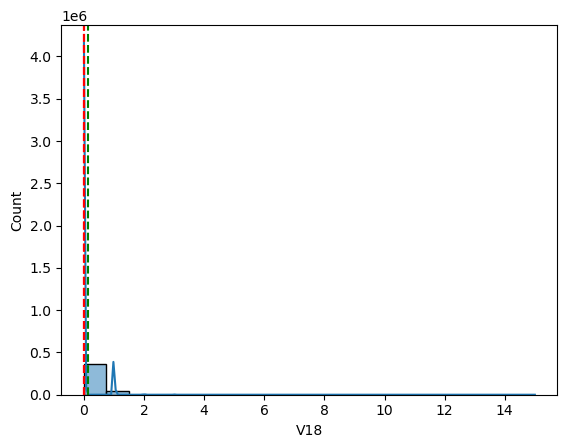


46942
413378
jumlah outlier:11.355708334744472
Nilai median :  0.0
Nilai mean :  0.11847993845826338
Delta (Mean - Median): 0.11847993845826338
Skew Value :  4.313877434434193
Skew Test Value :  SkewtestResult(statistic=507.2053148263363, pvalue=0.0)
Skewness: Positive Skew (Right Skew)
count    413378.000000
mean          0.118480
std           0.349902
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          15.000000
Name: V18, dtype: float64


Iterasi ke- 2
Kolom :  V43


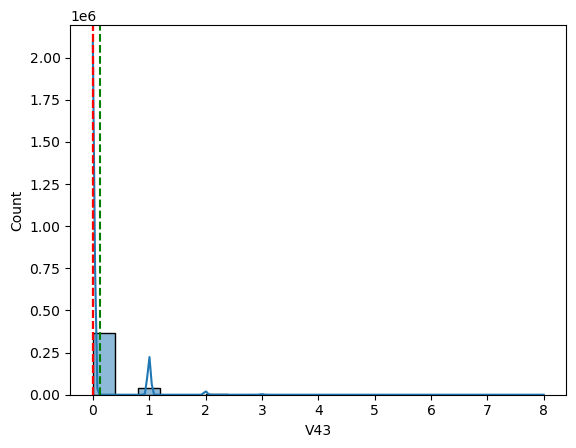


44533
413378
jumlah outlier:10.772948729734043
Nilai median :  0.0
Nilai mean :  0.12107562569851323
Delta (Mean - Median): 0.12107562569851323
Skew Value :  3.794703972806493
Skew Test Value :  SkewtestResult(statistic=480.2667893161714, pvalue=0.0)
Skewness: Positive Skew (Right Skew)
count    413378.000000
mean          0.121076
std           0.374467
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           8.000000
Name: V43, dtype: float64


Iterasi ke- 3
Kolom :  V38


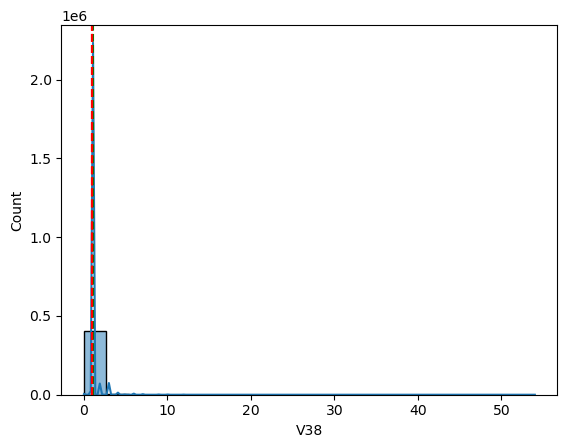


27658
413378
jumlah outlier:6.690728582556401
Nilai median :  1.0
Nilai mean :  1.1157052383048929
Delta (Mean - Median): 0.11570523830489288
Skew Value :  21.231120865081333
Skew Test Value :  SkewtestResult(statistic=846.9446087537119, pvalue=0.0)
Skewness: Positive Skew (Right Skew)
count    413378.000000
mean          1.115705
std           0.724357
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          54.000000
Name: V38, dtype: float64


Iterasi ke- 4
Kolom :  V39


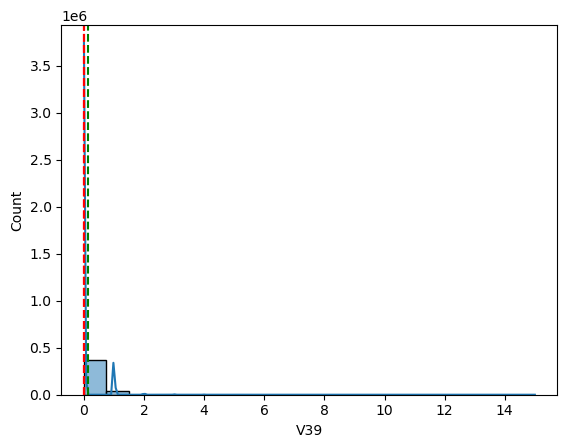


44717
413378
jumlah outlier:10.817460048672158
Nilai median :  0.0
Nilai mean :  0.11910406456076521
Delta (Mean - Median): 0.11910406456076521
Skew Value :  7.314708841331315
Skew Test Value :  SkewtestResult(statistic=619.1497162876424, pvalue=0.0)
Skewness: Positive Skew (Right Skew)
count    413378.000000
mean          0.119104
std           0.391456
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          15.000000
Name: V39, dtype: float64


Iterasi ke- 5
Kolom :  V79


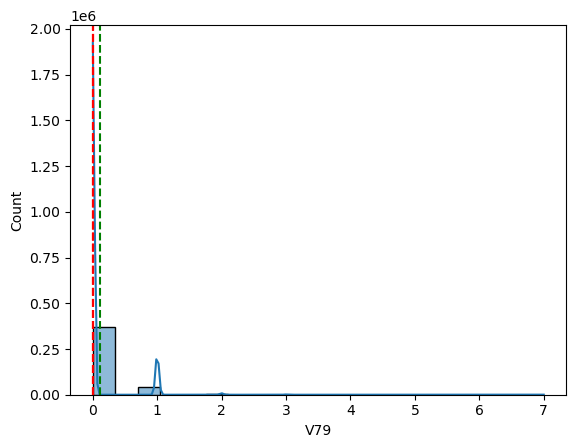


45408
413378
jumlah outlier:10.984619404032145
Nilai median :  0.0
Nilai mean :  0.11675512484941143
Delta (Mean - Median): 0.11675512484941143
Skew Value :  4.29973634713288
Skew Test Value :  SkewtestResult(statistic=506.5139109207207, pvalue=0.0)
Skewness: Positive Skew (Right Skew)
count    413378.000000
mean          0.116755
std           0.354697
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           7.000000
Name: V79, dtype: float64


Iterasi ke- 6
Kolom :  V52


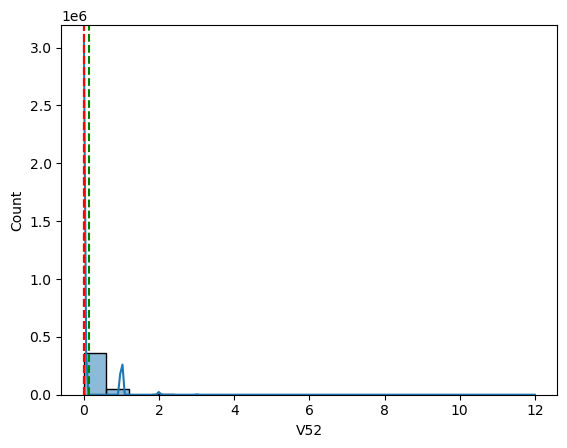


49430
413378
jumlah outlier:11.95757877777724
Nilai median :  0.0
Nilai mean :  0.1308608585846368
Delta (Mean - Median): 0.1308608585846368
Skew Value :  3.9939980496106755
Skew Test Value :  SkewtestResult(statistic=491.0035796162997, pvalue=0.0)
Skewness: Positive Skew (Right Skew)
count    413378.000000
mean          0.130861
std           0.380440
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          12.000000
Name: V52, dtype: float64


Iterasi ke- 7
Kolom :  V44


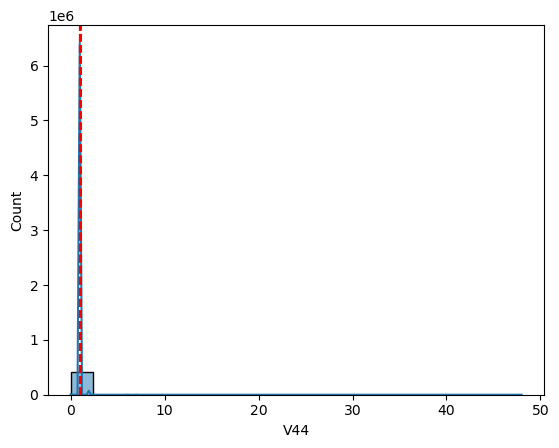


16791
413378
jumlah outlier:4.061899762445026
Nilai median :  1.0
Nilai mean :  1.0599427158678014
Delta (Mean - Median): 0.05994271586780142
Skew Value :  33.453885910909584
Skew Test Value :  SkewtestResult(statistic=944.3507074456768, pvalue=0.0)
Skewness: Positive Skew (Right Skew)
count    413378.000000
mean          1.059943
std           0.541912
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          48.000000
Name: V44, dtype: float64


Iterasi ke- 8
Kolom :  V87


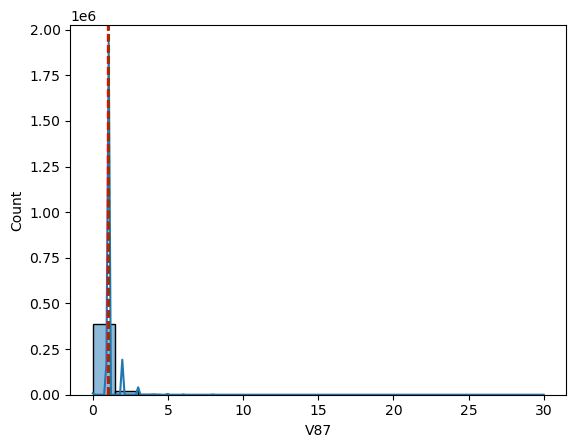


26448
413378
jumlah outlier:6.398018278669886
Nilai median :  1.0
Nilai mean :  1.0843634639482507
Delta (Mean - Median): 0.08436346394825067
Skew Value :  15.841371826465362
Skew Test Value :  SkewtestResult(statistic=784.2441204283309, pvalue=0.0)
Skewness: Positive Skew (Right Skew)
count    413378.000000
mean          1.084363
std           0.469446
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          30.000000
Name: V87, dtype: float64


Iterasi ke- 9
Kolom :  V86


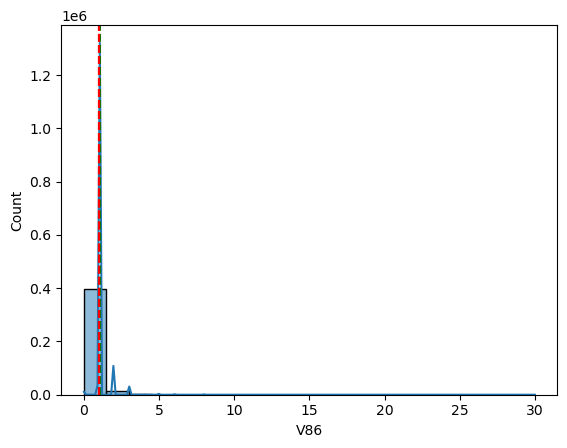


17158
413378
jumlah outlier:4.150680490979201
Nilai median :  1.0
Nilai mean :  1.0547948850688715
Delta (Mean - Median): 0.054794885068871535
Skew Value :  18.136465713053404
Skew Test Value :  SkewtestResult(statistic=813.208471715737, pvalue=0.0)
Skewness: Positive Skew (Right Skew)
count    413378.000000
mean          1.054795
std           0.384305
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          30.000000
Name: V86, dtype: float64


Iterasi ke- 10
Kolom :  V45


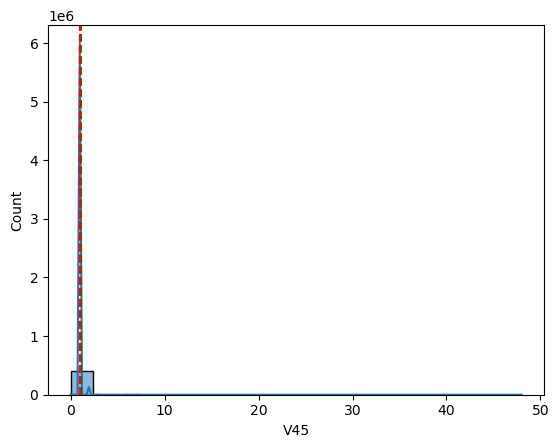


24194
413378
jumlah outlier:5.85275462167798
Nilai median :  1.0
Nilai mean :  1.0864003406083536
Delta (Mean - Median): 0.08640034060835355
Skew Value :  26.759867565343374
Skew Test Value :  SkewtestResult(statistic=896.5175427362211, pvalue=0.0)
Skewness: Positive Skew (Right Skew)
count    413378.000000
mean          1.086400
std           0.620936
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          48.000000
Name: V45, dtype: float64


Iterasi ke- 11
Kolom :  card3


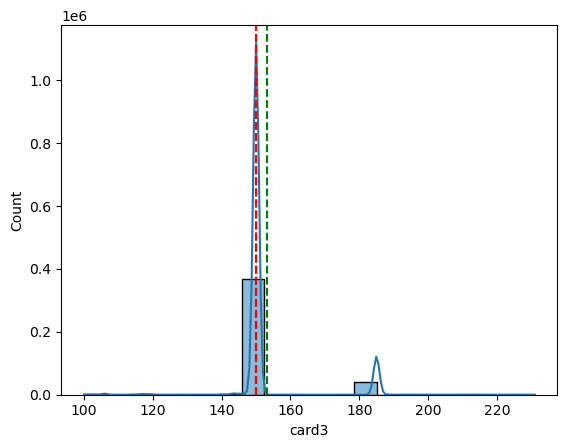


47570
413378
jumlah outlier:11.507627401554993
Nilai median :  150.0
Nilai mean :  153.2014306518489
Delta (Mean - Median): 3.2014306518489093
Skew Value :  2.021320290460582
Skew Test Value :  SkewtestResult(statistic=351.0865555060303, pvalue=0.0)
Skewness: Positive Skew (Right Skew)
count    413378.000000
mean        153.201431
std          11.341384
min         100.000000
25%         150.000000
50%         150.000000
75%         150.000000
max         231.000000
Name: card3, dtype: float64



In [81]:
# Check sebaran distribusi data

list_kontinu = X_train_num.columns.tolist()
iter = 1
for i in list_kontinu:
  print()
  print('Iterasi ke-',iter)
  print('Kolom : ',i)
  sns.histplot(X_train_num[i],kde=True)
  plt.axvline(np.mean(X_train_num[i]),c='green',linestyle='--')
  plt.axvline(np.percentile(X_train_num[i],25),c='red',linestyle='--')
  plt.axvline(np.percentile(X_train_num[i],50),c='red',linestyle='--')
  plt.axvline(np.percentile(X_train_num[i],75),c='red',linestyle='--')
  plt.show()
    
  Q1 = np.percentile(X_train_num[i],25)
  Q2 = np.percentile(X_train_num[i],50)
  Q3 = np.percentile(X_train_num[i],75)
  IQR = Q3-Q1

  upper_f = Q3 + 1.5 * IQR
  lower_f = Q1 - 1.5 * IQR

  upper_w = np.max(X_train_num[X_train_num[i] <= upper_f][i])
  lower_w = np.min(X_train_num[X_train_num[i] >= lower_f][i])
  outlier = list(X_train_num[(X_train_num[i] < lower_w) | (X_train_num[i] > upper_f)][i])

  # Hitung delta
  mean_val = np.mean(X_train_num[i])
  median_val = np.percentile(X_train_num[i],50)
  delta = mean_val - median_val
    
    # Interpretasi
  if delta > 0:
        skew_direction = "Positive Skew (Right Skew)"
  elif delta < 0:
        skew_direction = "Negative Skew (Left Skew)"
  else:
        skew_direction = "No Skew (Symmetric)"
  print()
  print(len(outlier))
  print(len(X_train_num[i]))
  print('jumlah outlier:{}'.format(len(outlier)/len(X_train_num[i])*100))
  print('Nilai median : ',median_val)
  print('Nilai mean : ',mean_val)
  print('Delta (Mean - Median): {}'.format(delta))
  print('Skew Value : ',skew(X_train_num[i]))
  print('Skew Test Value : ',skewtest(X_train_num[i]))
  print('Skewness: {}'.format(skew_direction))
  print(X_train_num[i].describe())
  iter+=1
  print()

1. Min-Max Scaler = Jika data tidak banyak outlier, ingin skala [0,1]
2. Standard Scaler	= Jika data normal (distribusi Gaussian)
3. Robust Scaler = Jika banyak outlier
4. MaxAbs Scaler = Jika data sparse
5. Quantile Transformer = Jika distribusi ingin menjadi rapi/normal, sensitif terhadap outlier
6. Power Transformer = Jika distribusi ingin menyerupai rapi/normal, lebih tahan terhadap outlier

Berdasarkan bentuk distribusi dari feature numerical, ditentukan menggunakan jenis power transformer

In [145]:
# Melakukan scaling

pt = PowerTransformer(method='yeo-johnson')
X_train_num_sc = pd.DataFrame(pt.fit_transform(X_train_num),columns = pt.get_feature_names_out(X_train_num.columns))
X_train_num_sc

,V18,V43,V38,V39,V79,V52,V44,V87,V86,V45,card3
0,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976
1,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976
2,2.793933,2.877881,-0.209197,2.871264,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,2.515003
3,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976
4,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976
...,...,...,...,...,...,...,...,...,...,...,...
413373,2.793933,2.877881,-0.209197,2.871264,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,2.515003
413374,-0.357917,-0.347471,-0.209197,-0.348275,2.847143,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,2.515003
413375,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,2.945972,-0.142541,-0.190686,-0.225976
413376,2.793933,2.878424,3.702654,2.871739,2.846668,2.714475,5.676467,4.092206,5.032209,4.672508,2.515003


In [146]:
# Melakukan encoder

ohe = OneHotEncoder(handle_unknown='ignore')
X_train_cat_enc = pd.DataFrame(ohe.fit_transform(X_train_cat).toarray(),columns =ohe.get_feature_names_out(X_train_cat.columns))
X_train_cat_enc

,ProductCD_C,ProductCD_H,ProductCD_R,ProductCD_S,ProductCD_W,card6_charge card,card6_credit,card6_debit,card6_debit or credit
0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
1,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
2,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...
413373,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
413374,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
413375,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
413376,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [147]:
# Menggabungkan kedua jenis data menjadi satu

X_train_concat = pd.concat([X_train_num_sc, X_train_cat_enc], axis = 1)
X_train_concat

,V18,V43,V38,V39,V79,V52,V44,V87,V86,V45,card3,ProductCD_C,ProductCD_H,ProductCD_R,ProductCD_S,ProductCD_W,card6_charge card,card6_credit,card6_debit,card6_debit or credit
0,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
1,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
2,2.793933,2.877881,-0.209197,2.871264,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
4,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
413373,2.793933,2.877881,-0.209197,2.871264,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
413374,-0.357917,-0.347471,-0.209197,-0.348275,2.847143,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
413375,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,2.945972,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
413376,2.793933,2.878424,3.702654,2.871739,2.846668,2.714475,5.676467,4.092206,5.032209,4.672508,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [148]:
# Dikarenakan data terlalu imbalance (96:4) maka perlu dilakukan tindakan undersampling secara hati-hati dengan kombinasi
# Tindakan undersampling hanya dilakukan pada data train, yakni tomeklinks dan nearmiss

# 1. Bersihkan data yang dekat boundary overlap dengan TomekLinks
tl = TomekLinks()
X_clean, y_clean = tl.fit_resample(X_train_concat, y_train)

# 2. Balance data dengan proporsi yang diinginkan menggunakan randomundersampling
rus = RandomUnderSampler(sampling_strategy=0.3, random_state=42)
X_resampled, y_resampled = rus.fit_resample(X_clean, y_clean)

# 2. Balance data dengan NearMiss, v1 memilih majority dengan rata-rata jarak terdekat terkecil ke minority
# nm = NearMiss(version=1)
# X_resampled, y_resampled = nm.fit_resample(X_clean, y_clean)

In [149]:
X_resampled

,V18,V43,V38,V39,V79,V52,V44,V87,V86,V45,card3,ProductCD_C,ProductCD_H,ProductCD_R,ProductCD_S,ProductCD_W,card6_charge card,card6_credit,card6_debit,card6_debit or credit
171324,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
92928,-0.357917,-0.347471,2.812013,-0.348275,-0.351285,-0.368532,-0.149020,2.945972,-0.142541,3.110591,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
236684,2.793933,2.877881,2.812013,2.871264,2.846668,2.713384,3.675063,2.945972,3.563300,3.110591,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
174191,2.793933,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
22693,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
413182,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
413222,2.793933,2.877881,2.812013,2.871739,2.847143,2.713384,3.675063,-0.193676,-0.142541,3.110591,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
413227,2.793933,2.878424,4.246127,2.871742,2.846668,2.713384,6.027063,4.943625,6.210398,4.923094,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
413234,2.793933,2.877881,4.536793,2.871264,2.846668,2.713384,5.037596,4.092206,5.032209,4.193935,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [150]:
y_resampled.value_counts(normalize=False)

isFraud
0    48213
1    14464
Name: count, dtype: int64

In [ ]:
# Data Test

In [151]:
# Memisahkan data kategorikal dan kontinu data test

X_test_num = X_test.select_dtypes('number')
X_test_cat = X_test.select_dtypes('object')

In [152]:
# Melakukan scaling

X_test_num_sc = pd.DataFrame(pt.transform(X_test_num),columns = pt.get_feature_names_out(X_test_num.columns))
X_test_num_sc

,V18,V43,V38,V39,V79,V52,V44,V87,V86,V45,card3
0,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976
1,2.793933,2.877881,-0.209197,2.871264,2.846668,2.713384,-0.14902,-0.193676,-0.142541,-0.190686,2.515003
2,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976
3,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976
4,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976
...,...,...,...,...,...,...,...,...,...,...,...
177157,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976
177158,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976
177159,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976
177160,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976


In [153]:
# Melakukan encoder

X_test_cat_enc = pd.DataFrame(ohe.transform(X_test_cat).toarray(),columns =ohe.get_feature_names_out(X_test_cat.columns))
X_test_cat_enc

,ProductCD_C,ProductCD_H,ProductCD_R,ProductCD_S,ProductCD_W,card6_charge card,card6_credit,card6_debit,card6_debit or credit
0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
3,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...
177157,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
177158,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
177159,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
177160,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [154]:
# Menggabungkan kedua jenis data menjadi satu

X_test_concat = pd.concat([X_test_num_sc, X_test_cat_enc], axis = 1)
X_test_concat

,V18,V43,V38,V39,V79,V52,V44,V87,V86,V45,card3,ProductCD_C,ProductCD_H,ProductCD_R,ProductCD_S,ProductCD_W,card6_charge card,card6_credit,card6_debit,card6_debit or credit
0,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
1,2.793933,2.877881,-0.209197,2.871264,2.846668,2.713384,-0.14902,-0.193676,-0.142541,-0.190686,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
3,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
4,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177157,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
177158,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
177159,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
177160,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.14902,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [155]:
# Membuat dataframe feature final yang digunakan modeling

X_train_final = X_resampled.copy()
X_test_final = X_test_concat.copy()
y_train = y_resampled.copy()

In [156]:
# Melihat ukuran data train dan test final

print('X train final :',X_train_final.shape)
print('y train final :',y_train.shape)
print('X test final :',X_test_final.shape)
print('y test final :',y_test.shape)

X train final : (62677, 20)
y train final : (62677,)
X test final : (177162, 20)
y test final : (177162,)


In [4]:
### Checkpoint

# X_train_concat.to_csv("X_train_concat.csv",sep='+')
# X_test_concat.to_csv("X_test_concat.csv",sep='+')

# y_train.to_csv("y_train.csv",sep='+') 
# y_test.to_csv("y_test.csv",sep='+')

# X_train_concat = pd.read_csv("X_train_concat.csv",sep='+')
# X_test_concat = pd.read_csv("X_test_concat.csv",sep='+')

# y_train = pd.read_csv("y_train.csv",sep='+') 
# y_test = pd.read_csv("y_test.csv",sep='+')

X_train_concat = X_train_concat.drop('Unnamed: 0',axis=1)
X_test_concat = X_test_concat.drop('Unnamed: 0',axis=1)
y_train = y_train.drop('Unnamed: 0',axis=1)
y_test = y_test.drop('Unnamed: 0',axis=1)

In [157]:
X_train_final

,V18,V43,V38,V39,V79,V52,V44,V87,V86,V45,card3,ProductCD_C,ProductCD_H,ProductCD_R,ProductCD_S,ProductCD_W,card6_charge card,card6_credit,card6_debit,card6_debit or credit
171324,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
92928,-0.357917,-0.347471,2.812013,-0.348275,-0.351285,-0.368532,-0.149020,2.945972,-0.142541,3.110591,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
236684,2.793933,2.877881,2.812013,2.871264,2.846668,2.713384,3.675063,2.945972,3.563300,3.110591,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
174191,2.793933,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
22693,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
413182,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
413222,2.793933,2.877881,2.812013,2.871739,2.847143,2.713384,3.675063,-0.193676,-0.142541,3.110591,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
413227,2.793933,2.878424,4.246127,2.871742,2.846668,2.713384,6.027063,4.943625,6.210398,4.923094,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
413234,2.793933,2.877881,4.536793,2.871264,2.846668,2.713384,5.037596,4.092206,5.032209,4.193935,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


# **Modelling**

In [158]:
# Mendeklarasikan fungsi yang dibutuhkan

def classif(estimator, x, y):
    y_pred = estimator.predict(x)
    print(classification_report(y, y_pred, labels=[1,0]))

def list_metrics_model(model, y_test, y_pred):
    from sklearn import metrics
    report = metrics.classification_report(y_test, y_pred, output_dict=True)
    
    # Extract precision, recall, etc
    preci = report['1']['precision']  # Precision class 1
    reca = report['1']['recall']      # Recall class 1
    tnr = report['0']['recall']        # Recall class 0 = True Negative Rate
    fpr = 1 - tnr                      # FPR = 1 - TNR
    npv = report['0']['precision']     # NPV = Precision class 0
    f1 = report['1']['f1-score']       # F1-score class 1
    acc = report['accuracy']           # Overall Accuracy

    output_list = [model, preci, reca, tnr, fpr, npv, f1, acc]
    return output_list


In [235]:
# Mendeklarasikan model-model klasifikasi (prioritas tahan outlier dan imbalance)

rf = RandomForestClassifier(random_state=42)
xg = XGBClassifier(random_state=42)
lg = LGBMClassifier(random_state=42)
iso = IsolationForest(contamination=0.05, random_state=42)

In [236]:
# Melakukan fitting

rf.fit(X_train_final, y_train)
y_train_pred_rf = rf.predict(X_train_final)
y_test_pred_rf = rf.predict(X_test_final)

xg.fit(X_train_final, y_train)
y_train_pred_xg = xg.predict(X_train_final)
y_test_pred_xg = xg.predict(X_test_final)

lg.fit(X_train_final, y_train)
y_train_pred_lg = lg.predict(X_train_final)
y_test_pred_lg = lg.predict(X_test_final)


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 14464, number of negative: 48213
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004593 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 287
[LightGBM] [Info] Number of data points in the train set: 62677, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.230770 -> initscore=-1.203966
[LightGBM] [Info] Start training from score -1.203966


In [239]:
# Membuat list metrics dan membuat dataframe tiap model

train_metric_rf = list_metrics_model('RF_train',y_train,y_train_pred_rf)
test_metric_rf = list_metrics_model('RF_test',y_test,y_test_pred_rf)
df_rf_train = pd.DataFrame(train_metric_rf).T
df_rf_test = pd.DataFrame(test_metric_rf).T
df_rf_train.columns=['model','precision','recall','TNR','FPR','NPV','f1_score','accuracy']
df_rf_test.columns=['model','precision','recall','TNR','FPR','NPV','f1_score','accuracy']

train_metric_xg = list_metrics_model('xg_train',y_train,y_train_pred_xg)
test_metric_xg = list_metrics_model('xg_test',y_test,y_test_pred_xg)
df_xg_train = pd.DataFrame(train_metric_xg).T
df_xg_test = pd.DataFrame(test_metric_xg).T
df_xg_train.columns=['model','precision','recall','TNR','FPR','NPV','f1_score','accuracy']
df_xg_test.columns=['model','precision','recall','TNR','FPR','NPV','f1_score','accuracy']

train_metric_lg = list_metrics_model('lg_train',y_train,y_train_pred_lg)
test_metric_lg = list_metrics_model('lg_test',y_test,y_test_pred_lg)
df_lg_train = pd.DataFrame(train_metric_lg).T
df_lg_test = pd.DataFrame(test_metric_lg).T
df_lg_train.columns=['model','precision','recall','TNR','FPR','NPV','f1_score','accuracy']
df_lg_test.columns=['model','precision','recall','TNR','FPR','NPV','f1_score','accuracy']

## Model Selection

In [241]:
# Memilih satu model terbaik untuk dilakukan tuning 
# Menyatukan keseluruhan model dataframe dan melihat hasil prediksi

df_classification_all = pd.concat([df_rf_train,df_rf_test,
                                   df_xg_train,df_xg_test,
                                   df_lg_train,df_lg_test]).reset_index()
df_classification_all = df_classification_all.drop(['index'],axis=1)
df_classification_all

,model,precision,recall,TNR,FPR,NPV,f1_score,accuracy
0,RF_train,0.876976,0.318377,0.986601,0.013399,0.828318,0.467157,0.832395
1,RF_test,0.378088,0.306178,0.981739,0.018261,0.975015,0.338355,0.9581
2,xg_train,0.857333,0.311186,0.984465,0.015535,0.82651,0.45663,0.829092
3,xg_test,0.387901,0.306178,0.982482,0.017518,0.975033,0.342229,0.958817
4,lg_train,0.851479,0.304411,0.984071,0.015929,0.825044,0.448485,0.827225
5,lg_test,0.391722,0.302307,0.982979,0.017021,0.97491,0.341255,0.959162


In [54]:
# Berdasarkan hasil perbandingan kesluruhan model klasifikasi default, akan dipilih satu model untuk dilakukan tunning optimasi
# Kriteria model : Recall, Precision, dan f1 score

# Model default yang dipilih adalah model yang mendekati kriteria tersebut
# Berdasarkan hasil tersebut secara keseluruhan belum ada memenuhi, dengan peringkat:
# 1. Random Forest
# 2. XGBoost
# 3. LGBM


# Meskipun berdasarkan hasil rf yang paling baik, namun untuk kondisi nyata sebaiknya menggunakan :
# 1. lgbm karena training jauh lebih cepat dan hemat memori
# 2. Xgboost karena cocok untuk imbalance dengan ahsil stabil dan kontrol overfit regularisasi

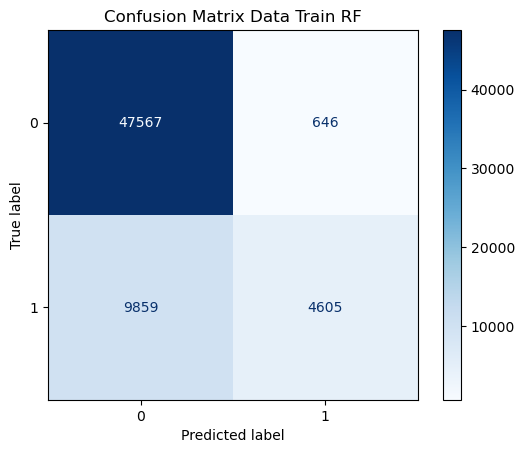

In [169]:
# Confusion matrix train 

y_true = y_train       
y_pred = y_train_pred_rf


confu_map = confusion_matrix(y_true, y_pred)
display = ConfusionMatrixDisplay(confusion_matrix=confu_map, display_labels=rf.classes_)
display.plot(cmap='Blues', values_format='d')

plt.title('Confusion Matrix Data Train RF')
plt.show()

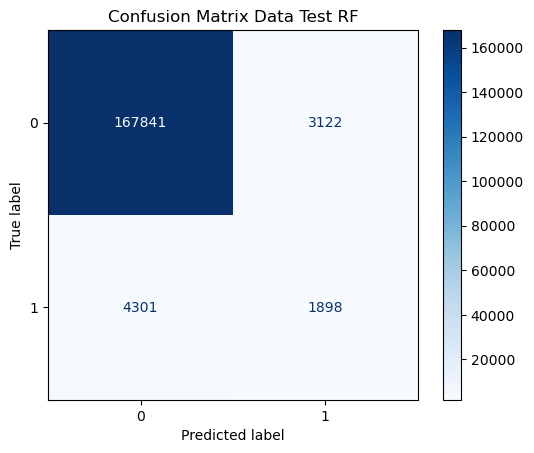

In [170]:
# Confusion matrix test

y_true = y_test      
y_pred = y_test_pred_rf


confu_map = confusion_matrix(y_true, y_pred)
display = ConfusionMatrixDisplay(confusion_matrix=confu_map, display_labels=rf.classes_)
display.plot(cmap='Blues', values_format='d')

plt.title('Confusion Matrix Data Test RF')
plt.show()

In [100]:
# Terlihat disini hasil recall sudah jauh membaik namun malah precision yang jatuh
# Hal ini menandakan model terlalu agresif untuk memberikan flag fraud pada transaksi normal

# Perlu dilakukan tuning kepada model random forest dengan tuning hyperparameter

## Model Tunning

1. Random Forest

In [200]:
# Define Optuna objective function
def objective_rf(trial):
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
        'max_depth': trial.suggest_int('max_depth', 3, 30),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 20),
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 1, 20),
        'max_features': trial.suggest_categorical('max_features', ['sqrt', 'log2', None]),
        'class_weight': trial.suggest_categorical('class_weight', [{0:1, 1:2}, {0:1, 1:3}]),
        'bootstrap': trial.suggest_categorical('bootstrap', [True, False]),
        'random_state': 42,
        'n_jobs': -1
    }

    model = RandomForestClassifier(**params)

    cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

    # Cross-validated predicted probabilities
    y_pred_proba = cross_val_predict(model, X_train_final, y_train, 
                                     cv=cv, method='predict_proba', n_jobs=-1)[:, 1]

    # Adjust threshold
    threshold = trial.suggest_float('threshold', 0.35, 0.45)  # explore wider threshold range
    y_pred = (y_pred_proba >= threshold).astype(int)

    # Calculate metrics
    recall = recall_score(y_train, y_pred, pos_label=1)
    precision = precision_score(y_train, y_pred, pos_label=1)
    f1 = f1_score(y_train, y_pred, pos_label=1)

    # Print recall and precision per trial
    print(f"Trial {trial.number}: Recall={recall:.4f} | Precision={precision:.4f} | F1={f1:.4f} | Threshold={threshold:.3f}")

    # Custom condition
    if precision < 0.35 or recall < 0.7 :
        return 0
    return recall

# Run Optuna study
study_rf = optuna.create_study(direction="maximize", study_name="rf_opt")
study_rf.optimize(objective_rf, n_trials=100, show_progress_bar=True)

# Best RF parameters
print()
print("Best Random Forest Parameters:\n", study_rf.best_params)
print("Best Recall Score RF:", study_rf.best_value)


[I 2025-04-28 14:21:44,517] A new study created in memory with name: rf_opt


  0%|          | 0/100 [00:00<?, ?it/s]

Trial 0: Recall=0.6909 | Precision=0.3991 | F1=0.5059 | Threshold=0.378
[I 2025-04-28 14:21:59,029] Trial 0 finished with value: 0.0 and parameters: {'n_estimators': 710, 'max_depth': 11, 'min_samples_split': 19, 'min_samples_leaf': 10, 'max_features': 'sqrt', 'class_weight': {0: 1, 1: 2}, 'bootstrap': False, 'threshold': 0.37841664726622426}. Best is trial 0 with value: 0.0.
Trial 1: Recall=0.7342 | Precision=0.3816 | F1=0.5022 | Threshold=0.441
[I 2025-04-28 14:22:11,484] Trial 1 finished with value: 0.7342367256637168 and parameters: {'n_estimators': 863, 'max_depth': 30, 'min_samples_split': 3, 'min_samples_leaf': 15, 'max_features': 'sqrt', 'class_weight': {0: 1, 1: 3}, 'bootstrap': True, 'threshold': 0.44108360207033037}. Best is trial 1 with value: 0.7342367256637168.
Trial 2: Recall=0.6744 | Precision=0.4076 | F1=0.5082 | Threshold=0.393
[I 2025-04-28 14:22:29,848] Trial 2 finished with value: 0.0 and parameters: {'n_estimators': 442, 'max_depth': 14, 'min_samples_split': 16, '

In [ ]:
# Best Random Forest Parameters:
#  {'n_estimators': 688, 'max_depth': 25, 'min_samples_split': 7, 'min_samples_leaf': 19, 'max_features': 'log2', 'class_weight': {0: 1, 1: 3}, 'bootstrap': True, 'threshold': 0.35056013406495456}
# Best Recall Score RF: 0.7564988938053098

In [202]:
# Hasil tuning RF dengan best params

rf_best = RandomForestClassifier(
n_estimators = 688, 
max_depth = 25, 
min_samples_split = 7, 
min_samples_leaf = 19, 
max_features = 'log2', 
class_weight = {0: 1, 1: 3},
bootstrap = True
)
rf_best.fit(X_train_final, y_train)
threshold_best = 0.35056013406495456


# Prediksi probabilitas
y_train_pred_proba = rf_best.predict_proba(X_train_final)[:, 1]
y_test_pred_proba = rf_best.predict_proba(X_test_final)[:, 1]

# Convert probabilitas jadi class
y_train_pred_rf_opt = (y_train_pred_proba >= threshold_best).astype(int)
y_test_pred_rf_opt = (y_test_pred_proba >= threshold_best).astype(int)

In [203]:
# Melihat hasil fitting model ada default pada data train

print(classification_report(y_train, y_train_pred_rf_opt, labels=[1,0]))

              precision    recall  f1-score   support

           1       0.37      0.76      0.49     14464
           0       0.89      0.61      0.72     48213

    accuracy                           0.64     62677
   macro avg       0.63      0.68      0.61     62677
weighted avg       0.77      0.64      0.67     62677



In [204]:
# Melihat hasil fitting model ada default pada data test

print(classification_report(y_test, y_test_pred_rf_opt, labels=[1,0]))

              precision    recall  f1-score   support

           1       0.07      0.76      0.12      6199
           0       0.99      0.61      0.75    170963

    accuracy                           0.61    177162
   macro avg       0.53      0.68      0.44    177162
weighted avg       0.95      0.61      0.73    177162



In [243]:
rf_best

RandomForestClassifier(class_weight={0: 1, 1: 3}, max_depth=25,
                       max_features='log2', min_samples_leaf=19,
                       min_samples_split=7, n_estimators=688)

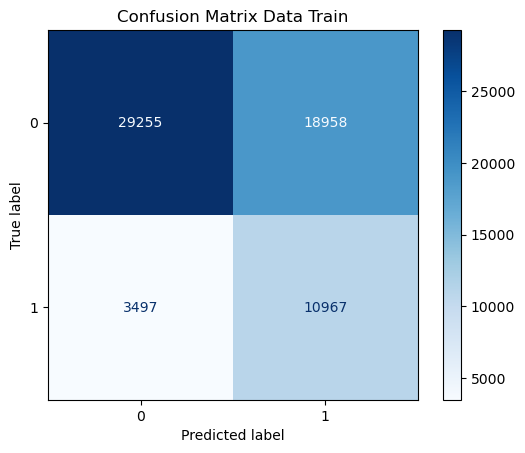

In [205]:
# Confusion matrix train

y_true = y_train       
y_pred = y_train_pred_rf_opt


confu_map = confusion_matrix(y_true, y_pred)
display = ConfusionMatrixDisplay(confusion_matrix=confu_map, display_labels=rf_best.classes_)
display.plot(cmap='Blues', values_format='d')

plt.title('Confusion Matrix Data Train')
plt.show()

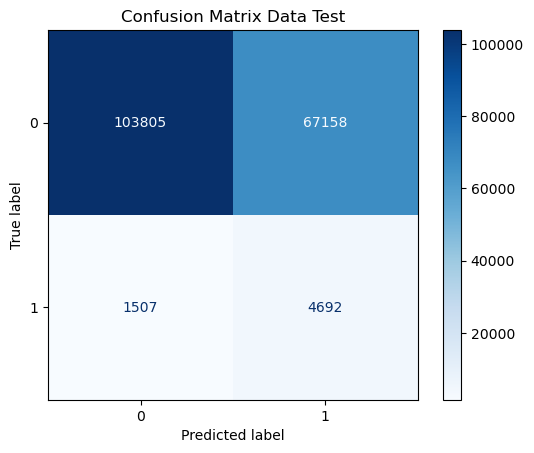

In [206]:
# Confusion matrix test

y_true = y_test    
y_pred = y_test_pred_rf_opt


confu_map = confusion_matrix(y_true, y_pred)
display = ConfusionMatrixDisplay(confusion_matrix=confu_map, display_labels=rf_best.classes_)
display.plot(cmap='Blues', values_format='d')

plt.title('Confusion Matrix Data Test')
plt.show()

2. LGBM

In [215]:
# Define Optuna untuk LightGBM
def objective_lgbm(trial):
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
        'max_depth': trial.suggest_int('max_depth', 3, 30),
        'num_leaves': trial.suggest_int('num_leaves', 20, 300),
        'learning_rate': trial.suggest_float('learning_rate', 1e-3, 0.3, log=True),
        'min_child_samples': trial.suggest_int('min_child_samples', 5, 100),
        'subsample': trial.suggest_float('subsample', 0.5, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
        'class_weight': trial.suggest_categorical('class_weight', [{0:1, 1:2}, {0:1, 1:3}]),
        'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 5.0),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.0, 5.0),
        'random_state': 42,
        'n_jobs': -1
    }

    model = LGBMClassifier(**params)

    cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

    # Cross-validated predicted probabilities
    y_pred_proba = cross_val_predict(
        model, X_train_final, y_train,
        cv=cv, method='predict_proba', n_jobs=-1
    )[:, 1]

    # Adjust threshold
    threshold = trial.suggest_float('threshold', 0.35, 0.45)
    y_pred = (y_pred_proba >= threshold).astype(int)

    # Calculate metrics
    recall = recall_score(y_train, y_pred, pos_label=1)
    precision = precision_score(y_train, y_pred, pos_label=1)
    f1 = f1_score(y_train, y_pred, pos_label=1)

    # Print recall, precision and F1 per trial
    print(f"Trial {trial.number}: Recall={recall:.4f} | Precision={precision:.4f} | F1={f1:.4f} | Threshold={threshold:.3f}")

    # Custom condition: penalize if precision or recall too low
    if precision < 0.35 or recall < 0.7:
        return 0
    return recall

# Run Optuna study
study_lgbm = optuna.create_study(direction="maximize", study_name="lgbm_opt")
study_lgbm.optimize(objective_lgbm, n_trials=100, show_progress_bar=True)

# Best LGBM parameters
print()
print("Best LightGBM Parameters:\n", study_lgbm.best_params)
print("Best Recall Score LGBM:", study_lgbm.best_value)

[I 2025-04-28 15:33:54,997] A new study created in memory with name: lgbm_opt


  0%|          | 0/100 [00:00<?, ?it/s]

Trial 0: Recall=0.7177 | Precision=0.3926 | F1=0.5075 | Threshold=0.445
[I 2025-04-28 15:34:42,913] Trial 0 finished with value: 0.7177129424778761 and parameters: {'n_estimators': 960, 'max_depth': 21, 'num_leaves': 179, 'learning_rate': 0.09745318608684658, 'min_child_samples': 10, 'subsample': 0.5434096294420512, 'colsample_bytree': 0.9200915824328408, 'class_weight': {0: 1, 1: 3}, 'reg_alpha': 0.03621038383021191, 'reg_lambda': 0.8161923511468039, 'threshold': 0.44539628915935614}. Best is trial 0 with value: 0.7177129424778761.
Trial 1: Recall=0.7430 | Precision=0.3787 | F1=0.5017 | Threshold=0.360
[I 2025-04-28 15:35:01,783] Trial 1 finished with value: 0.7430171460176991 and parameters: {'n_estimators': 695, 'max_depth': 18, 'num_leaves': 174, 'learning_rate': 0.026142457938156144, 'min_child_samples': 87, 'subsample': 0.5258777239876273, 'colsample_bytree': 0.8158637576655867, 'class_weight': {0: 1, 1: 3}, 'reg_alpha': 1.4900079861300353, 'reg_lambda': 3.587735630431685, 'thres

In [ ]:
# Best LightGBM Parameters:
#  {'n_estimators': 235, 'max_depth': 11, 'num_leaves': 92, 'learning_rate': 0.0018569441371058333, 'min_child_samples': 83, 'subsample': 0.9380880555870716, 'colsample_bytree': 0.5095655532290463, 'class_weight': {0: 1, 1: 3}, 'reg_alpha': 4.358692586562104, 'reg_lambda': 1.208195283454296, 'threshold': 0.41428144574517584}
# Best Recall Score LGBM: 0.770879424778761

In [216]:
# Hasil tuning lgbm dengan best params

lgbm_best = LGBMClassifier(
    n_estimators=235,
    max_depth=11,
    num_leaves=92,
    learning_rate=0.0018569441371058333,
    min_child_samples=83,
    subsample=0.9380880555870716,
    colsample_bytree=0.5095655532290463,
    class_weight={0: 1, 1: 3},
    reg_alpha=4.358692586562104,
    reg_lambda=1.208195283454296,
    random_state=42,
    n_jobs=-1
)

# Fit model ke data training
lgbm_best.fit(X_train_final, y_train)

# Threshold hasil tuning
threshold_best = 0.41428144574517584

# Prediksi probabilitas
y_train_pred_proba = lgbm_best.predict_proba(X_train_final)[:, 1]
y_test_pred_proba = lgbm_best.predict_proba(X_test_final)[:, 1]

# Konversi probabilitas menjadi class label
y_train_pred_lgbm_opt = (y_train_pred_proba >= threshold_best).astype(int)
y_test_pred_lgbm_opt = (y_test_pred_proba >= threshold_best).astype(int)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 14464, number of negative: 48213
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008937 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 287
[LightGBM] [Info] Number of data points in the train set: 62677, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.473686 -> initscore=-0.105354
[LightGBM] [Info] Start training from score -0.105354
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

In [221]:
# Melihat hasil fitting model ada default pada data train

print(classification_report(y_train, y_train_pred_lgbm_opt, labels=[1,0]))

              precision    recall  f1-score   support

           1       0.35      0.77      0.48     14464
           0       0.89      0.57      0.70     48213

    accuracy                           0.62     62677
   macro avg       0.62      0.67      0.59     62677
weighted avg       0.77      0.62      0.65     62677



In [222]:
# Melihat hasil fitting model ada default pada data test

print(classification_report(y_test, y_test_pred_lgbm_opt, labels=[1,0]))

              precision    recall  f1-score   support

           1       0.06      0.77      0.11      6199
           0       0.99      0.57      0.72    170963

    accuracy                           0.58    177162
   macro avg       0.52      0.67      0.42    177162
weighted avg       0.95      0.58      0.70    177162



In [244]:
lgbm_best

LGBMClassifier(class_weight={0: 1, 1: 3}, colsample_bytree=0.5095655532290463,
               learning_rate=0.0018569441371058333, max_depth=11,
               min_child_samples=83, n_estimators=235, n_jobs=-1, num_leaves=92,
               random_state=42, reg_alpha=4.358692586562104,
               reg_lambda=1.208195283454296, subsample=0.9380880555870716)

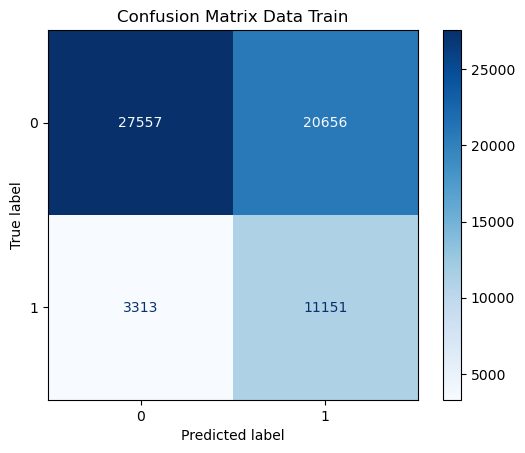

In [223]:
# Confusion matrix train

y_true = y_train       
y_pred = y_train_pred_lgbm_opt


confu_map = confusion_matrix(y_true, y_pred)
display = ConfusionMatrixDisplay(confusion_matrix=confu_map, display_labels=rf_best.classes_)
display.plot(cmap='Blues', values_format='d')

plt.title('Confusion Matrix Data Train')
plt.show()

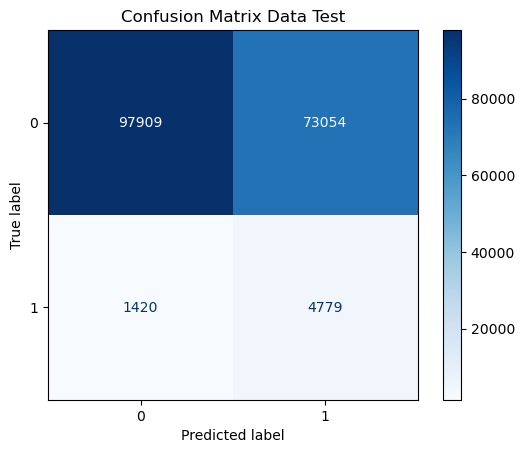

In [224]:
# Confusion matrix test

y_true = y_test
y_pred = y_test_pred_lgbm_opt


confu_map = confusion_matrix(y_true, y_pred)
display = ConfusionMatrixDisplay(confusion_matrix=confu_map, display_labels=rf_best.classes_)
display.plot(cmap='Blues', values_format='d')

plt.title('Confusion Matrix Data Test')
plt.show()

3. XGBoost

In [227]:
# Define Optuna untuk XGBoost

def objective_xgb(trial):
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
        'max_depth': trial.suggest_int('max_depth', 3, 30),
        'learning_rate': trial.suggest_float('learning_rate', 1e-3, 0.3, log=True),
        'subsample': trial.suggest_float('subsample', 0.5, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
        'gamma': trial.suggest_float('gamma', 0.0, 5.0),
        'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 5.0),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.0, 5.0),
        'scale_pos_weight': trial.suggest_categorical('scale_pos_weight', [1, 2, 3]),
        'random_state': 42,
        'n_jobs': -1,
        'use_label_encoder': False,
        'eval_metric': 'logloss'
    }

    model = XGBClassifier(**params)

    cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

    y_valid_pred = np.zeros(len(y_train))  # untuk simpan hasil validasi prediksi

    for train_idx, valid_idx in cv.split(X_train_final, y_train):
        X_tr, X_val = X_train_final.iloc[train_idx], X_train_final.iloc[valid_idx]
        y_tr, y_val = y_train.iloc[train_idx], y_train.iloc[valid_idx]

        model.fit(X_tr, y_tr)
        y_valid_pred[valid_idx] = model.predict_proba(X_val)[:, 1]

    # Adjust threshold
    threshold = trial.suggest_float('threshold', 0.35, 0.45)
    y_pred = (y_valid_pred >= threshold).astype(int)

    # Calculate metrics
    recall = recall_score(y_train, y_pred, pos_label=1)
    precision = precision_score(y_train, y_pred, pos_label=1)
    f1 = f1_score(y_train, y_pred, pos_label=1)

    # Print recall, precision and F1 per trial
    print(f"Trial {trial.number}: Recall={recall:.4f} | Precision={precision:.4f} | F1={f1:.4f} | Threshold={threshold:.3f}")

    # Custom condition: penalize if precision or recall too low
    if precision < 0.35 or recall < 0.7:
        return 0
    return recall

# Run Optuna study
study_xgb = optuna.create_study(direction="maximize", study_name="xgb_opt")
study_xgb.optimize(objective_xgb, n_trials=100, show_progress_bar=True)

# Best XGBoost parameters
print()
print("Best XGBoost Parameters:\n", study_xgb.best_params)
print("Best Recall Score XGBoost:", study_xgb.best_value)

[I 2025-04-28 15:53:35,194] A new study created in memory with name: xgb_opt


  0%|          | 0/100 [00:00<?, ?it/s]

Trial 0: Recall=0.9997 | Precision=0.2309 | F1=0.3752 | Threshold=0.357
[I 2025-04-28 15:53:39,318] Trial 0 finished with value: 0.0 and parameters: {'n_estimators': 278, 'max_depth': 17, 'learning_rate': 0.0016745521939373516, 'subsample': 0.5121227424780032, 'colsample_bytree': 0.9417956242720812, 'gamma': 2.167296543444026, 'reg_alpha': 1.5155720322064297, 'reg_lambda': 0.6430291426659057, 'scale_pos_weight': 3, 'threshold': 0.35742607757684225}. Best is trial 0 with value: 0.0.
Trial 1: Recall=0.7212 | Precision=0.3931 | F1=0.5088 | Threshold=0.438
[I 2025-04-28 15:53:46,545] Trial 1 finished with value: 0.7212389380530974 and parameters: {'n_estimators': 812, 'max_depth': 28, 'learning_rate': 0.16432485149974074, 'subsample': 0.864054190999897, 'colsample_bytree': 0.9071192149895753, 'gamma': 0.35736639078902455, 'reg_alpha': 0.166579598275714, 'reg_lambda': 4.517329208279648, 'scale_pos_weight': 3, 'threshold': 0.43824397320041686}. Best is trial 1 with value: 0.7212389380530974.

In [ ]:
# Best XGBoost Parameters:
#  {'n_estimators': 491, 'max_depth': 8, 'learning_rate': 0.0015890303741570824, 'subsample': 0.5590602734963631, 'colsample_bytree': 0.6410085896943774, 'gamma': 2.6426523641924575, 'reg_alpha': 0.5852074950974842, 'reg_lambda': 3.5062079775069144, 'scale_pos_weight': 3, 'threshold': 0.3727396211048535}
# Best Recall Score XGBoost: 0.7694275442477876

In [245]:
xgb_best = XGBClassifier(
    n_estimators=491,
    max_depth=8,
    learning_rate=0.0015890303741570824,
    subsample=0.5590602734963631,
    colsample_bytree=0.6410085896943774,
    gamma=2.6426523641924575,
    reg_alpha=0.5852074950974842,
    reg_lambda=3.5062079775069144,
    scale_pos_weight=3,
    random_state=42,
    n_jobs=-1,
    use_label_encoder=False,
    eval_metric='logloss'
)

# Fit model ke data training
xgb_best.fit(X_train_final, y_train)

# Threshold hasil tuning
threshold_best = 0.3727396211048535

# Prediksi probabilitas
y_train_pred_proba = xgb_best.predict_proba(X_train_final)[:, 1]
y_test_pred_proba = xgb_best.predict_proba(X_test_final)[:, 1]

# Konversi probabilitas menjadi class label
y_train_pred_xgb_opt = (y_train_pred_proba >= threshold_best).astype(int)
y_test_pred_xgb_opt = (y_test_pred_proba >= threshold_best).astype(int)

In [246]:
# Melihat hasil fitting model ada default pada data train

print(classification_report(y_train, y_train_pred_xgb_opt, labels=[1,0]))

              precision    recall  f1-score   support

           1       0.36      0.77      0.49     14464
           0       0.89      0.58      0.70     48213

    accuracy                           0.62     62677
   macro avg       0.62      0.68      0.60     62677
weighted avg       0.77      0.62      0.65     62677



In [247]:
# Melihat hasil fitting model ada default pada data test

print(classification_report(y_test, y_test_pred_xgb_opt, labels=[1,0]))

              precision    recall  f1-score   support

           1       0.06      0.77      0.12      6199
           0       0.99      0.58      0.73    170963

    accuracy                           0.59    177162
   macro avg       0.52      0.68      0.42    177162
weighted avg       0.95      0.59      0.71    177162



In [249]:
print(xgb_best)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.6410085896943774, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric='logloss', feature_types=None,
              gamma=2.6426523641924575, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.0015890303741570824,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=8, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=491, n_jobs=-1,
              num_parallel_tree=None, random_state=42, ...)


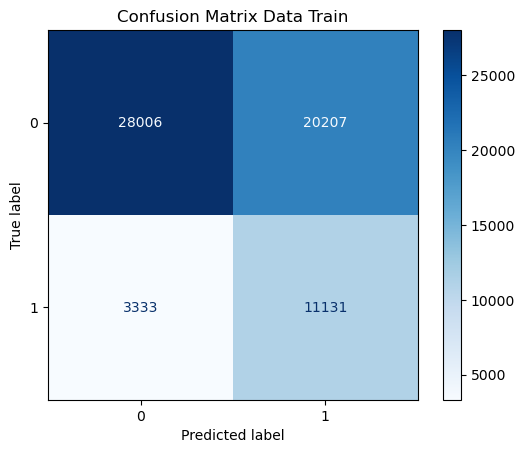

In [232]:
# Confusion matrix train

y_true = y_train       
y_pred = y_train_pred_xgb_opt


confu_map = confusion_matrix(y_true, y_pred)
display = ConfusionMatrixDisplay(confusion_matrix=confu_map, display_labels=rf_best.classes_)
display.plot(cmap='Blues', values_format='d')

plt.title('Confusion Matrix Data Train')
plt.show()

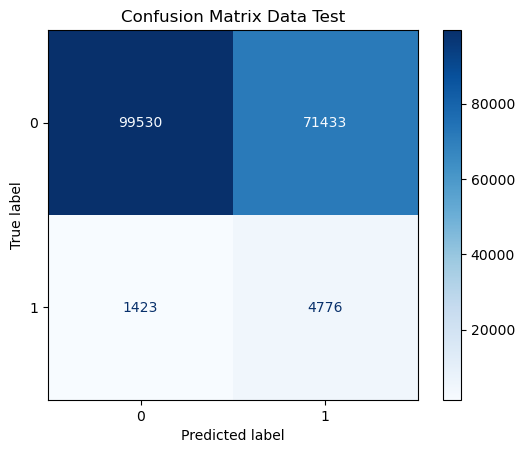

In [233]:
# Confusion matrix test

y_true = y_test       
y_pred = y_test_pred_xgb_opt


confu_map = confusion_matrix(y_true, y_pred)
display = ConfusionMatrixDisplay(confusion_matrix=confu_map, display_labels=rf_best.classes_)
display.plot(cmap='Blues', values_format='d')

plt.title('Confusion Matrix Data Test')
plt.show()

# **Model Evaluation**

## Backtesting

In [129]:
df_concat_final.columns.tolist()

['Unnamed: 0',
 'V18',
 'V43',
 'V38',
 'V39',
 'V79',
 'V52',
 'V44',
 'V87',
 'V86',
 'V45',
 'card3',
 'ProductCD',
 'card6',
 'isFraud']

In [251]:
# Mempersiapkan backtesting

# df_backtest = pd.read_csv("df_backtest.csv",sep='+')
df_test = df_backtest.drop('Unnamed: 0',axis=1).copy()
df_test = df_test[[
'V18',
 'V43',
 'V38',
 'V39',
 'V79',
 'V52',
 'V44',
 'V87',
 'V86',
 'V45',
 'card3',
 'ProductCD',
 'card6'
]]
df_test

,V18,V43,V38,V39,V79,V52,V44,V87,V86,V45,card3,ProductCD,card6
0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,debit
1,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,debit
2,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,debit
3,0.0,0.0,2.0,0.0,0.0,0.0,2.0,1.0,1.0,2.0,150.0,W,debit
4,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,debit
...,...,...,...,...,...,...,...,...,...,...,...,...,...
506686,0.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,185.0,C,debit
506687,1.0,1.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,185.0,C,debit
506688,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,debit
506689,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,150.0,W,debit


In [252]:
# Melihat dataset
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506691 entries, 0 to 506690
Data columns (total 13 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   V18        494102 non-null  float64
 1   V43        429837 non-null  float64
 2   V38        429837 non-null  float64
 3   V39        429837 non-null  float64
 4   V79        494610 non-null  float64
 5   V52        429837 non-null  float64
 6   V44        429837 non-null  float64
 7   V87        494610 non-null  float64
 8   V86        494610 non-null  float64
 9   V45        429837 non-null  float64
 10  card3      503689 non-null  float64
 11  ProductCD  506691 non-null  object 
 12  card6      503684 non-null  object 
dtypes: float64(11), object(2)
memory usage: 50.3+ MB


In [253]:
df_test.isna().sum()

V18          12589
V43          76854
V38          76854
V39          76854
V79          12081
V52          76854
V44          76854
V87          12081
V86          12081
V45          76854
card3         3002
ProductCD        0
card6         3007
dtype: int64

In [254]:
# Mengisi missing value/imputasi

# impute mode : categorical
# impute median : numerical

# Menggunakan imputer mode
df_modus = df_test[df_test.select_dtypes('object').columns]
Mod_imp = SimpleImputer(strategy='most_frequent')
Mod_imp_fit = pd.DataFrame(Mod_imp.fit_transform(df_modus), columns = Mod_imp.feature_names_in_)
df_test[df_test.select_dtypes('object').columns] = Mod_imp_fit

# Menggunakan imputer median
df_mean = df_test[df_test.select_dtypes('number').columns]
Mean_imp = SimpleImputer(strategy='median')
Mean_imp_fit = pd.DataFrame(Mean_imp.fit_transform(df_mean), columns = Mean_imp.feature_names_in_)
df_test[df_test.select_dtypes('number').columns] = Mean_imp_fit

In [255]:
# Memisahkan data kontinu dan kategorikal

df_test_num = df_test.select_dtypes('number')
df_test_cat = df_test.select_dtypes('object')

In [256]:
# Melakukan encoder

df_test_cat_enc = pd.DataFrame(ohe.transform(df_test_cat).toarray(),columns =ohe.get_feature_names_out(df_test_cat.columns))
df_test_cat_enc

,ProductCD_C,ProductCD_H,ProductCD_R,ProductCD_S,ProductCD_W,card6_charge card,card6_credit,card6_debit,card6_debit or credit
0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
1,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
2,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
3,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...
506686,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
506687,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
506688,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
506689,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [257]:
# Melakukan scaling

df_test_num_sc = pd.DataFrame(pt.transform(df_test_num),columns =df_test_num.columns)
df_test_num_sc

,V18,V43,V38,V39,V79,V52,V44,V87,V86,V45,card3
0,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976
1,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976
2,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976
3,-0.357917,-0.347471,2.812013,-0.348275,-0.351285,-0.368532,3.675063,-0.193676,-0.142541,3.110591,-0.225976
4,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976
...,...,...,...,...,...,...,...,...,...,...,...
506686,-0.357917,-0.347471,-0.209197,-0.348275,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,2.515003
506687,2.793933,2.877881,2.812013,2.871264,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,2.515003
506688,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976
506689,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976


In [258]:
# Menggabungkan kedua jenis data backtest menjadi satu dan menyiapkan data untuk backtest

backtest_final = pd.concat([df_test_num_sc, df_test_cat_enc], axis = 1)
backtest_final

,V18,V43,V38,V39,V79,V52,V44,V87,V86,V45,card3,ProductCD_C,ProductCD_H,ProductCD_R,ProductCD_S,ProductCD_W,card6_charge card,card6_credit,card6_debit,card6_debit or credit
0,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
1,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
2,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
3,-0.357917,-0.347471,2.812013,-0.348275,-0.351285,-0.368532,3.675063,-0.193676,-0.142541,3.110591,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
4,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
506686,-0.357917,-0.347471,-0.209197,-0.348275,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
506687,2.793933,2.877881,2.812013,2.871264,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
506688,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
506689,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [260]:
## Hasil model yang akan digunakan

rf_best = RandomForestClassifier(
n_estimators = 688, 
max_depth = 25, 
min_samples_split = 7, 
min_samples_leaf = 19, 
max_features = 'log2', 
class_weight = {0: 1, 1: 3},
bootstrap = True
)
rf_best.fit(X_train_final, y_train)
threshold_best = 0.35056013406495456


In [259]:
rf_best

RandomForestClassifier(class_weight={0: 1, 1: 3}, max_depth=25,
                       max_features='log2', min_samples_leaf=19,
                       min_samples_split=7, n_estimators=688)

In [261]:
threshold_best

0.35056013406495456

In [262]:
# Prediksi hasil backtest
predicted_data = rf_best.predict(backtest_final)
predicted_proba = rf_best.predict_proba(backtest_final)[:,1]

# Apply threshold_best
predicted_data = (predicted_proba >= threshold_best).astype(int)

# konversi array menjadi dataframe
df_predicted = pd.DataFrame(data=predicted_data,columns=['predicted_label_isFraud'])
df_proba = pd.DataFrame(data=predicted_proba,columns=['probability_isFraud'])

df_predict_all = pd.concat([df_test_num_sc, df_test_cat_enc, df_proba, df_predicted], axis = 1)
df_predict_all

,V18,V43,V38,V39,V79,V52,V44,V87,V86,V45,card3,ProductCD_C,ProductCD_H,ProductCD_R,ProductCD_S,ProductCD_W,card6_charge card,card6_credit,card6_debit,card6_debit or credit,probability_isFraud,predicted_label_isFraud
0,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.277512,0
1,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.277512,0
2,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.277512,0
3,-0.357917,-0.347471,2.812013,-0.348275,-0.351285,-0.368532,3.675063,-0.193676,-0.142541,3.110591,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.314768,0
4,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.277512,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
506686,-0.357917,-0.347471,-0.209197,-0.348275,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.384000,1
506687,2.793933,2.877881,2.812013,2.871264,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.471656,1
506688,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.277512,0
506689,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.277512,0


In [263]:
df_predicted.value_counts()

predicted_label_isFraud
0                          330961
1                          175730
Name: count, dtype: int64

In [264]:
df_predicted.value_counts(normalize=True)

predicted_label_isFraud
0                          0.653181
1                          0.346819
Name: proportion, dtype: float64

In [265]:
# Cek apakah threshold sudah benar

df_predict_all[(df_predict_all['predicted_label_isFraud']==1)].sort_values(by='probability_isFraud',ascending=True)

,V18,V43,V38,V39,V79,V52,V44,V87,V86,V45,card3,ProductCD_C,ProductCD_H,ProductCD_R,ProductCD_S,ProductCD_W,card6_charge card,card6_credit,card6_debit,card6_debit or credit,probability_isFraud,predicted_label_isFraud
230352,2.793933,2.877881,3.702654,2.871264,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,-2.546436,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.350630,1
279364,2.793933,2.877881,3.702654,2.871264,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,-2.693180,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.350630,1
355275,2.793933,2.877881,3.702654,2.871264,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,-2.546436,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.350630,1
468604,2.793933,2.877881,3.702654,2.871264,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,-2.546436,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.350630,1
177585,-0.357917,-0.347471,2.812013,-0.348275,-0.351285,-0.368532,3.675063,-0.193676,-0.142541,3.110591,-0.988627,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.350819,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
261771,2.793933,2.877881,4.406341,2.871264,2.846668,2.713384,6.379613,5.254464,6.677404,5.162374,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.998160,1
38516,2.793933,2.877881,4.406341,2.871264,2.846668,2.713384,6.379613,5.254464,6.677404,5.162374,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.998160,1
306223,2.793933,2.877881,4.406341,2.871264,2.846668,2.713384,6.379613,5.254464,6.677404,5.162374,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.998160,1
59644,2.793933,2.877881,4.406341,2.871264,2.846668,2.713384,6.379613,5.254464,6.677404,5.162374,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.998160,1


In [266]:
df_predict_all

,V18,V43,V38,V39,V79,V52,V44,V87,V86,V45,card3,ProductCD_C,ProductCD_H,ProductCD_R,ProductCD_S,ProductCD_W,card6_charge card,card6_credit,card6_debit,card6_debit or credit,probability_isFraud,predicted_label_isFraud
0,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.277512,0
1,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.277512,0
2,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.277512,0
3,-0.357917,-0.347471,2.812013,-0.348275,-0.351285,-0.368532,3.675063,-0.193676,-0.142541,3.110591,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.314768,0
4,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.277512,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
506686,-0.357917,-0.347471,-0.209197,-0.348275,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.384000,1
506687,2.793933,2.877881,2.812013,2.871264,2.846668,2.713384,-0.149020,-0.193676,-0.142541,-0.190686,2.515003,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.471656,1
506688,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.277512,0
506689,-0.357917,-0.347471,-0.209197,-0.348275,-0.351285,-0.368532,-0.149020,-0.193676,-0.142541,-0.190686,-0.225976,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.277512,0


In [267]:
df_predict_all.to_csv("df_predict_all.csv",sep='+')

In [206]:
# Model terbaik hasil tuning memiliki nilai recall tinggi (77%) dengan presisi rendah (6%) dalam mendeteksi fraud
# Sebagai konsekuensinya akan meningkat jumlah false positive berdasarkan consufion matrix
# Perlu dilakukan pendalaman lebih terkait fitur-fitur yang sudah ada maupun belum ada dalam model dalam memperbaiki model